In [1]:
#@title Import packages
from pathlib import Path
import json
import requests
import os
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import TruncatedSVD

## Data Loading

In [2]:
# @title Data loading and imports

# set path for data
root = r'/home/sunr/projects/MCLabRotation/data_Zhong_et_al_2025'
Path(root).mkdir(exist_ok=True)

beh_path = os.path.join(root, 'beh')
spk_path = os.path.join(root, 'spk')

In [3]:
sup_bef1 = 'VR2_2021_03_20_1'  # example mouse of supervised learning: VR2
sup_aft1 = 'VR2_2021_04_06_1'
sup_test1 = 'VR2_2021_04_11_1'

unsup_bef1 = 'DR15_2022_10_09_1'  # example mouse of unsupervised learning: TX83
unsup_aft1 = 'DR15_2022_10_19_1'
unsup_test1 = 'DR15_2022_10_20_1'

### Check Mice Exp Stages

In [ ]:
for file in os.listdir(beh_path):
    if not file.endswith('.npy'):
        continue
    print(f'{file}: \n {np.load(os.path.join(beh_path, file), allow_pickle=1).item().keys()}')

Beh_unsup_train1_before_learning.npy: 
 dict_keys(['TX83_2022_08_17_1', 'TX88_2022_06_13_2', 'TX105_2022_10_08_2', 'TX104_2022_10_12_1', 'TX119_2023_12_14_1', 'TX123_2023_12_21_1', 'DR10_2022_07_12_1', 'DR15_2022_10_09_1', 'TX85_2022_06_14_1'])
example_bef_and_aft_learning_behavior.npy: 
 dict_keys(['TX109_2023_03_27_1', 'TX109_2023_04_14_1'])
Beh_sup_train2_before_learning.npy: 
 dict_keys(['TX60_2021_06_07_1', 'TX61_2021_06_07_2', 'TX108_2023_03_25_1', 'TX109_2023_04_18_1', 'VR2_2021_04_11_1'])
Beh_unsup_train2_after_learning.npy: 
 dict_keys(['TX88_2022_07_15_1', 'TX105_2022_11_05_1', 'TX119_2024_01_06_1', 'TX123_2024_01_15_1', 'DR10_2022_07_28_1', 'DR15_2022_11_02_1'])
Beh_sup_test2.npy: 
 dict_keys(['TX60_2021_06_22_1', 'TX61_2021_06_20_1', 'TX108_2023_04_04_1', 'TX109_2023_05_13_1', 'VR2_2021_04_29_1'])
Imaging_Exp_info.npy: 
 dict_keys(['unsup_train1_before_learning', 'unsup_train1_after_learning', 'sup_train1_before_learning', 'sup_train1_after_learning', 'unsup_test1', 'sup_te

### Download SPK files

In [35]:
BASE_URL = 'https://api.figshare.com/v2'
r = requests.get(BASE_URL + '/articles/' + str(28811129)) # 28811129 is the ID of the whole dataset
file_metadata = json.loads(r.text)
for file in file_metadata['files']:
    if 'DR10' in file['name']:
        fn = os.path.join(spk_path, file['name'])
        if not os.path.isfile(fn):
            response = requests.get(BASE_URL + '/file/download/' + str(file['id']))
            open(fn, 'wb').write(response.content)
        print(fn)

/home/sunr/projects/MCLabRotation/data_Zhong_et_al_2025/spk/DR10_2022_07_21_trans.npz
/home/sunr/projects/MCLabRotation/data_Zhong_et_al_2025/spk/DR10_2022_07_28_trans.npz
/home/sunr/projects/MCLabRotation/data_Zhong_et_al_2025/spk/DR10_2022_07_30_trans.npz
/home/sunr/projects/MCLabRotation/data_Zhong_et_al_2025/spk/DR10_2022_07_12_trans.npz
/home/sunr/projects/MCLabRotation/data_Zhong_et_al_2025/spk/DR10_2022_07_19_trans.npz
/home/sunr/projects/MCLabRotation/data_Zhong_et_al_2025/spk/DR10_2022_07_29_trans.npz
/home/sunr/projects/MCLabRotation/data_Zhong_et_al_2025/spk/DR10_2022_07_12_1_neural_data.npy
/home/sunr/projects/MCLabRotation/data_Zhong_et_al_2025/spk/DR10_2022_07_19_1_neural_data.npy
/home/sunr/projects/MCLabRotation/data_Zhong_et_al_2025/spk/DR10_2022_07_21_1_neural_data.npy
/home/sunr/projects/MCLabRotation/data_Zhong_et_al_2025/spk/DR10_2022_07_28_1_neural_data.npy
/home/sunr/projects/MCLabRotation/data_Zhong_et_al_2025/spk/DR10_2022_07_29_1_neural_data.npy
/home/sunr/pro

### Beh

In [3]:
sup_aft1_beh = np.load(os.path.join(root, 'beh', 'Beh_sup_train1_after_learning.npy'), allow_pickle=1).item()[sup_aft1]
sup_bef1_beh = np.load(os.path.join(root, 'beh', 'Beh_sup_train1_before_learning.npy'), allow_pickle=1).item()[sup_bef1]
print(sup_aft1_beh.keys())

unsup_aft1_beh = np.load(os.path.join(root, 'beh', 'Beh_unsup_train1_after_learning.npy'), allow_pickle=1).item()[unsup_aft1]
unsup_bef1_beh = np.load(os.path.join(root, 'beh', 'Beh_unsup_train1_before_learning.npy'), allow_pickle=1).item()[unsup_bef1]
sup_test1_beh = np.load(os.path.join(root, 'beh', 'Beh_sup_test1.npy'), allow_pickle=1).item()[sup_test1]
unsup_test1_beh = np.load(os.path.join(root, 'beh', 'Beh_unsup_test1.npy'), allow_pickle=1).item()[unsup_test1]

NameError: name 'sup_aft1' is not defined

In [3]:
sup_aft1_beh = np.load(os.path.join(root, 'beh', 'Beh_sup_train1_after_learning.npy'), allow_pickle=1).item().keys()
for key in sup_aft1_beh:
    print(np.load(os.path.join(root, 'beh', 'Beh_sup_train1_after_learning.npy'), allow_pickle=1).item()[key]['ntrials'])
sup_bef1_beh = np.load(os.path.join(root, 'beh', 'Beh_sup_train1_before_learning.npy'), allow_pickle=1).item().keys()
for key in sup_bef1_beh:
    print(np.load(os.path.join(root, 'beh', 'Beh_sup_train1_before_learning.npy'), allow_pickle=1).item()[key]['ntrials'])
unsup_aft1_beh = np.load(os.path.join(root, 'beh', 'Beh_unsup_train1_after_learning.npy'), allow_pickle=1).item().keys()
for key in unsup_aft1_beh:
    print(np.load(os.path.join(root, 'beh', 'Beh_unsup_train1_after_learning.npy'), allow_pickle=1).item()[key]['ntrials'])
unsup_bef1_beh = np.load(os.path.join(root, 'beh', 'Beh_unsup_train1_before_learning.npy'), allow_pickle=1).item().keys()
for key in unsup_bef1_beh:
    print(np.load(os.path.join(root, 'beh', 'Beh_unsup_train1_before_learning.npy'), allow_pickle=1).item()[key]['ntrials'])
sup_test1_beh = np.load(os.path.join(root, 'beh', 'Beh_sup_test1.npy'), allow_pickle=1).item().keys()
for key in sup_test1_beh:
    print(np.load(os.path.join(root, 'beh', 'Beh_sup_test1.npy'), allow_pickle=1).item()[key]['ntrials'])
unsup_test1_beh = np.load(os.path.join(root, 'beh', 'Beh_unsup_test1.npy'), allow_pickle=1).item().keys()
for key in unsup_test1_beh:
    print(np.load(os.path.join(root, 'beh', 'Beh_unsup_test1.npy'), allow_pickle=1).item()[key]['ntrials'])

470
303
300
320
348
237
210
84
238
605
259
269
429
475
431
259
403
400
282
201
145
379
345
503
218
402
485
408
423
370
719
402
636
251
452
459
518
305


### Spk

In [3]:
from scipy.stats import zscore

def prepare_data(recording):
    """
    Load and prepare xpos, ypos, z-scored spks for a given recording.
    """
    spk_path = os.path.join(root, 'spk')
    spks = np.load(os.path.join(spk_path, recording + '_neural_data.npy'), allow_pickle=1).item()['spks']
    spks = np.vstack(spks)  
    print(f'Loaded {recording} spks with shape {spks.shape}') # shape[0] should be (neurons, frame)
    spks = zscore(spks, axis=1)
    xpos = np.load(os.path.join(spk_path, recording[:-1] + 'trans.npz'), allow_pickle=1)['xpos']/0.75
    ypos = np.load(os.path.join(spk_path, recording[:-1] + 'trans.npz'), allow_pickle=1)['ypos']/0.5
    iarea = np.load(os.path.join(spk_path, recording[:-1] + 'trans.npz'), allow_pickle=1)['iarea']
    U = np.load(os.path.join(spk_path, recording + '_SVD_dec.npy'), allow_pickle=1).item()['U']
    V = np.load(os.path.join(spk_path, recording + '_SVD_dec.npy'), allow_pickle=1).item()['V']

    return spks, xpos, ypos, iarea, U, V

In [ ]:
# use supervised after and before training 1 to test the pipline
sup_aft1_spks, sup_aft1_xpos, sup_aft1_ypos, sup_aft1_U, sup_aft1_V, _ = prepare_data(sup_aft1)
sup_bef1_spks, sup_bef1_xpos, sup_bef1_ypos, sup_bef1_U, sup_bef1_V, _ = prepare_data(sup_bef1)
sup_test1_spks, sup_test1_xpos, sup_test1_ypos, sup_test1_U, sup_test1_V, _ = prepare_data(sup_test1)
unsup_aft1_spks, unsup_aft1_xpos, unsup_aft1_ypos, unsup_aft1_U, unsup_aft1_V, _ = prepare_data(unsup_aft1)
unsup_bef1_spks, unsup_bef1_xpos, unsup_bef1_ypos, unsup_bef1_U, unsup_bef1_V, _ = prepare_data(unsup_bef1)  
unsup_test1_spks, unsup_test1_xpos, unsup_test1_ypos, unsup_test1_U, unsup_test1_V, _ = prepare_data(unsup_test1)

print(f'Supervised after training 1: {sup_aft1_spks.shape}')

Loaded VR2_2021_04_06_1 spks with shape (71069, 17760)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Loaded VR2_2021_03_20_1 spks with shape (81473, 24298)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Loaded VR2_2021_04_11_1 spks with shape (76108, 29244)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Loaded DR15_2022_10_19_1 spks with shape (58930, 28848)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Loaded DR15_2022_10_09_1 spks with shape (55746, 29375)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Loaded DR15_2022_10_20_1 spks with shape (64130, 26837)
Supervised after training 1: (71069, 17760)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


## All_Neuron Pos Bin Matrix

In [5]:
from scipy.interpolate import interp1d

def tuning_curves_VR(sn, VRpos, corridor_starts, corridor_ends, beh, num_stimuli=2):
    corr_tot = np.zeros(num_stimuli)
    npts=60
    n_sn = sn.shape[0]
    corridor_tuning = np.zeros((num_stimuli, n_sn, npts), np.float32)
    tcorridor = np.zeros(len(VRpos), "bool")
    for n in range(len(corridor_starts)-1):
        start = int(np.round(corridor_starts[n]))
        end = int(np.round(corridor_ends[n])) #int(np.ceil(whiteSpcFrameInd[n]))
        corr_fr = int(corridor_starts[n]+3) # remove potential boundary effects
        corr_type = beh['ft_WallID'][corr_fr]
        if corr_type == 'rock1' or corr_type == 'circle1':
            icorr = 1
        elif corr_type == 'rock2' or corr_type == 'circle2':
            icorr = 3
        elif corr_type == 'wood1' or corr_type == 'leaf1':
            icorr = 0
        elif corr_type == 'wood2' or corr_type == 'leaf2':
            icorr = 2
        else:  
            continue  # skip if corridor type is not recognized
        valid_mask = (VRpos[start:end] !=0)
        pos_filtered = VRpos[start:end][valid_mask]
        sn_filtered = sn[:, start:end][:,valid_mask]

        if len(pos_filtered) == 0:
            continue  # Skip this corridor if no valid position data

        f = interp1d(pos_filtered, sn_filtered, 
                    bounds_error=False, 
                    fill_value=(sn[:,start], sn[:,end]))
        corridor_tuning[icorr,:,:] += f(np.linspace(0, 1, npts))
        tcorridor[start:end] = icorr
        corr_tot[icorr] += 1
    corridor_tuning /= corr_tot[:,np.newaxis,np.newaxis]
    return corridor_tuning

In [8]:
sup_aft1_corridor_tuning = tuning_curves_VR(sup_aft1_spks, sup_aft1_beh['ft_Pos'] / 60, sup_aft1_beh['StartFr'], sup_aft1_beh['EndFr'], sup_aft1_beh)
sup_bef1_corridor_tuning = tuning_curves_VR(sup_bef1_spks, sup_bef1_beh['ft_Pos'] / 60, sup_bef1_beh['StartFr'], sup_bef1_beh['EndFr'], sup_bef1_beh)

unsup_aft1_corridor_tuning = tuning_curves_VR(unsup_aft1_spks, unsup_aft1_beh['ft_Pos'] / 60, unsup_aft1_beh['StartFr'], unsup_aft1_beh['EndFr'], unsup_aft1_beh)
unsup_bef1_corridor_tuning = tuning_curves_VR(unsup_bef1_spks, unsup_bef1_beh['ft_Pos'] / 60, unsup_bef1_beh['StartFr'], unsup_bef1_beh['EndFr'], unsup_bef1_beh)
sup_test1_corridor_tuning = tuning_curves_VR(sup_test1_spks, sup_test1_beh['ft_Pos'] / 60, sup_test1_beh['StartFr'], sup_test1_beh['EndFr'], sup_test1_beh, num_stimuli=4)
unsup_test1_corridor_tuning = tuning_curves_VR(unsup_test1_spks, unsup_test1_beh['ft_Pos'] / 60, unsup_test1_beh['StartFr'], unsup_test1_beh['EndFr'], unsup_test1_beh, num_stimuli=4)

sup_aft1_corridor_tuning.shape

/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


(2, 71069, 60)

In [6]:
def all_neuron_pos_bin_matrix(corridor_tuning, n_stimuli=2):
    """
    80*n_neuron matrix
    """
    _, n_neurons, n_bins = corridor_tuning.shape
    n_bins = 40
    pos_bin_matrix = np.zeros((n_stimuli*n_bins, n_neurons))
    for i in range(n_stimuli):
        pos_bin_matrix[i*n_bins:(i+1)*n_bins, :] = corridor_tuning[i, :, :40].T
    return pos_bin_matrix

In [10]:
sup_aft1_neuron_pos = all_neuron_pos_bin_matrix(sup_aft1_corridor_tuning)
sup_bef1_neuron_pos = all_neuron_pos_bin_matrix(sup_bef1_corridor_tuning)
sup_test1_neuron_pos = all_neuron_pos_bin_matrix(sup_test1_corridor_tuning)
unsup_aft1_neuron_pos = all_neuron_pos_bin_matrix(unsup_aft1_corridor_tuning)
unsup_bef1_neuron_pos = all_neuron_pos_bin_matrix(unsup_bef1_corridor_tuning)
unsup_test1_neuron_pos = all_neuron_pos_bin_matrix(unsup_test1_corridor_tuning)
sup_aft1_neuron_pos.shape

(80, 71069)

## Corr Matrix

In [7]:
def visualize_corr_matrix(cm_aft, cm_bef, title1, title2, vmin=None, vmax=None):

    print(cm_aft.shape, cm_bef.shape)
    
    # color scale from finite values 
    if vmin is None or vmax is None:
        all_vals = np.concatenate([cm_aft[np.isfinite(cm_aft)], cm_bef[np.isfinite(cm_bef)]]) \
                   if np.isfinite(cm_aft).any() and np.isfinite(cm_bef).any() else np.array([0.0])
        vmin, vmax = np.percentile(all_vals, [2, 98]) if all_vals.size > 1 else (-1.0, 1.0)

    fig, ax = plt.subplots(1, 2, figsize=(8, 4))
    fig.suptitle('All Neurons Per Pos Bin Activity Correlation Matrix', fontsize=12)

    im0 = ax[0].imshow(cm_aft, cmap='viridis', vmin=vmin, vmax=vmax)
    ax[0].set_title(title1)
    ax[0].set_xlabel('Leaf1 Positions      Circle1 Positions')
    ax[0].set_ylabel('Leaf1 Positions      Circle1 Positions')
    ax[0].invert_yaxis()
    ax[0].grid(False)

    im1 = ax[1].imshow(cm_bef, cmap='viridis', vmin=vmin, vmax=vmax)
    ax[1].set_title(title2)
    ax[1].set_xlabel('Leaf1 Positions      Circle1 Positions')
    ax[1].set_ylabel('Leaf1 Positions      Circle1 Positions')
    ax[1].invert_yaxis()
    ax[1].grid(False)

    # single colorbar for both subplots
    cax = fig.add_axes([1.0, 0.15, 0.02, 0.6])  # left, bottom, width, height
    fig.colorbar(im0, cax=cax, orientation='vertical')
    plt.tight_layout()
    plt.show()


def cos_similarity(mat1, mat2):
    mat1 = mat1.reshape(1, -1).T if mat1.ndim == 2 else mat1
    mat2 = mat2.reshape(1, -1).T if mat2.ndim == 2 else mat2
    cos_sim = mat1.T @ mat2 / (np.linalg.norm(mat1) * np.linalg.norm(mat2)) 
    cos_sim = cos_sim.squeeze()
    return cos_sim

(80, 80) (80, 80)


/tmp/ipykernel_1076/3428423905.py:31: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


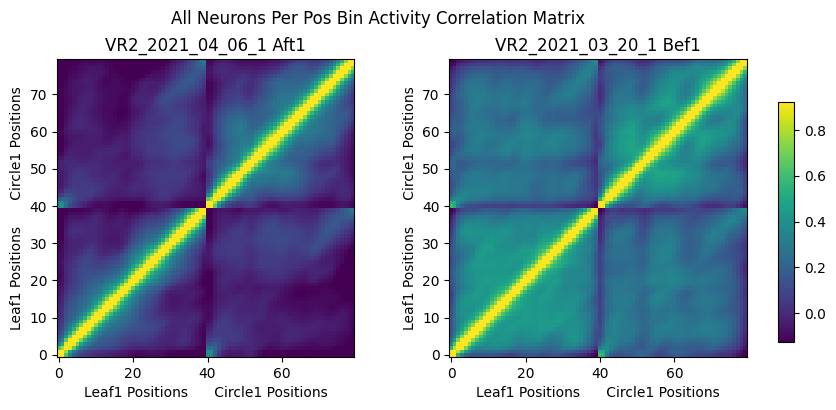

(80, 80) (80, 80)


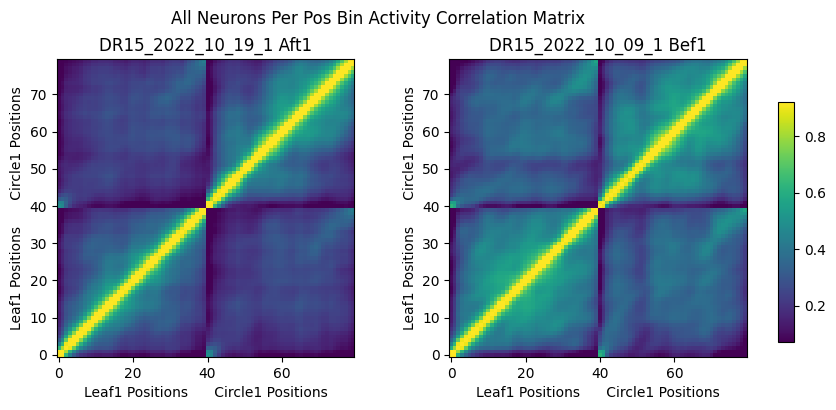

(80, 80) (80, 80)


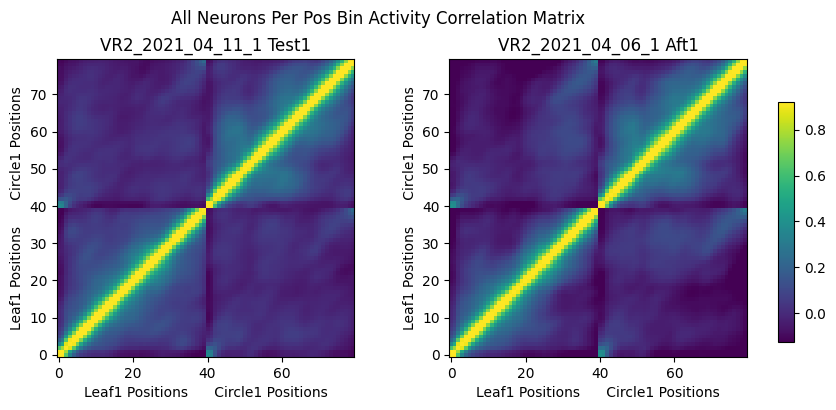

(80, 80) (80, 80)


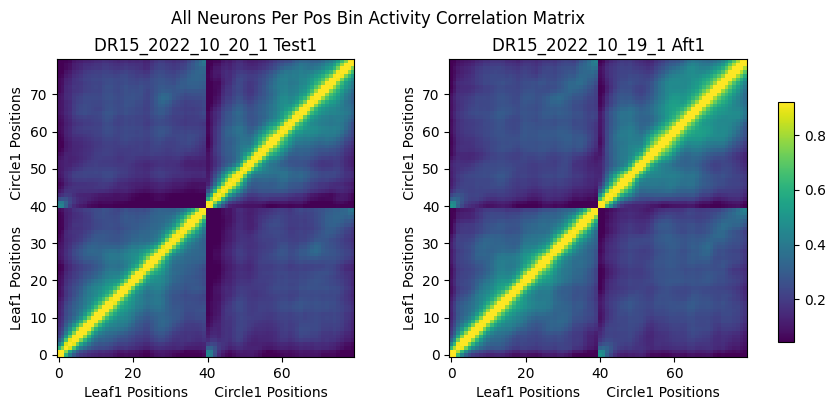

supervised before and after training cosine similarity: 0.7847981812548874
unsupervised before and after training cosine similarity: 0.9853276111563386
supervised leaf circle before and after training cosine similarity: -0.024266488122256326
unsupervised leaf circle before and after training cosine similarity: 0.992623499961564
supervised test and after training cosine similarity: 0.9846931577166891
unsupervised test and after training cosine similarity: 0.9955519063072518
supervised leaf circle test and after training cosine similarity: 0.7840153339660926
unsupervised leaf circle test and after training cosine similarity: 0.9901242745814426


In [ ]:
# correlation here (optional: cosine similarity, euclidean distance)
visualize_corr_matrix(np.corrcoef(sup_aft1_neuron_pos), 
                      np.corrcoef(sup_bef1_neuron_pos), 
                      f'{sup_aft1} Aft1', f'{sup_bef1} Bef1'
                      #, vmin=0.0, vmax=0.95
                      )
visualize_corr_matrix(np.corrcoef(unsup_aft1_neuron_pos), 
                      np.corrcoef(unsup_bef1_neuron_pos), 
                      f'{unsup_aft1} Aft1', f'{unsup_bef1} Bef1'
                      #, vmin=0.0, vmax=0.95
                      )
visualize_corr_matrix(np.corrcoef(sup_test1_neuron_pos), 
                      np.corrcoef(sup_aft1_neuron_pos), 
                      f'{sup_test1} Test1', f'{sup_aft1} Aft1'
                      #, vmin=0.0, vmax=0.95
                      )
visualize_corr_matrix(np.corrcoef(unsup_test1_neuron_pos),
                      np.corrcoef(unsup_aft1_neuron_pos),
                      f'{unsup_test1} Test1', f'{unsup_aft1} Aft1'
                      #, vmin=0.0, vmax=0.95
                      )

sup_cos_sim = cos_similarity(np.triu(np.corrcoef(sup_aft1_neuron_pos)),
                                   np.triu(np.corrcoef(sup_bef1_neuron_pos)))
unsup_cos_sim = cos_similarity(np.triu(np.corrcoef(unsup_aft1_neuron_pos)),
                                   np.triu(np.corrcoef(unsup_bef1_neuron_pos)))
sup_cos_sim_leaf_circle = cos_similarity(np.corrcoef(sup_aft1_neuron_pos)[:40, 40:],
                                   np.corrcoef(sup_bef1_neuron_pos)[:40, 40:])
unsup_cos_sim_leaf_circle = cos_similarity(np.corrcoef(unsup_aft1_neuron_pos)[:40, 40:],
                                   np.corrcoef(unsup_bef1_neuron_pos)[:40, 40:])
print(f'supervised before and after training cosine similarity: {sup_cos_sim}')
print(f'unsupervised before and after training cosine similarity: {unsup_cos_sim}')
print(f'supervised leaf circle before and after training cosine similarity: {sup_cos_sim_leaf_circle}')
print(f'unsupervised leaf circle before and after training cosine similarity: {unsup_cos_sim_leaf_circle}')


sup_cos_sim = cos_similarity(np.triu(np.corrcoef(sup_test1_neuron_pos)),
                                   np.triu(np.corrcoef(sup_aft1_neuron_pos)))
unsup_cos_sim = cos_similarity(np.triu(np.corrcoef(unsup_test1_neuron_pos)),
                                   np.triu(np.corrcoef(unsup_aft1_neuron_pos)))
sup_cos_sim_leaf_circle = cos_similarity(np.corrcoef(sup_test1_neuron_pos)[:40, 40:],
                                   np.corrcoef(sup_aft1_neuron_pos)[:40, 40:])
unsup_cos_sim_leaf_circle = cos_similarity(np.corrcoef(unsup_test1_neuron_pos)[:40, 40:],
                                   np.corrcoef(unsup_aft1_neuron_pos)[:40, 40:])
print(f'supervised test and after training cosine similarity: {sup_cos_sim}')
print(f'unsupervised test and after training cosine similarity: {unsup_cos_sim}')
print(f'supervised leaf circle test and after training cosine similarity: {sup_cos_sim_leaf_circle}')
print(f'unsupervised leaf circle test and after training cosine similarity: {unsup_cos_sim_leaf_circle}')

In [9]:
from sklearn.preprocessing import StandardScaler
from sklearn.metrics.pairwise import euclidean_distances
def rdm_analysis(aft1_neuron_pos, bef1_neuron_pos, test1_neuron_pos, animal, method='corr'):
    if method == 'corr':
        #aft1_neuron_pos = zscore(aft1_neuron_pos)
        #bef1_neuron_pos = zscore(bef1_neuron_pos)
        #test1_neuron_pos = zscore(test1_neuron_pos)
        #print(aft1_neuron_pos[:,0].mean())
        
        #aft_matrix = np.corrcoef(aft1_neuron_pos)
        #bef_matrix = np.corrcoef(bef1_neuron_pos)
        #test_matrix = np.corrcoef(test1_neuron_pos)
        def row_corr_matrix(X):
            # X: (n_samples, n_features)
            Xc = X - X.mean(axis=1, keepdims=True)         # center rows
            Xn = Xc / np.linalg.norm(Xc, axis=1, keepdims=True)  # normalize rows
            return Xn @ Xn.T                               # Pearson r between rows

        aft_matrix = row_corr_matrix(aft1_neuron_pos)
        bef_matrix = row_corr_matrix(bef1_neuron_pos)
        test_matrix = row_corr_matrix(test1_neuron_pos)

    else:
        
        scaler = StandardScaler(with_std=False)
        aft1_neuron_pos = scaler.fit_transform(aft1_neuron_pos)
        bef1_neuron_pos = scaler.fit_transform(bef1_neuron_pos)
        test1_neuron_pos = scaler.fit_transform(test1_neuron_pos)
        print(aft1_neuron_pos[:,0].mean())
        '''
        aft1_neuron_pos = zscore(aft1_neuron_pos)
        bef1_neuron_pos = zscore(bef1_neuron_pos)
        test1_neuron_pos = zscore(test1_neuron_pos)
        print(aft1_neuron_pos[:,0].mean())
        '''

        aft_matrix = euclidean_distances(aft1_neuron_pos, squared=True)
        bef_matrix = euclidean_distances(bef1_neuron_pos, squared=True)
        test_matrix = euclidean_distances(test1_neuron_pos, squared=True)
    
    # correlation here (optional: cosine similarity, euclidean distance)
    visualize_corr_matrix(aft_matrix, 
                        bef_matrix, 
                        f'{animal} Aft1', f'{animal} Bef1'
                        #, vmin=0.0, vmax=0.95
                        )
    visualize_corr_matrix(test_matrix, 
                        aft_matrix, 
                        f'{animal} Test1', f'{animal} Aft1'
                        #, vmin=0.0, vmax=0.95
                        )

    cos_sim1 = cos_similarity(np.tril(aft_matrix),
                                    np.tril(bef_matrix))
    cos_sim_leaf_circle1 = cos_similarity(aft_matrix[:40, 40:],
                                    bef_matrix[:40, 40:])
    print(f'supervised before and after training cosine similarity: {cos_sim1}')
    print(f'supervised leaf circle before and after training cosine similarity: {cos_sim_leaf_circle1}')


    cos_sim2 = cos_similarity(np.triu(test_matrix),
                                    np.triu(aft_matrix))
    cos_sim_leaf_circle2 = cos_similarity(test_matrix[:40, 40:],
                                    aft_matrix[:40, 40:])
    print(f'supervised test and after training cosine similarity: {cos_sim2}')
    print(f'supervised leaf circle test and after training cosine similarity: {cos_sim_leaf_circle2}')

    #return cos_sim1, cos_sim_leaf_circle1, cos_sim2, cos_sim_leaf_circle2
    return aft_matrix, bef_matrix, test_matrix

-2.331468351712829e-16
(80, 80) (80, 80)


/tmp/ipykernel_1030/1108165686.py:31: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


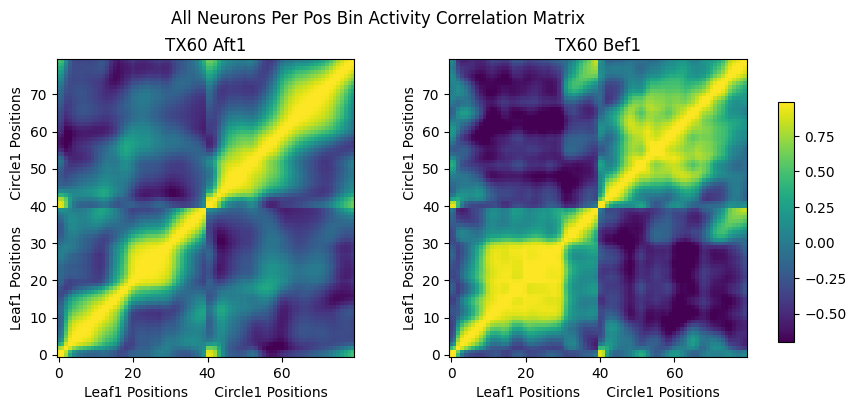

(80, 80) (80, 80)


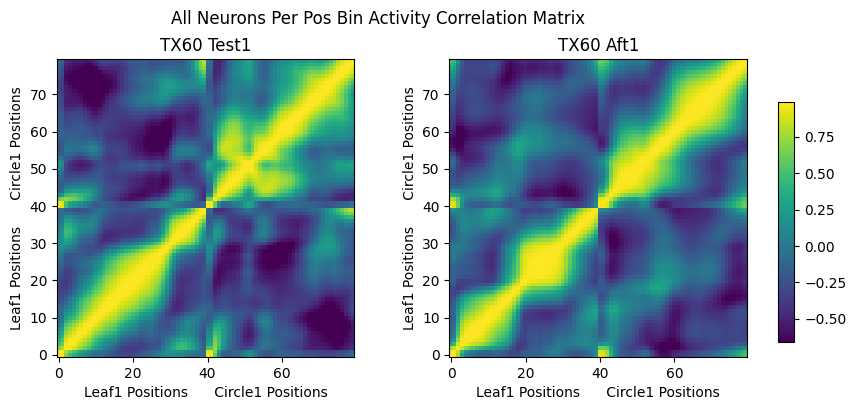

supervised before and after training cosine similarity: 0.7274495215772298
supervised leaf circle before and after training cosine similarity: 0.6864983122457254
supervised test and after training cosine similarity: 0.8039620102274289
supervised leaf circle test and after training cosine similarity: 0.6357338611341405
-9.43689570931383e-17
(80, 80) (80, 80)


/tmp/ipykernel_1030/1108165686.py:31: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


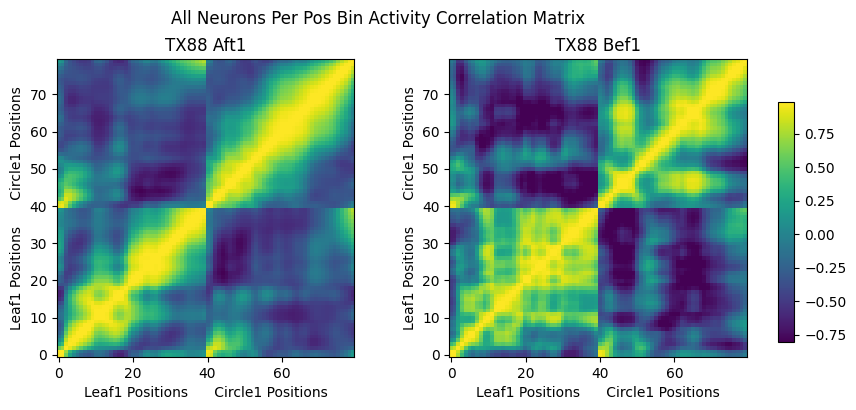

(80, 80) (80, 80)


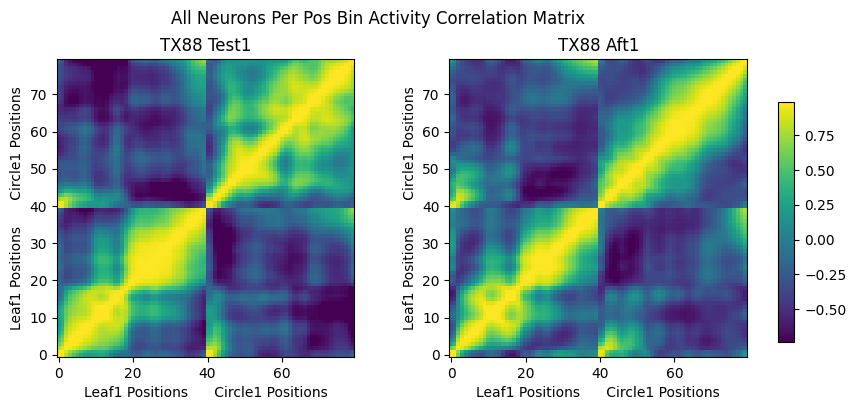

supervised before and after training cosine similarity: 0.8309966157163895
supervised leaf circle before and after training cosine similarity: 0.8247778374216767
supervised test and after training cosine similarity: 0.8810422100509413
supervised leaf circle test and after training cosine similarity: 0.8525396885301821


In [ ]:
corr1, corr2, corr3, corr4 = rdm_analysis(sup2_aft1_svd_neuron_pos[:, :10], sup2_bef1_svd_neuron_pos[:, :10], sup2_test1_svd_neuron_pos[:, :10], 'TX60', method='corr')
corr1, corr2, corr3, corr4 = rdm_analysis(unsup2_aft1_svd_neuron_pos[:, :10], unsup2_bef1_svd_neuron_pos[:, :10], unsup2_test1_svd_neuron_pos[:, :10], 'TX88', method='corr')

In [10]:
def svd_after_tuning(aft1_neuron_pos, bef1_neuron_pos, test1_neuron_pos):
    svd = TruncatedSVD(n_components=80, random_state=42)
    aft1_svd = svd.fit_transform(aft1_neuron_pos)
    bef1_svd = svd.fit_transform(bef1_neuron_pos)
    test1_svd = svd.fit_transform(test1_neuron_pos)
    return aft1_svd, bef1_svd, test1_svd

(80, 80) (80, 80)


/tmp/ipykernel_1030/1108165686.py:31: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


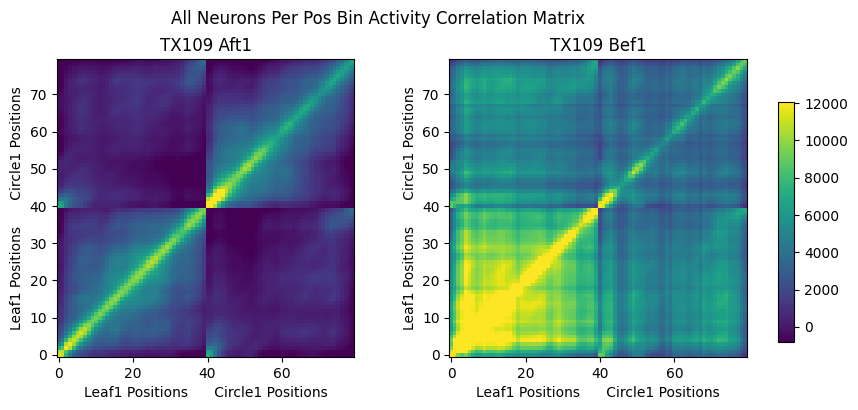

(80, 80) (80, 80)


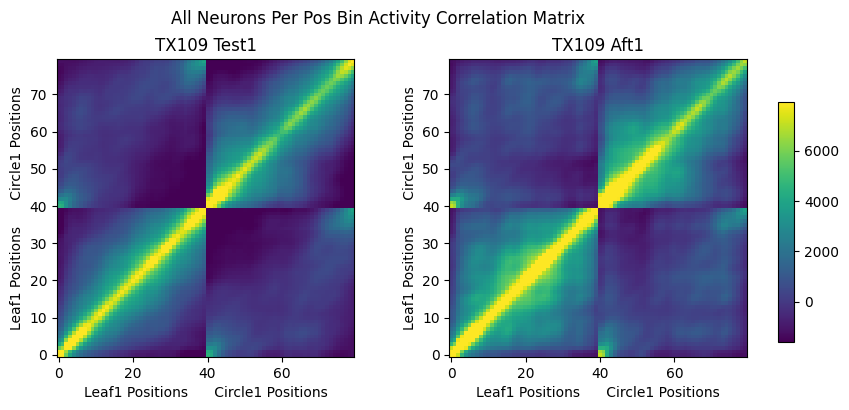

supervised before and after training cosine similarity: 0.7580493351849483
supervised leaf circle before and after training cosine similarity: 0.4755721739136528
supervised test and after training cosine similarity: 0.9528749151043684
supervised leaf circle test and after training cosine similarity: 0.6974889853371378
(80, 80) (80, 80)


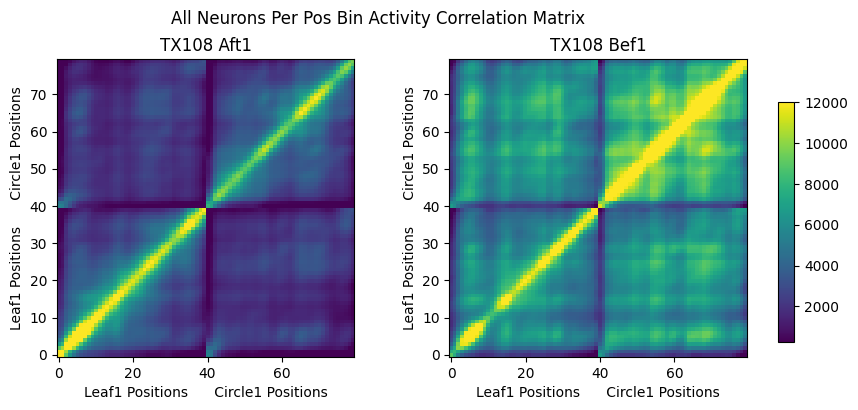

(80, 80) (80, 80)


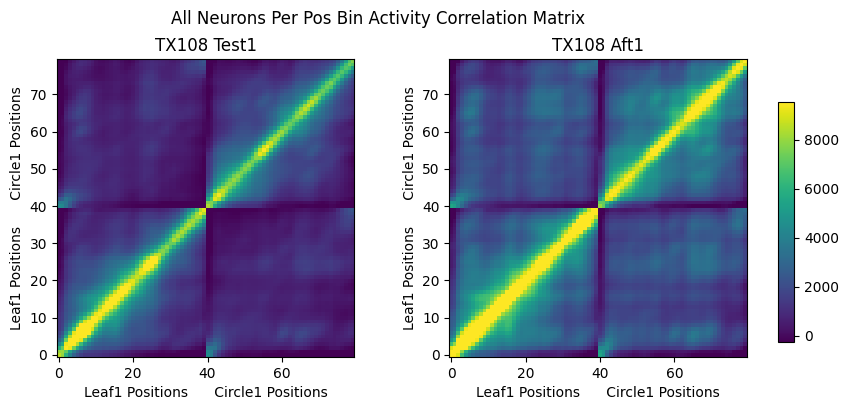

supervised before and after training cosine similarity: 0.9067795987574764
supervised leaf circle before and after training cosine similarity: 0.9725327342108312
supervised test and after training cosine similarity: 0.9698673559486835
supervised leaf circle test and after training cosine similarity: 0.9372264657769585
(80, 80) (80, 80)


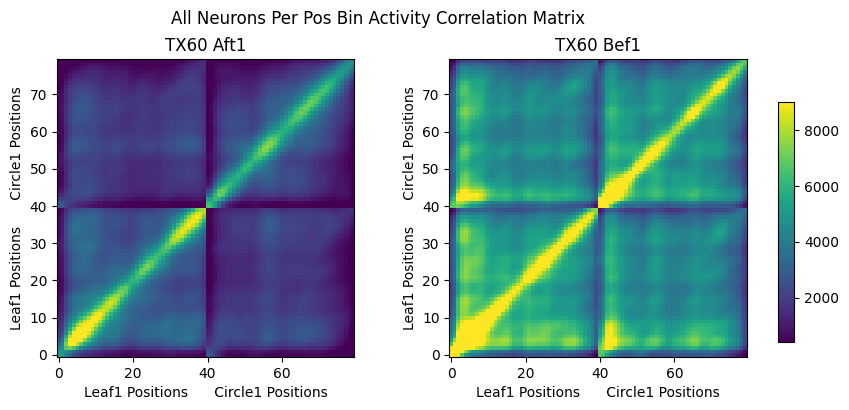

(80, 80) (80, 80)


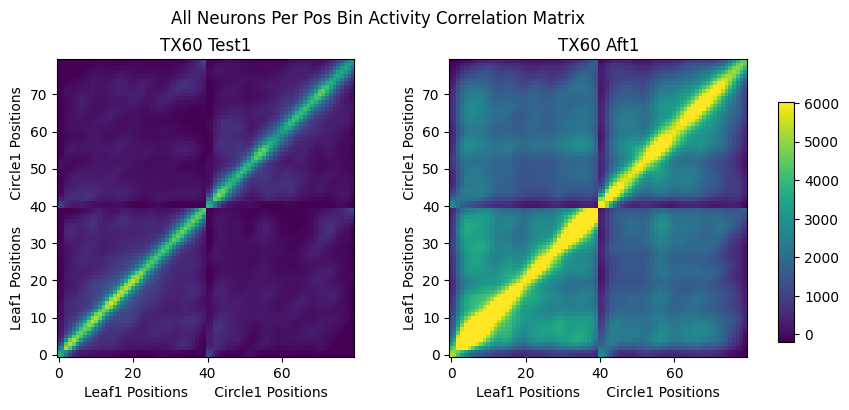

supervised before and after training cosine similarity: 0.9386360698090709
supervised leaf circle before and after training cosine similarity: 0.955140635136251
supervised test and after training cosine similarity: 0.8346302652176907
supervised leaf circle test and after training cosine similarity: 0.5738755843097636
(80, 80) (80, 80)


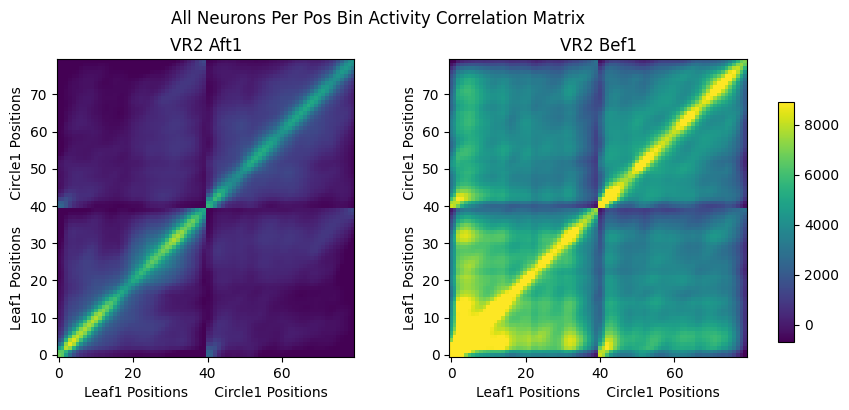

(80, 80) (80, 80)


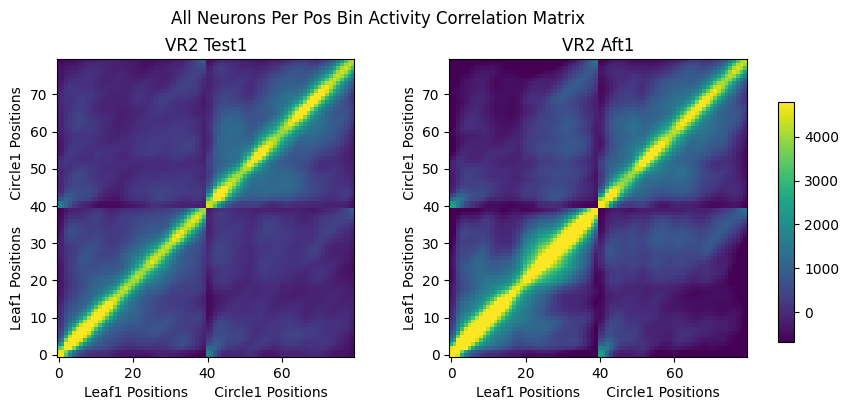

supervised before and after training cosine similarity: 0.7106941006444316
supervised leaf circle before and after training cosine similarity: 0.12931997356310804
supervised test and after training cosine similarity: 0.968696579149283
supervised leaf circle test and after training cosine similarity: 0.7836275107045187
(80, 80) (80, 80)


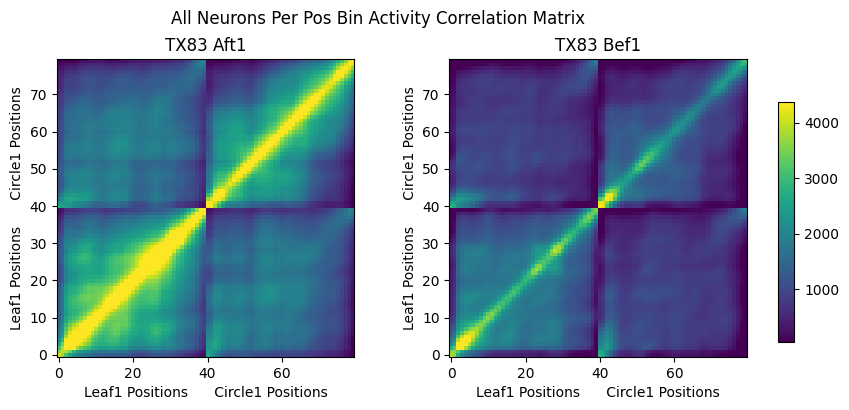

(80, 80) (80, 80)


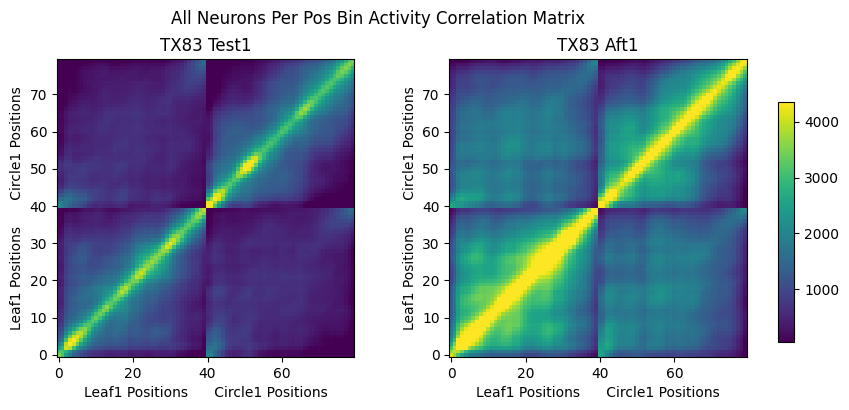

supervised before and after training cosine similarity: 0.9751894489188471
supervised leaf circle before and after training cosine similarity: 0.9701191304796161
supervised test and after training cosine similarity: 0.9592772713395544
supervised leaf circle test and after training cosine similarity: 0.9593863205705817
(80, 80) (80, 80)


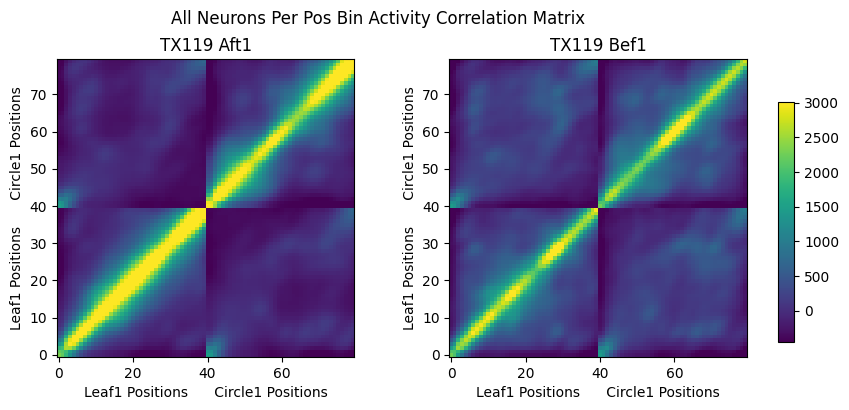

(80, 80) (80, 80)


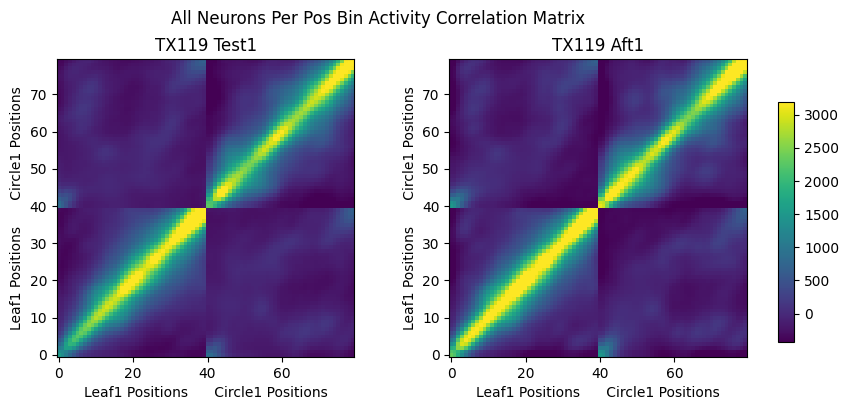

supervised before and after training cosine similarity: 0.9456901548087191
supervised leaf circle before and after training cosine similarity: 0.549928921402194
supervised test and after training cosine similarity: 0.9898273337300596
supervised leaf circle test and after training cosine similarity: 0.8925984425008537
(80, 80) (80, 80)


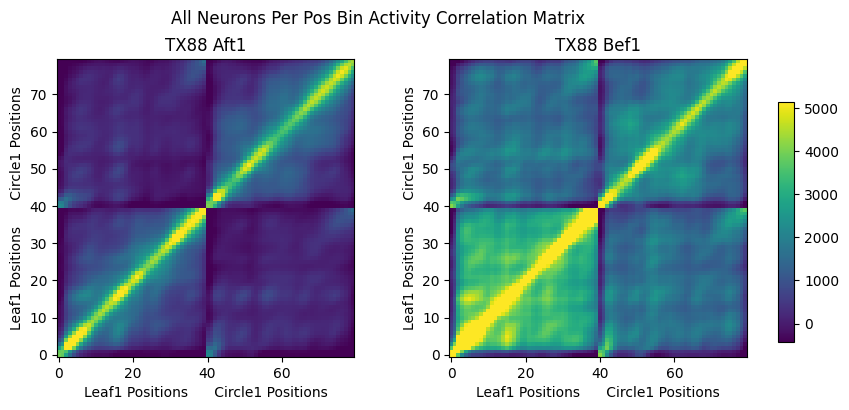

(80, 80) (80, 80)


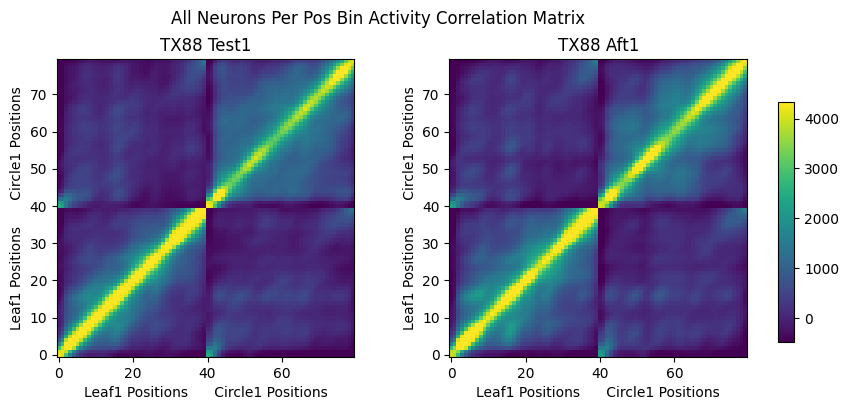

supervised before and after training cosine similarity: 0.865860203579752
supervised leaf circle before and after training cosine similarity: 0.6450899296424154
supervised test and after training cosine similarity: 0.987331903938469
supervised leaf circle test and after training cosine similarity: 0.9346238832736502
(80, 80) (80, 80)


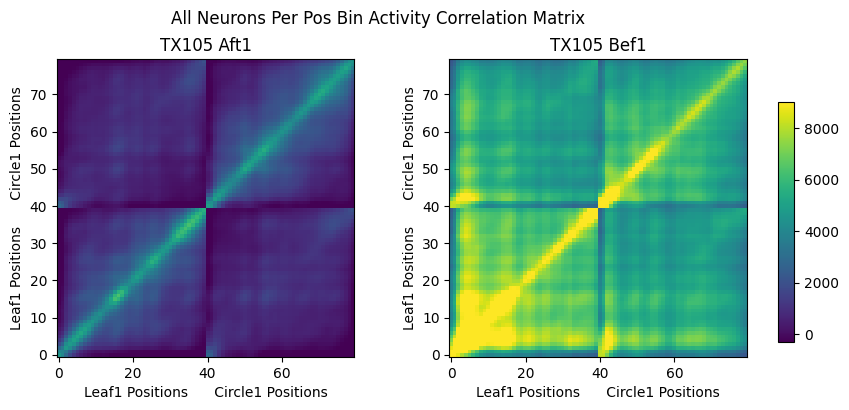

(80, 80) (80, 80)


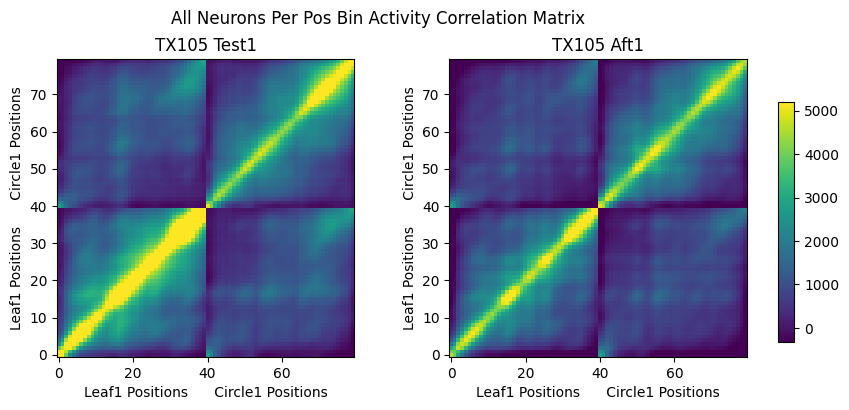

supervised before and after training cosine similarity: 0.8121009921011438
supervised leaf circle before and after training cosine similarity: 0.8222189918827489
supervised test and after training cosine similarity: 0.9797647803184442
supervised leaf circle test and after training cosine similarity: 0.9694665355053151
(80, 80) (80, 80)


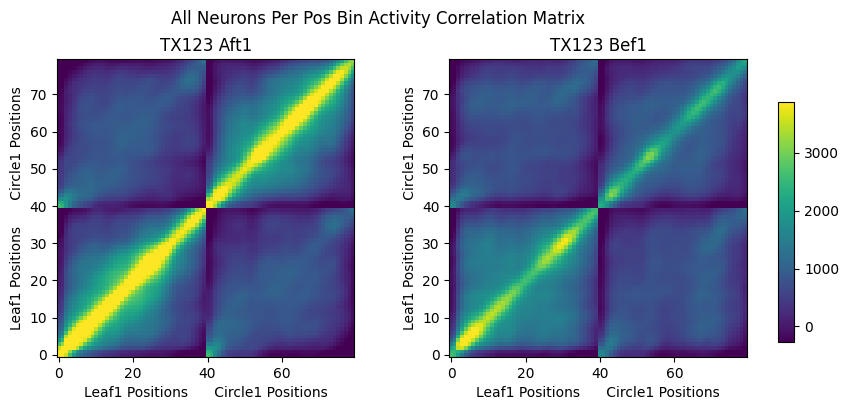

(80, 80) (80, 80)


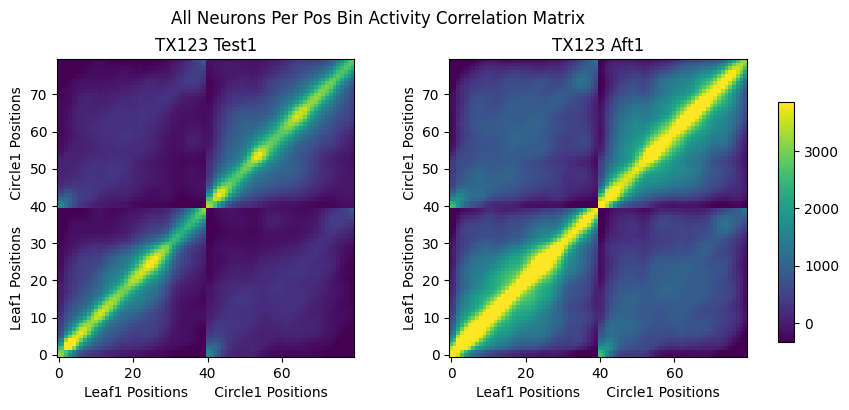

supervised before and after training cosine similarity: 0.9587978957390737
supervised leaf circle before and after training cosine similarity: 0.9639721789634484
supervised test and after training cosine similarity: 0.9542417613368874
supervised leaf circle test and after training cosine similarity: 0.6548191788052224
(80, 80) (80, 80)


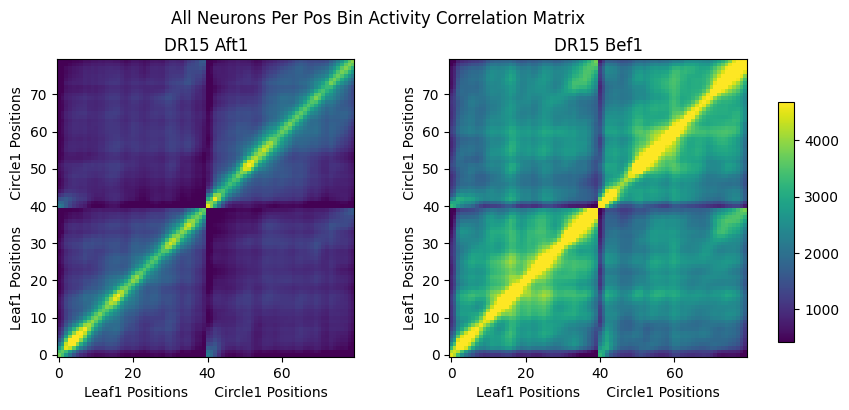

(80, 80) (80, 80)


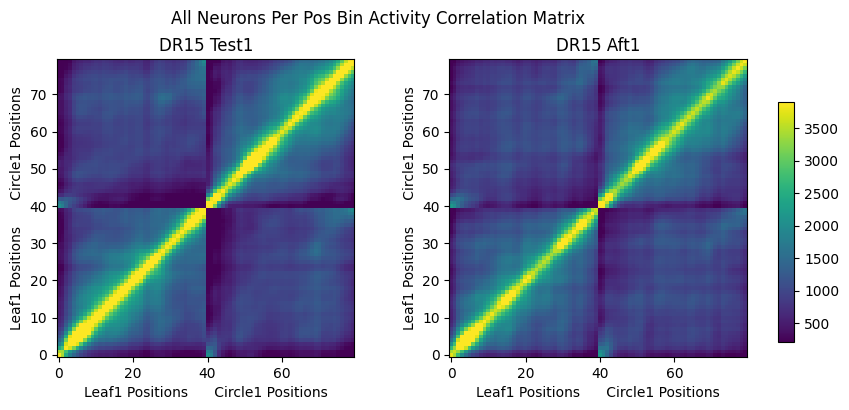

supervised before and after training cosine similarity: 0.9654705724597031
supervised leaf circle before and after training cosine similarity: 0.9893617303038712
supervised test and after training cosine similarity: 0.9892836284143365
supervised leaf circle test and after training cosine similarity: 0.9804706027565843
(80, 80) (80, 80)


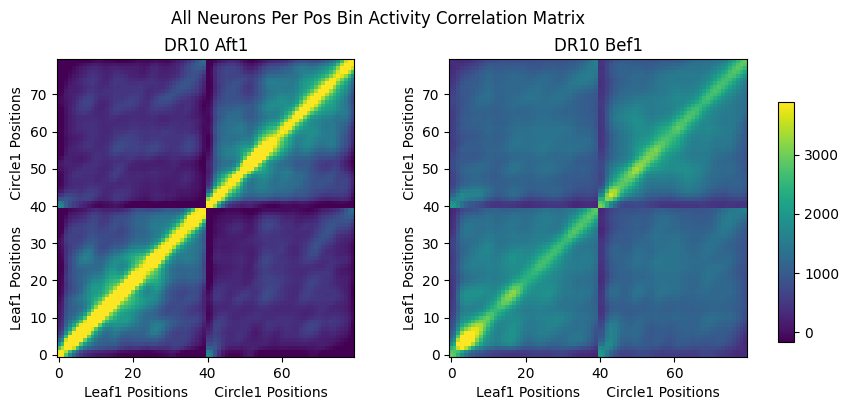

(80, 80) (80, 80)


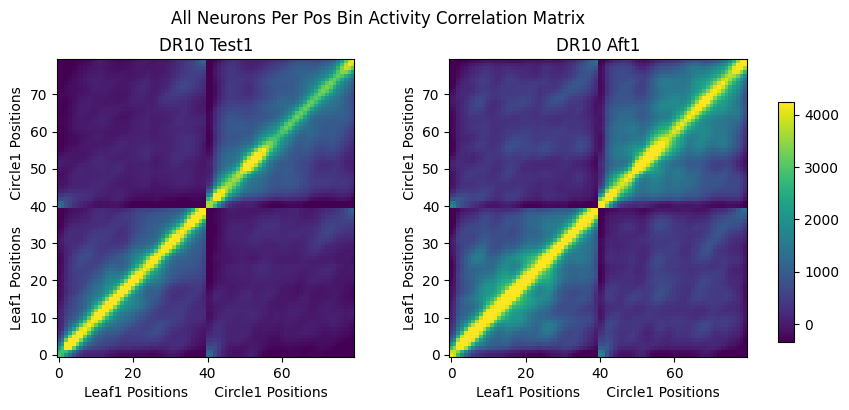

supervised before and after training cosine similarity: 0.8626040786355519
supervised leaf circle before and after training cosine similarity: 0.863819413369948
supervised test and after training cosine similarity: 0.9776697977294824
supervised leaf circle test and after training cosine similarity: 0.6573506900333285
supervised average aft matrix shape: (80, 80)


In [908]:
sup_animal_list = ['TX109', 'TX108', 'TX60', 'VR2']
unsup_animal_list = ['TX83', 'TX119', 'TX88', 'TX105', 'TX123', 'DR15', 'DR10']
sup_aft1_svd_neuron_pos_list = [sup_aft1_neuron_pos, sup1_aft1_neuron_pos, sup2_aft1_neuron_pos, sup3_aft1_neuron_pos]
sup_bef1_svd_neuron_pos_list = [sup_bef1_neuron_pos, sup1_bef1_neuron_pos, sup2_bef1_neuron_pos, sup3_bef1_neuron_pos]
sup_test1_svd_neuron_pos_list = [sup_test1_neuron_pos, sup1_test1_neuron_pos, sup2_test1_neuron_pos, sup3_test1_neuron_pos]
unsup_aft1_svd_neuron_pos_list = [unsup_aft1_neuron_pos, unsup1_aft1_neuron_pos, unsup2_aft1_neuron_pos, unsup3_aft1_neuron_pos, unsup4_aft1_neuron_pos, unsup5_aft1_neuron_pos, unsup6_aft1_neuron_pos]
unsup_bef1_svd_neuron_pos_list = [unsup_bef1_neuron_pos, unsup1_bef1_neuron_pos, unsup2_bef1_neuron_pos, unsup3_bef1_neuron_pos, unsup4_bef1_neuron_pos, unsup5_bef1_neuron_pos, unsup6_bef1_neuron_pos]
unsup_test1_svd_neuron_pos_list = [unsup_test1_neuron_pos, unsup1_test1_neuron_pos, unsup2_test1_neuron_pos, unsup3_test1_neuron_pos, unsup4_test1_neuron_pos, unsup5_test1_neuron_pos, unsup6_test1_neuron_pos]

sup_aft = []
sup_bef = []
sup_test = []
unsup_aft = []
unsup_bef = []
unsup_test = []
for i, animal in enumerate(sup_animal_list):
    aft, bef, test = rdm_analysis(sup_aft1_svd_neuron_pos_list[i], sup_bef1_svd_neuron_pos_list[i], sup_test1_svd_neuron_pos_list[i], animal, method='corr')
    sup_aft.append(aft)
    sup_bef.append(bef)
    sup_test.append(test)
for i, animal in enumerate(unsup_animal_list):
    aft, bef, test = rdm_analysis(unsup_aft1_svd_neuron_pos_list[i], unsup_bef1_svd_neuron_pos_list[i], unsup_test1_svd_neuron_pos_list[i], animal, method='corr')
    unsup_aft.append(aft)
    unsup_bef.append(bef)
    unsup_test.append(test)

sup_aft_avg_mat = np.mean(sup_aft, axis=0)
sup_bef_avg_mat = np.mean(sup_bef, axis=0)
sup_test_avg_mat = np.mean(sup_test, axis=0)
unsup_aft_avg_mat = np.mean(unsup_aft, axis=0)
unsup_bef_avg_mat = np.mean(unsup_bef, axis=0)
unsup_test_avg_mat = np.mean(unsup_test, axis=0)
print(f'supervised average aft matrix shape: {sup_aft_avg_mat.shape}')


In [11]:
def visualize_3corr_matrix(cm_aft, cm_bef, cm_test, title1, title2, title3, vmin=None, vmax=None):

    print(cm_aft.shape, cm_bef.shape)
    
    # color scale from finite values 
    if vmin is None or vmax is None:
        all_vals = np.concatenate([cm_aft[np.isfinite(cm_aft)], cm_bef[np.isfinite(cm_bef)], cm_test[np.isfinite(cm_test)]]) \
                   if np.isfinite(cm_aft).any() and np.isfinite(cm_bef).any() and np.isfinite(cm_test).any() else np.array([0.0])
        vmin, vmax = np.percentile(all_vals, [2, 98]) if all_vals.size > 1 else (-1.0, 1.0)

    fig, ax = plt.subplots(1, 3, figsize=(12, 4))
    fig.suptitle('All Neurons Per Pos Bin Activity Correlation Matrix', fontsize=12)

    im0 = ax[0].imshow(cm_bef, cmap='RdBu_r', vmin=vmin, vmax=vmax)
    ax[0].set_title(title2)
    ax[0].set_xlabel('Leaf1 Positions      Circle1 Positions')
    ax[0].set_ylabel('Leaf1 Positions      Circle1 Positions')
    ax[0].invert_yaxis()
    ax[0].grid(False)

    im1 = ax[1].imshow(cm_aft, cmap='RdBu_r', vmin=vmin, vmax=vmax)
    ax[1].set_title(title1)
    ax[1].set_xlabel('Leaf1 Positions      Circle1 Positions')
    ax[1].set_ylabel('Leaf1 Positions      Circle1 Positions')
    ax[1].invert_yaxis()
    ax[1].grid(False)

    im2 = ax[2].imshow(cm_test, cmap='RdBu_r', vmin=vmin, vmax=vmax)
    ax[2].set_title(title3)
    ax[2].set_xlabel('Leaf1 Positions      Circle1 Positions')
    ax[2].set_ylabel('Leaf1 Positions      Circle1 Positions')
    ax[2].invert_yaxis()
    ax[2].grid(False)

    # single colorbar for all subplots
    cax = fig.add_axes([1.0, 0.15, 0.02, 0.6])  # left, bottom, width, height
    fig.colorbar(im0, cax=cax, orientation='vertical')
    plt.tight_layout()
    plt.show()

visualize_3corr_matrix(sup_aft_avg_mat, 
                        sup_bef_avg_mat, sup_test_avg_mat,
                        'Supervised Aft1', 'Supervised Bef1', 'Supervised Test1'
                        #, vmin=0.0, vmax=0.7
                        )
visualize_3corr_matrix(unsup_aft_avg_mat, 
                        unsup_bef_avg_mat, unsup_test_avg_mat,
                        'Unsupervised Aft1', 'Unsupervised Bef1', 'Unsupervised Test1'
                        #, vmin=0.0, vmax=0.7
                        )

NameError: name 'sup_aft_avg_mat' is not defined

(80, 80) (80, 80)


/tmp/ipykernel_1030/1108165686.py:31: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


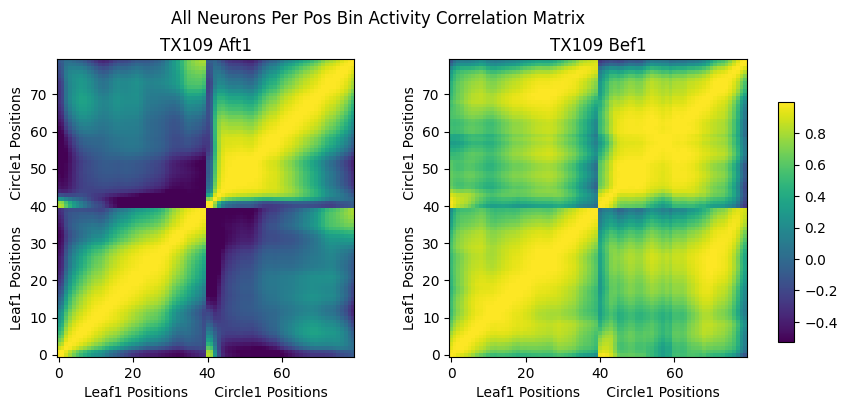

(80, 80) (80, 80)


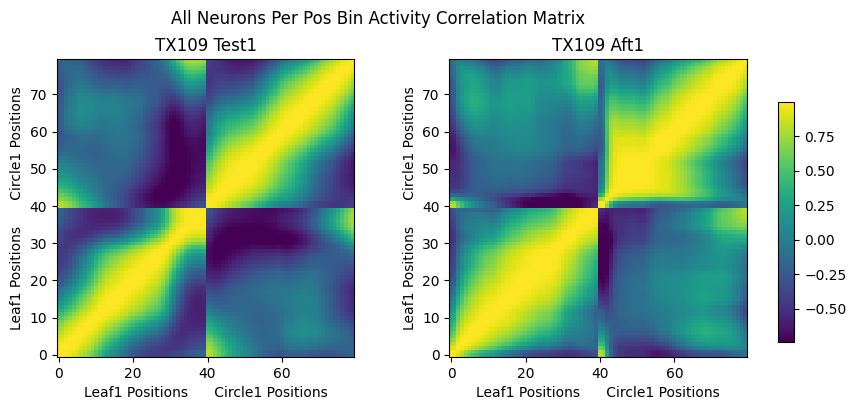

supervised before and after training cosine similarity: 0.6267718794232594
supervised leaf circle before and after training cosine similarity: -0.04171522565995522
supervised test and after training cosine similarity: 0.8210669675033768
supervised leaf circle test and after training cosine similarity: 0.5919946247807983
(80, 80) (80, 80)


/tmp/ipykernel_1030/1108165686.py:31: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


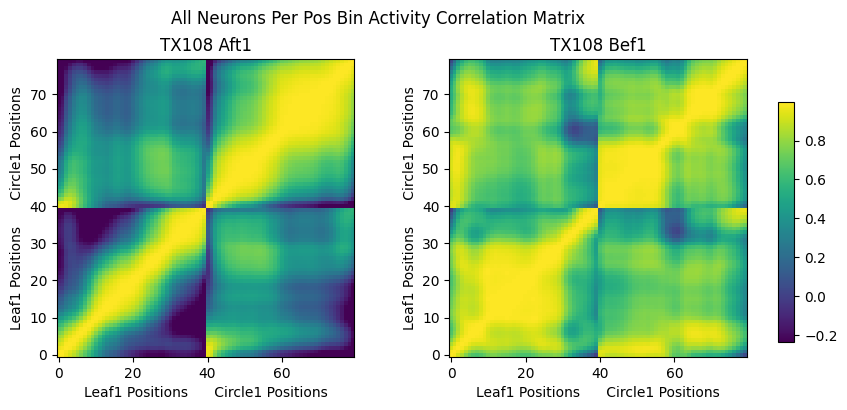

(80, 80) (80, 80)


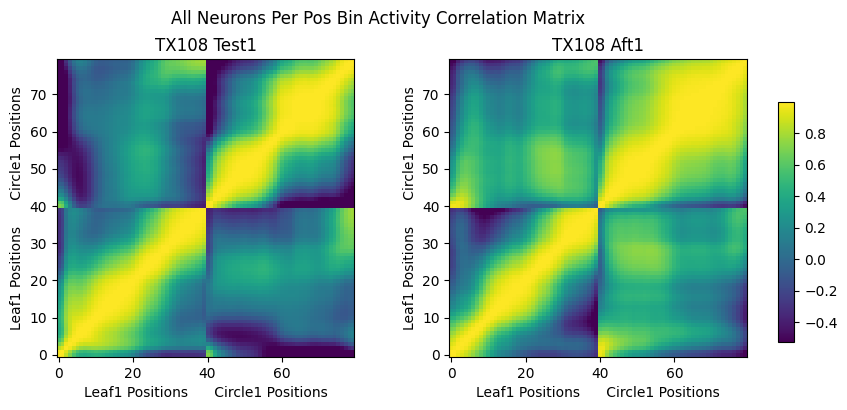

supervised before and after training cosine similarity: 0.8402836294884116
supervised leaf circle before and after training cosine similarity: 0.8271379860614543
supervised test and after training cosine similarity: 0.785171668356091
supervised leaf circle test and after training cosine similarity: 0.3270499817654935
(80, 80) (80, 80)


/tmp/ipykernel_1030/1108165686.py:31: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


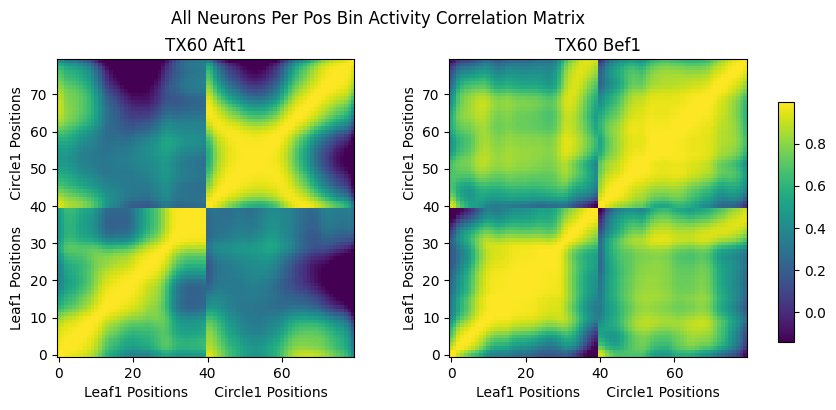

(80, 80) (80, 80)


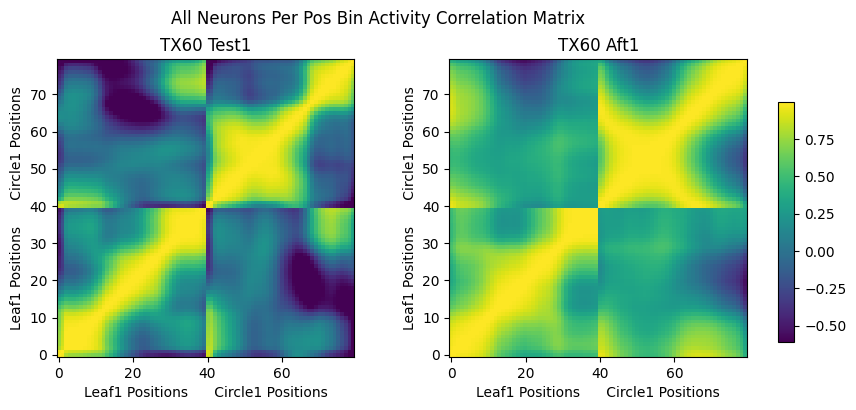

supervised before and after training cosine similarity: 0.8724511995815942
supervised leaf circle before and after training cosine similarity: 0.802497549012166
supervised test and after training cosine similarity: 0.7397559234682543
supervised leaf circle test and after training cosine similarity: 0.22375947345807487
(80, 80) (80, 80)


/tmp/ipykernel_1030/1108165686.py:31: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


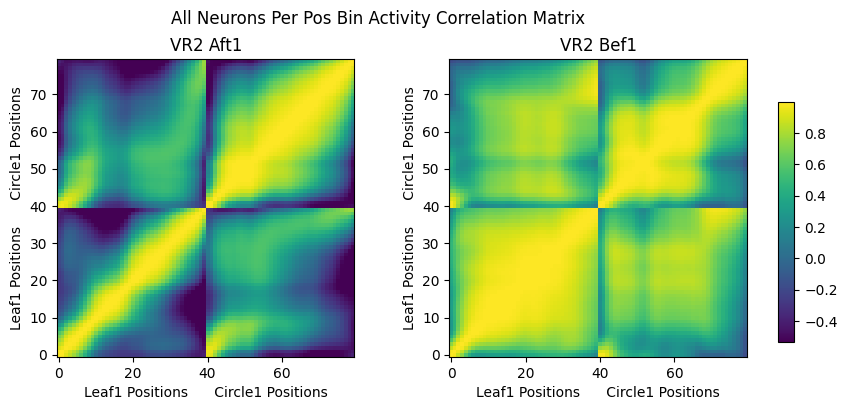

(80, 80) (80, 80)


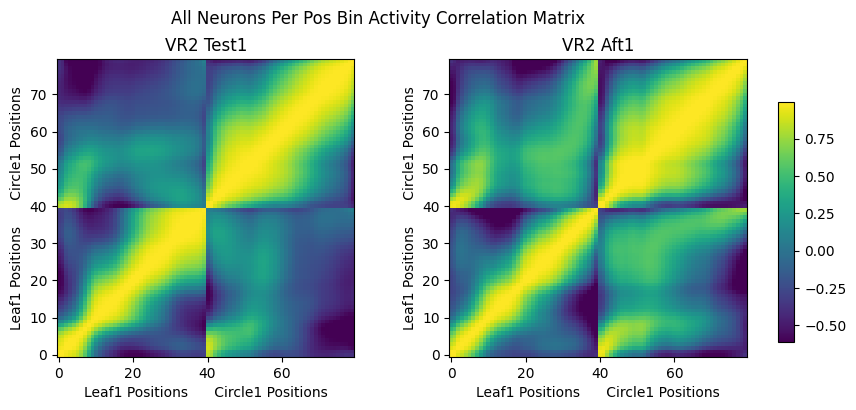

supervised before and after training cosine similarity: 0.6851530805265598
supervised leaf circle before and after training cosine similarity: 0.5938444122425229
supervised test and after training cosine similarity: 0.8855913454739783
supervised leaf circle test and after training cosine similarity: 0.6415981688082454
(80, 80) (80, 80)


/tmp/ipykernel_1030/1108165686.py:31: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


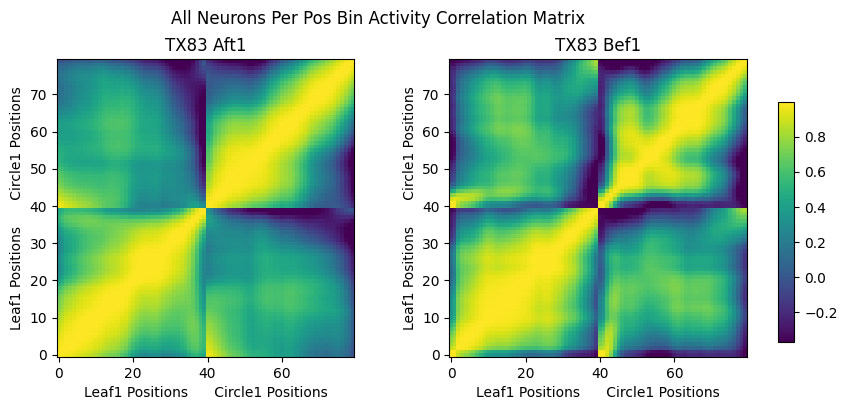

(80, 80) (80, 80)


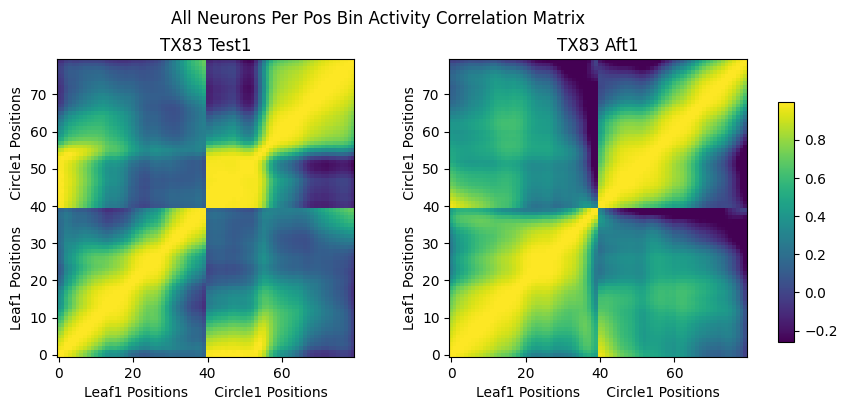

supervised before and after training cosine similarity: 0.909942433492295
supervised leaf circle before and after training cosine similarity: 0.7915563187918225
supervised test and after training cosine similarity: 0.8998018891079945
supervised leaf circle test and after training cosine similarity: 0.7632817816422701
(80, 80) (80, 80)


/tmp/ipykernel_1030/1108165686.py:31: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


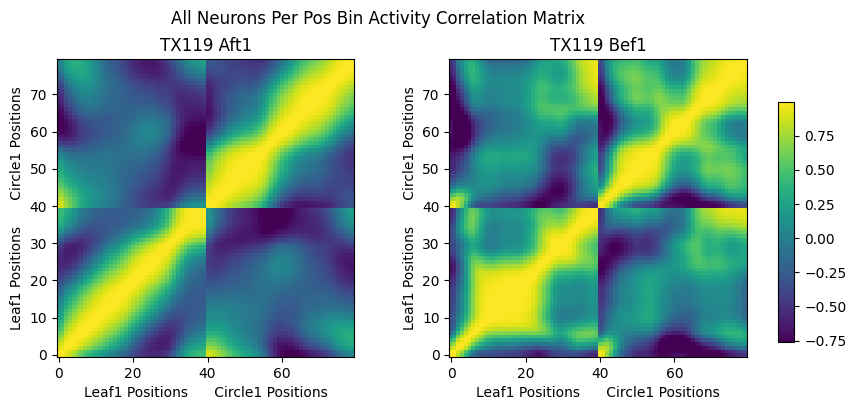

(80, 80) (80, 80)


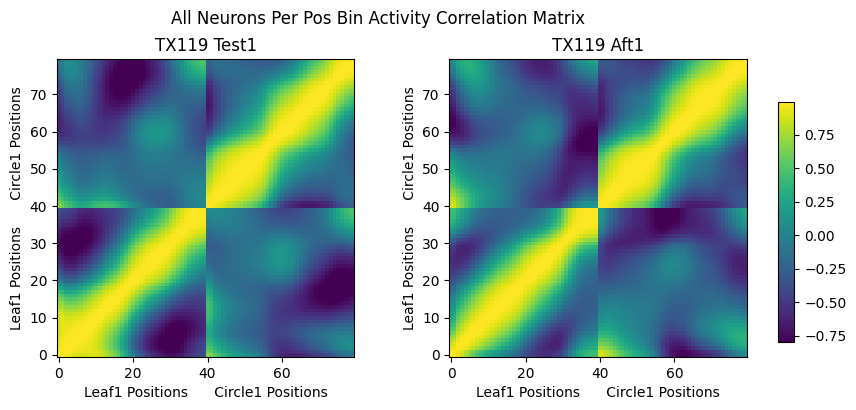

supervised before and after training cosine similarity: 0.6523063864312011
supervised leaf circle before and after training cosine similarity: 0.22654927463785998
supervised test and after training cosine similarity: 0.8744338941091483
supervised leaf circle test and after training cosine similarity: 0.65769455020624
(80, 80) (80, 80)


/tmp/ipykernel_1030/1108165686.py:31: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


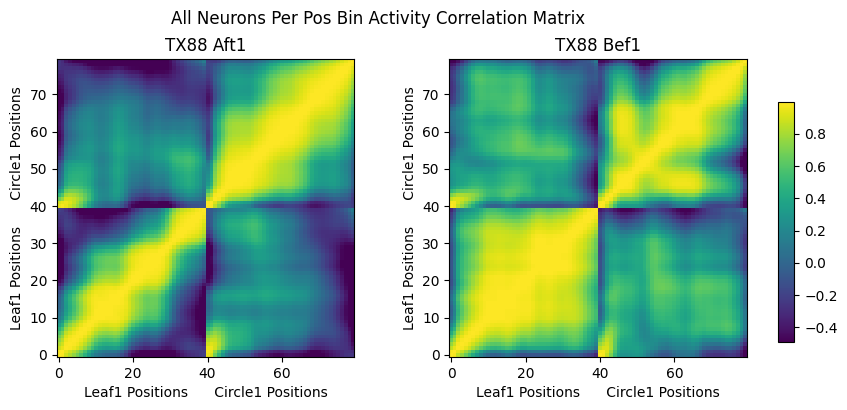

(80, 80) (80, 80)


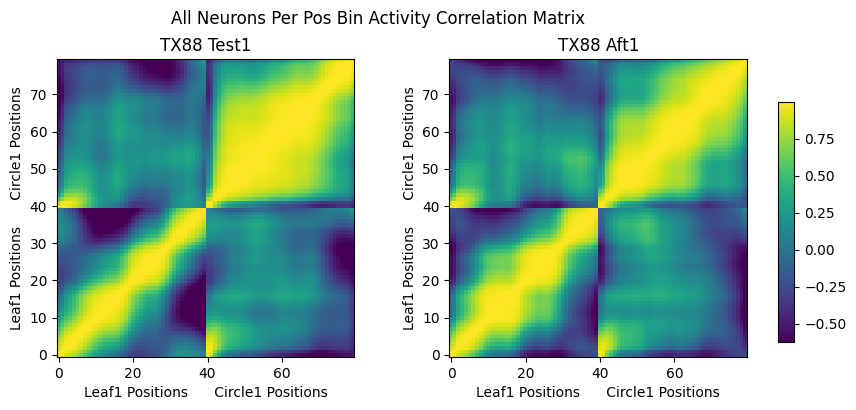

supervised before and after training cosine similarity: 0.7771467716510102
supervised leaf circle before and after training cosine similarity: 0.45143462990174205
supervised test and after training cosine similarity: 0.9504379091193956
supervised leaf circle test and after training cosine similarity: 0.9094387458719568
(80, 80) (80, 80)


/tmp/ipykernel_1030/1108165686.py:31: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


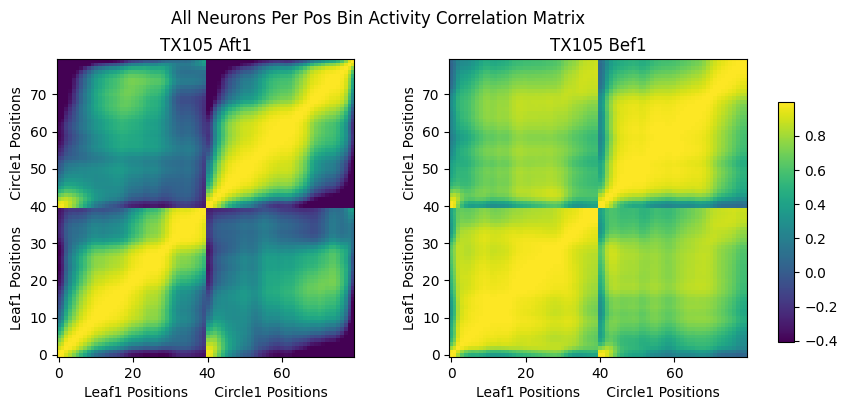

(80, 80) (80, 80)


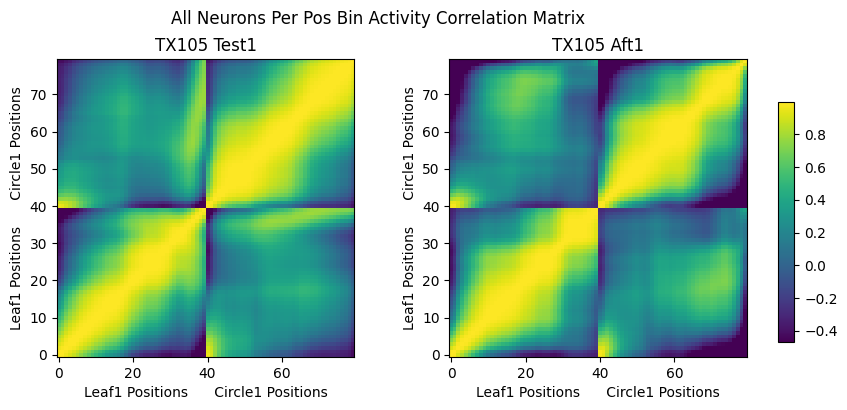

supervised before and after training cosine similarity: 0.7792598974330944
supervised leaf circle before and after training cosine similarity: 0.6177520798984881
supervised test and after training cosine similarity: 0.9038925687437698
supervised leaf circle test and after training cosine similarity: 0.676256979590201
(80, 80) (80, 80)


/tmp/ipykernel_1030/1108165686.py:31: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


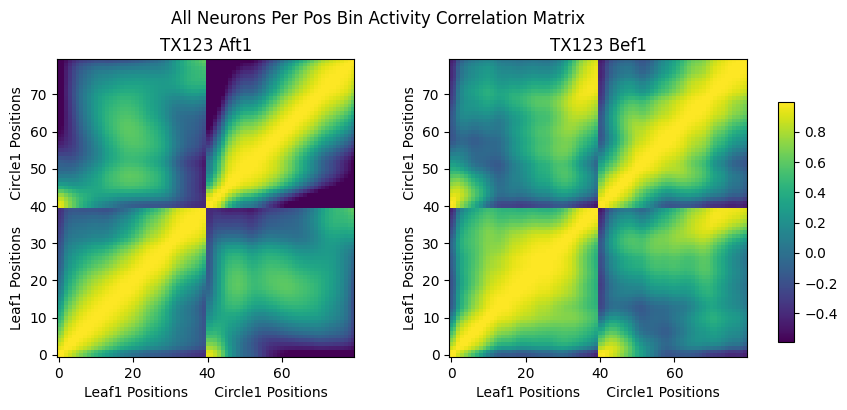

(80, 80) (80, 80)


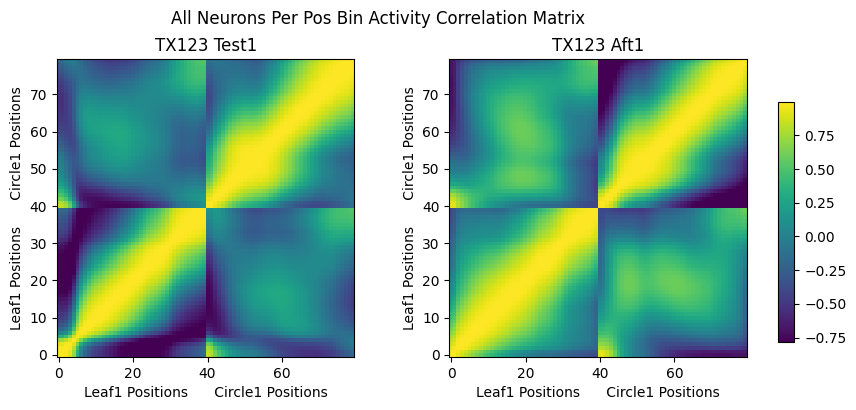

supervised before and after training cosine similarity: 0.8344603737403953
supervised leaf circle before and after training cosine similarity: 0.5848783776610685
supervised test and after training cosine similarity: 0.748612816046545
supervised leaf circle test and after training cosine similarity: 0.34438347282618914
(80, 80) (80, 80)


/tmp/ipykernel_1030/1108165686.py:31: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


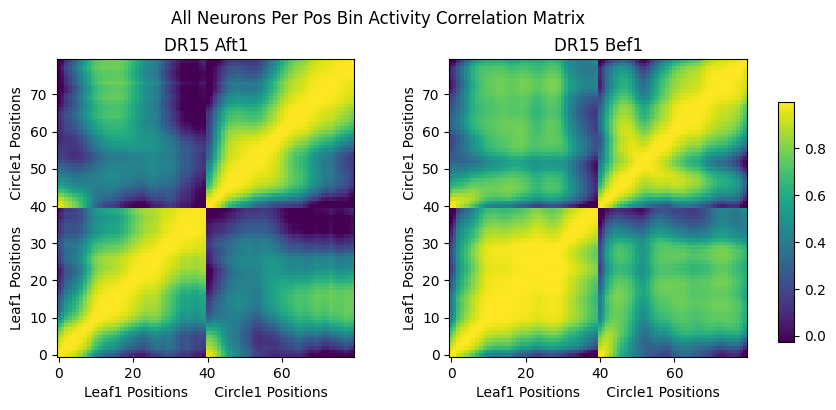

(80, 80) (80, 80)


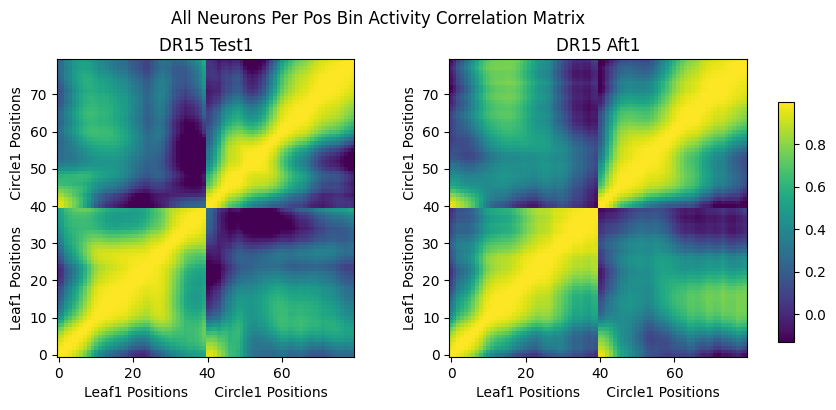

supervised before and after training cosine similarity: 0.9630870965650681
supervised leaf circle before and after training cosine similarity: 0.932666741451071
supervised test and after training cosine similarity: 0.9514884781476717
supervised leaf circle test and after training cosine similarity: 0.8491678141878641
(80, 80) (80, 80)


/tmp/ipykernel_1030/1108165686.py:31: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


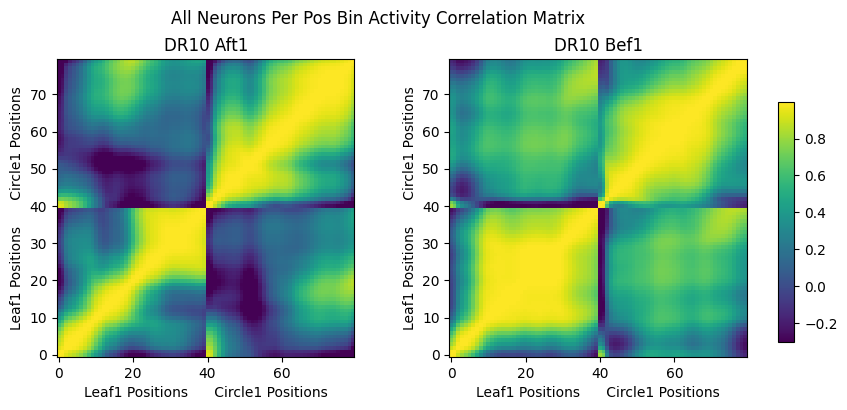

(80, 80) (80, 80)


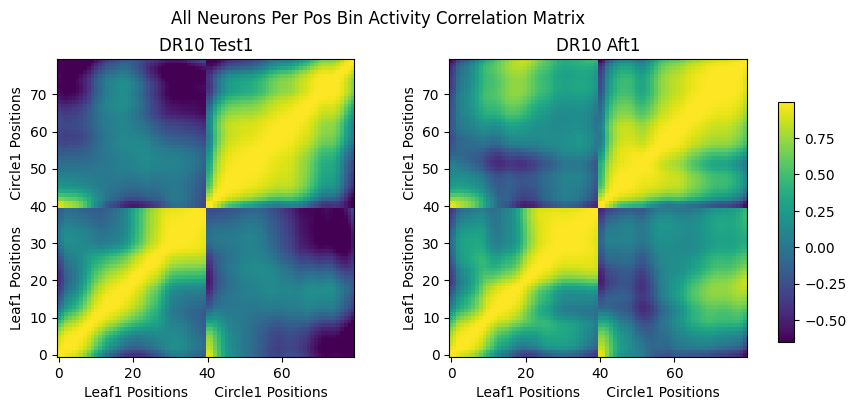

supervised before and after training cosine similarity: 0.8260190222054425
supervised leaf circle before and after training cosine similarity: 0.46647668077323734
supervised test and after training cosine similarity: 0.7711392608268983
supervised leaf circle test and after training cosine similarity: -0.1649588189163819


In [ ]:
sup_animal_list = ['TX109', 'TX108', 'TX60', 'VR2']
unsup_animal_list = ['TX83', 'TX119', 'TX88', 'TX105', 'TX123', 'DR15', 'DR10']
sup_aft1_svd_neuron_pos_list = [sup_aft1_neuron_pos, sup1_aft1_neuron_pos, sup2_aft1_neuron_pos, sup3_aft1_neuron_pos]
sup_bef1_svd_neuron_pos_list = [sup_bef1_neuron_pos, sup1_bef1_neuron_pos, sup2_bef1_neuron_pos, sup3_bef1_neuron_pos]
sup_test1_svd_neuron_pos_list = [sup_test1_neuron_pos, sup1_test1_neuron_pos, sup2_test1_neuron_pos, sup3_test1_neuron_pos]
unsup_aft1_svd_neuron_pos_list = [unsup_aft1_neuron_pos, unsup1_aft1_neuron_pos, unsup2_aft1_neuron_pos, unsup3_aft1_neuron_pos, unsup4_aft1_neuron_pos, unsup5_aft1_neuron_pos, unsup6_aft1_neuron_pos]
unsup_bef1_svd_neuron_pos_list = [unsup_bef1_neuron_pos, unsup1_bef1_neuron_pos, unsup2_bef1_neuron_pos, unsup3_bef1_neuron_pos, unsup4_bef1_neuron_pos, unsup5_bef1_neuron_pos, unsup6_bef1_neuron_pos]
unsup_test1_svd_neuron_pos_list = [unsup_test1_neuron_pos, unsup1_test1_neuron_pos, unsup2_test1_neuron_pos, unsup3_test1_neuron_pos, unsup4_test1_neuron_pos, unsup5_test1_neuron_pos, unsup6_test1_neuron_pos]

sup_corr1 = []
sup_corr2 = []
sup_corr3 = []
sup_corr4 = []
unsup_corr1 = []
unsup_corr2 = []
unsup_corr3 = []
unsup_corr4 = []

'''
for animal in sup_animal_list:
    i = sup_animal_list.index(animal)
    aft1_svd_neuron_pos = sup_aft1_svd_neuron_pos_list[i]
    bef1_svd_neuron_pos = sup_bef1_svd_neuron_pos_list[i]
    test1_svd_neuron_pos = sup_test1_svd_neuron_pos_list[i]
    corr1, corr2, corr3, corr4 = rdm_analysis(aft1_svd_neuron_pos, bef1_svd_neuron_pos, test1_svd_neuron_pos, animal, method='Euclidean')
    sup_corr1.append(corr1)
    sup_corr2.append(corr2)
    sup_corr3.append(corr3)
    sup_corr4.append(corr4)

'''
for i in range(len(sup_animal_list)):
    corr1, corr2, corr3, corr4 = rdm_analysis(aft1_svd[:,:5], bef1_svd[:,:5], test1_svd[:,:5], sup_animal_list[i], method='corr')
    sup_corr1.append(corr1)
    sup_corr2.append(corr2)
    sup_corr3.append(corr3)
    sup_corr4.append(corr4)

'''
for animal in unsup_animal_list:
    i = unsup_animal_list.index(animal)
    aft1_svd_neuron_pos = unsup_aft1_svd_neuron_pos_list[i]
    bef1_svd_neuron_pos = unsup_bef1_svd_neuron_pos_list[i]
    test1_svd_neuron_pos = unsup_test1_svd_neuron_pos_list[i]
    corr1, corr2, corr3, corr4 = rdm_analysis(aft1_svd_neuron_pos, bef1_svd_neuron_pos, test1_svd_neuron_pos, animal, method='Euclidean')
    unsup_corr1.append(corr1)
    unsup_corr2.append(corr2)
    unsup_corr3.append(corr3)
    unsup_corr4.append(corr4)
'''

for i in range(len(unsup_animal_list)):
    aft1_svd, bef1_svd, test1_svd = svd_after_tuning(unsup_aft1_neuron_pos_list[i], unsup_bef1_neuron_pos_list[i], unsup_test1_neuron_pos_list[i])
    corr1, corr2, corr3, corr4 = rdm_analysis(aft1_svd[:, :5], bef1_svd[:, :5], test1_svd[:, :5], unsup_animal_list[i], method='corr')
    unsup_corr1.append(corr1)
    unsup_corr2.append(corr2)
    unsup_corr3.append(corr3)
    unsup_corr4.append(corr4)


Text(7, 1.0038513252591994, 'ns test-aft')

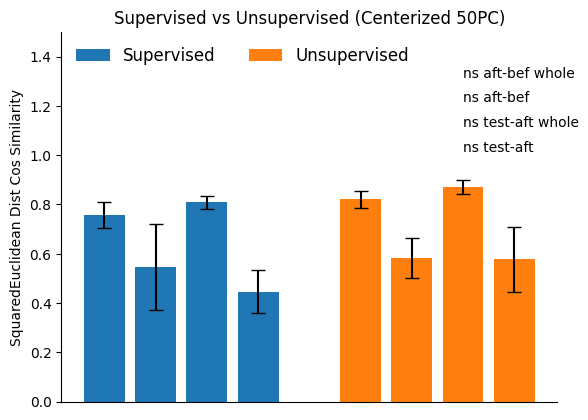

In [335]:
from scipy.stats import ttest_ind

sup_corr_mat = np.array([sup_corr1, sup_corr2, sup_corr3, sup_corr4]).T
unsup_corr_mat = np.array([unsup_corr1, unsup_corr2, unsup_corr3, unsup_corr4]).T

sup_corr_mean = np.mean(sup_corr_mat, axis=0)
unsup_corr_mean = np.mean(unsup_corr_mat, axis=0)
sup_corr_sem = np.std(sup_corr_mat, axis=0) / np.sqrt(sup_corr_mat.shape[0])
unsup_corr_sem = np.std(unsup_corr_mat, axis=0) / np.sqrt(unsup_corr_mat.shape[0])

_, p_val1 = ttest_ind(sup_corr_mat[:, 0], unsup_corr_mat[:, 0], equal_var=False)
_, p_val2 = ttest_ind(sup_corr_mat[:, 1], unsup_corr_mat[:, 1], equal_var=False)
_, p_val3 = ttest_ind(sup_corr_mat[:, 2], unsup_corr_mat[:, 2], equal_var=False)
_, p_val4 = ttest_ind(sup_corr_mat[:, 3], unsup_corr_mat[:, 3], equal_var=False)

def p_to_stars(p):
    return "****" if p < 1e-4 else "***" if p < 1e-3 else "**" if p < 1e-2 else "*" if p < 5e-2 else "ns"

plt.figure()

n_sup = len(sup_corr_mean)
n_unsup = len(unsup_corr_mean)
gap = 1 
x_sup = np.arange(n_sup)
x_unsup = np.arange(n_unsup) + n_sup + gap

plt.bar(x_sup, sup_corr_mean, yerr=sup_corr_sem, capsize=5, width=0.8, color='tab:blue', label='Supervised')
plt.bar(x_unsup, unsup_corr_mean, yerr=unsup_corr_sem, capsize=5, width=0.8, color='tab:orange', label='Unsupervised')
#plt.xticks(np.concatenate([x_sup, x_unsup]), [f'{i+1}' for i in range(n_sup)] + [f'{i+1}' for i in range(n_unsup)], rotation=0)
plt.xticks([])
plt.ylabel('SquaredEuclidean Dist Cos Similarity')
plt.ylim([0, 1.5])
plt.title('Supervised vs Unsupervised (Centerized 50PC)')
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.legend(frameon=False, ncol=2, loc='upper left', fontsize=12)

y_max = max(np.max(sup_corr_mean + sup_corr_sem), np.max(unsup_corr_mean + unsup_corr_sem))
y_star = y_max + 0.004  # raise if you need more space
x1, x2 = x_sup[-1], x_unsup[0]
#plt.plot([x1, x1, x2, x2], [y_star-0.001, y_star, y_star, y_star-0.001], lw=1, c='k')
plt.text(x_unsup[2], y_star + 0.4, f'{p_to_stars(p_val1)} aft-bef whole', ha='left', va='bottom')
plt.text(x_unsup[2], y_star + 0.3, f'{p_to_stars(p_val2)} aft-bef', ha='left', va='bottom')
plt.text(x_unsup[2], y_star + 0.2, f'{p_to_stars(p_val3)} test-aft whole', ha='left', va='bottom')
plt.text(x_unsup[2], y_star + 0.1, f'{p_to_stars(p_val4)} test-aft', ha='left', va='bottom')


### Corr Matrix Per Region

In [914]:
sup_aft1_sessions = [
    "TX109_2023_04_07_1",
    "TX108_2023_03_22_1",
    "TX60_2021_05_04_1",
    "VR2_2021_04_06_1"
]

sup_bef1_sessions = [
    "TX109_2023_03_27_1",
    "TX108_2023_03_13_1",
    "TX60_2021_04_10_1",
    "VR2_2021_03_20_1"
]

sup_test1_sessions = [
    "TX109_2023_04_18_1",
    "TX108_2023_03_25_1",
    "TX60_2021_06_07_1",
    "VR2_2021_04_11_1"
]

unsup_aft1_sessions = [
    "TX83_2022_08_29_1",
    "TX119_2023_12_23_1",
    "TX88_2022_06_17_2",
    "TX105_2022_10_19_2",
    "TX123_2024_01_02_1",
    "DR15_2022_10_19_1",
    "DR10_2022_07_19_1"
]

unsup_bef1_sessions = [
    "TX83_2022_08_17_1",
    "TX119_2023_12_14_1",
    "TX88_2022_06_13_2",
    "TX105_2022_10_08_2",
    "TX123_2023_12_21_1",
    "DR15_2022_10_09_1",
    "DR10_2022_07_12_1"
]

unsup_test1_sessions = [
    "TX83_2022_08_31_1",
    "TX119_2023_12_24_1",
    "TX88_2022_06_20_1",
    "TX105_2022_10_21_1",
    "TX123_2024_01_03_1",
    "DR15_2022_10_20_1",
    "DR10_2022_07_21_1"
]
sup_aft1_iarea_list = []
sup_bef1_iarea_list = []
sup_test1_iarea_list = []
unsup_aft1_iarea_list = []
unsup_bef1_iarea_list = []
unsup_test1_iarea_list = []
for session in sup_aft1_sessions:
    sup_aft1_iarea_list.append(np.load(os.path.join(root, 'spk', session[:-1] + 'trans.npz'), allow_pickle=1)['iarea'])
for session in sup_bef1_sessions:
    sup_bef1_iarea_list.append(np.load(os.path.join(root, 'spk', session[:-1] + 'trans.npz'), allow_pickle=1)['iarea'])
for session in sup_test1_sessions:
    sup_test1_iarea_list.append(np.load(os.path.join(root, 'spk', session[:-1] + 'trans.npz'), allow_pickle=1)['iarea'])
for session in unsup_aft1_sessions:
    unsup_aft1_iarea_list.append(np.load(os.path.join(root, 'spk', session[:-1] + 'trans.npz'), allow_pickle=1)['iarea'])
for session in unsup_bef1_sessions:
    unsup_bef1_iarea_list.append(np.load(os.path.join(root, 'spk', session[:-1] + 'trans.npz'), allow_pickle=1)['iarea'])
for session in unsup_test1_sessions:
    unsup_test1_iarea_list.append(np.load(os.path.join(root, 'spk', session[:-1] + 'trans.npz'), allow_pickle=1)['iarea'])

In [12]:
# function used for define which brain area a neuron belong to
def neu_area_ID(iarea):
    area_name = ['V1', 'mHV', 'lHV', 'aHV']
    idx = {}
    for ar in area_name:
        if ar=='V1':
            idx[ar] = iarea==8
        elif ar=='mHV':
            idx[ar] = (iarea==0) | (iarea==1) | (iarea==2) | (iarea==9)
        elif ar=='lHV':
            idx[ar] = (iarea==5) | (iarea==6)
        elif ar=='aHV':
            idx[ar] = (iarea==3) | (iarea==4)
    return idx

def rdm_analysis_per_region(aft1_neuron_pos_list, bef1_neuron_pos_list, test1_neuron_pos_list, 
                            aft1_iarea_list, bef1_iarea_list, test1_iarea_list, animal_list, animal_type='Supervised'):

    aft_mat = []
    bef_mat = []
    test_mat = []
    aft_mat_regions = {}
    bef_mat_regions = {}
    test_mat_regions = {}
    for i, animal in enumerate(animal_list):
        aft1_neuron_pos = aft1_neuron_pos_list[i]
        bef1_neuron_pos = bef1_neuron_pos_list[i]
        test1_neuron_pos = test1_neuron_pos_list[i]

        aft1_area_idx = neu_area_ID(aft1_iarea_list[i])
        bef1_area_idx = neu_area_ID(bef1_iarea_list[i])
        test1_area_idx = neu_area_ID(test1_iarea_list[i])

        #aft1_neuron_pos = zscore(aft1_neuron_pos)
        #bef1_neuron_pos = zscore(bef1_neuron_pos)
        #test1_neuron_pos = zscore(test1_neuron_pos)
        #print(aft1_neuron_pos[:,0].mean())
            
        #aft_matrix = np.corrcoef(aft1_neuron_pos)
        #bef_matrix = np.corrcoef(bef1_neuron_pos)
        #test_matrix = np.corrcoef(test1_neuron_pos)
        def row_corr_matrix(X):
            # X: (n_samples, n_features)
            Xc = X - X.mean(axis=1, keepdims=True)         # center rows
            Xn = Xc / np.linalg.norm(Xc, axis=1, keepdims=True)  # normalize rows
            return Xn @ Xn.T                               # Pearson r between rows

        aft_mat.append(row_corr_matrix(aft1_neuron_pos))
        bef_mat.append(row_corr_matrix(bef1_neuron_pos))
        test_mat.append(row_corr_matrix(test1_neuron_pos))
        for j, jar in enumerate(['V1', 'mHV', 'lHV', 'aHV']):
            aft_mat_regions[jar] = aft_mat_regions.get(jar, []) + [row_corr_matrix(aft1_neuron_pos[:,aft1_area_idx[jar]])]
            bef_mat_regions[jar] = bef_mat_regions.get(jar, []) + [row_corr_matrix(bef1_neuron_pos[:,bef1_area_idx[jar]])]
            test_mat_regions[jar] = test_mat_regions.get(jar, []) + [row_corr_matrix(test1_neuron_pos[:,test1_area_idx[jar]])]

    aft_mat = np.mean(aft_mat, axis=0)
    bef_mat = np.mean(bef_mat, axis=0)
    test_mat = np.mean(test_mat, axis=0)
    # correlation here (optional: cosine similarity, euclidean distance)
    visualize_3corr_matrix(aft_mat, 
                        bef_mat, test_mat,
                        f'{animal_type} Aft1', f'{animal_type} Bef1', f'{animal_type} Test1'
                        , vmin=-0.8, vmax=0.8
                        )
    
    for jar in ['V1', 'mHV', 'lHV', 'aHV']:
        aft_mat_regions[jar] = np.mean(aft_mat_regions[jar], axis=0)
        bef_mat_regions[jar] = np.mean(bef_mat_regions[jar], axis=0)
        test_mat_regions[jar] = np.mean(test_mat_regions[jar], axis=0)

        visualize_3corr_matrix(aft_mat_regions[jar], 
                            bef_mat_regions[jar], test_mat_regions[jar],
                            f'{animal_type} {jar} Aft1', f'{animal_type} {jar} Bef1', f'{animal_type} {jar} Test1'
                            , vmin=-0.8, vmax=0.8
        )

(80, 80) (80, 80)


/tmp/ipykernel_1030/3423160225.py:38: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


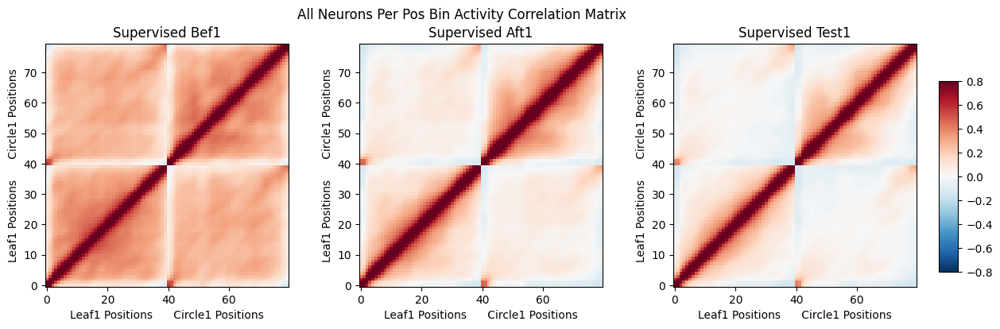

(80, 80) (80, 80)


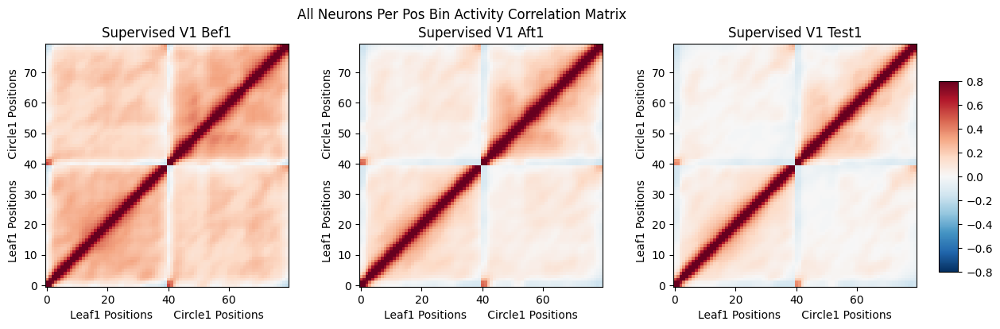

(80, 80) (80, 80)


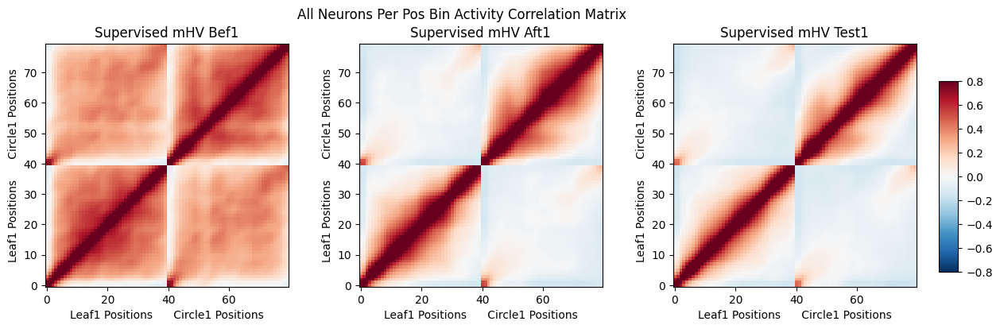

(80, 80) (80, 80)


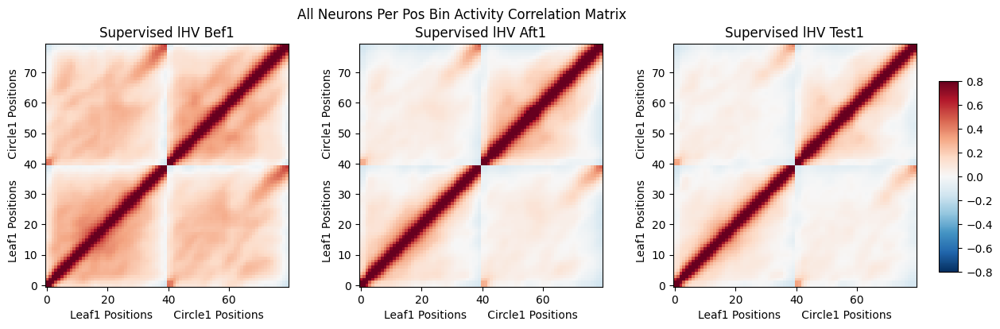

(80, 80) (80, 80)


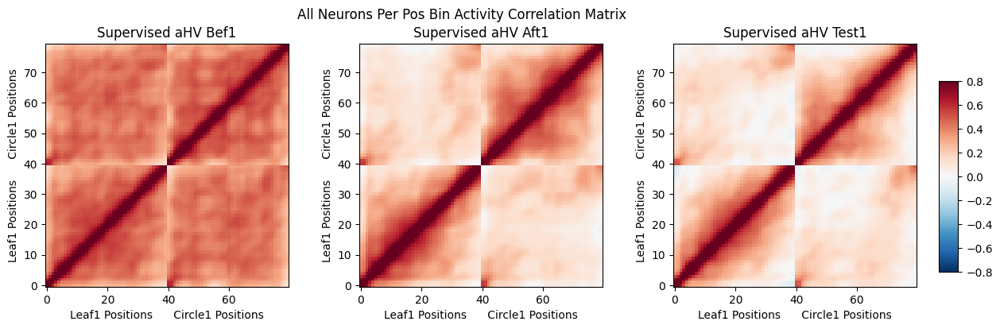

(80, 80) (80, 80)


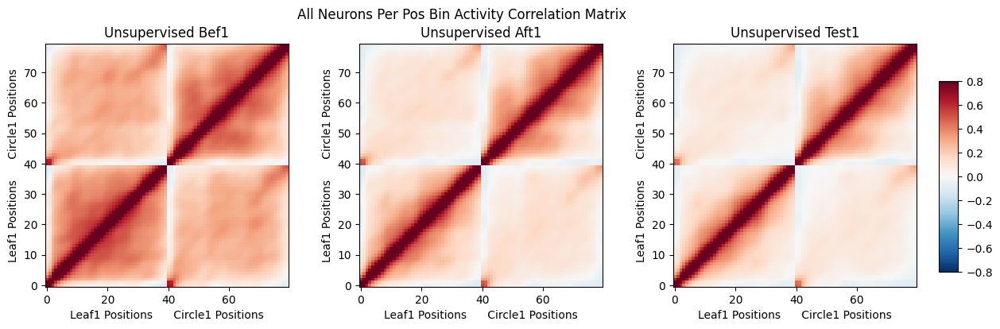

(80, 80) (80, 80)


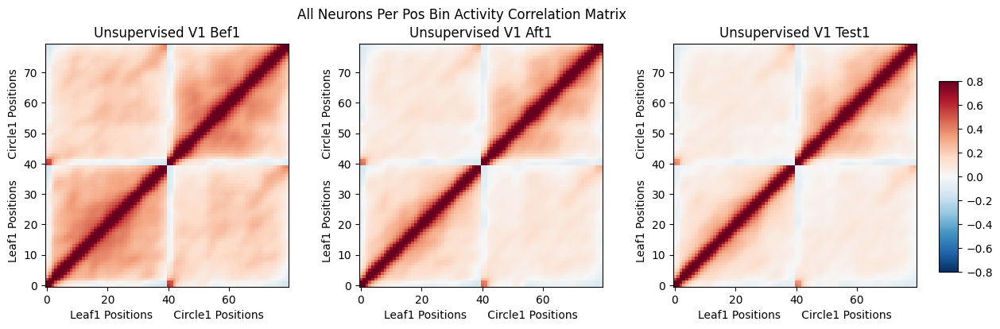

(80, 80) (80, 80)


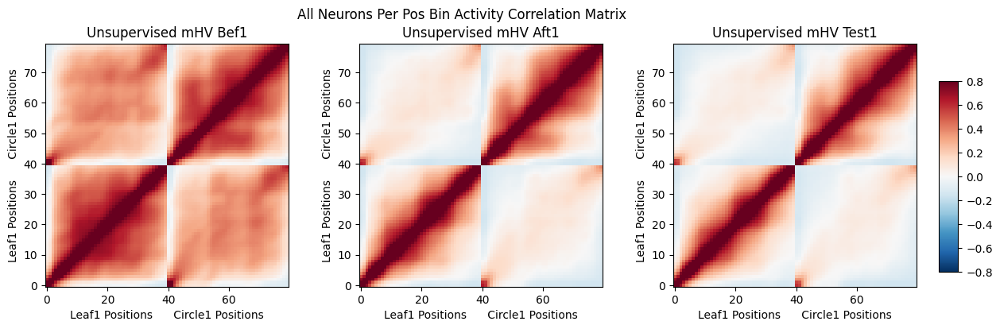

(80, 80) (80, 80)


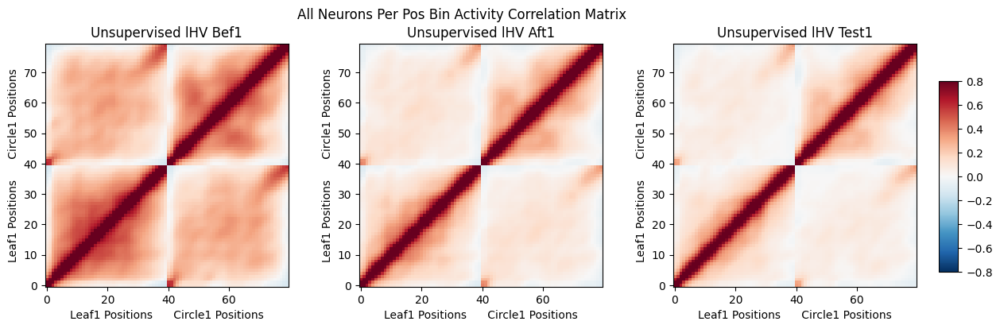

(80, 80) (80, 80)


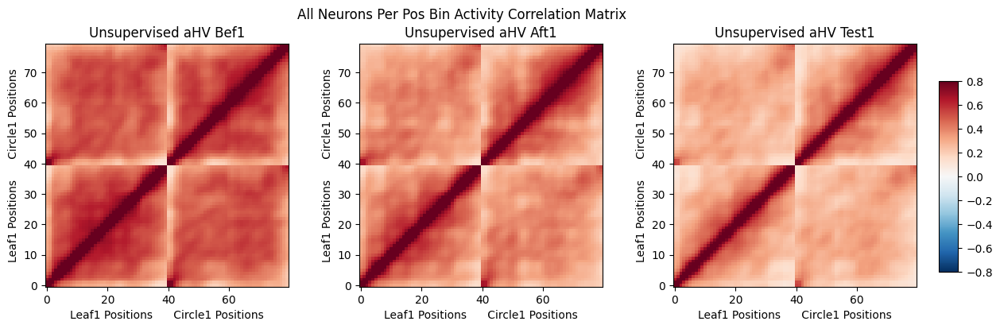

In [961]:
sup_animal_list = ['TX109', 'TX108', 'TX60', 'VR2']
unsup_animal_list = ['TX83', 'TX119', 'TX88', 'TX105', 'TX123', 'DR15', 'DR10']
sup_aft1_neuron_pos_list = [sup_aft1_neuron_pos, sup1_aft1_neuron_pos, sup2_aft1_neuron_pos, sup3_aft1_neuron_pos]
sup_bef1_neuron_pos_list = [sup_bef1_neuron_pos, sup1_bef1_neuron_pos, sup2_bef1_neuron_pos, sup3_bef1_neuron_pos]
sup_test1_neuron_pos_list = [sup_test1_neuron_pos, sup1_test1_neuron_pos, sup2_test1_neuron_pos, sup3_test1_neuron_pos]
unsup_aft1_neuron_pos_list = [unsup_aft1_neuron_pos, unsup1_aft1_neuron_pos, unsup2_aft1_neuron_pos, unsup3_aft1_neuron_pos, unsup4_aft1_neuron_pos, unsup5_aft1_neuron_pos, unsup6_aft1_neuron_pos]
unsup_bef1_neuron_pos_list = [unsup_bef1_neuron_pos, unsup1_bef1_neuron_pos, unsup2_bef1_neuron_pos, unsup3_bef1_neuron_pos, unsup4_bef1_neuron_pos, unsup5_bef1_neuron_pos, unsup6_bef1_neuron_pos]
unsup_test1_neuron_pos_list = [unsup_test1_neuron_pos, unsup1_test1_neuron_pos, unsup2_test1_neuron_pos, unsup3_test1_neuron_pos, unsup4_test1_neuron_pos, unsup5_test1_neuron_pos, unsup6_test1_neuron_pos]
rdm_analysis_per_region(sup_aft1_neuron_pos_list, sup_bef1_neuron_pos_list, sup_test1_neuron_pos_list,
                        sup_aft1_iarea_list, sup_bef1_iarea_list, sup_test1_iarea_list, animal_list=sup_animal_list, animal_type='Supervised')
rdm_analysis_per_region(unsup_aft1_neuron_pos_list, unsup_bef1_neuron_pos_list, unsup_test1_neuron_pos_list,
                        unsup_aft1_iarea_list, unsup_bef1_iarea_list, unsup_test1_iarea_list, animal_list=unsup_animal_list, animal_type='Unsupervised')

## Dimension Reduction

In [143]:
svd = TruncatedSVD(n_components=20, random_state=42)
sup2_aft1_svd = svd.fit_transform(sup2_aft1_neuron_pos)
sup2_bef1_svd = svd.fit_transform(sup2_bef1_neuron_pos)
sup2_test1_svd = svd.fit_transform(sup2_test1_neuron_pos)
unsup2_aft1_svd = svd.fit_transform(unsup2_aft1_neuron_pos)
unsup2_bef1_svd = svd.fit_transform(unsup2_bef1_neuron_pos)
unsup2_test1_svd = svd.fit_transform(unsup2_test1_neuron_pos)

print(sup3_aft1_svd.shape)

(80, 20)


In [13]:
def svd_before_tuning(aft1, bef1, test1, animal_type, n_components=200):
    aft1_spks, _, _, _, _ = prepare_data(aft1)
    svd = TruncatedSVD(n_components=n_components, random_state=42).fit(aft1_spks.T)
    aft1_svd = svd.transform(aft1_spks.T)
    plt.figure(figsize=(10, 5))
    plt.plot(1-np.cumsum(svd.explained_variance_ratio_))
    plt.title(f'SVD Cumulative Explained Variance - {aft1}')
    plt.xlabel('Number of Components')
    plt.ylabel('Cumulative Explained Variance')
    plt.grid()
    plt.show()
    del aft1_spks
    bef1_spks, _, _, _, _ = prepare_data(bef1)
    svd = TruncatedSVD(n_components=n_components, random_state=42).fit(bef1_spks.T)
    bef1_svd = svd.transform(bef1_spks.T)
    plt.figure(figsize=(10, 5))
    plt.plot(1-np.cumsum(svd.explained_variance_ratio_))
    plt.title(f'SVD Cumulative Explained Variance - {bef1}')
    plt.xlabel('Number of Components')
    plt.ylabel('Cumulative Explained Variance')
    plt.grid()
    plt.show()
    del bef1_spks
    test1_spks, _, _, _, _ = prepare_data(test1)
    svd = TruncatedSVD(n_components=n_components, random_state=42).fit(test1_spks.T)
    test1_svd = svd.transform(test1_spks.T)
    plt.figure(figsize=(10, 5))
    plt.plot(1-np.cumsum(svd.explained_variance_ratio_))
    plt.title(f'SVD Cumulative Explained Variance - {test1}')
    plt.xlabel('Number of Components')
    plt.ylabel('Cumulative Explained Variance')
    plt.grid()
    plt.show()
    del test1_spks
    aft1_beh = np.load(os.path.join(root, 'beh', f'Beh_{animal_type}_train1_after_learning.npy'), allow_pickle=1).item()[aft1]
    bef1_beh = np.load(os.path.join(root, 'beh', f'Beh_{animal_type}_train1_before_learning.npy'), allow_pickle=1).item()[bef1]
    test1_beh = np.load(os.path.join(root, 'beh', f'Beh_{animal_type}_test1.npy'), allow_pickle=1).item()[test1]
    aft1_corridor_tuning = tuning_curves_VR(aft1_svd.T, aft1_beh['ft_Pos'] / 60, aft1_beh['StartFr'], aft1_beh['EndFr'], aft1_beh)
    bef1_corridor_tuning = tuning_curves_VR(bef1_svd.T, bef1_beh['ft_Pos'] / 60, bef1_beh['StartFr'], bef1_beh['EndFr'], bef1_beh)
    test1_corridor_tuning = tuning_curves_VR(test1_svd.T, test1_beh['ft_Pos'] / 60, test1_beh['StartFr'], test1_beh['EndFr'], test1_beh, num_stimuli=4)
    print(aft1_corridor_tuning.shape)
    aft1_neuron_pos = all_neuron_pos_bin_matrix(aft1_corridor_tuning)
    bef1_neuron_pos = all_neuron_pos_bin_matrix(bef1_corridor_tuning)
    test1_neuron_pos = all_neuron_pos_bin_matrix(test1_corridor_tuning)
    return aft1_svd, bef1_svd, test1_svd, aft1_neuron_pos, bef1_neuron_pos, test1_neuron_pos

Loaded TX109_2023_04_07_1 spks with shape (89577, 20021)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


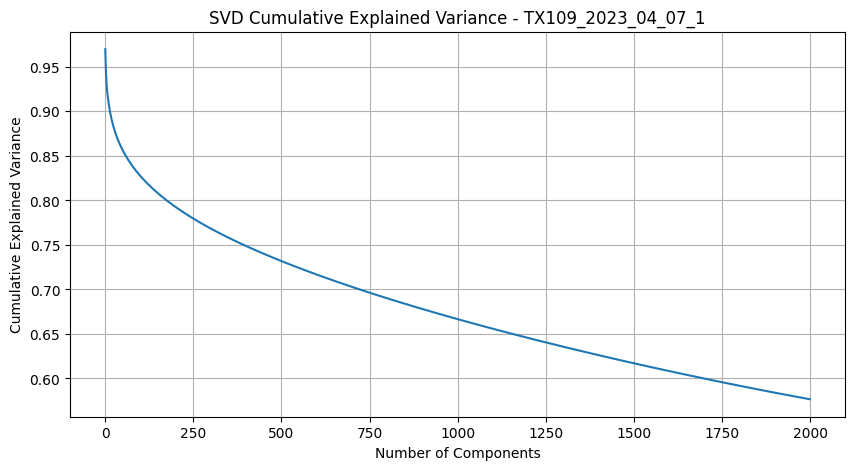

Loaded TX109_2023_03_27_1 spks with shape (63625, 14586)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


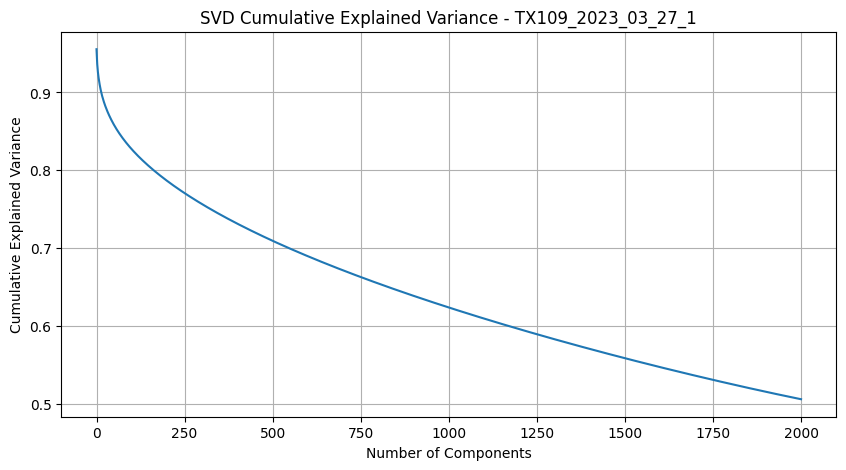

Loaded TX109_2023_04_18_1 spks with shape (83309, 17371)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


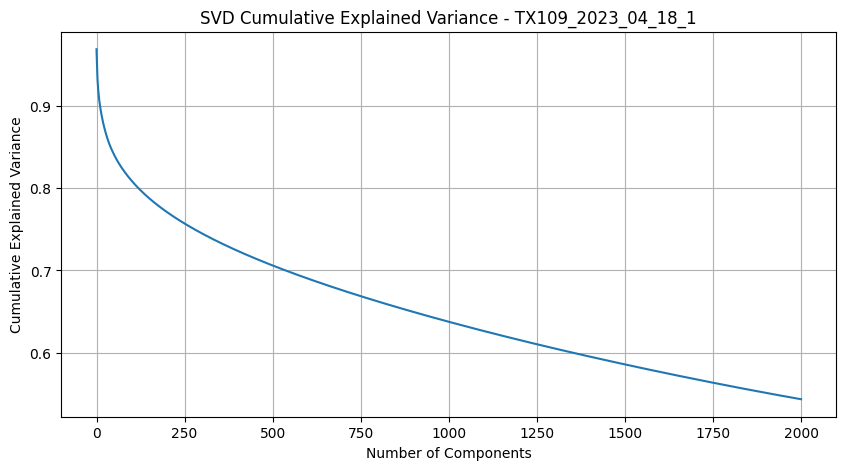

/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


(2, 2000, 60)
Loaded TX108_2023_03_22_1 spks with shape (75480, 19566)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


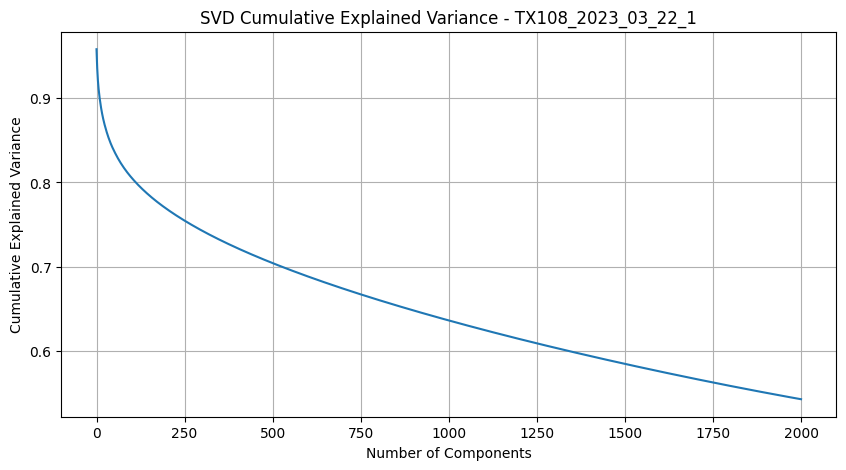

Loaded TX108_2023_03_13_1 spks with shape (85481, 22992)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


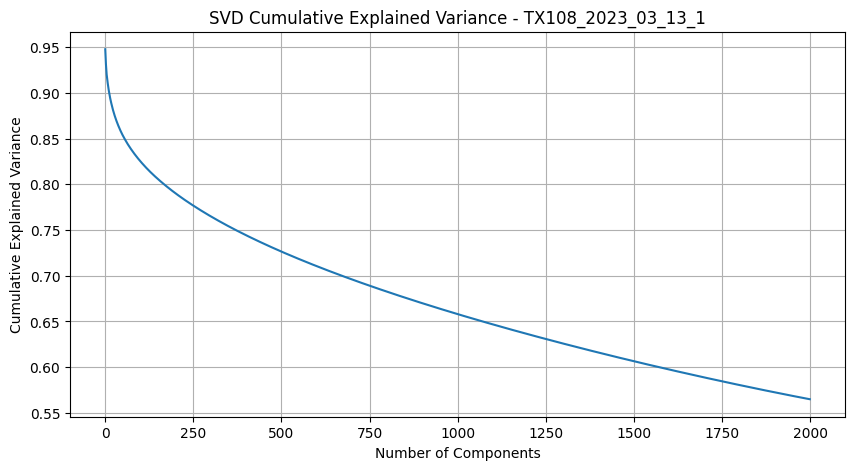

Loaded TX108_2023_03_25_1 spks with shape (79417, 26600)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


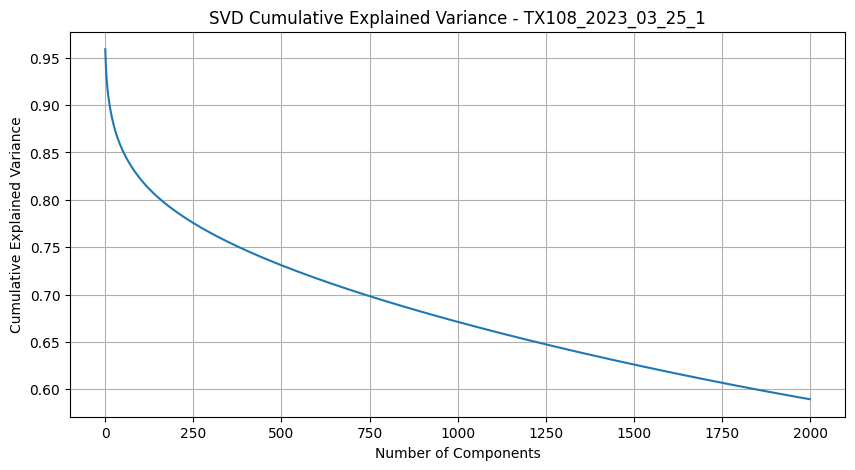

/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


(2, 2000, 60)
Loaded TX60_2021_05_04_1 spks with shape (57368, 17576)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


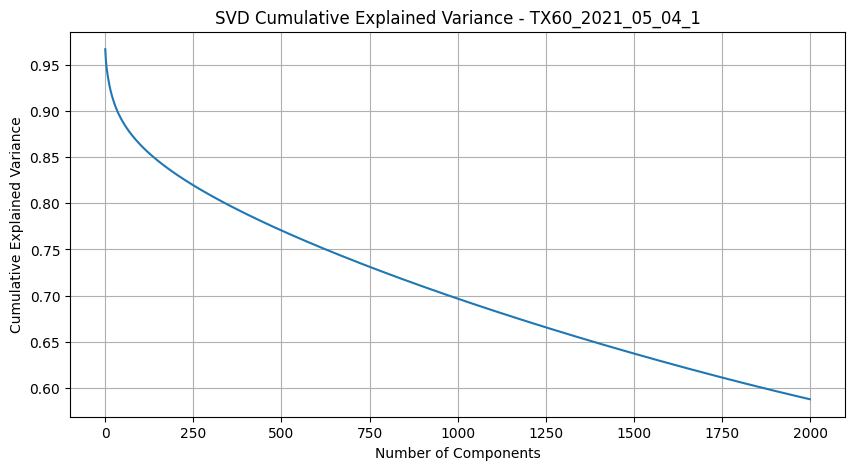

Loaded TX60_2021_04_10_1 spks with shape (48732, 23469)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


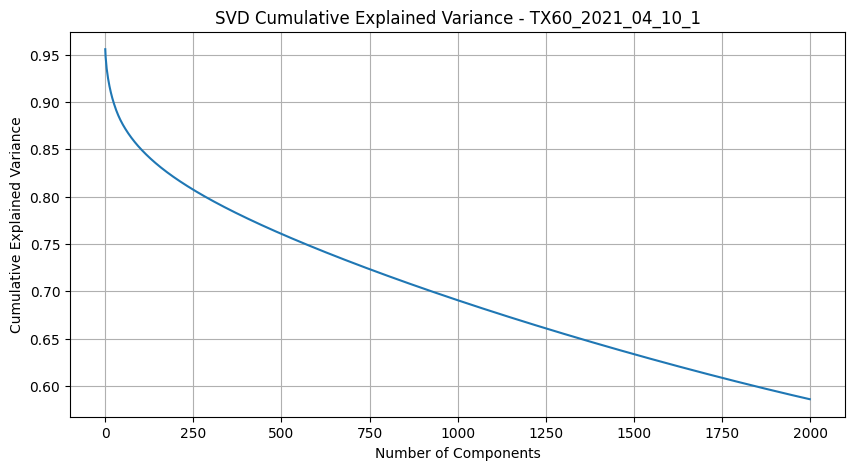

Loaded TX60_2021_06_07_1 spks with shape (47785, 22475)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


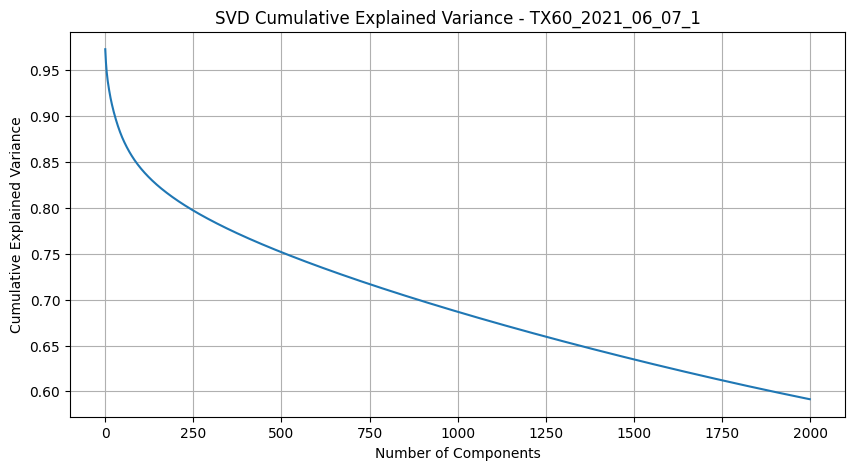

/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


(2, 2000, 60)
Loaded VR2_2021_04_06_1 spks with shape (71069, 17760)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


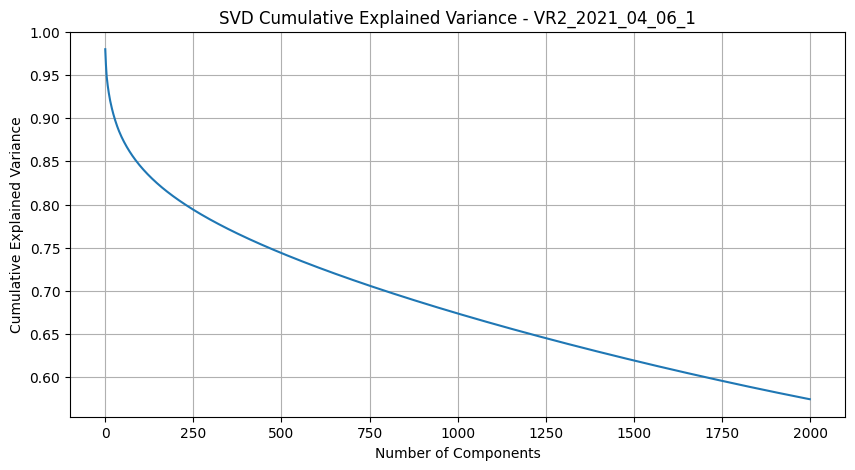

Loaded VR2_2021_03_20_1 spks with shape (81473, 24298)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


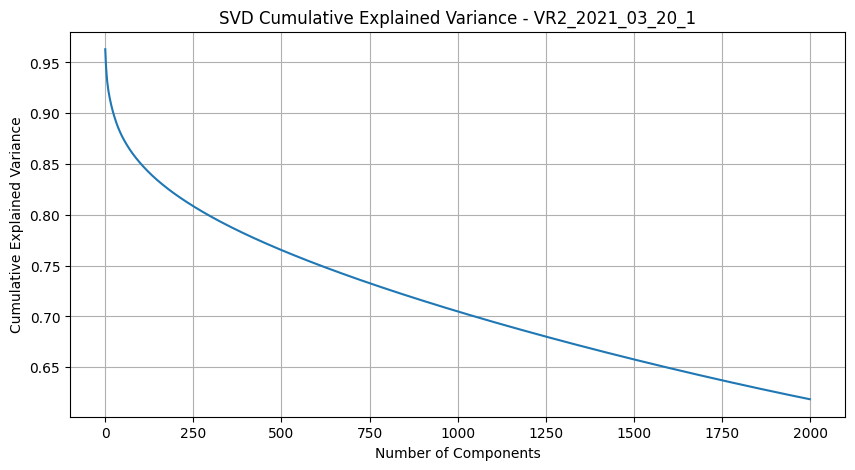

Loaded VR2_2021_04_11_1 spks with shape (76108, 29244)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


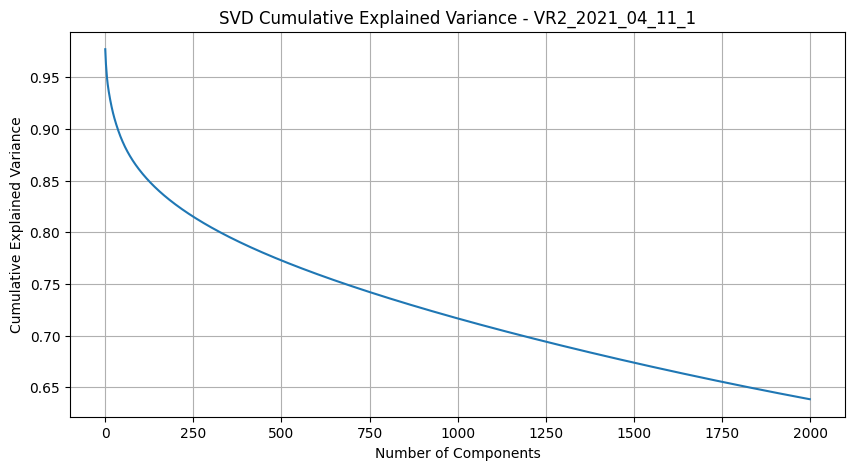

/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


(2, 2000, 60)
Loaded TX83_2022_08_29_1 spks with shape (52954, 24407)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


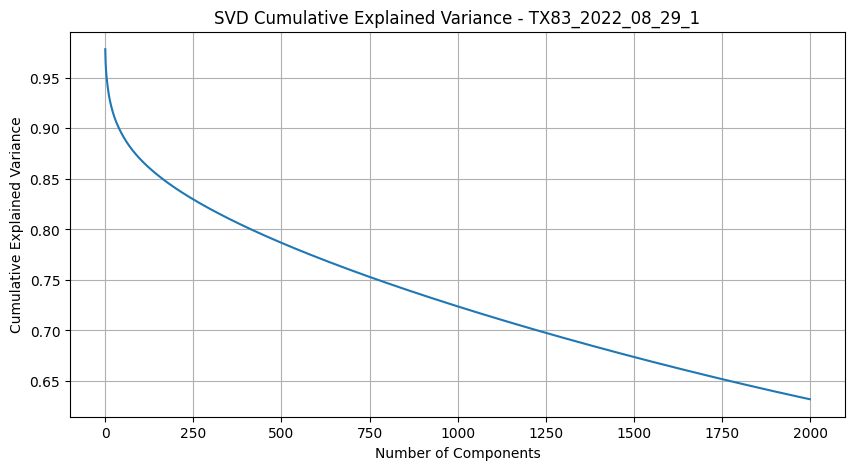

Loaded TX83_2022_08_17_1 spks with shape (44059, 20428)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


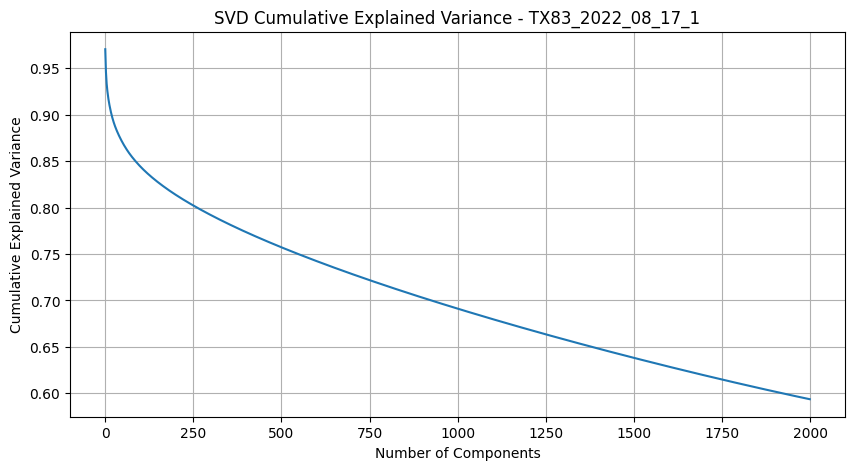

Loaded TX83_2022_08_31_1 spks with shape (50689, 33597)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


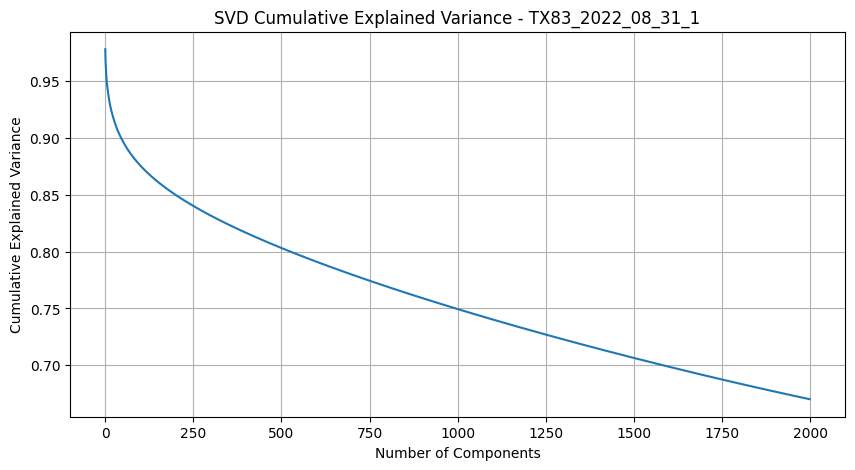

/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


(2, 2000, 60)
Loaded TX119_2023_12_23_1 spks with shape (36935, 15608)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


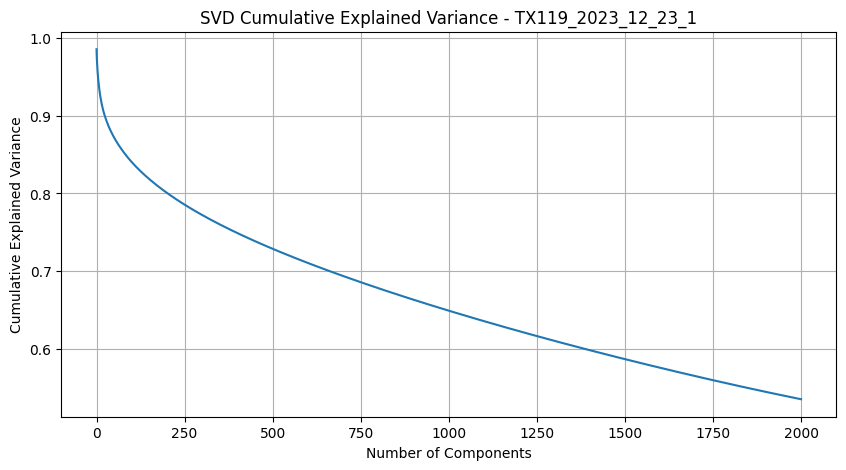

Loaded TX119_2023_12_14_1 spks with shape (31672, 15432)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


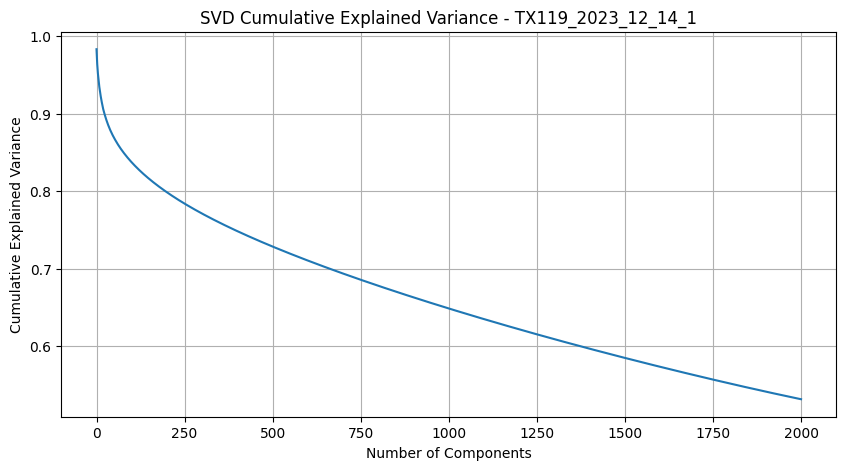

Loaded TX119_2023_12_24_1 spks with shape (27281, 14570)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


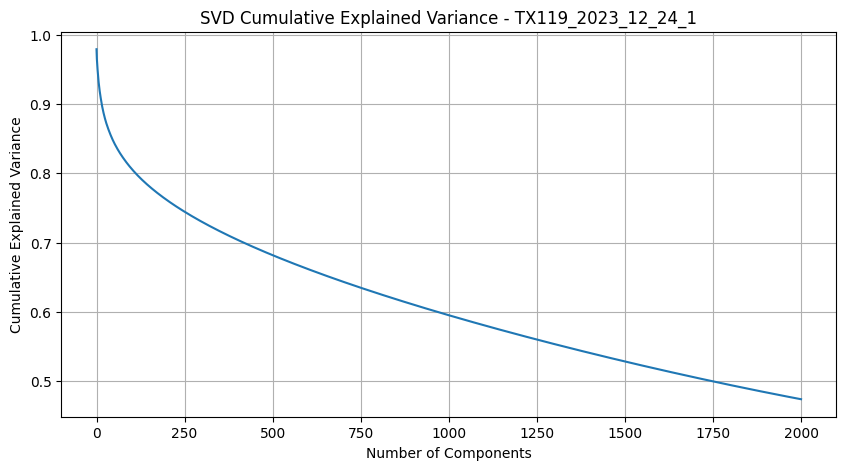

/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


(2, 2000, 60)
Loaded TX88_2022_06_17_2 spks with shape (48824, 27969)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


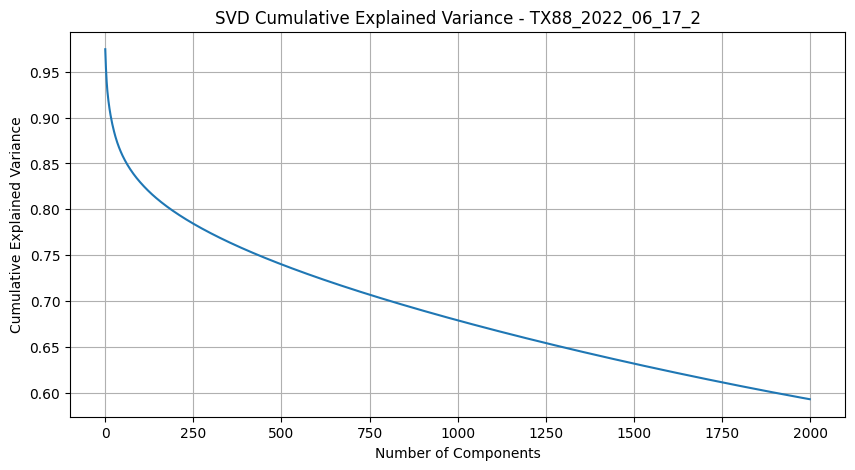

Loaded TX88_2022_06_13_2 spks with shape (62606, 20539)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


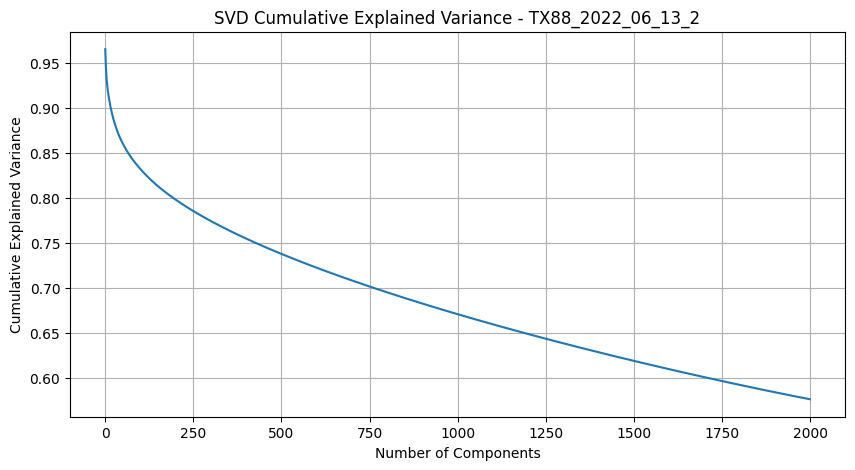

Loaded TX88_2022_06_20_1 spks with shape (58099, 29422)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


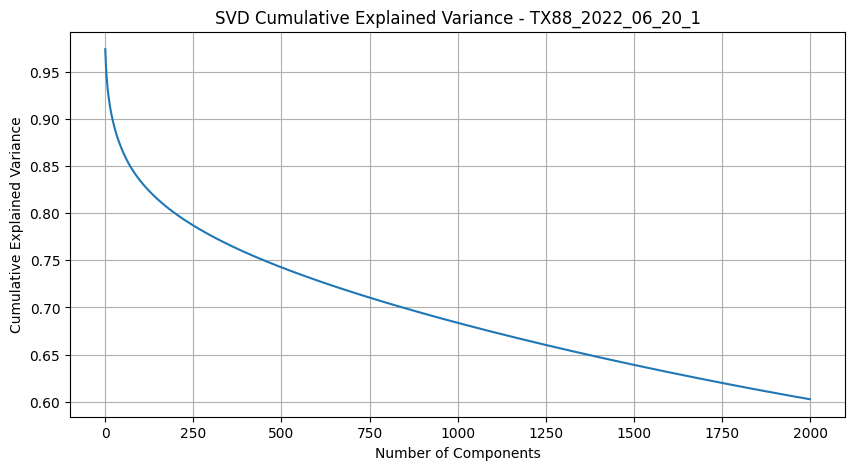

/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


(2, 2000, 60)
Loaded TX105_2022_10_19_2 spks with shape (55653, 15553)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


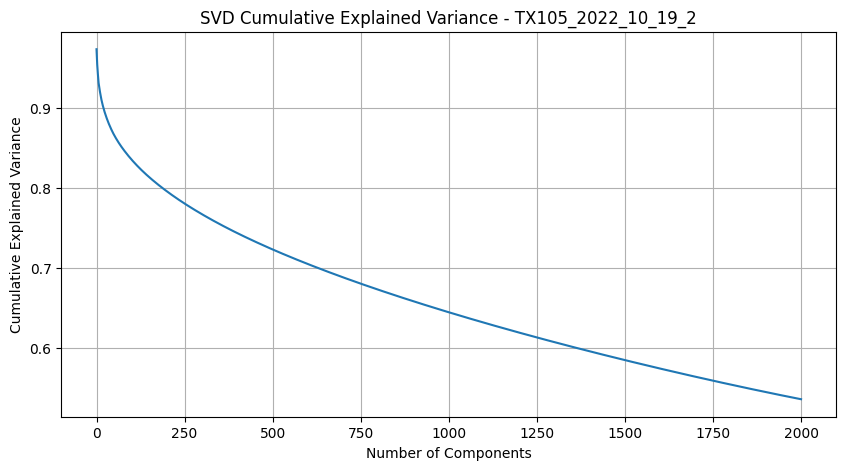

Loaded TX105_2022_10_08_2 spks with shape (58941, 27740)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


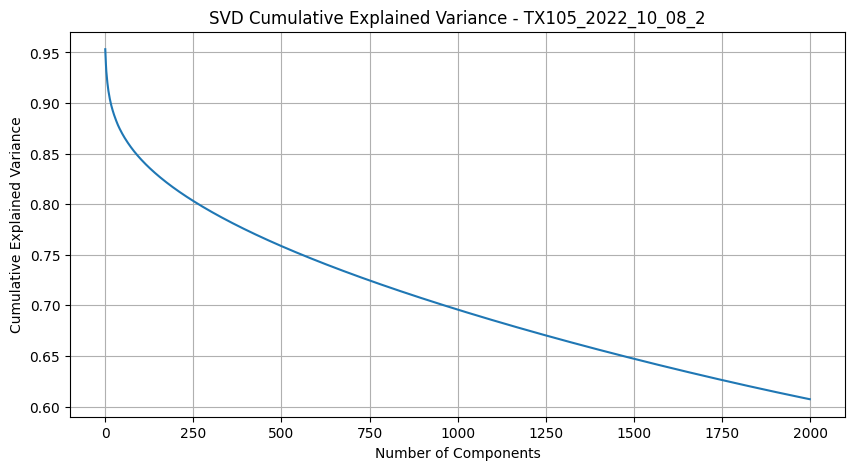

Loaded TX105_2022_10_21_1 spks with shape (61115, 24809)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


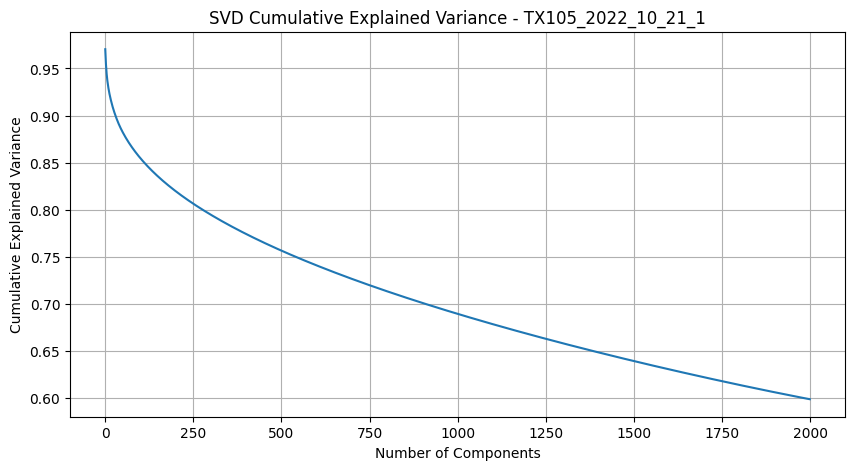

/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


(2, 2000, 60)
Loaded TX123_2024_01_02_1 spks with shape (43103, 29251)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


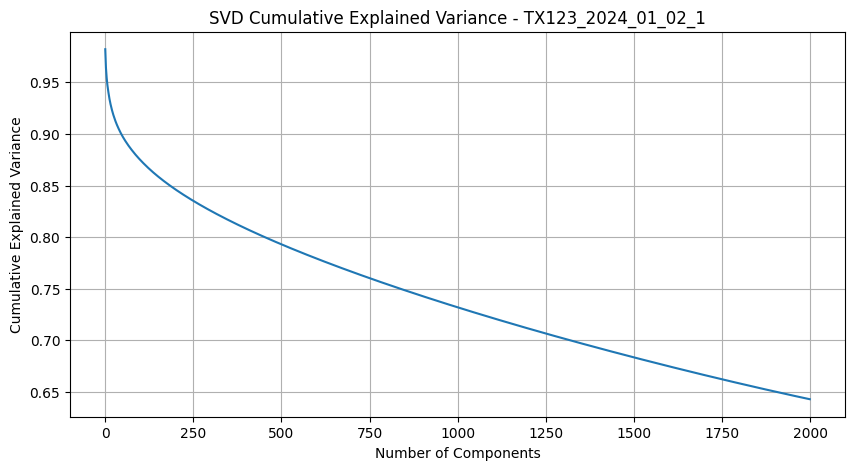

Loaded TX123_2023_12_21_1 spks with shape (28696, 15946)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


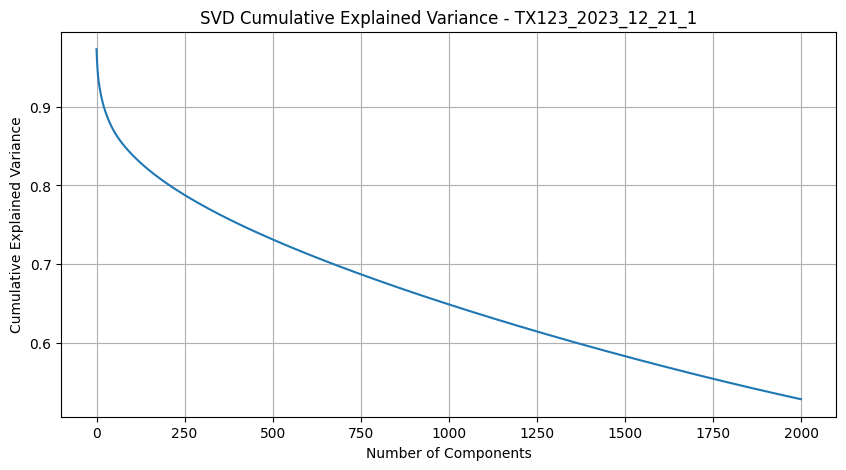

Loaded TX123_2024_01_03_1 spks with shape (30931, 19057)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


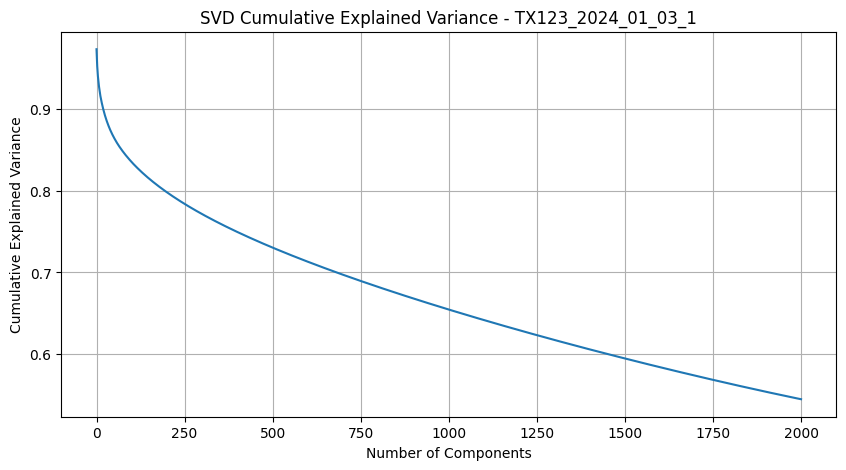

/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


(2, 2000, 60)
Loaded DR15_2022_10_19_1 spks with shape (58930, 28848)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


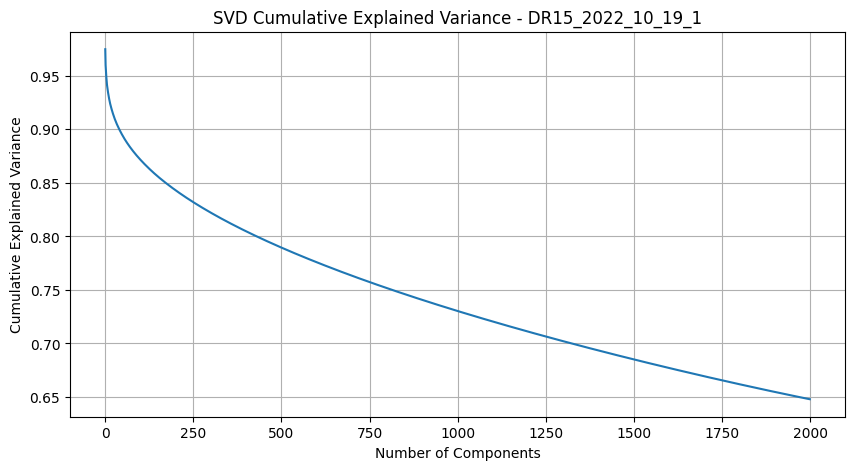

Loaded DR15_2022_10_09_1 spks with shape (55746, 29375)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


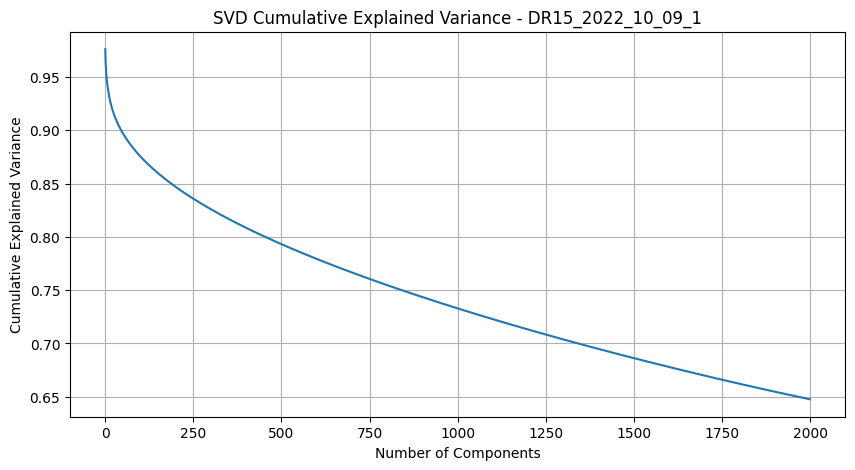

Loaded DR15_2022_10_20_1 spks with shape (64130, 26837)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


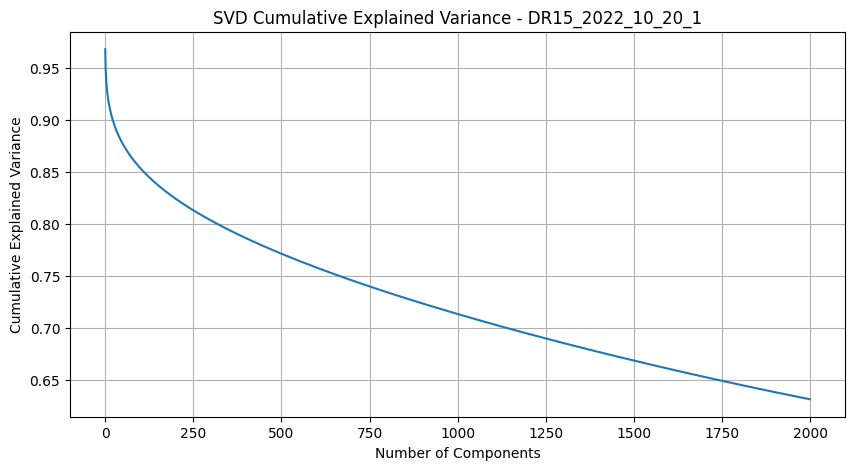

/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


(2, 2000, 60)
Loaded DR10_2022_07_19_1 spks with shape (54741, 22328)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


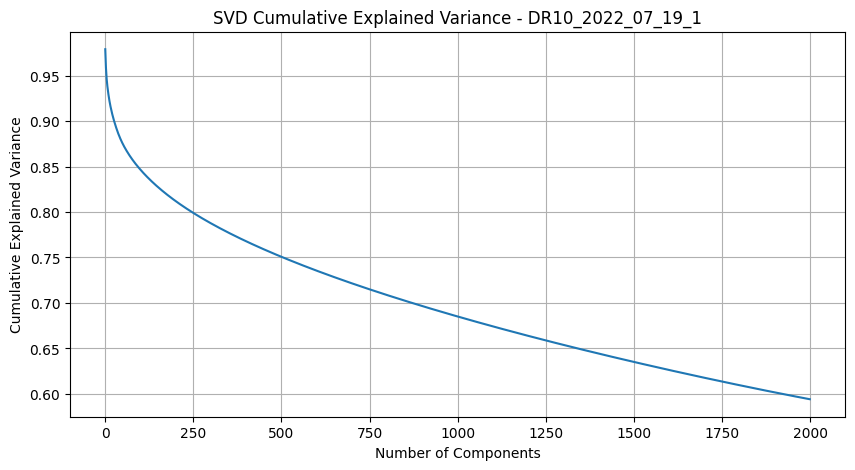

Loaded DR10_2022_07_12_1 spks with shape (58224, 31707)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


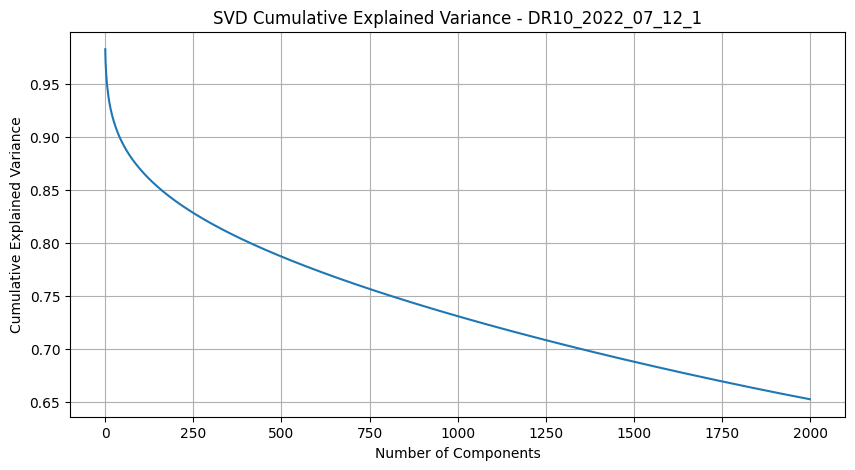

Loaded DR10_2022_07_21_1 spks with shape (50347, 24068)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


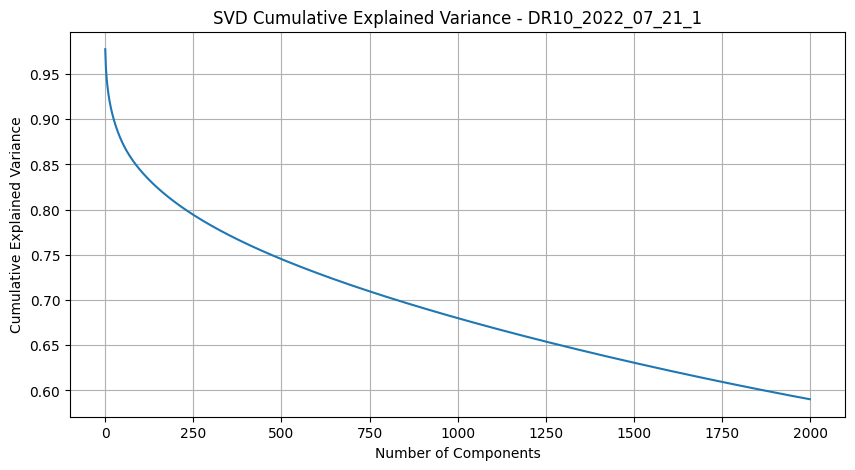

/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


(2, 2000, 60)


In [561]:
sup_aft1_svd, sup_bef1_svd, sup_test1_svd, sup_aft1_svd_neuron_pos, sup_bef1_svd_neuron_pos, sup_test1_svd_neuron_pos = svd_before_tuning(
    'TX109_2023_04_07_1', 'TX109_2023_03_27_1', 'TX109_2023_04_18_1'
    , 'sup', n_components=2000)
sup1_aft1_svd, sup1_bef1_svd, sup1_test1_svd, sup1_aft1_svd_neuron_pos, sup1_bef1_svd_neuron_pos, sup1_test1_svd_neuron_pos = svd_before_tuning(
    'TX108_2023_03_22_1', 'TX108_2023_03_13_1', 'TX108_2023_03_25_1'
    , 'sup', n_components=2000)
sup2_aft1_svd, sup2_bef1_svd, sup2_test1_svd, sup2_aft1_svd_neuron_pos, sup2_bef1_svd_neuron_pos, sup2_test1_svd_neuron_pos = svd_before_tuning(
    'TX60_2021_05_04_1', 'TX60_2021_04_10_1', 'TX60_2021_06_07_1'
    , 'sup', n_components=2000)
sup3_aft1_svd, sup3_bef1_svd, sup3_test1_svd, sup3_aft1_svd_neuron_pos, sup3_bef1_svd_neuron_pos, sup3_test1_svd_neuron_pos = svd_before_tuning(
    'VR2_2021_04_06_1', 'VR2_2021_03_20_1', 'VR2_2021_04_11_1'
    , 'sup', n_components=2000)
unsup_aft1_svd, unsup_bef1_svd, unsup_test1_svd, unsup_aft1_svd_neuron_pos, unsup_bef1_svd_neuron_pos, unsup_test1_svd_neuron_pos = svd_before_tuning(
    'TX83_2022_08_29_1', 'TX83_2022_08_17_1', 'TX83_2022_08_31_1'
    , 'unsup', n_components=2000)
unsup1_aft1_svd, unsup1_bef1_svd, unsup1_test1_svd, unsup1_aft1_svd_neuron_pos, unsup1_bef1_svd_neuron_pos, unsup1_test1_svd_neuron_pos = svd_before_tuning(
    'TX119_2023_12_23_1', 'TX119_2023_12_14_1', 'TX119_2023_12_24_1'
    , 'unsup', n_components=2000)
unsup2_aft1_svd, unsup2_bef1_svd, unsup2_test1_svd, unsup2_aft1_svd_neuron_pos, unsup2_bef1_svd_neuron_pos, unsup2_test1_svd_neuron_pos = svd_before_tuning(
    'TX88_2022_06_17_2', 'TX88_2022_06_13_2', 'TX88_2022_06_20_1'
    , 'unsup', n_components=2000)
unsup3_aft1_svd, unsup3_bef1_svd, unsup3_test1_svd, unsup3_aft1_svd_neuron_pos, unsup3_bef1_svd_neuron_pos, unsup3_test1_svd_neuron_pos = svd_before_tuning(
    'TX105_2022_10_19_2', 'TX105_2022_10_08_2', 'TX105_2022_10_21_1'
    , 'unsup', n_components=2000)
unsup4_aft1_svd, unsup4_bef1_svd, unsup4_test1_svd, unsup4_aft1_svd_neuron_pos, unsup4_bef1_svd_neuron_pos, unsup4_test1_svd_neuron_pos = svd_before_tuning(
    'TX123_2024_01_02_1', 'TX123_2023_12_21_1', 'TX123_2024_01_03_1'
    , 'unsup', n_components=2000)
unsup5_aft1_svd, unsup5_bef1_svd, unsup5_test1_svd, unsup5_aft1_svd_neuron_pos, unsup5_bef1_svd_neuron_pos, unsup5_test1_svd_neuron_pos = svd_before_tuning(
    'DR15_2022_10_19_1', 'DR15_2022_10_09_1', 'DR15_2022_10_20_1'
    , 'unsup', n_components=2000)
unsup6_aft1_svd, unsup6_bef1_svd, unsup6_test1_svd, unsup6_aft1_svd_neuron_pos, unsup6_bef1_svd_neuron_pos, unsup6_test1_svd_neuron_pos = svd_before_tuning(
    'DR10_2022_07_19_1', 'DR10_2022_07_12_1', 'DR10_2022_07_21_1'
    , 'unsup', n_components=2000)

In [516]:
sup_aft1_neuron_pos[:,0].std()

np.float64(0.24156775741274875)

(80, 80) (80, 80)


/tmp/ipykernel_1104/3428423905.py:31: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


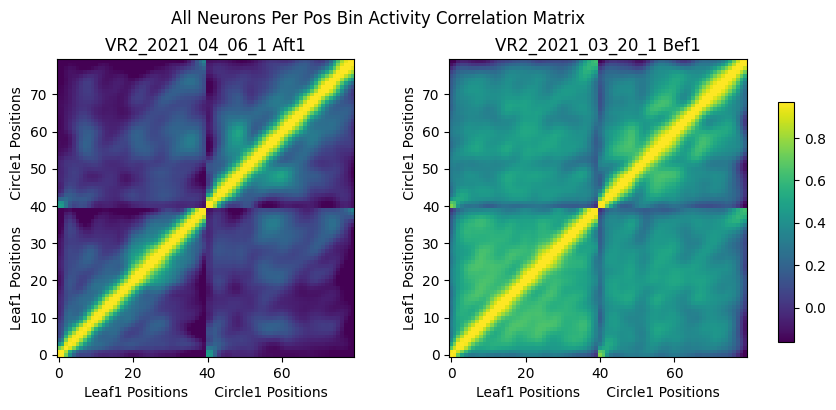

(80, 80) (80, 80)


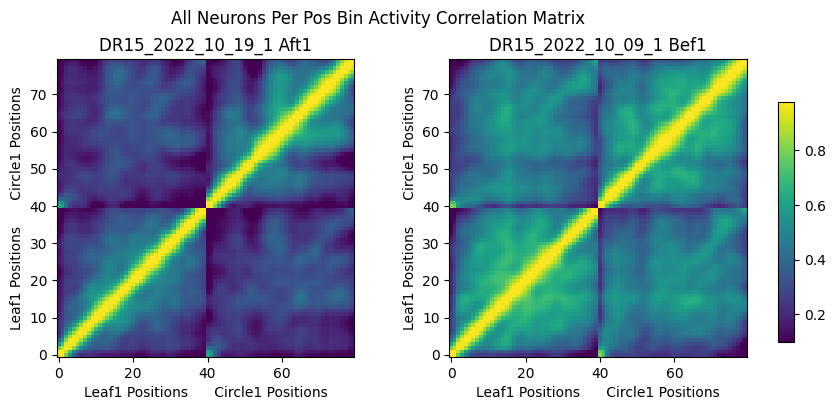

supervised before and after training cosine similarity: 0.7095036116246399
unsupervised before and after training cosine similarity: 0.9654060665244765


In [514]:
# correlation here (optional: cosine similarity)
visualize_corr_matrix(np.corrcoef(sup_aft1_svd), 
                      np.corrcoef(sup_bef1_svd), 
                      f'{sup_aft1} Aft1', f'{sup_bef1} Bef1'
                      #, vmin=0.0, vmax=0.95
                      )
visualize_corr_matrix(np.corrcoef(unsup_aft1_svd), 
                      np.corrcoef(unsup_bef1_svd), 
                      f'{unsup_aft1} Aft1', f'{unsup_bef1} Bef1'
                      #, vmin=0.0, vmax=0.95
                      )

sup_cos_sim = cos_similarity(np.corrcoef(sup_aft1_svd),
                                   np.corrcoef(sup_bef1_svd))
unsup_cos_sim = cos_similarity(np.corrcoef(unsup_aft1_svd),
                                   np.corrcoef(unsup_bef1_svd))
print(f'supervised before and after training cosine similarity: {sup_cos_sim}')
print(f'unsupervised before and after training cosine similarity: {unsup_cos_sim}')

## CCA 


### Play With The Corr Matrix (Nonsense)

In [37]:
from sklearn.cross_decomposition import CCA
from sklearn.preprocessing import StandardScaler

def matrix_align(X1, X2, random_state=None):
    # Align the two matrices by sampling the larger one
    rng = np.random.default_rng(random_state)
    if X1.shape[0] > X2.shape[0]:
        X1 = rng.choice(X1, size=X2.shape[0], replace=False)
        print(X1.shape)
    elif X1.shape[0] < X2.shape[0]:
        X2 = rng.choice(X2, size=X1.shape[0], replace=False)    
    return X1, X2

def cca_analysis(X1, X2, n_components=2, n_runs=20, random_state=None):

    X1_c_mat = np.zeros((n_runs, min(X1.shape[0], X2.shape[0]), n_components))
    X2_c_mat = np.zeros((n_runs, min(X1.shape[0], X2.shape[0]), n_components))
    corr_mat = np.zeros((n_runs, n_components))
    for n in range(n_runs):
        print(f'Run {n+1}/{n_runs}')
        x1, x2 = matrix_align(X1, X2, random_state=random_state)
        x1 = x1.T
        x2 = x2.T

        # Standardize the data
        scaler = StandardScaler()
        X1sc = scaler.fit_transform(X1)
        X2sc = scaler.fit_transform(X2)

        # Perform CCA
        cca = CCA(n_components=n_components, scale=False)
        cca.fit(X1sc, X2sc)

        # Transform the data
        X1_c = cca.transform(X1sc)
        X2_c = cca.transform(X2sc)
        X1_c_mat[n, :, :] = X1_c
        X2_c_mat[n, :, :] = X2_c

        corr_mat[n, :] = np.array([np.corrcoef(X1_c[:, i], X2_c[:, i])[1][0] for i in range(n_components)])

    corr_mat_sem = np.std(corr_mat, axis=0) / np.sqrt(n_runs)

    plt.figure(figsize=(6, 4))
    plt.bar(['CC1', 'CC2'], corr_mat.mean(axis=0), yerr=corr_mat_sem, color='lightgrey', width=0.8, edgecolor='k')
    plt.title('CCA Correlation Coefficients')
    plt.ylabel('Correlation Coefficient')
    plt.axhline(0, color='k', linestyle='--', linewidth=0.8)
    plt.show()

    return X1_c_mat, X2_c_mat

Run 1/1


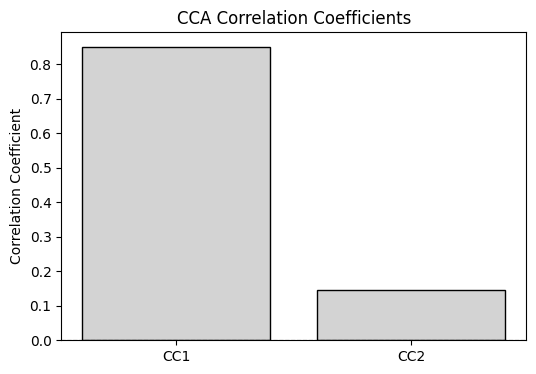

Run 1/1


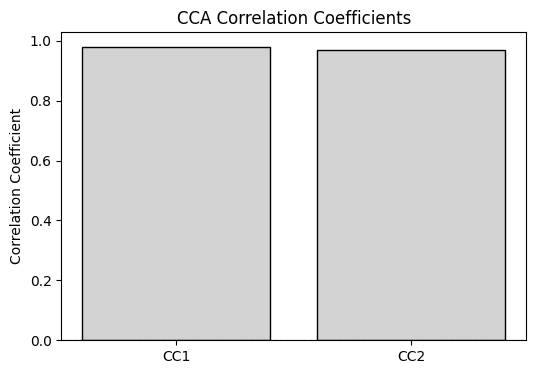

In [42]:
sup_X1c_mat, sup_X2_c_mat = cca_analysis(np.corrcoef(sup_aft1_neuron_pos), np.corrcoef(sup_bef1_neuron_pos), n_runs=1, random_state=42)
unsup_X1c_mat, unsup_X2_c_mat = cca_analysis(np.corrcoef(unsup_bef1_neuron_pos), np.corrcoef(unsup_aft1_neuron_pos), n_runs=1, random_state=42)

Text(0, 0.5, '2nd Canonical Variate before Training')

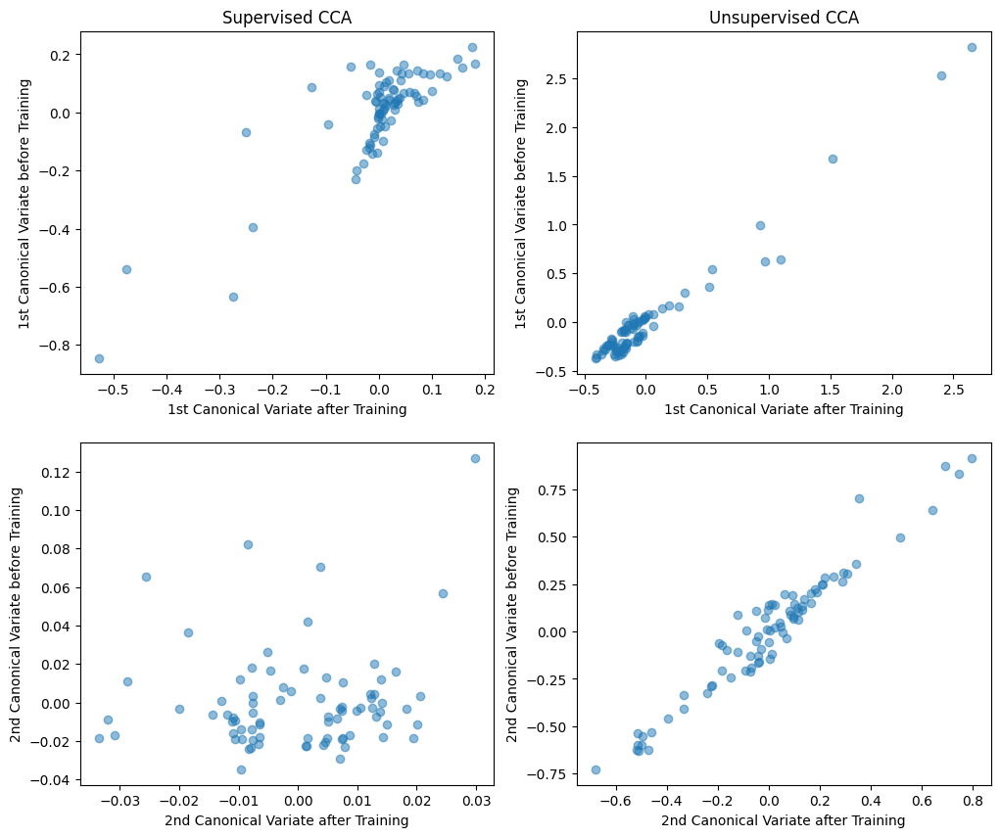

In [53]:
plt.subplots(2, 2, figsize=(12, 10))
plt.subplot(2, 2, 1)
plt.scatter(sup_X1c_mat[:, :, 0], sup_X2_c_mat[:, :, 0], label='Supervised', alpha=0.5)
plt.title('Supervised CCA')
plt.xlabel('1st Canonical Variate after Training')
plt.ylabel('1st Canonical Variate before Training')

plt.subplot(2, 2, 2)
plt.scatter(unsup_X1c_mat[:, :, 0], unsup_X2_c_mat[:, :, 0], label='Unsupervised', alpha=0.5)
plt.title('Unsupervised CCA')
plt.xlabel('1st Canonical Variate after Training')
plt.ylabel('1st Canonical Variate before Training')

plt.subplot(2, 2, 3)
plt.scatter(sup_X1c_mat[:, :, 1], sup_X2_c_mat[:, :, 1], label='Supervised', alpha=0.5)
plt.xlabel('2nd Canonical Variate after Training')
plt.ylabel('2nd Canonical Variate before Training')

plt.subplot(2, 2, 4)
plt.scatter(unsup_X1c_mat[:, :, 1], unsup_X2_c_mat[:, :, 1], label='Unsupervised', alpha=0.5)
plt.xlabel('2nd Canonical Variate after Training')
plt.ylabel('2nd Canonical Variate before Training')


### mat(n_neuron * 40 leaf) & mat(n_neuron * 40 circle)

In [934]:
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.cross_decomposition import CCA
import warnings

def matrix_align(X1, X2, random_state=None):
    rng = np.random.default_rng(random_state)
    n = min(X1.shape[0], X2.shape[0])
    if X1.shape[0] != n:
        X1 = X1[rng.choice(X1.shape[0], size=n, replace=False)]
    if X2.shape[0] != n:
        X2 = X2[rng.choice(X2.shape[0], size=n, replace=False)]
    return X1, X2


def _invsqrt_cov(X, lam):
    """(X.T X / (n-1) + lam I)^(-1/2) for ridge whitening."""
    n = X.shape[0]
    C = (X.T @ X) / max(n - 1, 1) + lam * np.eye(X.shape[1])
    w, V = np.linalg.eigh(C)
    w = np.clip(w, 1e-12, None)
    return V @ (np.diag(w**-0.5)) @ V.T


def _ridge_cca_first_weights(Xtr, Ytr, lam=0, n_components=1):
    """
    Return the first pair of canonical weight vectors (a, b) using ridge CCA:
    whiten with (Σ_xx+λI)^(-1/2), (Σ_yy+λI)^(-1/2), then SVD.
    """
    Cxx_inv_sqrt = _invsqrt_cov(Xtr, lam)
    Cyy_inv_sqrt = _invsqrt_cov(Ytr, lam)
    n = Xtr.shape[0]
    Cxy = (Xtr.T @ Ytr) / max(n - 1, 1)
    M = Cxx_inv_sqrt @ Cxy @ Cyy_inv_sqrt
    U, s, Vt = np.linalg.svd(M, full_matrices=False)
    a = Cxx_inv_sqrt @ U[:, :n_components]
    b = Cyy_inv_sqrt @ Vt.T[:, :n_components]
    # Fix sign so train correlation is positive (CCA sign is arbitrary)
    for i in range(n_components):
        ai = a[:, i]
        bi = b[:, i]
        u_tr = Xtr @ ai
        v_tr = Ytr @ bi
        if np.corrcoef(u_tr.ravel(), v_tr.ravel())[0, 1] < 0:
            b[:, i] *= -1
    return a, b

'''
def _ridge_cca_first_weights(X, Y, lam=0.5, n_components=1):
    n, p = X.shape
    n2, q = Y.shape
    assert n == n2, "X and Y must have same number of samples"

    # Center columns (don’t scale to unit variance in case lam will not cause effects)
    #Xc = X - X.mean(axis=0, keepdims=True)
    #Yc = Y - Y.mean(axis=0, keepdims=True)

    X_aug = np.vstack([X, np.sqrt(lam)*np.eye(p), np.zeros((q, p))])
    Y_aug = np.vstack([Y, np.zeros((p, q)), np.sqrt(lam)*np.eye(q)])

    cca = CCA(n_components=n_components, scale=False, max_iter=5000, tol=1e-12)
    with warnings.catch_warnings():
        warnings.simplefilter("ignore", category=UserWarning)
        cca.fit(X_aug, Y_aug)
        a = cca.x_weights_
        b = cca.y_weights_
    
    return a, b, cca


def cca_analysis(X1, X2, lam=0.5, n_splits=10, random_state=None):
    """
    Cross-validated ridge CCA on 80-D features (rows = trials, cols = features).

    Returns:
        results dict with:
          - 'r_test_folds': array of length n_splits with test-set Pearson r
          - 'mean_r', 'sem_r': mean ± SEM across folds
          - 'weights': list of (a, b) canonical weight vectors per fold
    """
    # Align: rows = samples
    X1, X2 = matrix_align(X1, X2, random_state=random_state)

    kf = KFold(n_splits=n_splits, shuffle=True, random_state=random_state)
    r_test = np.empty(n_splits)
    weights = []

    for i, (tr, te) in enumerate(kf.split(X1)):
        # Standardize using train only 
        sc1 = StandardScaler().fit(X1[tr])
        sc2 = StandardScaler().fit(X2[tr])
        X1tr, X1te = sc1.transform(X1[tr]), sc1.transform(X1[te])
        X2tr, X2te = sc2.transform(X2[tr]), sc2.transform(X2[te])

        a, b = _ridge_cca_first_weights(X1tr, X2tr, lam=lam)
        weights.append((a, b))

        # Project test trials onto the top canonical dimension
        u_te = X1te @ a
        v_te = X2te @ b

        # corr across test trials
        r_test[i] = np.corrcoef(u_te, v_te)[0, 1]
        print(f'Fold {i+1}/{n_splits}: r_test = {r_test[i]:.3f}')

    mean_r = float(np.nanmean(r_test))
    sem_r  = float(np.nanstd(r_test, ddof=1) / np.sqrt(n_splits))
    return {"r_test_folds": r_test, "mean_r": mean_r, "sem_r": sem_r, "weights": weights}
'''

'\ndef _ridge_cca_first_weights(X, Y, lam=0.5, n_components=1):\n    n, p = X.shape\n    n2, q = Y.shape\n    assert n == n2, "X and Y must have same number of samples"\n\n    # Center columns (don’t scale to unit variance in case lam will not cause effects)\n    #Xc = X - X.mean(axis=0, keepdims=True)\n    #Yc = Y - Y.mean(axis=0, keepdims=True)\n\n    X_aug = np.vstack([X, np.sqrt(lam)*np.eye(p), np.zeros((q, p))])\n    Y_aug = np.vstack([Y, np.zeros((p, q)), np.sqrt(lam)*np.eye(q)])\n\n    cca = CCA(n_components=n_components, scale=False, max_iter=5000, tol=1e-12)\n    with warnings.catch_warnings():\n        warnings.simplefilter("ignore", category=UserWarning)\n        cca.fit(X_aug, Y_aug)\n        a = cca.x_weights_\n        b = cca.y_weights_\n\n    return a, b, cca\n\n\ndef cca_analysis(X1, X2, lam=0.5, n_splits=10, random_state=None):\n    """\n    Cross-validated ridge CCA on 80-D features (rows = trials, cols = features).\n\n    Returns:\n        results dict with:\n       

In [ ]:
# Version without p value
def cca_leaf_circle(mat, n_components=40): 
    leaf = zscore(mat[:, :40])
    circle = zscore(mat[:, 40:])
    #leaf = mat[:, :40]
    #circle = mat[:, 40:]
    cca_a, cca_b, cca = _ridge_cca_first_weights(leaf, circle, n_components=n_components)
    #U = leaf @ cca_a
    #V = circle @ cca_b
    U, V = cca.transform(leaf, circle)
    #corr = np.corrcoef(U.ravel(), V.ravel())[0, 1]
    corr = [np.corrcoef(U[:, i], V[:, i])[0, 1] for i in range(n_components)]
    return U, V, corr, cca

def cca_leaf_circle_analysis(mat1, mat2, stage='after', stage2='before', n_comp=40):
    U1, V1, corr1, cca1 = cca_leaf_circle(mat1)
    U2, V2, corr2, cca2 = cca_leaf_circle(mat2)
    print(f'Leaf Circle CCA: R^2 {np.mean(np.power(corr1[:n_comp], 2)) :.3f} ({stage}), R^2 {np.mean(np.power(corr2[:n_comp], 2)) :.3f} ({stage2})\nFirst Corr {corr1[0]:.3f} ({stage}), First Corr {corr2[0]:.3f} ({stage2})')
    return (U1, V1, corr1, cca1), (U2, V2, corr2, cca2)



In [947]:
# With significance test
def cca_leaf_circle(mat, n_components=40, lam=0.5, n_perm=1000, two_sided=False, random_state=None):
    """
    Returns:
    U, V: canonical scores (trials × n_components)
    corrs: length-n_components list/array of in-sample canonical correlations
    pvals: length-n_components permutation p-values matching 'corrs'
    """
    rng = np.random.default_rng(random_state)

    leaf = zscore(mat[:, :40])
    circle = zscore(mat[:, 40:])

    m = min(n_components, leaf.shape[1], circle.shape[1])

    # Fit on original sample
    cca_a, cca_b = _ridge_cca_first_weights(leaf, circle, lam=lam, n_components=m)
    U = leaf @ cca_a
    V = circle @ cca_b
    corrs = np.array([np.corrcoef(U[:, i], V[:, i])[0, 1] for i in range(m)])

    # Permutation null: break trial pairing by permuting rows of 'circle'
    null_r = np.empty((n_perm, m))
    for b in range(n_perm):
        #print(b) if b % 100 == 0 else None
        idx = rng.permutation(leaf.shape[0])
        circle_perm = circle[idx, :]
        a_p, b_p = _ridge_cca_first_weights(leaf, circle_perm, lam=lam, n_components=m)
        Up = leaf @ a_p
        Vp = circle_perm @ b_p
        null_r[b] = [np.corrcoef(Up[:, i], Vp[:, i])[0, 1] for i in range(m)]

    # One- or two-sided p-values with +1 correction
    obs = np.abs(corrs) if two_sided else corrs
    nulls = np.abs(null_r) if two_sided else null_r
    pvals = (np.sum(nulls >= obs[None, :], axis=0) + 1) / (n_perm + 1)

    return U, V, corrs.tolist(), pvals.tolist()

def cca_leaf_circle_analysis(mat1, mat2, stage='after', stage2='before',
                             n_comp=40, lam=0.1, n_perm=1000, two_sided=False, random_state=None):

    U1, V1, corr1, p1 = cca_leaf_circle(mat1, n_components=n_comp, lam=lam,
                                         n_perm=n_perm, two_sided=two_sided, random_state=random_state)
    U2, V2, corr2, p2 = cca_leaf_circle(mat2, n_components=n_comp, lam=lam,
                                         n_perm=n_perm, two_sided=two_sided, random_state=random_state)
    r2_1 = float(np.mean((np.array(corr1[:n_comp]))**2))
    r2_2 = float(np.mean((np.array(corr2[:n_comp]))**2))
    print(f'Leaf–Circle ridge-CCA (λ={lam}): '
          f'R^2 {r2_1:.3f} ({stage}), R^2 {r2_2:.3f} ({stage2})\n'+
          f'CC1: r={corr1[0]:.3f}, p={p1[0]:.3g} ({stage}); '
          f'CC1: r={corr2[0]:.3f}, p={p2[0]:.3g} ({stage2})')

    return (U1, V1, corr1, p1), (U2, V2, corr2, p2)


In [ ]:
# With loadings and regression coef
def _colwise_standardize(Z, eps=1e-12):
    Z = np.asarray(Z, float)
    mu = Z.mean(axis=0, keepdims=True)
    sd = Z.std(axis=0, ddof=1, keepdims=True)
    return (Z - mu) / np.maximum(sd, eps), mu, sd

def _structure_corr(X, S):
    """
    Structure correlations between original variables (columns of X) and
    score vectors (columns of S). Returns matrix [n_features_X x n_scores].
    """
    Xz, _, _ = _colwise_standardize(X)          # zero-mean, unit-variance per column
    Sz, _, _ = _colwise_standardize(S)
    # correlation = (1/(n-1)) Xz^T Sz
    n = X.shape[0]
    return (Xz.T @ Sz) / max(n - 1, 1)

def _ols_coef_from_scores(X, S, Y, eps=1e-12):
    """
    Regress Y on S (scores), then map back to original X via S = X @ A.
    If S = X @ A, the final coef for X->Y is A @ (S^T S)^{-1} S^T Y.
    """
    StS = S.T @ S
    # stable inverse
    StS_inv = np.linalg.pinv(StS, rcond=eps)
    return StS_inv @ (S.T @ Y)   # returns matrix [n_scores x n_features_Y]


def ridge_cca_fit(X, Y, lam=0.5, n_components=10):
    # standardize like sklearn (you already zscore elsewhere; keep consistent)
    Xz = zscore(X)
    Yz = zscore(Y)

    a, b = _ridge_cca_first_weights(Xz, Yz, lam=lam, n_components=min(n_components, Xz.shape[1], Yz.shape[1]))
    U = Xz @ a
    V = Yz @ b

    # singular values (canonical corrs in the ridge metric)
    Cxx_inv_sqrt = _invsqrt_cov(Xz, lam)
    Cyy_inv_sqrt = _invsqrt_cov(Yz, lam)
    n = Xz.shape[0]
    Cxy = (Xz.T @ Yz) / max(n - 1, 1)
    M = Cxx_inv_sqrt @ Cxy @ Cyy_inv_sqrt
    _, s, _ = np.linalg.svd(M, full_matrices=False)

    # sample canonical correlations from U,V
    corrs = np.array([np.corrcoef(U[:, i], V[:, i])[0, 1] for i in range(a.shape[1])])

    # structure correlations (loadings)
    Lx = _structure_corr(Xz, U)   # shape [p_x, n_comp]
    Ly = _structure_corr(Yz, V)   # shape [p_y, n_comp]
    # cross-loadings (often useful)
    CLx = _structure_corr(Xz, V)
    CLy = _structure_corr(Yz, U)

    # regression coefficients via scores:
    #   Y ≈ U R_Y | R_Y = (U^T U)^{-1} U^T Yz -> coef for X is a @ R_Y
    R_Y = _ols_coef_from_scores(Xz, U, Yz)      # [n_comp x p_y]
    coef_XtoY = a @ R_Y                         # [p_x x p_y]

    #   X ≈ V R_X | coef for Y is b @ R_X
    R_X = _ols_coef_from_scores(Yz, V, Xz)      # [n_comp x p_x]
    coef_YtoX = b @ R_X                         # [p_y x p_x]

    return {
        "a": a, "b": b,                 # canonical weights (≈ sklearn x_rotations_, y_rotations_)
        "U": U, "V": V,                 # scores
        "s": s, "corrs": corrs,         # singular values & in-sample corrs
        "x_loadings_": Lx, "y_loadings_": Ly,           # structure correlations
        "x_cross_loadings_": CLx, "y_cross_loadings_": CLy,
        "coef_XtoY_": coef_XtoY, "coef_YtoX_": coef_YtoX # regression coefs like sklearn.coef_
    }

import matplotlib.pyplot as plt

def plot_medium_style(cca_res, title_prefix="CCA"):
    x_loadings, y_loadings = cca_res["x_loadings_"], cca_res["y_loadings_"]
    coef_XtoY = cca_res["coef_XtoY_"]
    coef_YtoX = cca_res["coef_YtoX_"]

    # (A) regression coefficients
    plt.figure(figsize=(10,4))
    plt.subplot(1, 2, 1)
    plt.imshow(cca_res["coef_XtoY_"], aspect='auto', cmap='viridis', vmin=-1, vmax=1)
    plt.colorbar()
    plt.title("X -> Y regression coefficients")

    plt.subplot(1, 2, 2)
    plt.imshow(cca_res["coef_YtoX_"], aspect='auto', cmap='viridis', vmin=-1, vmax=1)
    plt.colorbar()
    plt.title("Y -> X regression coefficients")

    # (B) heatmap of x,y loadings
    plt.figure(figsize=(10,4))
    plt.subplot(1, 2, 1)
    plt.imshow(x_loadings, aspect='auto', cmap='viridis', vmin=-1, vmax=1)
    plt.colorbar()
    plt.title("X loadings")

    plt.subplot(1, 2, 2)
    plt.imshow(y_loadings, aspect='auto', cmap='viridis', vmin=-1, vmax=1)
    plt.colorbar()
    plt.title("Y loadings")

    plt.tight_layout()


def cca_leaf_circle(mat, n_components=40, lam=0.5, n_perm=1000, two_sided=False, random_state=None):
    rng = np.random.default_rng(random_state)

    leaf = zscore(mat[:, :40])
    circle = zscore(mat[:, 40:])
    m = min(n_components, leaf.shape[1], circle.shape[1])

    # fit
    res = ridge_cca_fit(leaf, circle, lam=lam, n_components=m)
    U, V = res["U"], res["V"]
    corrs = res["corrs"]
    s = res["s"]
    Lx, Ly = res["x_loadings_"], res["y_loadings_"]
    CLx, CLy = res["x_cross_loadings_"], res["y_cross_loadings_"]
    coef_XtoY, coef_YtoX = res["coef_XtoY_"], res["coef_YtoX_"]

    # permutation p-values (same as your current implementation)
    null_r = np.empty((n_perm, m))
    for b in range(n_perm):
        idx = rng.permutation(leaf.shape[0])
        circle_p = circle[idx, :]
        a_p, b_p = _ridge_cca_first_weights(leaf, circle_p, lam=lam, n_components=m)
        Up = leaf @ a_p
        Vp = circle_p @ b_p
        null_r[b] = [np.corrcoef(Up[:, i], Vp[:, i])[0, 1] for i in range(m)]

    obs = np.abs(corrs) if two_sided else corrs
    nulls = np.abs(null_r) if two_sided else null_r
    pvals = (np.sum(nulls >= obs[None, :], axis=0) + 1) / (n_perm + 1)

    return {
        "U": U, "V": V, "corrs": corrs.tolist(), "pvals": pvals.tolist(), "s": s,
        "a": res["a"], "b": res["b"],
        "x_loadings_": Lx, "y_loadings_": Ly,
        "x_cross_loadings_": CLx, "y_cross_loadings_": CLy,
        "coef_XtoY_": coef_XtoY, "coef_YtoX_": coef_YtoX
    }



In [ ]:

out = cca_leaf_circle(mat, n_components=10, lam=0.5, n_perm=1000, random_state=0)
print("First 3 canonical cors:", out["corrs"][:3])
print("coef_ (X->Y) shape:", out["coef_XtoY_"].shape)  # [40 x 40] for your 40/40 split
plot_medium_style({"x_loadings_": out["x_loadings_"], "y_loadings_": out["y_loadings_"], "coef_XtoY_": out["coef_XtoY_"], "coef_YtoX_": out["coef_YtoX_"]}, title_prefix="Leaf–Circle")


#### All Neurons

In [199]:
print('Supervised')
sup_aft1_cca, sup_bef1_cca = cca_leaf_circle_analysis(sup2_aft1_svd_neuron_pos[:,:100].T, sup2_bef1_svd_neuron_pos[:,:100].T)
sup_test1_aft1_cca, _ = cca_leaf_circle_analysis(sup2_test1_svd_neuron_pos[:,:100].T, sup2_aft1_svd_neuron_pos[:,:100].T, stage='test', stage2='after')
print('Unsupervised')
unsup_aft1_cca, unsup_bef1_cca = cca_leaf_circle_analysis(unsup2_aft1_svd_neuron_pos[:,:100].T, unsup2_bef1_svd_neuron_pos[:,:100].T)
unsup_test1_aft1_cca, _ = cca_leaf_circle_analysis(unsup2_test1_svd_neuron_pos[:,:100].T, unsup2_aft1_svd_neuron_pos[:,:100].T, stage='test', stage2='after')

Supervised
Leaf Circle CCA: R^2 0.087 (after), R^2 0.164 (before)
First Corr 0.575 (after), First Corr 0.828 (before)
Leaf Circle CCA: R^2 0.078 (test), R^2 0.087 (after)
First Corr 0.439 (test), First Corr 0.575 (after)
Unsupervised
Leaf Circle CCA: R^2 0.123 (after), R^2 0.262 (before)
First Corr 0.628 (after), First Corr 0.816 (before)
Leaf Circle CCA: R^2 0.130 (test), R^2 0.123 (after)
First Corr 0.724 (test), First Corr 0.628 (after)


0.09198709275560064
0.024319913293754707


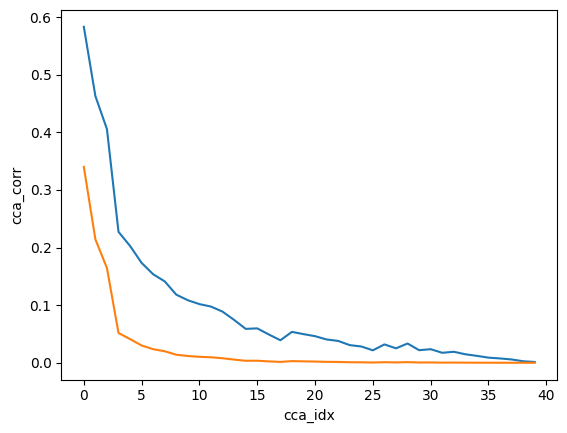

In [149]:
plt.plot(unsup_aft1_cca[2])
plt.plot(np.power(unsup_aft1_cca[2], 2))
print(np.mean(unsup_aft1_cca[2]))
print(np.mean(np.power(unsup_aft1_cca[2], 2)))
plt.xlabel('cca_idx')
plt.ylabel('cca_corr')
plt.show()

Test CCA
0.9999999999999998
0.9999999999999997


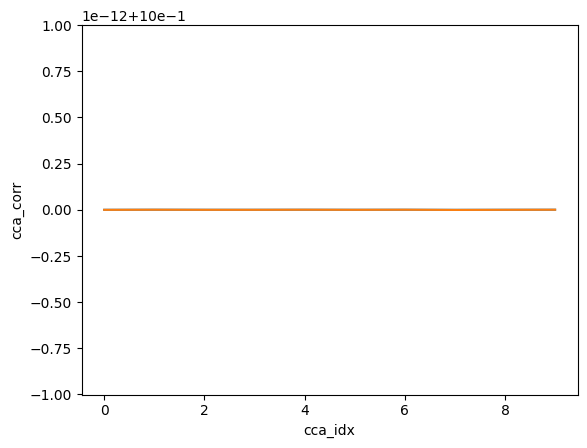

In [843]:
print('Test CCA')
X = np.random.randn(2000, 10)
#Y = np.random.randn(2000, 50)
Y = np.dot(X, np.random.randn(10, 10)) 
a, b, cca = _ridge_cca_first_weights(X, Y, lam =0, n_components=10)
#U = X @ a
#V = Y @ b
U,V = cca.transform(X,Y) #for sklearn version
corr = [np.corrcoef(U[:, i], V[:, i])[0, 1] for i in range(a.shape[1])]
plt.plot(corr)
plt.plot(np.power(corr, 2))
print(np.mean(corr))
print(np.mean(np.power(corr, 2)))
plt.xlabel('cca_idx')
plt.ylabel('cca_corr')
plt.show()

In [ ]:
plt.figure(figsize=(24,14))
plt.subplot(2, 3, 1)
plt.plot(range(sup_bef1_cca[0].min().astype(int), sup_bef1_cca[0].max().astype(int)), 
         range(sup_bef1_cca[0].min().astype(int), sup_bef1_cca[0].max().astype(int)), 
         'k--', label='y=x', alpha=0.5)
plt.scatter(sup_bef1_cca[0], sup_bef1_cca[1], alpha=0.5, s=0.5, c='tab:blue', label='all neurons')
plt.scatter(sup_bef1_cca[0][sup_bef1_tuning], sup_bef1_cca[1][sup_bef1_tuning], alpha=0.5, s=0.5, c='k', label ='tuning neurons')
plt.text(0, -6.5, 
         f'corr: {sup_bef1_cca[2][0]:.3f}\ntuning prop: {100*len(sup_bef1_tuning)/len(sup_bef1_cca[0]):.2f}%', 
         fontsize=16)
plt.title('Supervised CCA Before Training', fontsize=18)
#plt.xlim([-0.25, 0.25])
#plt.ylim([-0.25, 0.25])
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlabel('1st Canonical Variate leaf', fontsize=16)
plt.ylabel('1st Canonical Variate circle', fontsize=16)
plt.legend(fontsize=16)


plt.subplot(2, 3, 2)
plt.plot(range(sup_aft1_cca[0].min().astype(int), sup_aft1_cca[0].max().astype(int)), 
         range(sup_aft1_cca[0].min().astype(int), sup_aft1_cca[0].max().astype(int)), 
         'k--', label='y=x', alpha=0.5)
plt.scatter(sup_aft1_cca[0], sup_aft1_cca[1], alpha=0.5, s=0.5, c='tab:blue')
plt.scatter(sup_aft1_cca[0][sup_aft1_tuning], sup_aft1_cca[1][sup_aft1_tuning], alpha=0.5, s=0.5, c='k')
plt.text(-3, -13, 
         f'corr: {sup_aft1_cca[2][0]:.3f}\ntuning prop: {100*len(sup_aft1_tuning)/len(sup_aft1_cca[0]):.2f}%', 
         fontsize=16)
plt.title('Supervised CCA After Training', fontsize=18)
#plt.xlim([-0.45, 0.45])
#plt.ylim([-0.45, 0.45])
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlabel('1st Canonical Variate leaf', fontsize=16)
plt.ylabel('1st Canonical Variate circle', fontsize=16)


plt.subplot(2, 3, 3)
plt.plot(range(sup_test1_aft1_cca[0].min().astype(int), sup_test1_aft1_cca[0].max().astype(int)), 
         range(sup_test1_aft1_cca[0].min().astype(int), sup_test1_aft1_cca[0].max().astype(int)), 
         'k--', label='y=x', alpha=0.5)
plt.scatter(sup_test1_aft1_cca[0], sup_test1_aft1_cca[1], alpha=0.5, s=0.5, c='tab:blue')
plt.scatter(sup_test1_aft1_cca[0][sup_test1_tuning], sup_test1_aft1_cca[1][sup_test1_tuning], alpha=0.5, s=0.5, c='k')
plt.text(-7, -22, 
         f'corr: {sup_test1_aft1_cca[2][0]:.3f}\ntuning prop: {100*len(sup_test1_tuning)/len(sup_test1_aft1_cca[0]):.2f}%', 
         fontsize=16)
plt.title('Supervised CCA Test After Training', fontsize=18)
#plt.xlim([-0.45, 0.45])
#plt.ylim([-0.45, 0.45])
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlabel('1st Canonical Variate leaf', fontsize=16)
plt.ylabel('1st Canonical Variate circle', fontsize=16)


plt.subplot(2, 3, 4)
plt.plot(range(unsup_bef1_cca[0].min().astype(int), unsup_bef1_cca[0].max().astype(int)), 
         range(unsup_bef1_cca[0].min().astype(int), unsup_bef1_cca[0].max().astype(int)), 
         'k--', label='y=x', alpha=0.5)
plt.scatter(unsup_bef1_cca[0], unsup_bef1_cca[1], alpha=0.5, s=0.5, c='tab:orange')
plt.scatter(unsup_bef1_cca[0][unsup_bef1_tuning], unsup_bef1_cca[1][unsup_bef1_tuning], alpha=0.5, s=0.5, c='k')
plt.text(-2, -8, 
         f'corr: {unsup_bef1_cca[2][0]:.3f}\ntuning prop: {100*len(unsup_bef1_tuning)/len(unsup_bef1_cca[0]):.2f}%', 
         fontsize=16)
plt.title('Unsupervised CCA Before Training', fontsize=18)
#plt.xlim([-0.45, 0.45])
#plt.ylim([-0.45, 0.45])
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlabel('1st Canonical Variate leaf', fontsize=16)
plt.ylabel('1st Canonical Variate circle', fontsize=16)


plt.subplot(2, 3, 5)
plt.plot(range(unsup_aft1_cca[0].min().astype(int), unsup_aft1_cca[0].max().astype(int)), 
         range(unsup_aft1_cca[0].min().astype(int), unsup_aft1_cca[0].max().astype(int)), 
         'k--', label='y=x', alpha=0.5)
plt.scatter(unsup_aft1_cca[0], unsup_aft1_cca[1], alpha=0.5, s=0.5, c='tab:orange')
plt.scatter(unsup_aft1_cca[0][unsup_aft1_tuning], unsup_aft1_cca[1][unsup_aft1_tuning], alpha=0.5, s=0.5, c='k')
plt.text(-3, -10, 
         f'corr: {unsup_aft1_cca[2][0]:.3f}\ntuning prop: {100*len(unsup_aft1_tuning)/len(unsup_aft1_cca[0]):.2f}%', 
         fontsize=16)
plt.title('Unsupervised CCA After Training', fontsize=18)
#plt.xlim([-0.45, 0.45])
#plt.ylim([-0.45, 0.45])
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlabel('1st Canonical Variate leaf', fontsize=16)
plt.ylabel('1st Canonical Variate circle', fontsize=16)


plt.subplot(2, 3, 6)
plt.plot(range(unsup_test1_aft1_cca[0].min().astype(int), unsup_test1_aft1_cca[0].max().astype(int)), 
         range(unsup_test1_aft1_cca[0].min().astype(int), unsup_test1_aft1_cca[0].max().astype(int)), 
         'k--', label='y=x', alpha=0.5)
plt.scatter(unsup_test1_aft1_cca[0], unsup_test1_aft1_cca[1], alpha=0.5, s=0.5, c='tab:orange')
plt.scatter(unsup_test1_aft1_cca[0][unsup_test1_tuning], unsup_test1_aft1_cca[1][unsup_test1_tuning], alpha=0.5, s=0.5, c='k')
plt.text(-4, -15, 
         f'corr: {unsup_test1_aft1_cca[2][0]:.3f}\ntuning prop: {100*len(unsup_test1_tuning)/len(unsup_test1_aft1_cca[0]):.2f}%', 
         fontsize=16)
plt.title('Unsupervised CCA Test After Training', fontsize=18)
#plt.xlim([-0.45, 0.45])
#plt.ylim([-0.45, 0.45])
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlabel('1st Canonical Variate leaf', fontsize=16)
plt.ylabel('1st Canonical Variate circle', fontsize=16)


In [478]:
def plot_cca_scatter(animals, color, aft1_neuron_pos_list, bef1_neuron_pos_list, test1_neuron_pos_list,
                     aft1_corr_sets_list, bef1_corr_sets_list, test1_corr_sets_list, n_components=10):

    nrow = len(animals)
    plt.figure(figsize=(24,7*nrow))
    corr_mat = np.zeros((nrow, 3, 40))
    for i in range(nrow):
        print(f'{animals[i]}')
        aft1_cca, bef1_cca = cca_leaf_circle_analysis(aft1_neuron_pos_list[i].T, bef1_neuron_pos_list[i].T, n_comp=n_components)
        test1_cca, _ = cca_leaf_circle_analysis(test1_neuron_pos_list[i].T, aft1_neuron_pos_list[i].T, stage='test', stage2='after', n_comp=n_components)

        corr_mat[i, 0] = bef1_cca[2]
        corr_mat[i, 1] = aft1_cca[2]
        corr_mat[i, 2] = test1_cca[2]

        aft1_tuning = get_all_tuning_neuron_idx(aft1_corr_sets_list[i])
        bef1_tuning = get_all_tuning_neuron_idx(bef1_corr_sets_list[i])
        test1_tuning = get_all_tuning_neuron_idx(test1_corr_sets_list[i])

        corr_bef1 = np.mean(bef1_cca[2][:n_components])
        corr_aft1 = np.mean(aft1_cca[2][:n_components])
        corr_test1 = np.mean(test1_cca[2][:n_components])

        plt.subplot(nrow, 3, 3*i + 1)
        plt.plot(range(bef1_cca[0][:,0].min().astype(int), bef1_cca[0][:,0].max().astype(int)), 
                range(bef1_cca[0][:,0].min().astype(int), bef1_cca[0][:,0].max().astype(int)), 
                'k--', label='y=x', alpha=0.5)
        plt.scatter(bef1_cca[0][:,0], bef1_cca[1][:,0], alpha=0.5, s=0.5, c=color, label='all neurons')
        plt.scatter(bef1_cca[0][:,0][bef1_tuning], bef1_cca[1][:,0][bef1_tuning], alpha=0.5, s=0.5, c='k', label ='tuning neurons')
        plt.text(bef1_cca[0][:,0].min().astype(int), bef1_cca[1][:,0].min().astype(int),
                f'corr: {corr_bef1:.3f}\ntuning prop: {100*len(bef1_tuning)/len(bef1_cca[0][:,0]):.2f}%', 
                fontsize=20)
        plt.title(f'{animals[i]} CCA Before Training', fontsize=24)
        #plt.xlim([-0.25, 0.25])
        #plt.ylim([-0.25, 0.25])
        plt.xticks(fontsize=20)
        plt.yticks(fontsize=20)
        plt.xlabel('1st Canonical Variate leaf', fontsize=20)
        plt.ylabel('1st Canonical Variate circle', fontsize=20)
        if i==0:
            plt.legend(fontsize=20)


        plt.subplot(nrow, 3, 3*i+2)
        plt.plot(range(aft1_cca[0][:,0].min().astype(int), aft1_cca[0][:,0].max().astype(int)), 
                range(aft1_cca[0][:,0].min().astype(int), aft1_cca[0][:,0].max().astype(int)), 
                'k--', label='y=x', alpha=0.5)
        plt.scatter(aft1_cca[0][:,0], aft1_cca[1][:,0], alpha=0.5, s=0.5, c=color)
        plt.scatter(aft1_cca[0][:,0][aft1_tuning], aft1_cca[1][:,0][aft1_tuning], alpha=0.5, s=0.5, c='k')
        plt.text(aft1_cca[0][:,0].min().astype(int), aft1_cca[1][:,0].min().astype(int),
                f'corr: {corr_aft1:.3f}\ntuning prop: {100*len(aft1_tuning)/len(aft1_cca[0][:,0]):.2f}%', 
                fontsize=20)
        plt.title(f'{animals[i]} CCA After Training', fontsize=24)
        #plt.xlim([-0.45, 0.45])
        #plt.ylim([-0.45, 0.45])
        plt.xticks(fontsize=20)
        plt.yticks(fontsize=20)
        plt.xlabel('1st Canonical Variate leaf', fontsize=20)
        plt.ylabel('1st Canonical Variate circle', fontsize=20)


        plt.subplot(nrow, 3, 3*i+3)
        plt.plot(range(test1_cca[0][:,0].min().astype(int), test1_cca[0][:,0].max().astype(int)), 
                range(test1_cca[0][:,0].min().astype(int), test1_cca[0][:,0].max().astype(int)), 
                'k--', label='y=x', alpha=0.5)
        plt.scatter(test1_cca[0][:,0], test1_cca[1][:,0], alpha=0.5, s=0.5, c=color)
        plt.scatter(test1_cca[0][:,0][test1_tuning], test1_cca[1][:,0][test1_tuning], alpha=0.5, s=0.5, c='k')
        plt.text(test1_cca[0][:,0].min().astype(int), test1_cca[1][:,0][test1_tuning].min().astype(int),
                f'corr: {corr_test1:.3f}\ntuning prop: {100*len(test1_tuning)/len(test1_cca[0][:,0]):.2f}%',
                fontsize=20)
        plt.title(f'{animals[i]} CCA Test1', fontsize=24)
        #plt.xlim([-0.45, 0.45])
        #plt.ylim([-0.45, 0.45])
        plt.xticks(fontsize=20)
        plt.yticks(fontsize=20)
        plt.xlabel('1st Canonical Variate leaf', fontsize=20)
        plt.ylabel('1st Canonical Variate circle', fontsize=20)

    plt.tight_layout()
    plt.show()

    return corr_mat


Supervised
TX109
Leaf Circle CCA: 0.435 (after), 0.595 (before)
Leaf Circle CCA: 0.430 (test), 0.435 (after)
TX108
Leaf Circle CCA: 0.376 (after), 0.578 (before)
Leaf Circle CCA: 0.353 (test), 0.376 (after)
TX60
Leaf Circle CCA: 0.353 (after), 0.490 (before)
Leaf Circle CCA: 0.270 (test), 0.353 (after)
VR2
Leaf Circle CCA: 0.371 (after), 0.512 (before)
Leaf Circle CCA: 0.283 (test), 0.371 (after)


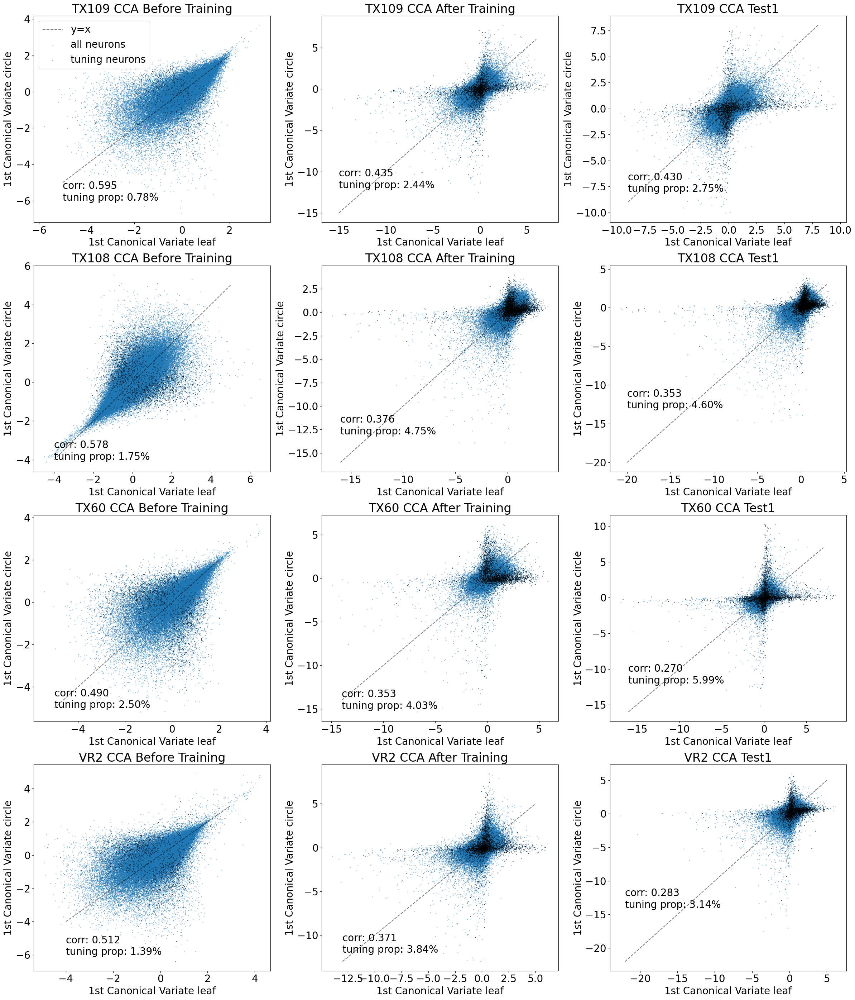

Unsupervised
TX83
Leaf Circle CCA: 0.484 (after), 0.583 (before)
Leaf Circle CCA: 0.417 (test), 0.484 (after)
TX119
Leaf Circle CCA: 0.354 (after), 0.464 (before)
Leaf Circle CCA: 0.291 (test), 0.354 (after)
TX88
Leaf Circle CCA: 0.379 (after), 0.563 (before)
Leaf Circle CCA: 0.358 (test), 0.379 (after)
TX105
Leaf Circle CCA: 0.428 (after), 0.603 (before)
Leaf Circle CCA: 0.418 (test), 0.428 (after)
TX123
Leaf Circle CCA: 0.417 (after), 0.547 (before)
Leaf Circle CCA: 0.345 (test), 0.417 (after)
DR15
Leaf Circle CCA: 0.448 (after), 0.591 (before)
Leaf Circle CCA: 0.414 (test), 0.448 (after)
DR10
Leaf Circle CCA: 0.313 (after), 0.606 (before)
Leaf Circle CCA: 0.277 (test), 0.313 (after)


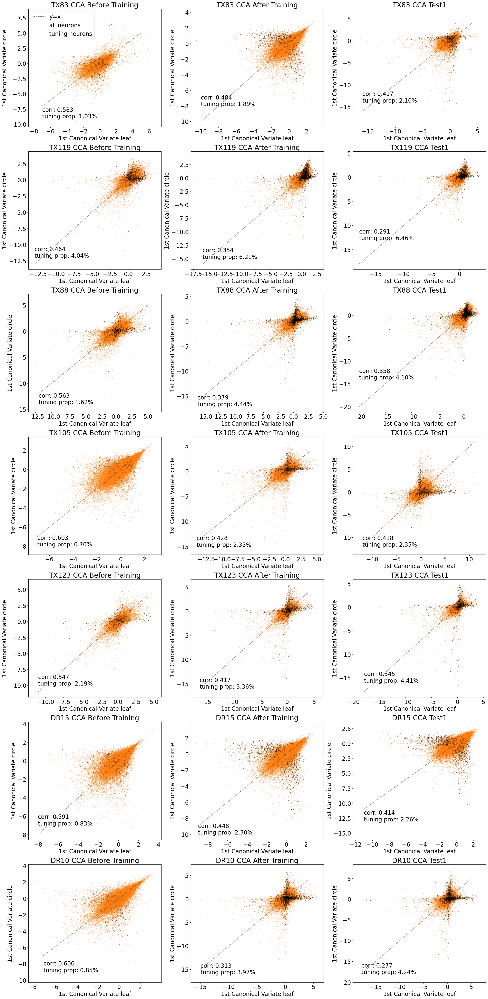

In [167]:
print('Supervised')
animals = ['TX109', 'TX108', 'TX60', 'VR2']
aft1_neuron_pos_list = [sup_aft1_neuron_pos, sup1_aft1_neuron_pos, sup2_aft1_neuron_pos, sup3_aft1_neuron_pos]
bef1_neuron_pos_list = [sup_bef1_neuron_pos, sup1_bef1_neuron_pos, sup2_bef1_neuron_pos, sup3_bef1_neuron_pos]
test1_neuron_pos_list = [sup_test1_neuron_pos, sup1_test1_neuron_pos, sup2_test1_neuron_pos, sup3_test1_neuron_pos]
aft1_corr_sets_list = [sup_aft1_corr_sets, sup1_aft1_corr_sets, sup2_aft1_corr_sets, sup3_aft1_corr_sets]
bef1_corr_sets_list = [sup_bef1_corr_sets, sup1_bef1_corr_sets, sup2_bef1_corr_sets, sup3_bef1_corr_sets]
test1_corr_sets_list = [sup_test1_corr_sets, sup1_test1_corr_sets, sup2_test1_corr_sets, sup3_test1_corr_sets]  

sup_cca_corr_mat = plot_cca_scatter(animals, 'tab:blue', aft1_neuron_pos_list, bef1_neuron_pos_list, test1_neuron_pos_list, aft1_corr_sets_list, bef1_corr_sets_list, test1_corr_sets_list, n_components=3)

print('Unsupervised')
animals = ['TX83', 'TX119', 'TX88', 'TX105', 'TX123', 'DR15', 'DR10']
aft1_neuron_pos_list = [unsup_aft1_neuron_pos, unsup1_aft1_neuron_pos, unsup2_aft1_neuron_pos, unsup3_aft1_neuron_pos, unsup4_aft1_neuron_pos, unsup5_aft1_neuron_pos, unsup6_aft1_neuron_pos]
bef1_neuron_pos_list = [unsup_bef1_neuron_pos, unsup1_bef1_neuron_pos, unsup2_bef1_neuron_pos, unsup3_bef1_neuron_pos, unsup4_bef1_neuron_pos, unsup5_bef1_neuron_pos, unsup6_bef1_neuron_pos]
test1_neuron_pos_list = [unsup_test1_neuron_pos, unsup1_test1_neuron_pos, unsup2_test1_neuron_pos, unsup3_test1_neuron_pos, unsup4_test1_neuron_pos, unsup5_test1_neuron_pos, unsup6_test1_neuron_pos]
aft1_corr_sets_list = [unsup_aft1_corr_sets, unsup1_aft1_corr_sets, unsup2_aft1_corr_sets, unsup3_aft1_corr_sets, unsup4_aft1_corr_sets, unsup5_aft1_corr_sets, unsup6_aft1_corr_sets]
bef1_corr_sets_list = [unsup_bef1_corr_sets, unsup1_bef1_corr_sets, unsup2_bef1_corr_sets, unsup3_bef1_corr_sets, unsup4_bef1_corr_sets, unsup5_bef1_corr_sets, unsup6_bef1_corr_sets]
test1_corr_sets_list = [unsup_test1_corr_sets, unsup1_test1_corr_sets, unsup2_test1_corr_sets, unsup3_test1_corr_sets, unsup4_test1_corr_sets, unsup5_test1_corr_sets, unsup6_test1_corr_sets]

unsup_cca_corr_mat = plot_cca_scatter(animals, 'tab:orange', aft1_neuron_pos_list, bef1_neuron_pos_list, test1_neuron_pos_list, aft1_corr_sets_list, bef1_corr_sets_list, test1_corr_sets_list, n_components=3)


After - Before P-values: 0.950112548191585
Test - After P-values: 0.7506897312785639


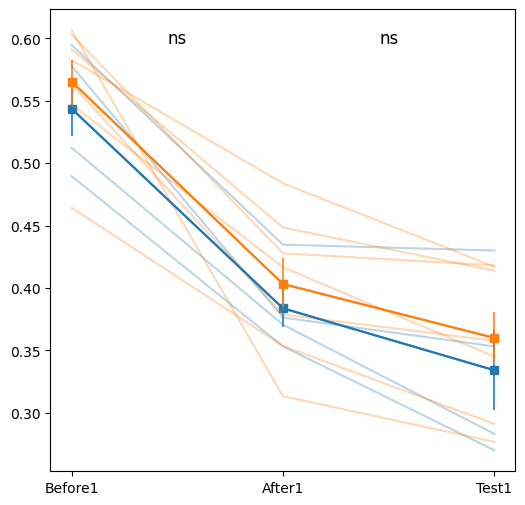

In [169]:
sup_cca_corr = np.mean(sup_cca_corr_mat[:,:,:3], axis=2)
unsup_cca_corr = np.mean(unsup_cca_corr_mat[:,:,:3], axis=2)

sup_corr_mean = np.mean(sup_cca_corr, axis=0)
sup_corr_sem = np.std(sup_cca_corr, axis=0) / np.sqrt(sup_cca_corr.shape[0])
unsup_corr_mean = np.mean(unsup_cca_corr, axis=0)
unsup_corr_sem = np.std(unsup_cca_corr, axis=0) / np.sqrt(unsup_cca_corr.shape[0])

from scipy.stats import ttest_ind
sup_diff1 = sup_cca_corr[:, 1] - sup_cca_corr[:, 0]
unsup_diff1 = unsup_cca_corr[:, 1] - unsup_cca_corr[:, 0]
_, p_val1 = ttest_ind(sup_diff1, unsup_diff1, axis=0)
print("After - Before P-values:", p_val1)
sup_diff2 = sup_cca_corr[:, 2] - sup_cca_corr[:, 1]
unsup_diff2 = unsup_cca_corr[:, 2] - unsup_cca_corr[:, 1]
_, p_val2 = ttest_ind(sup_diff2, unsup_diff2, axis=0)
print("Test - After P-values:", p_val2)

def p_to_stars(p):
    return "****" if p < 1e-4 else "***" if p < 1e-3 else "**" if p < 1e-2 else "*" if p < 5e-2 else "ns"

plt.figure(figsize=(6, 6))
plt.plot(['Before1', 'After1', 'Test1'], sup_corr_mean, label='Supervised', color='tab:blue', marker='s')
plt.errorbar(['Before1', 'After1', 'Test1'], sup_corr_mean, yerr=sup_corr_sem, color='tab:blue', alpha=0.8)
plt.plot(['Before1', 'After1', 'Test1'], unsup_corr_mean, label='Unsupervised', color='tab:orange', marker='s')
plt.errorbar(['Before1', 'After1', 'Test1'], unsup_corr_mean, yerr=unsup_corr_sem, color='tab:orange', alpha=0.8)
plt.text(0.5,0.6,p_to_stars(p_val1), fontsize=12, ha='center', va='center', color='k')
plt.text(1.5,0.6,p_to_stars(p_val2), fontsize=12, ha='center', va='center', color='k')
for i in range(sup_cca_corr.shape[0]):
    plt.plot(['Before1', 'After1', 'Test1'], sup_cca_corr[i, :], color='tab:blue', alpha=0.3)
for i in range(unsup_cca_corr.shape[0]):
    plt.plot(['Before1', 'After1', 'Test1'], unsup_cca_corr[i, :], color='tab:orange', alpha=0.3)

plt.show()

#### Neuron PC

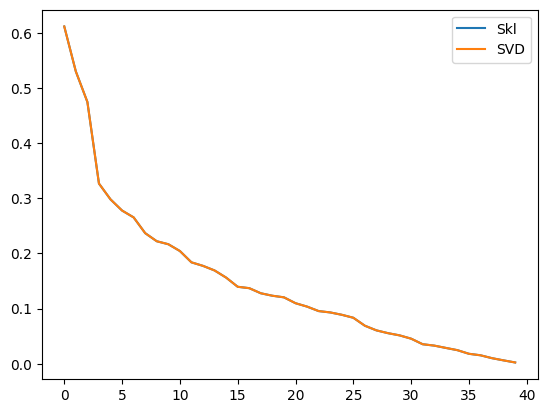

In [ ]:
# test rreliability of my cca
from sklearn.cross_decomposition import CCA

Xz = zscore(sup_aft1_svd_neuron_pos.T[:,:40], axis=0)
Yz = zscore(sup_aft1_svd_neuron_pos.T[:,40:], axis=0)

cca = CCA(n_components=40, scale=False, max_iter=10000, tol=1e-12)
cca.fit(Xz, Yz)
U_skl, V_skl = cca.transform(Xz, Yz)
corr_skl = np.array([np.corrcoef(U_skl[:,i], V_skl[:,i])[0,1] for i in range(40)])

# my SVD version with lam=0 on the same Xz,Yz:
a, b = _ridge_cca_first_weights(Xz, Yz, lam=0, n_components=40)
U = Xz @ a; V = Yz @ b
corr_svd = np.array([np.corrcoef(U[:,i], V[:,i])[0,1] for i in range(40)])

plt.plot(corr_skl, label='Skl')
plt.plot(corr_svd, label='SVD')
plt.legend()
plt.show()


In [940]:
import matplotlib as mpl

def _mask_and_bounds(x, y, keep_pct=99):
    """
    Keep central `keep_pct`% of points jointly by clipping x and y
    using symmetric tail percentiles, then return mask and square bounds.
    """
    tail = (100 - keep_pct) / 2.0
    x_lo, x_hi = np.percentile(x, [tail, 100 - tail])
    y_lo, y_hi = np.percentile(y, [tail, 100 - tail])
    m = (x >= x_lo) & (x <= x_hi) & (y >= y_lo) & (y <= y_hi)

    # Square bounds aligned to the filtered scatter
    lo = min(x[m].min(), y[m].min())
    hi = max(x[m].max(), y[m].max())
    return m, lo, hi

def plot_cca_scatter(animals, color, aft1_neuron_pos_list, bef1_neuron_pos_list, test1_neuron_pos_list, n_components=10):

    nrow = len(animals)
    plt.figure(figsize=(36, 7*nrow))
    corr_mat = np.zeros((nrow, 3, 40))

    # 50 discrete colors
    '''
    cmap50 = plt.cm.get_cmap('viridis', 2000)
    norm50 = mpl.colors.BoundaryNorm(np.arange(-0.5, 2000.5, 1), cmap50.N)
    idx = np.arange(2000)
    '''

    for i in range(nrow):
        print(f'{animals[i]}')
        aft1_cca, bef1_cca = cca_leaf_circle_analysis(aft1_neuron_pos_list[i].T, bef1_neuron_pos_list[i].T, n_comp=n_components)
        test1_cca, _ = cca_leaf_circle_analysis(test1_neuron_pos_list[i].T, aft1_neuron_pos_list[i].T, stage='test', stage2='after', n_comp=n_components)

        corr_mat[i, 0] = bef1_cca[2]
        corr_mat[i, 1] = aft1_cca[2]
        corr_mat[i, 2] = test1_cca[2]

        corr_bef1 = np.mean(np.power(bef1_cca[2][:n_components], 2))
        corr_aft1 = np.mean(np.power(aft1_cca[2][:n_components], 2))
        corr_test1 = np.mean(np.power(test1_cca[2][:n_components], 2))
        
        # Before 
        plt.subplot(nrow, 4, 4*i + 1)
        x = bef1_cca[0][:, 0]
        y = bef1_cca[1][:, 0]
        m, lo, hi = _mask_and_bounds(x, y, keep_pct=95)
        # y = x over the 99% bounds
        t = np.linspace(lo, hi, 100)
        plt.plot(t, t, 'k--', label='y=x', alpha=0.6)
        # Scatter only the kept 99%
        #plt.scatter(x[m], y[m], alpha=0.6, s=10, c=idx[m], cmap=cmap50, norm=norm50, label='Neuron PCs')
        plt.scatter(x[m], y[m], alpha=0.6, s=10, c=color, label='Neuron PCs')
        plt.text(lo, lo, f'R^2: {corr_bef1:.3f} First Corr: {bef1_cca[2][0]:.3f}', fontsize=20, va='bottom', ha='left')
        plt.title(f'{animals[i]} CCA Before Training (2000PCs)', fontsize=24)
        plt.xlim(lo, hi); plt.ylim(lo, hi)
        plt.xticks(fontsize=20); plt.yticks(fontsize=20)
        plt.xlabel('1st Canonical Variate leaf', fontsize=20)
        plt.ylabel('1st Canonical Variate circle', fontsize=20)
        if i == 0:
            plt.legend(fontsize=20, loc='upper left')

        # After
        plt.subplot(nrow, 4, 4*i + 2)
        x = aft1_cca[0][:, 0]
        y = aft1_cca[1][:, 0]
        m, _, _ = _mask_and_bounds(x, y, keep_pct=95)
        t = np.linspace(lo, hi, 100)
        plt.plot(t, t, 'k--', label='y=x', alpha=0.6)
        #plt.scatter(x[m], y[m], alpha=0.6, s=10, c=idx[m], cmap=cmap50, norm=norm50)
        plt.scatter(x[m], y[m], alpha=0.6, s=10, c=color)
        plt.text(lo, lo, f'R^2: {corr_aft1:.3f} First Corr: {aft1_cca[2][0]:.3f}', fontsize=20, va='bottom', ha='left')
        plt.title(f'{animals[i]} CCA After Training (2000PCs)', fontsize=24)
        plt.xlim(lo, hi); plt.ylim(lo, hi)
        plt.xticks(fontsize=20); plt.yticks(fontsize=20)
        plt.xlabel('1st Canonical Variate leaf', fontsize=20)
        plt.ylabel('1st Canonical Variate circle', fontsize=20)


        # Test1
        plt.subplot(nrow, 4, 4*i + 3)
        x = test1_cca[0][:, 0]
        y = test1_cca[1][:, 0]
        m, _, _ = _mask_and_bounds(x, y, keep_pct=95)
        t = np.linspace(lo, hi, 100)
        plt.plot(t, t, 'k--', label='y=x', alpha=0.6)
        #plt.scatter(x[m], y[m], alpha=0.6, s=10, c=idx[m], cmap=cmap50, norm=norm50)
        plt.scatter(x[m], y[m], alpha=0.6, s=10, c=color)
        plt.text(lo, lo, f'R^2: {corr_test1:.3f} First Corr: {test1_cca[2][0]:.3f}', fontsize=20, va='bottom', ha='left')
        plt.title(f'{animals[i]} CCA Test1 (2000PCs)', fontsize=24)
        plt.xlim(lo, hi); plt.ylim(lo, hi)
        plt.xticks(fontsize=20); plt.yticks(fontsize=20)
        plt.xlabel('1st Canonical Variate leaf', fontsize=20)
        plt.ylabel('1st Canonical Variate circle', fontsize=20)

        # pval
        plt.subplot(nrow, 4, 4*i + 4)
        p1 = bef1_cca[3]
        p2 = aft1_cca[3]
        p3 = test1_cca[3]
        plt.plot(p1)
        plt.plot(p2)
        plt.plot(p3)
        plt.xlabel('Canonical Corr Idx', fontsize=20)
        plt.ylabel('P-value', fontsize=20)
        plt.yscale('log')
        plt.xticks(fontsize=20); plt.yticks(fontsize=20)
        plt.hlines(0.05, 0, n_components - 1, colors='k', linestyles='dashed')
        plt.title(f'Permutation Test P-values of Corr Significance', fontsize=24)
        if i == 0:
            plt.legend(['Before', 'After', 'Test1', 'p=0.05'], fontsize=20)

    plt.tight_layout()
    plt.show()

    return corr_mat


Supervised
TX109
Leaf–Circle ridge-CCA (λ=0.1): R^2 0.029 (after), R^2 0.058 (before)
CC1: r=0.592, p=0.000999 (after); CC1: r=0.830, p=0.000999 (before)
Leaf–Circle ridge-CCA (λ=0.1): R^2 0.026 (test), R^2 0.029 (after)
CC1: r=0.578, p=0.000999 (test); CC1: r=0.592, p=0.000999 (after)
TX108
Leaf–Circle ridge-CCA (λ=0.1): R^2 0.026 (after), R^2 0.055 (before)
CC1: r=0.580, p=0.00599 (after); CC1: r=0.844, p=0.002 (before)
Leaf–Circle ridge-CCA (λ=0.1): R^2 0.022 (test), R^2 0.026 (after)
CC1: r=0.582, p=0.000999 (test); CC1: r=0.580, p=0.00799 (after)
TX60
Leaf–Circle ridge-CCA (λ=0.1): R^2 0.022 (after), R^2 0.044 (before)
CC1: r=0.580, p=0.004 (after); CC1: r=0.828, p=0.000999 (before)
Leaf–Circle ridge-CCA (λ=0.1): R^2 0.012 (test), R^2 0.022 (after)
CC1: r=0.381, p=0.044 (test); CC1: r=0.580, p=0.014 (after)
VR2
Leaf–Circle ridge-CCA (λ=0.1): R^2 0.019 (after), R^2 0.040 (before)
CC1: r=0.482, p=0.038 (after); CC1: r=0.760, p=0.000999 (before)
Leaf–Circle ridge-CCA (λ=0.1): R^2 0.0

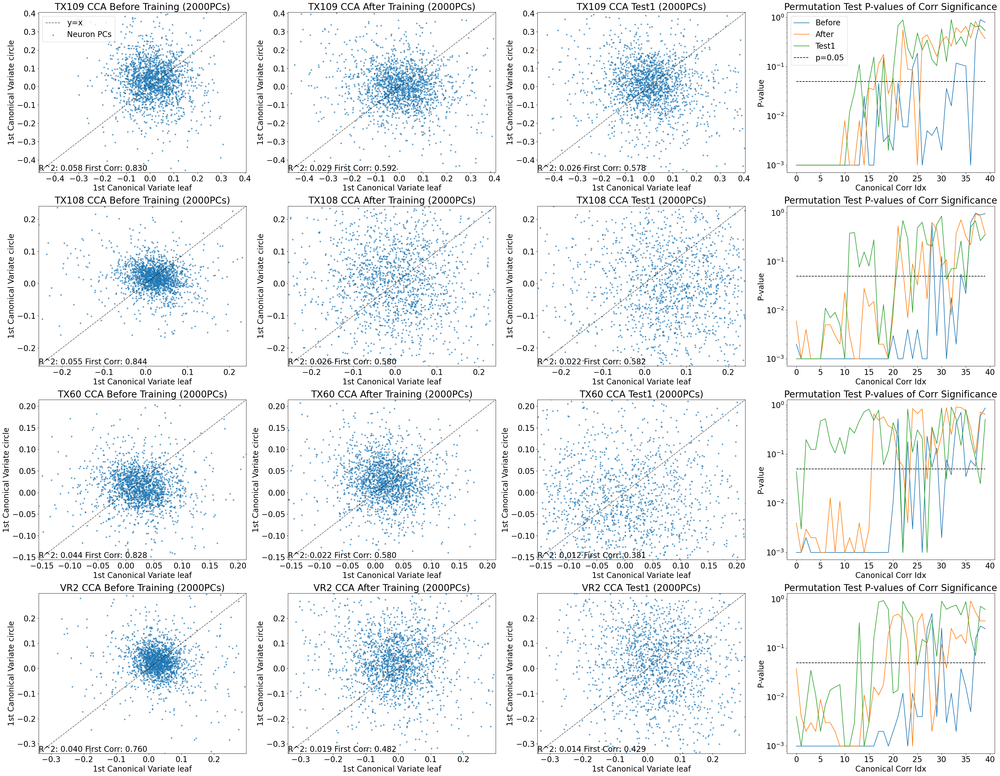

Unsupervised
TX83
Leaf–Circle ridge-CCA (λ=0.1): R^2 0.038 (after), R^2 0.049 (before)
CC1: r=0.694, p=0.003 (after); CC1: r=0.729, p=0.000999 (before)
Leaf–Circle ridge-CCA (λ=0.1): R^2 0.034 (test), R^2 0.038 (after)
CC1: r=0.595, p=0.000999 (test); CC1: r=0.694, p=0.002 (after)
TX119
Leaf–Circle ridge-CCA (λ=0.1): R^2 0.019 (after), R^2 0.034 (before)
CC1: r=0.605, p=0.000999 (after); CC1: r=0.705, p=0.000999 (before)
Leaf–Circle ridge-CCA (λ=0.1): R^2 0.016 (test), R^2 0.019 (after)
CC1: r=0.534, p=0.002 (test); CC1: r=0.605, p=0.003 (after)
TX88
Leaf–Circle ridge-CCA (λ=0.1): R^2 0.023 (after), R^2 0.049 (before)
CC1: r=0.606, p=0.000999 (after); CC1: r=0.724, p=0.000999 (before)
Leaf–Circle ridge-CCA (λ=0.1): R^2 0.021 (test), R^2 0.023 (after)
CC1: r=0.614, p=0.000999 (test); CC1: r=0.606, p=0.000999 (after)
TX105
Leaf–Circle ridge-CCA (λ=0.1): R^2 0.032 (after), R^2 0.057 (before)
CC1: r=0.628, p=0.000999 (after); CC1: r=0.864, p=0.000999 (before)
Leaf–Circle ridge-CCA (λ=0.1):

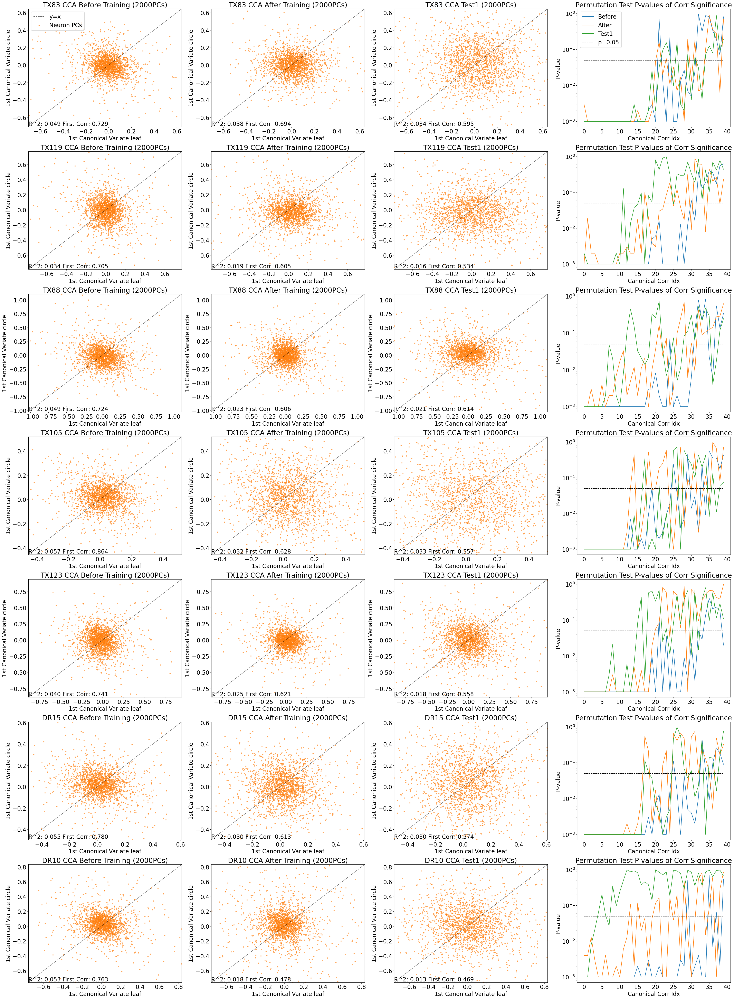

In [948]:
PC = 2000
print('Supervised')
animals = ['TX109', 'TX108', 'TX60', 'VR2']
aft1_neuron_pos_list = [sup_aft1_svd_neuron_pos[:, :PC], sup1_aft1_svd_neuron_pos[:, :PC], sup2_aft1_svd_neuron_pos[:, :PC], sup3_aft1_svd_neuron_pos[:, :PC]]
bef1_neuron_pos_list = [sup_bef1_svd_neuron_pos[:, :PC], sup1_bef1_svd_neuron_pos[:, :PC], sup2_bef1_svd_neuron_pos[:, :PC], sup3_bef1_svd_neuron_pos[:, :PC]]
test1_neuron_pos_list = [sup_test1_svd_neuron_pos[:, :PC], sup1_test1_svd_neuron_pos[:, :PC], sup2_test1_svd_neuron_pos[:, :PC], sup3_test1_svd_neuron_pos[:, :PC]]

sup_cca_corr_mat = plot_cca_scatter(animals, 'tab:blue', aft1_neuron_pos_list, bef1_neuron_pos_list, test1_neuron_pos_list, n_components=40)

print('Unsupervised')
animals = ['TX83', 'TX119', 'TX88', 'TX105', 'TX123', 'DR15', 'DR10']
aft1_neuron_pos_list = [unsup_aft1_svd_neuron_pos[:,:PC], unsup1_aft1_svd_neuron_pos[:,:PC], unsup2_aft1_svd_neuron_pos[:,:PC], unsup3_aft1_svd_neuron_pos[:,:PC], unsup4_aft1_svd_neuron_pos[:,:PC], unsup5_aft1_svd_neuron_pos[:,:PC], unsup6_aft1_svd_neuron_pos[:,:PC]]
bef1_neuron_pos_list = [unsup_bef1_svd_neuron_pos[:,:PC], unsup1_bef1_svd_neuron_pos[:,:PC], unsup2_bef1_svd_neuron_pos[:,:PC], unsup3_bef1_svd_neuron_pos[:,:PC], unsup4_bef1_svd_neuron_pos[:,:PC], unsup5_bef1_svd_neuron_pos[:,:PC], unsup6_bef1_svd_neuron_pos[:,:PC]]
test1_neuron_pos_list = [unsup_test1_svd_neuron_pos[:,:PC], unsup1_test1_svd_neuron_pos[:,:PC], unsup2_test1_svd_neuron_pos[:,:PC], unsup3_test1_svd_neuron_pos[:,:PC], unsup4_test1_svd_neuron_pos[:,:PC], unsup5_test1_svd_neuron_pos[:,:PC], unsup6_test1_svd_neuron_pos[:,:PC]]


unsup_cca_corr_mat = plot_cca_scatter(animals, 'tab:orange', aft1_neuron_pos_list, bef1_neuron_pos_list, test1_neuron_pos_list, n_components=40)


After - Before P-values: 0.275131741767702
Test - After P-values: 0.22005144708994523


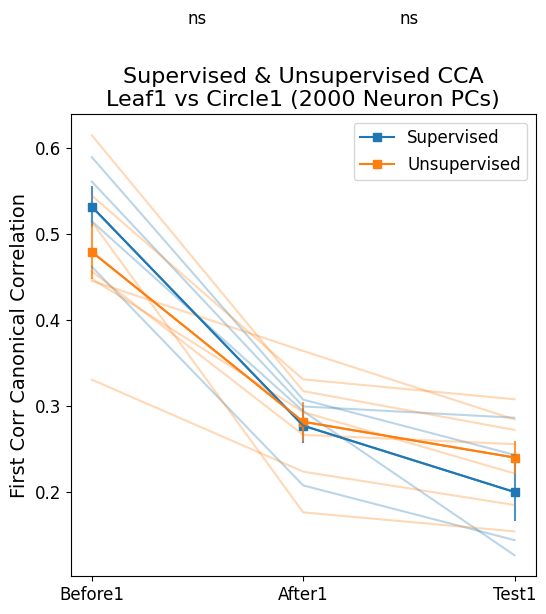

In [951]:
sup_cca_corr = np.mean(np.power(sup_cca_corr_mat[:,:,:2], 2), axis=2)
unsup_cca_corr = np.mean(np.power(unsup_cca_corr_mat[:,:,:2], 2), axis=2)
#sup_cca_corr = sup_cca_corr_mat[:,:,0]
#unsup_cca_corr = unsup_cca_corr_mat[:,:,0]

sup_corr_mean = np.mean(sup_cca_corr, axis=0)
sup_corr_sem = np.std(sup_cca_corr, axis=0) / np.sqrt(sup_cca_corr.shape[0])
unsup_corr_mean = np.mean(unsup_cca_corr, axis=0)
unsup_corr_sem = np.std(unsup_cca_corr, axis=0) / np.sqrt(unsup_cca_corr.shape[0])

from scipy.stats import ttest_ind
sup_diff1 = sup_cca_corr[:, 1] - sup_cca_corr[:, 0]
unsup_diff1 = unsup_cca_corr[:, 1] - unsup_cca_corr[:, 0]
_, p_val1 = ttest_ind(sup_diff1, unsup_diff1, axis=0)
print("After - Before P-values:", p_val1)
sup_diff2 = sup_cca_corr[:, 2] - sup_cca_corr[:, 1]
unsup_diff2 = unsup_cca_corr[:, 2] - unsup_cca_corr[:, 1]
_, p_val2 = ttest_ind(sup_diff2, unsup_diff2, axis=0)
print("Test - After P-values:", p_val2)

def p_to_stars(p):
    return "****" if p < 1e-4 else "***" if p < 1e-3 else "**" if p < 1e-2 else "*" if p < 5e-2 else "ns"

plt.figure(figsize=(6, 6))
plt.plot(['Before1', 'After1', 'Test1'], sup_corr_mean, label='Supervised', color='tab:blue', marker='s')
plt.errorbar(['Before1', 'After1', 'Test1'], sup_corr_mean, yerr=sup_corr_sem, color='tab:blue', alpha=0.8)
plt.plot(['Before1', 'After1', 'Test1'], unsup_corr_mean, label='Unsupervised', color='tab:orange', marker='s')
plt.errorbar(['Before1', 'After1', 'Test1'], unsup_corr_mean, yerr=unsup_corr_sem, color='tab:orange', alpha=0.8)
plt.text(0.5,0.75,p_to_stars(p_val1), fontsize=12, ha='center', va='center', color='k')
plt.text(1.5,0.75,p_to_stars(p_val2), fontsize=12, ha='center', va='center', color='k')
for i in range(sup_cca_corr.shape[0]):
    plt.plot(['Before1', 'After1', 'Test1'], sup_cca_corr[i, :], color='tab:blue', alpha=0.3)
for i in range(unsup_cca_corr.shape[0]):
    plt.plot(['Before1', 'After1', 'Test1'], unsup_cca_corr[i, :], color='tab:orange', alpha=0.3)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.legend(['Supervised', 'Unsupervised'], fontsize=12)

plt.ylabel('First Corr Canonical Correlation', fontsize=14)
plt.title('Supervised & Unsupervised CCA\nLeaf1 vs Circle1 (2000 Neuron PCs)', fontsize=16)

plt.show()

0.09458145556813788
0.02398938634570689


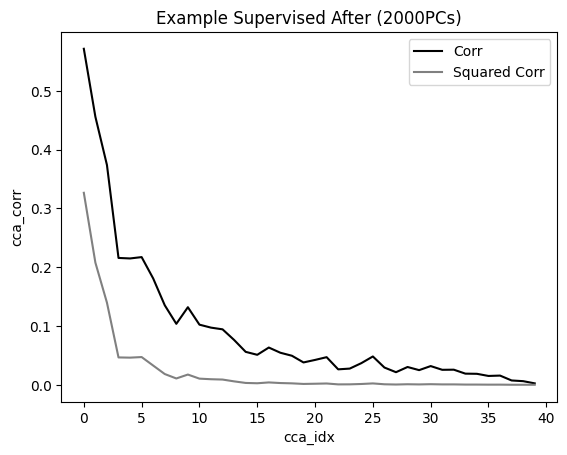

0.11448373938603777
0.030714623256055628


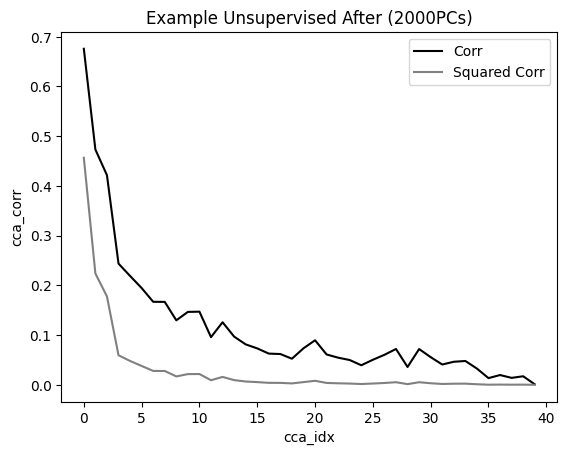

In [675]:
plt.plot(sup_cca_corr_mat[0,1,:], color='k', label='Corr')
plt.plot(np.power(sup_cca_corr_mat[0,1,:], 2), color='gray', label='Squared Corr')
print(np.mean(sup_cca_corr_mat[0,1,:]))
print(np.mean(np.power(sup_cca_corr_mat[0,1,:], 2)))
plt.xlabel('cca_idx')
plt.ylabel('cca_corr')
plt.title('Example Supervised After (2000PCs)')
plt.legend()
plt.show()

plt.plot(unsup_cca_corr_mat[0,1,:], color='k', label='Corr')
plt.plot(np.power(unsup_cca_corr_mat[0,1,:], 2), color='gray', label='Squared Corr')
print(np.mean(unsup_cca_corr_mat[0,1,:]))
print(np.mean(np.power(unsup_cca_corr_mat[0,1,:], 2)))
plt.xlabel('cca_idx')
plt.ylabel('cca_corr')
plt.title('Example Unsupervised After (2000PCs)')
plt.legend()
plt.show()

In [ ]:
for PC in range(40, 1001)
    animals = ['TX109', 'TX108', 'TX60', 'VR2']
    aft1_neuron_pos_list = [sup_aft1_svd_neuron_pos[:, :PC], sup1_aft1_svd_neuron_pos[:, :PC], sup2_aft1_svd_neuron_pos[:, :PC], sup3_aft1_svd_neuron_pos[:, :PC]]
    bef1_neuron_pos_list = [sup_bef1_svd_neuron_pos[:, :PC], sup1_bef1_svd_neuron_pos[:, :PC], sup2_bef1_svd_neuron_pos[:, :PC], sup3_bef1_svd_neuron_pos[:, :PC]]
    test1_neuron_pos_list = [sup_test1_svd_neuron_pos[:, :PC], sup1_test1_svd_neuron_pos[:, :PC], sup2_test1_svd_neuron_pos[:, :PC], sup3_test1_svd_neuron_pos[:, :PC]]


    animals = ['TX83', 'TX119', 'TX88', 'TX105', 'TX123', 'DR15', 'DR10']
    aft1_neuron_pos_list = [unsup_aft1_svd_neuron_pos[:,:PC], unsup1_aft1_svd_neuron_pos[:,:PC], unsup2_aft1_svd_neuron_pos[:,:PC], unsup3_aft1_svd_neuron_pos[:,:PC], unsup4_aft1_svd_neuron_pos[:,:PC], unsup5_aft1_svd_neuron_pos[:,:PC], unsup6_aft1_svd_neuron_pos[:,:PC]]
    bef1_neuron_pos_list = [unsup_bef1_svd_neuron_pos[:,:PC], unsup1_bef1_svd_neuron_pos[:,:PC], unsup2_bef1_svd_neuron_pos[:,:PC], unsup3_bef1_svd_neuron_pos[:,:PC], unsup4_bef1_svd_neuron_pos[:,:PC], unsup5_bef1_svd_neuron_pos[:,:PC], unsup6_bef1_svd_neuron_pos[:,:PC]]
    test1_neuron_pos_list = [unsup_test1_svd_neuron_pos[:,:PC], unsup1_test1_svd_neuron_pos[:,:PC], unsup2_test1_svd_neuron_pos[:,:PC], unsup3_test1_svd_neuron_pos[:,:PC], unsup4_test1_svd_neuron_pos[:,:PC], unsup5_test1_svd_neuron_pos[:,:PC], unsup6_test1_svd_neuron_pos[:,:PC]]



nrow = len(animals)
corr_mat = np.zeros((nrow, 3, 40))

for i in range(nrow):
    print(f'{animals[i]}')
    aft1_cca, bef1_cca = cca_leaf_circle_analysis(aft1_neuron_pos_list[i].T, bef1_neuron_pos_list[i].T, n_comp=n_components)
    test1_cca, _ = cca_leaf_circle_analysis(test1_neuron_pos_list[i].T, aft1_neuron_pos_list[i].T, stage='test', stage2='after', n_comp=n_components)

    corr_mat[i, 0] = bef1_cca[2]
    corr_mat[i, 1] = aft1_cca[2]
    corr_mat[i, 2] = test1_cca[2]

    corr_bef1 = np.mean(np.power(bef1_cca[2][:n_components], 2))
    corr_aft1 = np.mean(np.power(aft1_cca[2][:n_components], 2))
    corr_test1 = np.mean(np.power(test1_cca[2][:n_components], 2))

In [13]:
from scipy.ndimage import gaussian_filter1d

def gauss(x, A, mu, sigma, B):
    return A * np.exp(-((x-mu)**2)/(2*sigma**2)) + B

def filter_binned_spks(binned_spks, corr_thresh=0.9, diff_thresh=0.9, corr_NoTune_thresh=0.8):
    """
    Designe filter to binned spikes.
    """
    _, nn, npos = binned_spks.shape
    gauss_spks = gaussian_filter1d(binned_spks, sigma=3, axis=2)
    pos = np.zeros(nn)
    corr_type = np.zeros(nn)
    for i in range(nn):
        if (gauss_spks[0,i,:].max() - gauss_spks[0,i,:].min() < 1) and (gauss_spks[1,i,:].max() - gauss_spks[1,i,:].min() < 1):
            pos[i] = -1  # skip if neuron is not tuned
            corr_type[i] = -1
        else:
            a1 = np.zeros(npos)
            b1 = np.zeros(npos)
            ab1 = np.zeros(npos)
            for j in range(npos):
                gauss_j = gauss(np.linspace(0, 1, npos), 3, j/npos, 0.07, -0.1)
                a_j = np.corrcoef(gauss_spks[0,i,:], gauss_j)[0,1]
                b_j = np.corrcoef(gauss_spks[1,i,:], gauss_j)[0,1]
                ab_j = np.corrcoef(gauss_spks[0,i,:] - gauss_spks[1,i,:], gauss_j)[0,1]
                a1[j] = a_j
                b1[j] = b_j
                ab1[j] = ab_j

            pos_i = np.argmax(abs(ab1))  # find position that diff vec with maximum correlation with gauss (positive)
            a_i = np.corrcoef(a1, gauss(np.linspace(0, 1, npos), 3, pos_i/npos, 0.07, -0.1))[0,1]
            b_i = np.corrcoef(b1, gauss(np.linspace(0, 1, npos), 3, pos_i/npos, 0.07, -0.1))[0,1]
            ab_i = np.corrcoef(ab1, gauss(np.linspace(0, 1, npos), 3, pos_i/npos, 0.07, -0.1))[0,1]
            if a_i >= corr_thresh and b_i < corr_NoTune_thresh  and ab_i >= diff_thresh:
                print(f'Neuron {i} is tuned at position {pos_i} in corridor leaf1 with corr: a={a_i}, b={b_i}, ab={ab_i}') if pos_i == 30 else None
                pos[i] = pos_i
                corr_type[i] = 0
            elif b_i >= corr_thresh and a_i < corr_NoTune_thresh and ab_i <= -diff_thresh:
                print(f'Neuron {i} is tuned at position {pos_i} in corridor circle1 with corr: a={a_i}, b={b_i}, ab={ab_i}') if pos_i == 30 else None
                pos[i] = pos_i
                corr_type[i] = 1
            else:
                pos[i] = -1
                corr_type[i] = -1


    return pos, corr_type

def get_tuning_neurons_idx(binned_spks):
    """
    Get tuning neurons based on binned spikes, position, and correlation type after filter.
    """
    # Initialize data structure: {'leaf1': {{0: [], 1: [], 2: [], 3: [], 4: [], 5: [],...}, 'circle1': {...}}
    corr_sets = {'leaf1': {}, 'circle1': {}}
    for i in range(60):
        corr_sets['leaf1'][i] = []
        corr_sets['circle1'][i] = []

    pos, corr_type = filter_binned_spks(binned_spks)

    for n in range(binned_spks.shape[1]):
        if pos[n] == -1:
            continue
        else:
            pos_n = int(pos[n])
            corr_n = 'leaf1' if corr_type[n] == 0 else 'circle1'
            corr_sets[corr_n][pos_n].append(n)

    return corr_sets


In [92]:
sup_aft1_corr_sets = get_tuning_neurons_idx(sup_aft1_corridor_tuning)
sup_bef1_corr_sets = get_tuning_neurons_idx(sup_bef1_corridor_tuning)
unsup_aft1_corr_sets = get_tuning_neurons_idx(unsup_aft1_corridor_tuning)
unsup_bef1_corr_sets = get_tuning_neurons_idx(unsup_bef1_corridor_tuning)
sup_test1_corr_sets = get_tuning_neurons_idx(sup_test1_corridor_tuning)
unsup_test1_corr_sets = get_tuning_neurons_idx(unsup_test1_corridor_tuning)

Neuron 753 is tuned at position 30 in corridor leaf1 with corr: a=0.9114574880553328, b=0.5615221402191409, ab=0.9617391213969934
Neuron 2975 is tuned at position 30 in corridor circle1 with corr: a=0.70770248707465, b=0.9629341524864096, ab=-0.949352748319085
Neuron 3101 is tuned at position 30 in corridor leaf1 with corr: a=0.9500046941029525, b=0.00876047715183081, ab=0.9456213068913669
Neuron 3518 is tuned at position 30 in corridor leaf1 with corr: a=0.9136114555095729, b=-0.09233608117306719, ab=0.9143246535378879
Neuron 3726 is tuned at position 30 in corridor circle1 with corr: a=0.6404723232268229, b=0.903509124130065, ab=-0.937039652974202
Neuron 5988 is tuned at position 30 in corridor circle1 with corr: a=0.35101626775442124, b=0.9647760889164254, ab=-0.964441792519782
Neuron 7570 is tuned at position 30 in corridor circle1 with corr: a=0.45267216735928734, b=0.968817759886348, ab=-0.9653038603506794
Neuron 7735 is tuned at position 30 in corridor circle1 with corr: a=0.054

In [14]:
def get_all_tuning_neuron_idx(corr_sets):
    """
    Get all tuning neurons from the correlation sets.
    """
    all_tuning_neurons = []
    for key in corr_sets:
        for pos in range(40):
            all_tuning_neurons.extend(corr_sets[key][pos])
    return np.array(all_tuning_neurons)

In [ ]:
sup_aft1_tuning = get_all_tuning_neuron_idx(sup_aft1_corr_sets)
sup_bef1_tuning = get_all_tuning_neuron_idx(sup_bef1_corr_sets)
unsup_aft1_tuning = get_all_tuning_neuron_idx(unsup_aft1_corr_sets)
unsup_bef1_tuning = get_all_tuning_neuron_idx(unsup_bef1_corr_sets)
sup_test1_tuning = get_all_tuning_neuron_idx(sup_test1_corr_sets)
unsup_test1_tuning = get_all_tuning_neuron_idx(unsup_test1_corr_sets)

### mat (n_neuron * 80 pos)

In [246]:
n_runs = 1000
sup_corr = np.zeros(n_runs)
unsup_corr = np.zeros(n_runs)
U1_mat = np.zeros((n_runs, min(sup_aft1_neuron_pos.shape[1], sup_bef1_neuron_pos.shape[1])))
V1_mat = np.zeros((n_runs, min(sup_bef1_neuron_pos.shape[1], sup_aft1_neuron_pos.shape[1])))
U2_mat = np.zeros((n_runs, min(unsup_aft1_neuron_pos.shape[1], unsup_bef1_neuron_pos.shape[1])))
V2_mat = np.zeros((n_runs, min(unsup_bef1_neuron_pos.shape[1], unsup_aft1_neuron_pos.shape[1])))
for n in range(n_runs):
    print(f'Run {n+1}/{n_runs}')
    XT, YT = matrix_align(sup_aft1_neuron_pos.T, sup_bef1_neuron_pos.T, random_state=n)
    XT2, YT2 = matrix_align(unsup_aft1_neuron_pos.T, unsup_bef1_neuron_pos.T, random_state=n)

    XT = zscore(XT)
    YT = zscore(YT)
    XT2 = zscore(XT2)
    YT2 = zscore(YT2)

    sup_cca_a, sup_cca_b = _ridge_cca_first_weights(XT, YT)
    unsup_cca_a, unsup_cca_b = _ridge_cca_first_weights(XT2, YT2)

    U1 = XT @ sup_cca_a
    U2 = XT2 @ unsup_cca_a
    V1 = YT @ sup_cca_b
    V2 = YT2 @ unsup_cca_b

    U1_mat[n] = U1
    V1_mat[n] = V1
    U2_mat[n] = U2
    V2_mat[n] = V2

    sup_corr[n] = np.corrcoef(U1.ravel(), V1.ravel())[0, 1]
    unsup_corr[n] = np.corrcoef(U2.ravel(), V2.ravel())[0, 1]


Run 1/1000
Run 2/1000
Run 3/1000
Run 4/1000
Run 5/1000
Run 6/1000
Run 7/1000
Run 8/1000
Run 9/1000
Run 10/1000
Run 11/1000
Run 12/1000
Run 13/1000
Run 14/1000
Run 15/1000
Run 16/1000
Run 17/1000
Run 18/1000
Run 19/1000
Run 20/1000
Run 21/1000
Run 22/1000
Run 23/1000
Run 24/1000
Run 25/1000
Run 26/1000
Run 27/1000
Run 28/1000
Run 29/1000
Run 30/1000
Run 31/1000
Run 32/1000
Run 33/1000
Run 34/1000
Run 35/1000
Run 36/1000
Run 37/1000
Run 38/1000
Run 39/1000
Run 40/1000
Run 41/1000
Run 42/1000
Run 43/1000
Run 44/1000
Run 45/1000
Run 46/1000
Run 47/1000
Run 48/1000
Run 49/1000
Run 50/1000
Run 51/1000
Run 52/1000
Run 53/1000
Run 54/1000
Run 55/1000
Run 56/1000
Run 57/1000
Run 58/1000
Run 59/1000
Run 60/1000
Run 61/1000
Run 62/1000
Run 63/1000
Run 64/1000
Run 65/1000
Run 66/1000
Run 67/1000
Run 68/1000
Run 69/1000
Run 70/1000
Run 71/1000
Run 72/1000
Run 73/1000
Run 74/1000
Run 75/1000
Run 76/1000
Run 77/1000
Run 78/1000
Run 79/1000
Run 80/1000
Run 81/1000
Run 82/1000
Run 83/1000
Run 84/1000
R

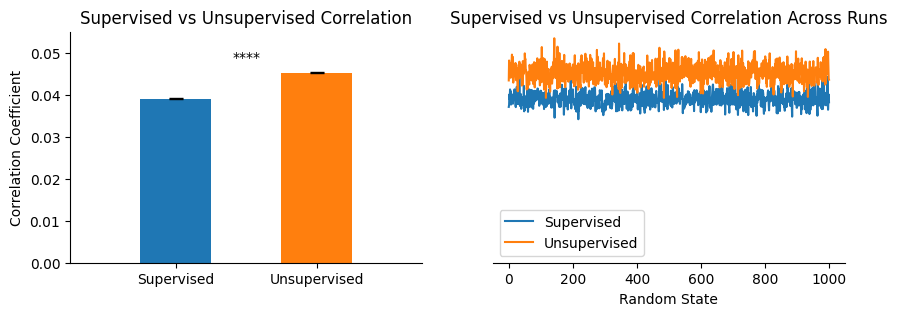

In [247]:
from scipy.stats import ttest_ind

sup_corr_mean = np.mean(sup_corr)
unsup_corr_mean = np.mean(unsup_corr)
sup_corr_sem = np.std(sup_corr) / np.sqrt(n_runs)
unsup_corr_sem = np.std(unsup_corr) / np.sqrt(n_runs)

t_stat, p_val = ttest_ind(sup_corr, unsup_corr)

def p_to_stars(p):
    return "****" if p < 1e-4 else "***" if p < 1e-3 else "**" if p < 1e-2 else "*" if p < 5e-2 else "ns"

plt.figure(figsize=(10, 3))
plt.subplot(1, 2, 1)
width = 0.5
plt.bar(['Supervised', 'Unsupervised'], [sup_corr_mean, unsup_corr_mean], yerr=[sup_corr_sem, unsup_corr_sem], 
        capsize=5, color=['tab:blue', 'tab:orange'], width=width)
margin = (1-width) + width/2
plt.xlim([-margin, 1 + margin])
plt.text(0.5, sup_corr_mean + sup_corr_sem + 0.008, p_to_stars(p_val), ha='center', va='bottom')
plt.ylabel('Correlation Coefficient')
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim([0,0.055])
plt.title('Supervised vs Unsupervised Correlation')

plt.subplot(1, 2, 2)
plt.plot(sup_corr)
plt.plot(unsup_corr)
plt.xlabel('Random State')
plt.title('Supervised vs Unsupervised Correlation Across Runs')
plt.gca().spines['left'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.yticks([])
plt.ylim([0,0.055])
plt.legend(['Supervised', 'Unsupervised'])
plt.show()

Text(0, 0.5, '1st Canonical Variate before Training')

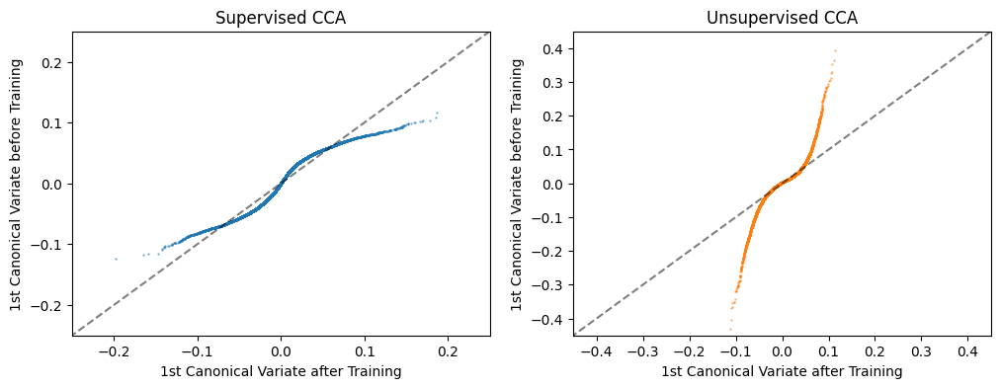

In [277]:
U1 = sorted(U1_mat.mean(axis=0))
V1 = sorted(V1_mat.mean(axis=0))
U2 = sorted(U2_mat.mean(axis=0))
V2 = sorted(V2_mat.mean(axis=0))

plt.figure(figsize=(12,4))
plt.subplot(1, 2, 1)
plt.plot(range(-1, 2), range(-1, 2), 'k--', label='y=x', alpha=0.5)
plt.scatter(U1, V1, label='Supervised', alpha=0.5, s=0.5, c='tab:blue')
plt.title('Supervised CCA')
plt.xlim([-0.25, 0.25])
plt.ylim([-0.25, 0.25])
plt.xlabel('1st Canonical Variate after Training')
plt.ylabel('1st Canonical Variate before Training')

plt.subplot(1, 2, 2)
plt.plot(range(-1, 2), range(-1, 2), 'k--', label='y=x', alpha=0.5)
plt.scatter(U2, V2, label='Unsupervised', alpha=0.5, s=0.5, c='tab:orange')
plt.title('Unsupervised CCA')
plt.xlim([-0.45, 0.45])
plt.ylim([-0.45, 0.45])
plt.xlabel('1st Canonical Variate after Training')
plt.ylabel('1st Canonical Variate before Training')

In [256]:
U1_mat.shape

(1000, 71069)

### Multi Animals

In [219]:
def matrix_align_sorted(aft1_neuron_pos, bef1_neuron_pos, random_state=None):
    rng = np.random.default_rng(random_state)
    # Sort 
    aft1_neuron_pos = aft1_neuron_pos[:, np.argsort(aft1_neuron_pos[0])]
    bef1_neuron_pos = bef1_neuron_pos[:, np.argsort(bef1_neuron_pos[0])]

    m = min(aft1_neuron_pos.shape[0], bef1_neuron_pos.shape[0])

    def rand_block(n_rows, block_len):
        if n_rows <= block_len:
            return slice(None)
        start = rng.integers(0, n_rows - block_len + 1)
        return slice(start, start + block_len)

    aft_slice = rand_block(aft1_neuron_pos.shape[0], m)
    bef_slice = rand_block(bef1_neuron_pos.shape[0], m)

    aft1_neuron_pos = aft1_neuron_pos[aft_slice]
    bef1_neuron_pos = bef1_neuron_pos[bef_slice]

    return aft1_neuron_pos, bef1_neuron_pos


def CCA_neuron_80pos(aft1_neuron_pos, bef1_neuron_pos):
    n_runs = 500
    corr = np.zeros(n_runs)
    U_mat = np.zeros((n_runs, min(aft1_neuron_pos.shape[1], bef1_neuron_pos.shape[1])))
    V_mat = np.zeros((n_runs, min(bef1_neuron_pos.shape[1], aft1_neuron_pos.shape[1])))
    for n in range(n_runs):
        print(f'Run {n+1}/{n_runs}')
        XT, YT = matrix_align_sorted(aft1_neuron_pos.T, bef1_neuron_pos.T, random_state=n)

        XT = zscore(XT)
        YT = zscore(YT)

        cca_a, cca_b = _ridge_cca_first_weights(XT, YT, n_components=1)

        U = XT @ cca_a
        V = YT @ cca_b

        U_mat[n] = U.reshape(1, -1)
        V_mat[n] = V.reshape(1, -1)

        corr[n] = np.corrcoef(U.ravel(), V.ravel())[0, 1]

    return U_mat, V_mat, corr

In [220]:
sup_U_mat_sorted, sup_V_mat_sorted, sup_corr_sorted = CCA_neuron_80pos(sup_aft1_neuron_pos, sup_bef1_neuron_pos)
sup1_U_mat_sorted, sup1_V_mat_sorted, sup1_corr_sorted = CCA_neuron_80pos(sup1_aft1_neuron_pos, sup1_bef1_neuron_pos)
sup2_U_mat_sorted, sup2_V_mat_sorted, sup2_corr_sorted = CCA_neuron_80pos(sup2_aft1_neuron_pos, sup2_bef1_neuron_pos)
sup3_U_mat_sorted, sup3_V_mat_sorted, sup3_corr_sorted = CCA_neuron_80pos(sup3_aft1_neuron_pos, sup3_bef1_neuron_pos)
unsup_U_mat_sorted, unsup_V_mat_sorted, unsup_corr_sorted = CCA_neuron_80pos(unsup_aft1_neuron_pos, unsup_bef1_neuron_pos)  
unsup1_U_mat_sorted, unsup1_V_mat_sorted, unsup1_corr_sorted = CCA_neuron_80pos(unsup1_aft1_neuron_pos, unsup1_bef1_neuron_pos)  
unsup2_U_mat_sorted, unsup2_V_mat_sorted, unsup2_corr_sorted = CCA_neuron_80pos(unsup2_aft1_neuron_pos, unsup2_bef1_neuron_pos)  
unsup3_U_mat_sorted, unsup3_V_mat_sorted, unsup3_corr_sorted = CCA_neuron_80pos(unsup3_aft1_neuron_pos, unsup3_bef1_neuron_pos)  
unsup4_U_mat_sorted, unsup4_V_mat_sorted, unsup4_corr_sorted = CCA_neuron_80pos(unsup4_aft1_neuron_pos, unsup4_bef1_neuron_pos)  
unsup5_U_mat_sorted, unsup5_V_mat_sorted, unsup5_corr_sorted = CCA_neuron_80pos(unsup5_aft1_neuron_pos, unsup5_bef1_neuron_pos)  
unsup6_U_mat_sorted, unsup6_V_mat_sorted, unsup6_corr_sorted = CCA_neuron_80pos(unsup6_aft1_neuron_pos, unsup6_bef1_neuron_pos)  

Run 1/500
Run 2/500
Run 3/500
Run 4/500
Run 5/500
Run 6/500
Run 7/500
Run 8/500
Run 9/500
Run 10/500
Run 11/500
Run 12/500
Run 13/500
Run 14/500
Run 15/500
Run 16/500
Run 17/500
Run 18/500
Run 19/500
Run 20/500
Run 21/500
Run 22/500
Run 23/500
Run 24/500
Run 25/500
Run 26/500
Run 27/500
Run 28/500
Run 29/500
Run 30/500
Run 31/500
Run 32/500
Run 33/500
Run 34/500
Run 35/500
Run 36/500
Run 37/500
Run 38/500
Run 39/500
Run 40/500
Run 41/500
Run 42/500
Run 43/500
Run 44/500
Run 45/500
Run 46/500
Run 47/500
Run 48/500
Run 49/500
Run 50/500
Run 51/500
Run 52/500
Run 53/500
Run 54/500
Run 55/500
Run 56/500
Run 57/500
Run 58/500
Run 59/500
Run 60/500
Run 61/500
Run 62/500
Run 63/500
Run 64/500
Run 65/500
Run 66/500
Run 67/500
Run 68/500
Run 69/500
Run 70/500
Run 71/500
Run 72/500
Run 73/500
Run 74/500
Run 75/500
Run 76/500
Run 77/500
Run 78/500
Run 79/500
Run 80/500
Run 81/500
Run 82/500
Run 83/500
Run 84/500
Run 85/500
Run 86/500
Run 87/500
Run 88/500
Run 89/500
Run 90/500
Run 91/500
Run 92/5

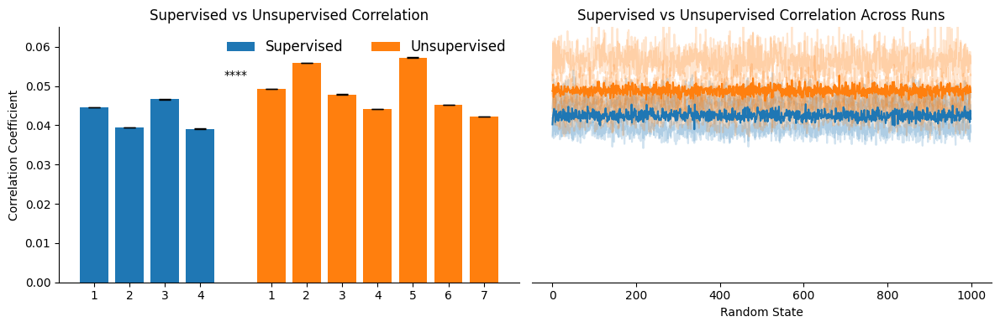

In [ ]:
from scipy.stats import ttest_ind

sup_corr_mat = np.array([sup_corr_sorted, sup1_corr_sorted, sup2_corr_sorted, sup3_corr_sorted])
unsup_corr_mat = np.array([unsup_corr_sorted, unsup1_corr_sorted, unsup2_corr_sorted, unsup3_corr_sorted, unsup4_corr_sorted, unsup5_corr_sorted, unsup6_corr_sorted])

sup_corr_mean = np.mean(sup_corr_mat, axis=1)
unsup_corr_mean = np.mean(unsup_corr_mat, axis=1)
sup_corr_sem = np.std(sup_corr_mat, axis=1) / np.sqrt(n_runs)
unsup_corr_sem = np.std(unsup_corr_mat, axis=1) / np.sqrt(n_runs)

_, p_val1 = ttest_ind(sup_corr_mat.ravel(), unsup_corr_mat.ravel(), equal_var=False)
_, p_val2 = ttest_ind(sup_corr_mat, unsup_corr_mat, equal_var=False)

def p_to_stars(p):
    return "****" if p < 1e-4 else "***" if p < 1e-3 else "**" if p < 1e-2 else "*" if p < 5e-2 else "ns"

plt.figure(figsize=(12, 4))
ax1 = plt.subplot(1, 2, 1)

n_sup = len(sup_corr_mean)
n_unsup = len(unsup_corr_mean)
gap = 1 
x_sup = np.arange(n_sup)
x_unsup = np.arange(n_unsup) + n_sup + gap

ax1.bar(x_sup, sup_corr_mean, yerr=sup_corr_sem, capsize=5, width=0.8, color='tab:blue', label='Supervised')
ax1.bar(x_unsup, unsup_corr_mean, yerr=unsup_corr_sem, capsize=5, width=0.8, color='tab:orange', label='Unsupervised')
ax1.set_xticks(np.concatenate([x_sup, x_unsup]))
ax1.set_xticklabels([f'{i+1}' for i in range(n_sup)] + [f'{i+1}' for i in range(n_unsup)], rotation=0)
ax1.set_ylabel('Correlation Coefficient')
ax1.set_ylim([0, 0.065])
ax1.set_title('Supervised vs Unsupervised Correlation')
ax1.spines['right'].set_visible(False)
ax1.spines['top'].set_visible(False)
ax1.legend(frameon=False, ncol=2, loc='upper right', fontsize=12)

y_max = max(np.max(sup_corr_mean + sup_corr_sem), np.max(unsup_corr_mean + unsup_corr_sem))
y_star = y_max + 0.004  # raise if you need more space
x1, x2 = x_sup[-1], x_unsup[0]
#ax1.plot([x1, x1, x2, x2], [y_star-0.001, y_star, y_star, y_star-0.001], lw=1, c='k')
ax1.text((x1 + x2) / 2, y_star - 0.01, p_to_stars(p_val1), ha='center', va='bottom')

ax2 = plt.subplot(1, 2, 2)
for i in range(sup_corr_mat.shape[0]):
    ax2.plot(sup_corr_mat[i], color='tab:blue', alpha=0.2)
for i in range(unsup_corr_mat.shape[0]):
    ax2.plot(unsup_corr_mat[i], color='tab:orange', alpha=0.2)
ax2.plot(sup_corr_mat.mean(axis=0), color='tab:blue', label='Supervised')
ax2.plot(unsup_corr_mat.mean(axis=0), color='tab:orange', label='Unsupervised')
ax2.set_xlabel('Random State')
ax2.set_title('Supervised vs Unsupervised Correlation Across Runs')
ax2.spines['left'].set_visible(False)
ax2.spines['right'].set_visible(False)
ax2.spines['top'].set_visible(False)
ax2.set_yticks([])
ax2.set_ylim([0, 0.065])

plt.tight_layout()
plt.show()

Text(0, 0.5, '1st Canonical Variate before Training')

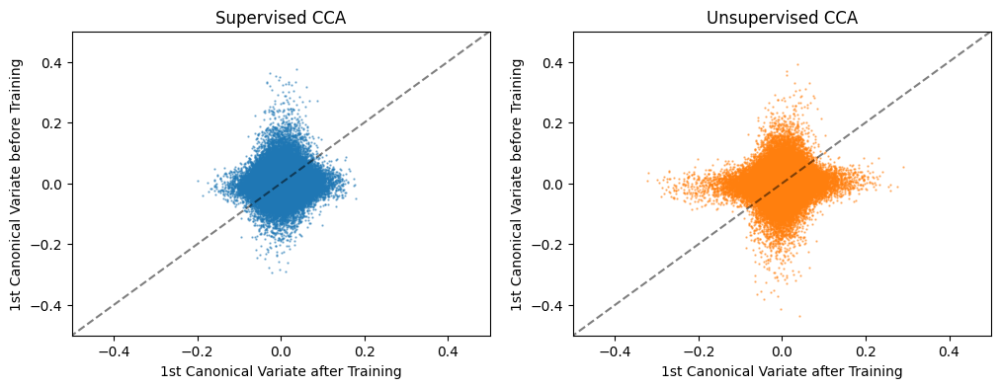

In [ ]:
U1_mat = np.concatenate([sup_U_mat_sorted, sup1_U_mat_sorted, sup2_U_mat_sorted, sup3_U_mat_sorted], axis=1)
U2_mat = np.concatenate([unsup_U_mat_sorted, unsup1_U_mat_sorted, unsup2_U_mat_sorted, unsup3_U_mat_sorted, unsup4_U_mat_sorted, unsup5_U_mat_sorted, unsup6_U_mat_sorted], axis=1)
V1_mat = np.concatenate([sup_V_mat_sorted, sup1_V_mat_sorted, sup2_V_mat_sorted, sup3_V_mat_sorted], axis=1)
V2_mat = np.concatenate([unsup_V_mat_sorted, unsup1_V_mat_sorted, unsup2_V_mat_sorted, unsup3_V_mat_sorted, unsup4_V_mat_sorted, unsup5_V_mat_sorted, unsup6_V_mat_sorted], axis=1)

'''
U1 = sorted(U1_mat.mean(axis=0))
V1 = sorted(V1_mat.mean(axis=0))
U2 = sorted(U2_mat.mean(axis=0))
V2 = sorted(V2_mat.mean(axis=0))
'''
U1 = U1_mat.mean(axis=0)
V1 = V1_mat.mean(axis=0)
U2 = U2_mat.mean(axis=0)
V2 = V2_mat.mean(axis=0)

plt.figure(figsize=(12,4))
plt.subplot(1, 2, 1)
plt.plot(range(-1, 2), range(-1, 2), 'k--', label='y=x', alpha=0.5)
plt.scatter(U1, V1, label='Supervised', alpha=0.5, s=0.5, c='tab:blue')
plt.title('Supervised CCA')
plt.xlim([-0.5, 0.5])
plt.ylim([-0.5, 0.5])
plt.xlabel('1st Canonical Variate after Training')
plt.ylabel('1st Canonical Variate before Training')

plt.subplot(1, 2, 2)
plt.plot(range(-1, 2), range(-1, 2), 'k--', label='y=x', alpha=0.5)
plt.scatter(U2, V2, label='Unsupervised', alpha=0.5, s=0.5, c='tab:orange')
plt.title('Unsupervised CCA')
plt.xlim([-0.5, 0.5])
plt.ylim([-0.5, 0.5])
plt.xlabel('1st Canonical Variate after Training')
plt.ylabel('1st Canonical Variate before Training')

### mat(80 pos * n_neuron)

In [783]:
def CCA_80pos_n_neuron(animal, aft1_neuron_pos, bef1_neuron_pos, test1_neuron_pos, n_components=80):
    # zscore
    aft1_neuron_pos = zscore(aft1_neuron_pos)
    bef1_neuron_pos = zscore(bef1_neuron_pos)
    test1_neuron_pos = zscore(test1_neuron_pos)
    #aft1_neuron_pos = aft1_neuron_pos - aft1_neuron_pos.mean(axis=1, keepdims=True)
    #bef1_neuron_pos = bef1_neuron_pos - bef1_neuron_pos.mean(axis=1, keepdims=True)
    #test1_neuron_pos = test1_neuron_pos - test1_neuron_pos.mean(axis=1, keepdims=True)\
    #aft1_svd = aft1_neuron_pos
    #bef1_svd = bef1_neuron_pos
    #test1_svd = test1_neuron_pos

    
    # svd
    svd_aft1 = TruncatedSVD(n_components=n_components, random_state=42).fit(aft1_neuron_pos)
    aft1_svd = svd_aft1.transform(aft1_neuron_pos)
    print(aft1_svd.shape)
    svd_bef1 = TruncatedSVD(n_components=n_components, random_state=42).fit(bef1_neuron_pos)
    bef1_svd = svd_bef1.transform(bef1_neuron_pos)
    svd_test1 = TruncatedSVD(n_components=n_components, random_state=42).fit(test1_neuron_pos)
    test1_svd = svd_test1.transform(test1_neuron_pos)

    '''
    # Variance explained by PC
    if nPC1==80:
        var_explained = svd_aft1.explained_variance_ratio_
        var_exp_accumulated = np.cumsum(var_explained)
        print(np.where(var_exp_accumulated >= 0.5)[0][0])
        plt.figure()
        plt.plot(var_exp_accumulated, linewidth=2)
        plt.xlabel('Principal Component')
        plt.ylabel('Cumulative Explained Variance')
        plt.title(f'{animal} After Training - CCA - {nPC1} PCs')
        plt.grid()
        plt.show()

        var_explained = svd_bef1.explained_variance_ratio_
        var_exp_accumulated = np.cumsum(var_explained)
        print(np.where(var_exp_accumulated >= 0.5)[0][0])
        plt.figure()
        plt.plot(var_exp_accumulated, linewidth=2)
        plt.xlabel('Principal Component')
        plt.ylabel('Cumulative Explained Variance')
        plt.title(f'{animal} Before Training - CCA - {nPC2} PCs')
        plt.grid()
        plt.show()

        var_explained = svd_test1.explained_variance_ratio_
        var_exp_accumulated = np.cumsum(var_explained)
        print(np.where(var_exp_accumulated >= 0.5)[0][0])
        plt.figure()
        plt.plot(var_exp_accumulated, linewidth=2)
        plt.xlabel('Principal Component')
        plt.ylabel('Cumulative Explained Variance')
        plt.title(f'{animal} Test - CCA - {nPC3} PCs')
        plt.grid()
        plt.show()
    '''

    # whiten
    '''
    aft1_svd = aft1_svd / np.sqrt(svd_aft1.explained_variance_ + 1e-12)
    bef1_svd = bef1_svd / np.sqrt(svd_bef1.explained_variance_ + 1e-12)
    test1_svd = test1_svd / np.sqrt(svd_test1.explained_variance_ + 1e-12)
    print(aft1_svd[:,0].mean(), aft1_svd[:,0].std())
    '''

    # cca
    cca_a1, cca_b1 = _ridge_cca_first_weights(aft1_svd, bef1_svd, lam=0.5, n_components=n_components)
    U1 = aft1_svd @ cca_a1
    V1 = bef1_svd @ cca_b1
    #corr = np.corrcoef(U.ravel(), V.ravel())[0, 1]
    corr1 = [np.corrcoef(U1[:, i], V1[:, i])[0, 1] for i in range(n_components)]
    cca_a2, cca_b2 = _ridge_cca_first_weights(test1_svd, aft1_svd, lam=0.5, n_components=n_components)
    U2 = test1_svd @ cca_a2
    V2 = aft1_svd @ cca_b2
    corr2 = [np.corrcoef(U2[:, i], V2[:, i])[0, 1] for i in range(n_components)]

    print(f'{animal} After Training CCA corr: R^2 {np.mean(np.power(corr1, 2)):.6f}, first corr {corr1[0]:.6f}')
    print(f'{animal} Test CCA corr: R^2 {np.mean(np.power(corr2, 2)):.6f}, first corr {corr2[0]:.6f}')

    return U1, V1, U2, V2, corr1, corr2

In [789]:
PC = 40
sup_aft1_neuron_pos_list = [
    sup_aft1_neuron_pos[40:, :PC],
    sup1_aft1_neuron_pos[40:, :PC],
    sup2_aft1_neuron_pos[40:, :PC],
    sup3_aft1_neuron_pos[40:, :PC]
]

sup_bef1_neuron_pos_list = [
    sup_bef1_neuron_pos[40:, :PC],
    sup1_bef1_neuron_pos[40:, :PC],
    sup2_bef1_neuron_pos[40:, :PC],
    sup3_bef1_neuron_pos[40:, :PC]
]

sup_test1_neuron_pos_list = [
    sup_test1_neuron_pos[40:, :PC],
    sup1_test1_neuron_pos[40:, :PC],
    sup2_test1_neuron_pos[40:, :PC],
    sup3_test1_neuron_pos[40:, :PC]
]

unsup_aft1_neuron_pos_list = [
    unsup_aft1_neuron_pos[40:, :PC],
    unsup1_aft1_neuron_pos[40:, :PC],
    unsup2_aft1_neuron_pos[40:, :PC],
    unsup3_aft1_neuron_pos[40:, :PC],
    unsup4_aft1_neuron_pos[40:, :PC],
    unsup5_aft1_neuron_pos[40:, :PC],
    unsup6_aft1_neuron_pos[40:, :PC]
]

unsup_bef1_neuron_pos_list = [
    unsup_bef1_neuron_pos[40:, :PC],
    unsup1_bef1_neuron_pos[40:, :PC],
    unsup2_bef1_neuron_pos[40:, :PC],
    unsup3_bef1_neuron_pos[40:, :PC],
    unsup4_bef1_neuron_pos[40:, :PC],
    unsup5_bef1_neuron_pos[40:, :PC],
    unsup6_bef1_neuron_pos[40:, :PC]
]

unsup_test1_neuron_pos_list = [
    unsup_test1_neuron_pos[40:, :PC],
    unsup1_test1_neuron_pos[40:, :PC],
    unsup2_test1_neuron_pos[40:, :PC],
    unsup3_test1_neuron_pos[40:, :PC],
    unsup4_test1_neuron_pos[40:, :PC],
    unsup5_test1_neuron_pos[40:, :PC],
    unsup6_test1_neuron_pos[40:, :PC]
]



sup_U1_mat = []
sup_V1_mat = []
sup_U2_mat = []
sup_V2_mat = []
sup_corr1_mat = []
sup_corr2_mat = []
unsup_U1_mat = []
unsup_V1_mat = []
unsup_U2_mat = []
unsup_V2_mat = []
unsup_corr1_mat = []
unsup_corr2_mat = []
sup_animals = ['TX109', 'TX108', 'TX60', 'VR2']
unsup_animals = ['TX83', 'TX119', 'TX88', 'TX105', 'TX123', 'DR15', 'DR10']

for i, animal in enumerate(sup_animals):
    U1, V1, U2, V2, corr1, corr2 = CCA_80pos_n_neuron(animal, sup_aft1_neuron_pos_list[i], sup_bef1_neuron_pos_list[i], sup_test1_neuron_pos_list[i], n_components=PC)
    sup_V1_mat.append(V1)
    sup_U2_mat.append(U2)
    sup_V2_mat.append(V2)
    sup_corr1_mat.append(corr1)
    sup_corr2_mat.append(corr2)
for i, animal in enumerate(unsup_animals):
    U1, V1, U2, V2, corr1, corr2 = CCA_80pos_n_neuron(animal, unsup_aft1_neuron_pos_list[i], unsup_bef1_neuron_pos_list[i], unsup_test1_neuron_pos_list[i], n_components=PC)
    unsup_U1_mat.append(U1)
    unsup_V1_mat.append(V1)
    unsup_U2_mat.append(U2)
    unsup_V2_mat.append(V2)
    unsup_corr1_mat.append(corr1)
    unsup_corr2_mat.append(corr2)

(40, 40)
TX109 After Training CCA corr: R^2 0.595732, first corr 0.997318
TX109 Test CCA corr: R^2 0.575193, first corr 0.998573
(40, 40)
TX108 After Training CCA corr: R^2 0.632348, first corr 0.995761
TX108 Test CCA corr: R^2 0.622750, first corr 0.997830
(40, 40)
TX60 After Training CCA corr: R^2 0.631238, first corr 0.997163
TX60 Test CCA corr: R^2 0.566435, first corr 0.995212
(40, 40)
VR2 After Training CCA corr: R^2 0.623369, first corr 0.997299
VR2 Test CCA corr: R^2 0.647846, first corr 0.997214
(40, 40)
TX83 After Training CCA corr: R^2 0.594913, first corr 0.997704
TX83 Test CCA corr: R^2 0.600013, first corr 0.995482
(40, 40)
TX119 After Training CCA corr: R^2 0.523140, first corr 0.998695
TX119 Test CCA corr: R^2 0.541098, first corr 0.998847
(40, 40)
TX88 After Training CCA corr: R^2 0.618556, first corr 0.997013
TX88 Test CCA corr: R^2 0.583783, first corr 0.997198
(40, 40)
TX105 After Training CCA corr: R^2 0.598019, first corr 0.997439
TX105 Test CCA corr: R^2 0.609740

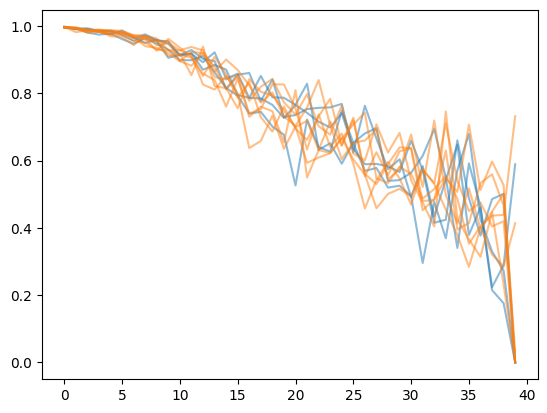

In [788]:
plt.figure()
for i in range(len(sup_animals)):
    plt.plot(sup_corr1_mat[i], color = 'tab:blue', alpha=0.5)
for i in range(len(unsup_animals)):
    plt.plot(unsup_corr1_mat[i], color = 'tab:orange', alpha=0.5)
plt.show()

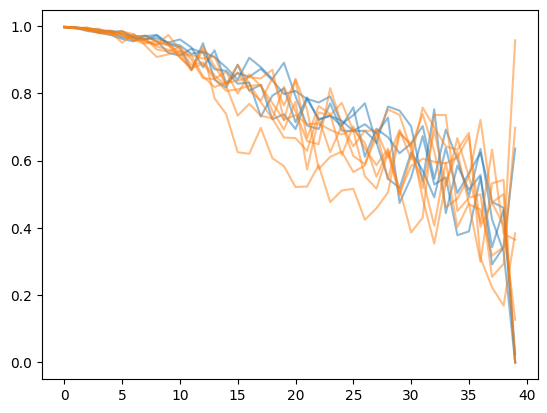

In [790]:
plt.figure()
for i in range(len(sup_animals)):
    plt.plot(sup_corr1_mat[i], color = 'tab:blue', alpha=0.5)
for i in range(len(unsup_animals)):
    plt.plot(unsup_corr1_mat[i], color = 'tab:orange', alpha=0.5)
plt.show()

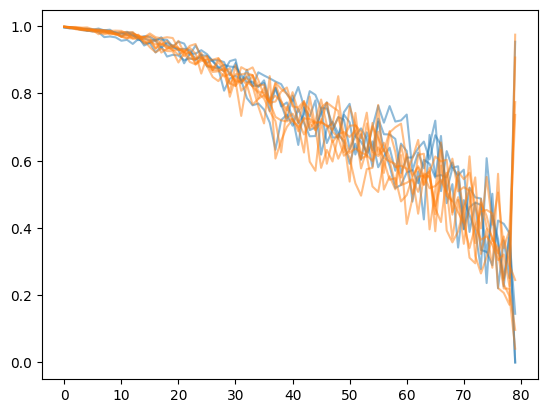

In [785]:
plt.figure()
for i in range(len(sup_animals)):
    plt.plot(sup_corr1_mat[i], color = 'tab:blue', alpha=0.5)
for i in range(len(unsup_animals)):
    plt.plot(unsup_corr1_mat[i], color = 'tab:orange', alpha=0.5)
plt.show()

In [506]:
component = 1
sup_cca_a, sup_cca_b = _ridge_cca_first_weights(sup_aft1_svd, sup_bef1_svd, n_components=2)
unsup_cca_a, unsup_cca_b = _ridge_cca_first_weights(unsup_aft1_svd, unsup_bef1_svd, n_components=2)


U1 = sup_aft1_svd @ sup_cca_a
U2 = unsup_aft1_svd @ unsup_cca_a
V1 = sup_bef1_svd @ sup_cca_b
V2 = unsup_bef1_svd @ unsup_cca_b

sup_corr = np.corrcoef(U1[:,1].ravel(), V1[:,1].ravel())[0, 1]
unsup_corr = np.corrcoef(U2[:,1].ravel(), V2[:,1].ravel())[0, 1]


print(f'Supervised CCA correlation: {sup_corr}')
print(f'Unsupervised CCA correlation: {unsup_corr}')

Supervised CCA correlation: 0.11399603156202068
Unsupervised CCA correlation: 0.8218431864520978


/tmp/ipykernel_1104/3307842448.py:6: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap40 = plt.cm.get_cmap('viridis', 40)


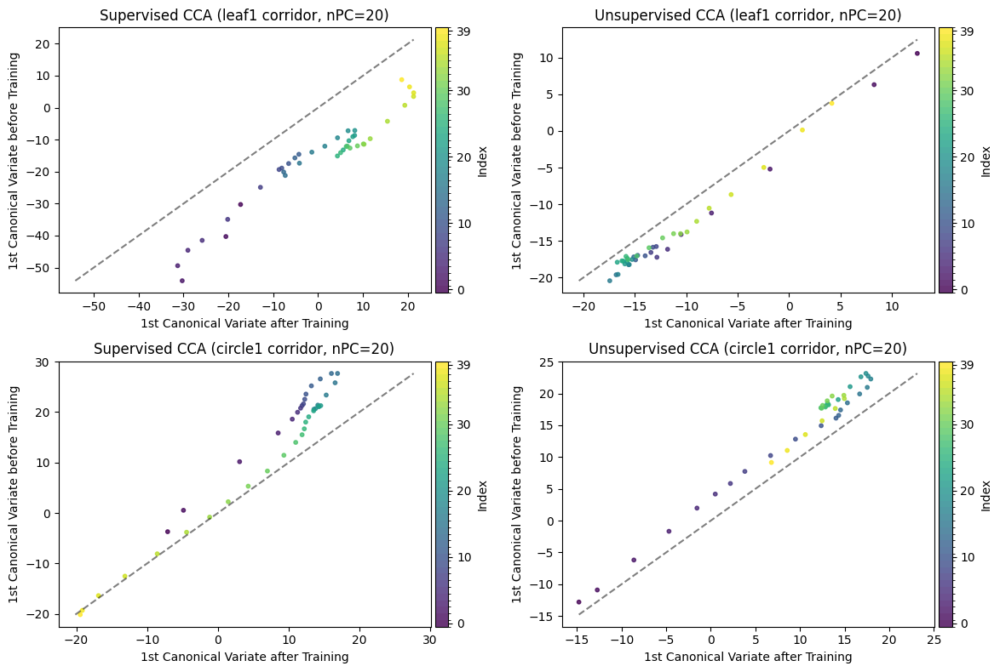

In [ ]:
import matplotlib as mpl

component = 0

# 80 discrete colors
cmap80 = plt.cm.get_cmap('PuOr', 80)
norm80 = mpl.colors.BoundaryNorm(np.arange(-0.5, 80.5, 1), cmap80.N)

idx = np.arange(80)

plt.figure(figsize=(12, 8))

plt.subplot(2, 2, 1)
xymin = np.nanmin([U1_leaf1[:, component].min(), V1_leaf1[:, component].min()])
xymax = np.nanmax([U1_leaf1[:, component].max(), V1_leaf1[:, component].max()])
xx = np.linspace(xymin, xymax, 100)
plt.plot(xx, xx, 'k--', alpha=0.5, label='y=x')

sc1 = plt.scatter(U1_leaf1[:, component], V1_leaf1[:, component], c=idx, cmap=cmap40, norm=norm40, alpha=0.8, s=10)
plt.title('Supervised CCA (leaf1 corridor, nPC=20)')
plt.xlabel('1st Canonical Variate after Training')
plt.ylabel('1st Canonical Variate before Training')
cb1 = plt.colorbar(sc1, pad=0.01)
cb1.set_label('Index')
cb1.set_ticks([0,10,20,30,len(U1_leaf1[:, component])-1])


plt.subplot(2, 2, 2)
xymin = np.nanmin([U2_leaf1[:, component].min(), V2_leaf1[:, component].min()])
xymax = np.nanmax([U2_leaf1[:, component].max(), V2_leaf1[:, component].max()])
xx = np.linspace(xymin, xymax, 100)
plt.plot(xx, xx, 'k--', alpha=0.5, label='y=x')

sc2 = plt.scatter(U2_leaf1[:, component], V2_leaf1[:, component], c=idx, cmap=cmap40, norm=norm40, alpha=0.8, s=10)
plt.title('Unsupervised CCA (leaf1 corridor, nPC=20)')
plt.xlabel('1st Canonical Variate after Training')
plt.ylabel('1st Canonical Variate before Training')
cb2 = plt.colorbar(sc2, pad=0.01)
cb2.set_label('Index')
cb2.set_ticks([0,10,20,30,len(U2_leaf1[:, component])-1])

plt.subplot(2, 2, 3)
xymin = np.nanmin([U1_circle1[:, component].min(), V1_circle1[:, component].min()])
xymax = np.nanmax([U1_circle1[:, component].max(), V1_circle1[:, component].max()])
xx = np.linspace(xymin, xymax, 100)
plt.plot(xx, xx, 'k--', alpha=0.5, label='y=x')

sc3 = plt.scatter(U1_circle1[:, component], V1_circle1[:, component], c=idx, cmap=cmap40, norm=norm40, alpha=0.8, s=10)
plt.title('Supervised CCA (circle1 corridor, nPC=20)')
plt.xlabel('1st Canonical Variate after Training')
plt.ylabel('1st Canonical Variate before Training')
cb3 = plt.colorbar(sc3, pad=0.01)
cb3.set_label('Index')
cb3.set_ticks([0,10,20,30,len(U1_circle1[:, component])-1])


plt.subplot(2, 2, 4)
xymin = np.nanmin([U2_circle1[:, component].min(), V2_circle1[:, component].min()])
xymax = np.nanmax([U2_circle1[:, component].max(), V2_circle1[:, component].max()])
xx = np.linspace(xymin, xymax, 100)
plt.plot(xx, xx, 'k--', alpha=0.5, label='y=x')

sc4 = plt.scatter(U2_circle1[:, component], V2_circle1[:, component], c=idx, cmap=cmap40, norm=norm40, alpha=0.8, s=10)
plt.title('Unsupervised CCA (circle1 corridor, nPC=20)')
plt.xlabel('1st Canonical Variate after Training')
plt.ylabel('1st Canonical Variate before Training')
cb4 = plt.colorbar(sc4, pad=0.01)
cb4.set_label('Index')
cb4.set_ticks([0,10,20,30,len(U2_circle1[:, component])-1])

plt.tight_layout()


/tmp/ipykernel_1104/58873326.py:4: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap40 = plt.cm.get_cmap('viridis', 40)


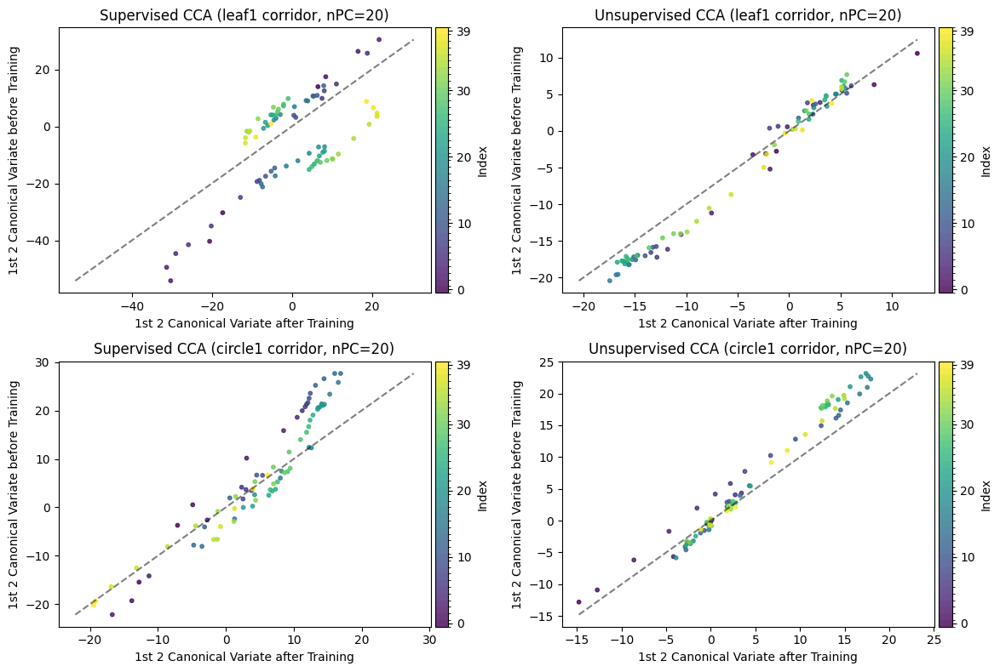

In [407]:
import matplotlib as mpl

# 40 discrete colors
cmap40 = plt.cm.get_cmap('viridis', 40)
norm40 = mpl.colors.BoundaryNorm(np.arange(-0.5, 40.5, 1), cmap40.N)

idx = np.arange(40)

plt.figure(figsize=(12, 8))

plt.subplot(2, 2, 1)
xymin = np.nanmin([U1_leaf1.min(), V1_leaf1.min()])
xymax = np.nanmax([U1_leaf1.max(), V1_leaf1.max()])
xx = np.linspace(xymin, xymax, 100)
plt.plot(xx, xx, 'k--', alpha=0.5, label='y=x')

sc1 = plt.scatter(U1_leaf1[:, 0], V1_leaf1[:, 0], c=idx, cmap=cmap40, norm=norm40, alpha=0.8, s=10)
sc11 = plt.scatter(U1_leaf1[:, 1], V1_leaf1[:, 1], c=idx, cmap=cmap40, norm=norm40, alpha=0.8, s=10)
plt.title('Supervised CCA (leaf1 corridor, nPC=20)')
plt.xlabel('1st 2 Canonical Variate after Training')
plt.ylabel('1st 2 Canonical Variate before Training')
cb1 = plt.colorbar(sc1, pad=0.01)
cb1.set_label('Index')
cb1.set_ticks([0,10,20,30,len(U1_leaf1[:, 0])-1])


plt.subplot(2, 2, 2)
xymin = np.nanmin([U2_leaf1.min(), V2_leaf1.min()])
xymax = np.nanmax([U2_leaf1.max(), V2_leaf1.max()])
xx = np.linspace(xymin, xymax, 100)
plt.plot(xx, xx, 'k--', alpha=0.5, label='y=x')

sc2 = plt.scatter(U2_leaf1[:, 0], V2_leaf1[:, 0], c=idx, cmap=cmap40, norm=norm40, alpha=0.8, s=10)
sc22 = plt.scatter(U2_leaf1[:, 1], V2_leaf1[:, 1], c=idx, cmap=cmap40, norm=norm40, alpha=0.8, s=10)
plt.title('Unsupervised CCA (leaf1 corridor, nPC=20)')
plt.xlabel('1st 2 Canonical Variate after Training')
plt.ylabel('1st 2 Canonical Variate before Training')
cb2 = plt.colorbar(sc2, pad=0.01)
cb2.set_label('Index')
cb2.set_ticks([0,10,20,30,len(U2_leaf1[:, 0])-1])

plt.subplot(2, 2, 3)
xymin = np.nanmin([U1_circle1.min(), V1_circle1.min()])
xymax = np.nanmax([U1_circle1.max(), V1_circle1.max()])
xx = np.linspace(xymin, xymax, 100)
plt.plot(xx, xx, 'k--', alpha=0.5, label='y=x')

sc3 = plt.scatter(U1_circle1[:, 0], V1_circle1[:, 0], c=idx, cmap=cmap40, norm=norm40, alpha=0.8, s=10)
sc33 = plt.scatter(U1_circle1[:, 1], V1_circle1[:, 1], c=idx, cmap=cmap40, norm=norm40, alpha=0.8, s=10)
plt.title('Supervised CCA (circle1 corridor, nPC=20)')
plt.xlabel('1st 2 Canonical Variate after Training')
plt.ylabel('1st 2 Canonical Variate before Training')
cb3 = plt.colorbar(sc3, pad=0.01)
cb3.set_label('Index')
cb3.set_ticks([0,10,20,30,len(U1_circle1[:, 0])-1])


plt.subplot(2, 2, 4)
xymin = np.nanmin([U2_circle1.min(), V2_circle1.min()])
xymax = np.nanmax([U2_circle1.max(), V2_circle1.max()])
xx = np.linspace(xymin, xymax, 100)
plt.plot(xx, xx, 'k--', alpha=0.5, label='y=x')

sc4 = plt.scatter(U2_circle1[:, 0], V2_circle1[:, 0], c=idx, cmap=cmap40, norm=norm40, alpha=0.8, s=10)
sc44 = plt.scatter(U2_circle1[:, 1], V2_circle1[:, 1], c=idx, cmap=cmap40, norm=norm40, alpha=0.8, s=10)
plt.title('Unsupervised CCA (circle1 corridor, nPC=20)')
plt.xlabel('1st 2 Canonical Variate after Training')
plt.ylabel('1st 2 Canonical Variate before Training')
cb4 = plt.colorbar(sc4, pad=0.01)
cb4.set_label('Index')
cb4.set_ticks([0,10,20,30,len(U2_circle1[:, 0])-1])

plt.tight_layout()


## Changes in Before Session

In [14]:
# A version to get early and late trials
from scipy.interpolate import interp1d

def tuning_curves_half_session(sn, VRpos, corridor_starts, corridor_ends, beh, num_stimuli=2):
    corr_tot = np.zeros(num_stimuli)
    npts=60
    n_sn = sn.shape[0]
    corridor_tuning_early = np.zeros((num_stimuli, n_sn, npts), np.float32)
    corridor_tuning_late = np.zeros((num_stimuli, n_sn, npts), np.float32)
    tcorridor = np.zeros(len(VRpos), "bool")
    half_session = len(corridor_starts) // 3
    for n in range(half_session):
        start = int(np.round(corridor_starts[n]))
        end = int(np.round(corridor_ends[n])) #int(np.ceil(whiteSpcFrameInd[n]))
        corr_fr = int(corridor_starts[n]+3) # remove potential boundary effects
        corr_type = beh['ft_WallID'][corr_fr]
        if corr_type == 'rock1' or corr_type == 'circle1':
            icorr = 1
        elif corr_type == 'rock2' or corr_type == 'circle2':
            icorr = 3
        elif corr_type == 'wood1' or corr_type == 'leaf1':
            icorr = 0
        elif corr_type == 'wood2' or corr_type == 'leaf2':
            icorr = 2
        else:  
            continue  # skip if corridor type is not recognized
        valid_mask = (VRpos[start:end] !=0)
        pos_filtered = VRpos[start:end][valid_mask]
        sn_filtered = sn[:, start:end][:,valid_mask]

        if len(pos_filtered) == 0:
            continue  # Skip this corridor if no valid position data

        f = interp1d(pos_filtered, sn_filtered, 
                    bounds_error=False, 
                    fill_value=(sn[:,start], sn[:,end]))
        corridor_tuning_early[icorr,:,:] += f(np.linspace(0, 1, npts))
        tcorridor[start:end] = icorr
        corr_tot[icorr] += 1
    corridor_tuning_early /= corr_tot[:,np.newaxis,np.newaxis]

    for n in range(len(corridor_starts)-1-half_session, len(corridor_starts)-1):
        start = int(np.round(corridor_starts[n]))
        end = int(np.round(corridor_ends[n])) #int(np.ceil(whiteSpcFrameInd[n]))
        corr_fr = int(corridor_starts[n]+3) # remove potential boundary effects
        corr_type = beh['ft_WallID'][corr_fr]
        if corr_type == 'rock1' or corr_type == 'circle1':
            icorr = 1
        elif corr_type == 'rock2' or corr_type == 'circle2':
            icorr = 3
        elif corr_type == 'wood1' or corr_type == 'leaf1':
            icorr = 0
        elif corr_type == 'wood2' or corr_type == 'leaf2':
            icorr = 2
        else:  
            continue  # skip if corridor type is not recognized
        valid_mask = (VRpos[start:end] !=0)
        pos_filtered = VRpos[start:end][valid_mask]
        sn_filtered = sn[:, start:end][:,valid_mask]

        if len(pos_filtered) == 0:
            continue  # Skip this corridor if no valid position data

        f = interp1d(pos_filtered, sn_filtered, 
                    bounds_error=False, 
                    fill_value=(sn[:,start], sn[:,end]))
        corridor_tuning_late[icorr,:,:] += f(np.linspace(0, 1, npts))
        tcorridor[start:end] = icorr
        corr_tot[icorr] += 1
    corridor_tuning_late /= corr_tot[:,np.newaxis,np.newaxis]
    
    return corridor_tuning_early, corridor_tuning_late

In [15]:
# a version get early and late trials having the same num of trials for different stimulis
from scipy.interpolate import interp1d

def tuning_curves_by_index(sn, VRpos, corridor_starts, corridor_ends, beh):
    npts=60
    stim_dict = beh['StimTrial']
    stim_names = list(stim_dict.keys())
    if len(stim_names) == 4:
        stim_names = [stim_names[2], stim_names[0], stim_names[3], stim_names[1]]
    else: 
        stim_names = [stim_names[1], stim_names[0]]
    nstim = len(stim_names)
    nneur = sn.shape[0]

    tc_early = np.zeros((nstim, nneur, npts), np.float32)
    tc_late  = np.zeros((nstim, nneur, npts), np.float32)
    cnt_e = np.zeros(nstim, dtype=int)
    cnt_l = np.zeros(nstim, dtype=int)

    x_eval = np.linspace(0, 1, npts)

    for i_stim, name in enumerate(stim_names):
        mask = np.asarray(stim_dict[name], dtype=bool)
        trial_idx = np.flatnonzero(mask)  # indices where this stimulus occurs, in order
        if trial_idx.size == 0:
            continue

        # Early
        e_s, e_e = (0, 20)
        e_s = max(1, e_s)
        e_e = max(e_s, e_e)
        early_sel = trial_idx[e_s-1 : min(e_e, trial_idx.size)-1]

        # Late
        l_s_end, l_e_end = (21, 1)
        lo = -max(l_s_end, 1)
        hi = -max(l_e_end, 0) if l_e_end > 0 else None
        late_sel = trial_idx[lo:hi]

        # accumulate for selected trials
        for n in early_sel:
            #print('early trials:', n)
            start = int(np.round(corridor_starts[n]))
            end = int(np.round(corridor_ends[n]))
            if end <= start: 
                continue
            valid = (VRpos[start:end] != 0)
            if not np.any(valid):
                continue
            pos = VRpos[start:end][valid]
            sig = sn[:, start:end][:, valid]
            f = interp1d(pos, sig, bounds_error=False,
                         fill_value=(sn[:, start], sn[:, end]))
            tc_early[i_stim] += f(x_eval)
            cnt_e[i_stim] += 1

        for n in late_sel:
            #print('late trials:', n)
            start = int(np.round(corridor_starts[n]))
            end = int(np.round(corridor_ends[n]))
            if end <= start:
                continue
            valid = (VRpos[start:end] != 0)
            if not np.any(valid):
                continue
            pos = VRpos[start:end][valid]
            sig = sn[:, start:end][:, valid]
            f = interp1d(pos, sig, bounds_error=False,
                         fill_value=(sn[:, start], sn[:, end]))
            tc_late[i_stim] += f(x_eval)
            cnt_l[i_stim] += 1

    # normalize
    for i in range(nstim):
        if cnt_e[i] > 0:
            tc_early[i] /= float(cnt_e[i])
        if cnt_l[i] > 0:
            tc_late[i] /= float(cnt_l[i])

    return tc_early, tc_late


In [4]:
from scipy.interpolate import interp1d

# A version to get n blocks of trials and also cumulative averages
def tuning_curves_nblocks(sn, VRpos, corridor_starts, corridor_ends, beh, n_blocks=30):
    npts = 60
    stim_dict = beh['StimTrial']
    stim_names = list(stim_dict.keys())
    if len(stim_names) == 4:
        stim_names = [stim_names[2], stim_names[0], stim_names[3], stim_names[1]]
    else:
        stim_names = [stim_names[1], stim_names[0]]

    nneur = sn.shape[0]
    T = sn.shape[1]
    N = len(corridor_starts)
    assert len(corridor_ends) == N, "starts/ends length mismatch"
    x_eval = np.linspace(0, 1, npts)

    # Block edges (contiguous, near-equal size)
    edges = np.floor(np.linspace(0, N, n_blocks + 1)).astype(int)
    edges[-1] = N

    block_mean = {name: np.full((n_blocks, nneur, npts), np.nan, dtype=np.float32)
                  for name in stim_names}
    cum_mean = {name: np.full((n_blocks, nneur, npts), np.nan, dtype=np.float32)
                  for name in stim_names}

    run_sum = {name: np.zeros((nneur, npts), np.float32) for name in stim_names}
    run_count = {name: 0 for name in stim_names}

    for b in range(n_blocks):
        s, e = edges[b], edges[b + 1]
        if s >= e:
            # Even if empty, carry forward cumulative mean if any
            for name in stim_names:
                if run_count[name] > 0:
                    cum_mean[name][b] = run_sum[name] / float(run_count[name])
            continue

        for name in stim_names:
            mask = np.asarray(stim_dict[name], dtype=bool)
            block_trials = np.nonzero(mask[s:e])[0] + s  # global trial indices

            acc = np.zeros((nneur, npts), np.float32)
            cnt = 0

            for n in block_trials:
                start = int(np.round(corridor_starts[n]))
                end = int(np.round(corridor_ends[n]))
                # Clip and ensure at least 2 samples
                start = max(0, min(start, T - 2))
                end = max(start + 1, min(end, T - 1))

                valid = (VRpos[start:end] != 0)
                if not np.any(valid):
                    continue

                pos = VRpos[start:end][valid]
                sig = sn[:, start:end][:, valid]   # (nneur, n_valid)
                f = interp1d(pos, sig, bounds_error=False,
                             fill_value=(sn[:, start], sn[:, end]))
                acc += f(x_eval)
                cnt += 1

            if cnt > 0:
                block_mean[name][b] = acc / float(cnt)
                run_sum[name] += acc
                run_count[name] += cnt

            if run_count[name] > 0:
                cum_mean[name][b] = run_sum[name] / float(run_count[name])

    return block_mean, cum_mean


In [1067]:
test_animal = 'VR2_2021_03_20_1'
test_beh = np.load(os.path.join(root, 'beh', 'Beh_sup_train1_before_learning.npy'), allow_pickle=1).item()[test_animal]
test_spks, _, _, _, _, _ = prepare_data(test_animal)
test_ct = tuning_curves_nblocks(test_spks, test_beh['ft_Pos'] / 60, test_beh['StartFr'], test_beh['EndFr'], test_beh)
del test_spks, test_beh
test_ct.keys(), test_ct['leaf1'].shape
#(test_beh['isRew'] != test_beh['StimTrial']['leaf1']).sum()

Loaded VR2_2021_03_20_1 spks with shape (81473, 24298)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


leaf1: block 0, trial 0
leaf1: block 0, trial 1
leaf1: block 0, trial 3
leaf1: block 0, trial 6
leaf1: block 0, trial 9
leaf1: block 0, trial 10
circle1: block 0, trial 2
circle1: block 0, trial 4
circle1: block 0, trial 5
circle1: block 0, trial 7
circle1: block 0, trial 8
leaf1: block 1, trial 12
leaf1: block 1, trial 15
leaf1: block 1, trial 16
leaf1: block 1, trial 17
leaf1: block 1, trial 19
leaf1: block 1, trial 21
leaf1: block 1, trial 22
circle1: block 1, trial 11
circle1: block 1, trial 13
circle1: block 1, trial 14
circle1: block 1, trial 18
circle1: block 1, trial 20
leaf1: block 2, trial 23
leaf1: block 2, trial 25
leaf1: block 2, trial 29
leaf1: block 2, trial 30
leaf1: block 2, trial 32
circle1: block 2, trial 24
circle1: block 2, trial 26
circle1: block 2, trial 27
circle1: block 2, trial 28
circle1: block 2, trial 31
circle1: block 2, trial 33
leaf1: block 3, trial 38
leaf1: block 3, trial 39
leaf1: block 3, trial 40
leaf1: block 3, trial 41
leaf1: block 3, trial 43
cir

/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


leaf1: block 9, trial 115
circle1: block 9, trial 106
circle1: block 9, trial 107
circle1: block 9, trial 109
circle1: block 9, trial 111
circle1: block 9, trial 112
circle1: block 9, trial 113
leaf1: block 10, trial 119
leaf1: block 10, trial 121
leaf1: block 10, trial 122
leaf1: block 10, trial 124
leaf1: block 10, trial 125
circle1: block 10, trial 116
circle1: block 10, trial 117
circle1: block 10, trial 118
circle1: block 10, trial 120
circle1: block 10, trial 123
circle1: block 10, trial 126
leaf1: block 11, trial 127
leaf1: block 11, trial 128
leaf1: block 11, trial 129
leaf1: block 11, trial 131
leaf1: block 11, trial 132
leaf1: block 11, trial 133
leaf1: block 11, trial 134
leaf1: block 11, trial 136
circle1: block 11, trial 130
circle1: block 11, trial 135
circle1: block 11, trial 137
circle1: block 11, trial 138
leaf1: block 12, trial 139
leaf1: block 12, trial 141
leaf1: block 12, trial 143
leaf1: block 12, trial 147
circle1: block 12, trial 140
circle1: block 12, trial 142

(dict_keys(['leaf1', 'circle1']), (30, 81473, 60))

In [9]:
def neu_area_ID(iarea):
    area_name = ['V1', 'mHV', 'lHV', 'aHV']
    idx = {}
    for ar in area_name:
        if ar=='V1':
            idx[ar] = iarea==8
        elif ar=='mHV':
            idx[ar] = (iarea==0) | (iarea==1) | (iarea==2) | (iarea==9)
        elif ar=='lHV':
            idx[ar] = (iarea==5) | (iarea==6)
        elif ar=='aHV':
            idx[ar] = (iarea==3) | (iarea==4)
    return idx

In [17]:
def visualize_6corr_matrix(cm_aft1, cm_aft2, cm_bef1, cm_bef2, cm_test1, cm_test2,
                           title1, title2, title3, title4, title5, title6, vmin=None, vmax=None):

    print(cm_aft1.shape, cm_bef1.shape)

    # color scale from finite values
    if vmin is None or vmax is None:
        all_vals = np.concatenate([cm_aft1[np.isfinite(cm_aft1)], cm_bef1[np.isfinite(cm_bef1)], cm_test1[np.isfinite(cm_test1)], cm_aft2[np.isfinite(cm_aft2)], cm_bef2[np.isfinite(cm_bef2)], cm_test2[np.isfinite(cm_test2)]]) \
                   if np.isfinite(cm_aft1).any() and np.isfinite(cm_bef1).any() and np.isfinite(cm_test1).any() and np.isfinite(cm_aft2).any() and np.isfinite(cm_bef2).any() and np.isfinite(cm_test2).any() else np.array([0.0])
        vmin, vmax = np.percentile(all_vals, [2, 98]) if all_vals.size > 1 else (-1.0, 1.0)

    fig, ax = plt.subplots(2, 3, figsize=(12, 8))
    fig.suptitle('All Neurons Per Pos Bin Activity Correlation Matrix', fontsize=12)

    im0 = ax[0, 0].imshow(cm_bef1, cmap='RdBu_r', vmin=vmin, vmax=vmax)
    ax[0, 0].set_title(title3)
    ax[0, 0].set_xlabel('Leaf1 Positions      Circle1 Positions')
    ax[0, 0].set_ylabel('Leaf1 Positions      Circle1 Positions')
    ax[0, 0].invert_yaxis()
    ax[0, 0].grid(False)

    im1 = ax[0, 1].imshow(cm_aft1, cmap='RdBu_r', vmin=vmin, vmax=vmax)
    ax[0, 1].set_title(title1)
    ax[0, 1].set_xlabel('Leaf1 Positions      Circle1 Positions')
    ax[0, 1].set_ylabel('Leaf1 Positions      Circle1 Positions')
    ax[0, 1].invert_yaxis()
    ax[0, 1].grid(False)

    im2 = ax[0, 2].imshow(cm_test1, cmap='RdBu_r', vmin=vmin, vmax=vmax)
    ax[0, 2].set_title(title5)
    ax[0, 2].set_xlabel('Leaf1 Positions      Circle1 Positions')
    ax[0, 2].set_ylabel('Leaf1 Positions      Circle1 Positions')
    ax[0, 2].invert_yaxis()
    ax[0, 2].grid(False)

    im3 = ax[1, 0].imshow(cm_bef2, cmap='RdBu_r', vmin=vmin, vmax=vmax)
    ax[1, 0].set_title(title4)
    ax[1, 0].set_xlabel('Leaf2 Positions      Circle2 Positions')
    ax[1, 0].set_ylabel('Leaf2 Positions      Circle2 Positions')
    ax[1, 0].invert_yaxis()
    ax[1, 0].grid(False)

    im4 = ax[1, 1].imshow(cm_test2, cmap='RdBu_r', vmin=vmin, vmax=vmax)
    ax[1, 1].set_title(title2)
    ax[1, 1].set_xlabel('Leaf2 Positions      Circle2 Positions')
    ax[1, 1].set_ylabel('Leaf2 Positions      Circle2 Positions')
    ax[1, 1].invert_yaxis()
    ax[1, 1].grid(False)

    im5 = ax[1, 2].imshow(cm_aft2, cmap='RdBu_r', vmin=vmin, vmax=vmax)
    ax[1, 2].set_title(title6)
    ax[1, 2].set_xlabel('Leaf2 Positions      Circle2 Positions')
    ax[1, 2].set_ylabel('Leaf2 Positions      Circle2 Positions')
    ax[1, 2].invert_yaxis()
    ax[1, 2].grid(False)

    # single colorbar for all subplots
    cax = fig.add_axes([1.0, 0.15, 0.02, 0.6])  # left, bottom, width, height
    fig.colorbar(im0, cax=cax, orientation='vertical')
    plt.tight_layout()
    plt.show()

'''
visualize_6corr_matrix(sup_aft1_avg_mat, sup_aft2_avg_mat, 
                       sup_bef1_avg_mat, sup_bef2_avg_mat, 
                       sup_test1_avg_mat, sup_test2_avg_mat,  
                        'Supervised Aft Early', 'Supervised Aft Late', 'Supervised Bef Early', 'Supervised Bef Late', 'Supervised Test Early', 'Supervised Test Late'
                        , vmin=-0.8, vmax=0.8
                        )
visualize_6corr_matrix(unsup_aft1_avg_mat, unsup_aft2_avg_mat, 
                        unsup_bef1_avg_mat, unsup_bef2_avg_mat, 
                        unsup_test1_avg_mat, unsup_test2_avg_mat,  
                        'Unsupervised Aft Early', 'Unsupervised Aft Late', 'Unsupervised Bef Early', 'Unsupervised Bef Late', 'Unsupervised Test Early', 'Unsupervised Test Late'
                        , vmin=-0.8, vmax=0.8
                        )
'''

"\nvisualize_6corr_matrix(sup_aft1_avg_mat, sup_aft2_avg_mat, \n                       sup_bef1_avg_mat, sup_bef2_avg_mat, \n                       sup_test1_avg_mat, sup_test2_avg_mat,  \n                        'Supervised Aft Early', 'Supervised Aft Late', 'Supervised Bef Early', 'Supervised Bef Late', 'Supervised Test Early', 'Supervised Test Late'\n                        , vmin=-0.8, vmax=0.8\n                        )\nvisualize_6corr_matrix(unsup_aft1_avg_mat, unsup_aft2_avg_mat, \n                        unsup_bef1_avg_mat, unsup_bef2_avg_mat, \n                        unsup_test1_avg_mat, unsup_test2_avg_mat,  \n                        'Unsupervised Aft Early', 'Unsupervised Aft Late', 'Unsupervised Bef Early', 'Unsupervised Bef Late', 'Unsupervised Test Early', 'Unsupervised Test Late'\n                        , vmin=-0.8, vmax=0.8\n                        )\n"

In [18]:
def rdm_analysis_per_region_half_session(aft_neuron_pos_early, bef_neuron_pos_early, test_neuron_pos_early,
                                         aft_neuron_pos_late, bef_neuron_pos_late, test_neuron_pos_late, 
                            aft_iarea_list, bef_iarea_list, test_iarea_list, animal_list, animal_type='Supervised'):

    aft1_mat = []
    bef1_mat = []
    test1_mat = []
    aft1_mat_regions = {}
    bef1_mat_regions = {}
    test1_mat_regions = {}
    aft2_mat = []
    bef2_mat = []
    test2_mat = []
    aft2_mat_regions = {}
    bef2_mat_regions = {}
    test2_mat_regions = {}
    for i, animal in enumerate(animal_list):
        aft1_neuron_pos = aft_neuron_pos_early[i]
        bef1_neuron_pos = bef_neuron_pos_early[i]
        test1_neuron_pos = test_neuron_pos_early[i]
        aft2_neuron_pos = aft_neuron_pos_late[i]
        bef2_neuron_pos = bef_neuron_pos_late[i]
        test2_neuron_pos = test_neuron_pos_late[i]

        aft1_area_idx = neu_area_ID(aft_iarea_list[i])
        bef1_area_idx = neu_area_ID(bef_iarea_list[i])
        test1_area_idx = neu_area_ID(test_iarea_list[i])
        aft2_area_idx = neu_area_ID(aft_iarea_list[i])
        bef2_area_idx = neu_area_ID(bef_iarea_list[i])
        test2_area_idx = neu_area_ID(test_iarea_list[i])

        #aft1_neuron_pos = zscore(aft1_neuron_pos)
        #bef1_neuron_pos = zscore(bef1_neuron_pos)
        #test1_neuron_pos = zscore(test1_neuron_pos)
        #print(aft1_neuron_pos[:,0].mean())
            
        #aft_matrix = np.corrcoef(aft1_neuron_pos)
        #bef_matrix = np.corrcoef(bef1_neuron_pos)
        #test_matrix = np.corrcoef(test1_neuron_pos)
        def row_corr_matrix(X):
            # X: (n_samples, n_features)
            Xc = X - X.mean(axis=1, keepdims=True)         # center rows
            Xn = Xc / np.linalg.norm(Xc, axis=1, keepdims=True)  # normalize rows
            return Xn @ Xn.T                               # Pearson r between rows

        aft1_mat.append(row_corr_matrix(aft1_neuron_pos))
        bef1_mat.append(row_corr_matrix(bef1_neuron_pos))
        test1_mat.append(row_corr_matrix(test1_neuron_pos))
        aft2_mat.append(row_corr_matrix(aft2_neuron_pos))
        bef2_mat.append(row_corr_matrix(bef2_neuron_pos))
        test2_mat.append(row_corr_matrix(test2_neuron_pos))
        for j, jar in enumerate(['V1', 'mHV', 'lHV', 'aHV']):
            aft1_mat_regions[jar] = aft1_mat_regions.get(jar, []) + [row_corr_matrix(aft1_neuron_pos[:,aft1_area_idx[jar]])]
            bef1_mat_regions[jar] = bef1_mat_regions.get(jar, []) + [row_corr_matrix(bef1_neuron_pos[:,bef1_area_idx[jar]])]
            test1_mat_regions[jar] = test1_mat_regions.get(jar, []) + [row_corr_matrix(test1_neuron_pos[:,test1_area_idx[jar]])]
            aft2_mat_regions[jar] = aft2_mat_regions.get(jar, []) + [row_corr_matrix(aft2_neuron_pos[:,aft2_area_idx[jar]])]
            bef2_mat_regions[jar] = bef2_mat_regions.get(jar, []) + [row_corr_matrix(bef2_neuron_pos[:,bef2_area_idx[jar]])]
            test2_mat_regions[jar] = test2_mat_regions.get(jar, []) + [row_corr_matrix(test2_neuron_pos[:,test2_area_idx[jar]])]

    aft1_mat = np.mean(aft1_mat, axis=0)
    bef1_mat = np.mean(bef1_mat, axis=0)
    test1_mat = np.mean(test1_mat, axis=0)
    aft2_mat = np.mean(aft2_mat, axis=0)
    bef2_mat = np.mean(bef2_mat, axis=0)
    test2_mat = np.mean(test2_mat, axis=0)
    # correlation here (optional: cosine similarity, euclidean distance)
    visualize_6corr_matrix(aft1_mat, aft2_mat, bef1_mat, bef2_mat, test1_mat, test2_mat,
                        f'{animal_type} Aft Early', f'{animal_type} Aft Late', f'{animal_type} Bef Early', f'{animal_type} Bef Late', f'{animal_type} Test Early', f'{animal_type} Test Late',
                        vmin=-0.8, vmax=0.8
                        )
    
    for jar in ['V1', 'mHV', 'lHV', 'aHV']:
        aft1_mat_regions[jar] = np.mean(aft1_mat_regions[jar], axis=0)
        bef1_mat_regions[jar] = np.mean(bef1_mat_regions[jar], axis=0)
        test1_mat_regions[jar] = np.mean(test1_mat_regions[jar], axis=0)
        aft2_mat_regions[jar] = np.mean(aft2_mat_regions[jar], axis=0)
        bef2_mat_regions[jar] = np.mean(bef2_mat_regions[jar], axis=0)
        test2_mat_regions[jar] = np.mean(test2_mat_regions[jar], axis=0)

        visualize_6corr_matrix(aft1_mat_regions[jar], aft2_mat_regions[jar],
                            bef1_mat_regions[jar], bef2_mat_regions[jar],
                            test1_mat_regions[jar], test2_mat_regions[jar],
                            f'{animal_type} {jar} Aft Early', f'{animal_type} {jar} Aft Late', f'{animal_type} {jar} Bef Early', f'{animal_type} {jar} Bef Late', f'{animal_type} {jar} Test Early', f'{animal_type} {jar} Test Late',
                            vmin=-0.8, vmax=0.8
        )

(80, 80) (80, 80)


/tmp/ipykernel_1030/3141678808.py:60: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


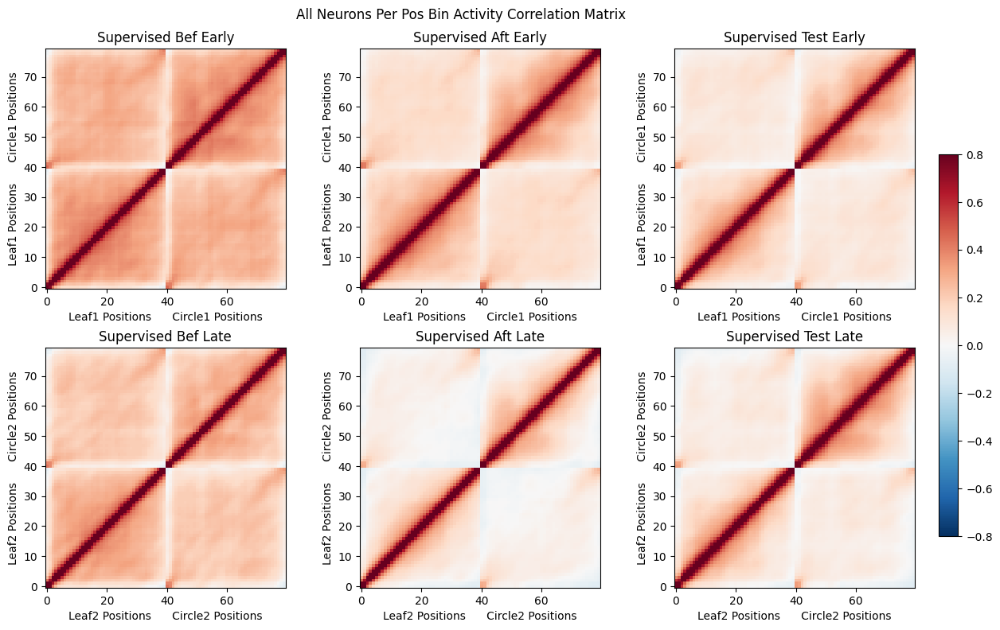

(80, 80) (80, 80)


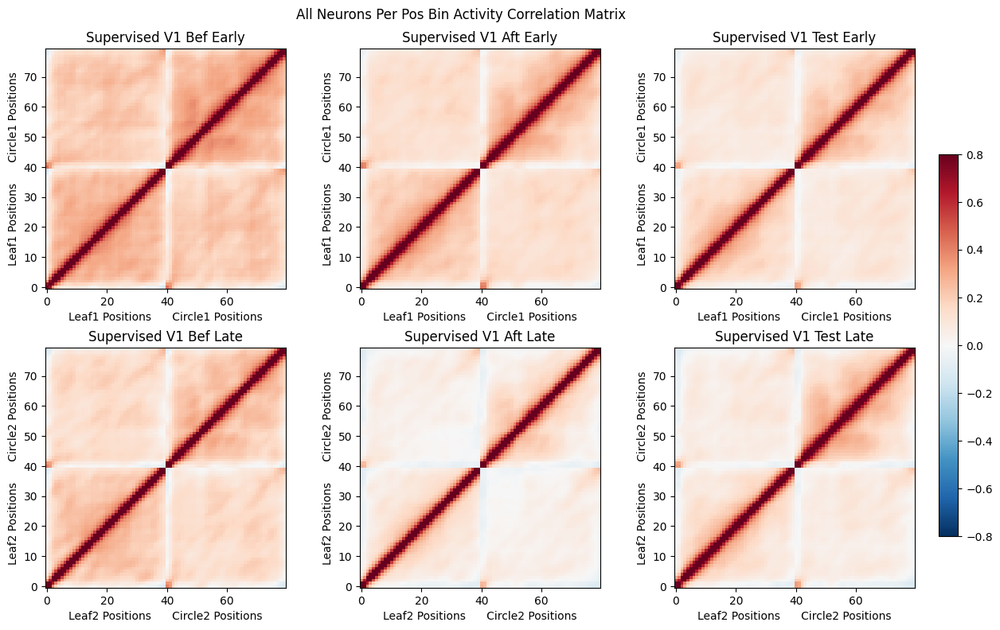

(80, 80) (80, 80)


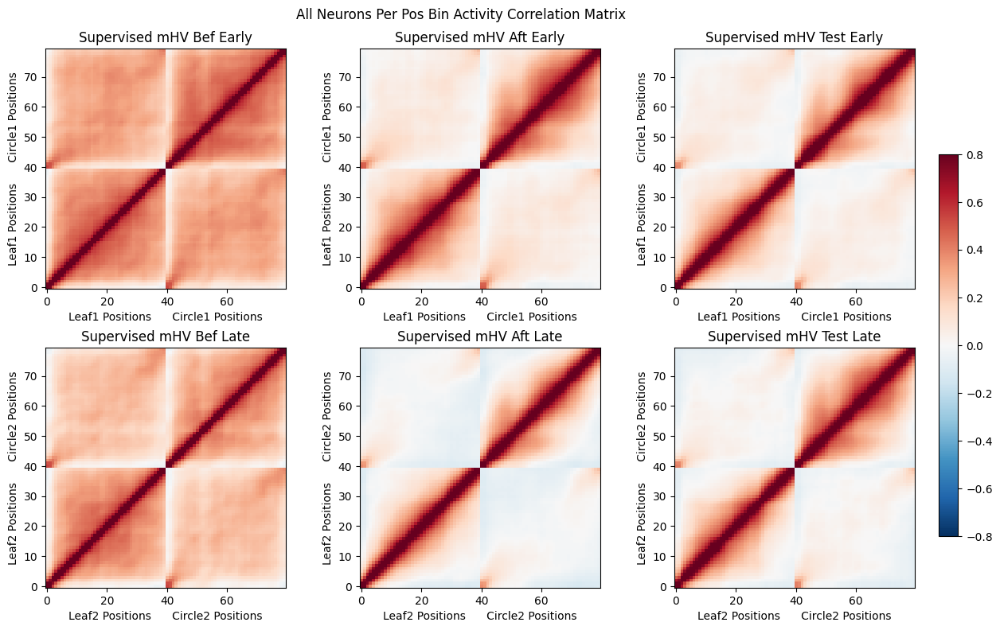

(80, 80) (80, 80)


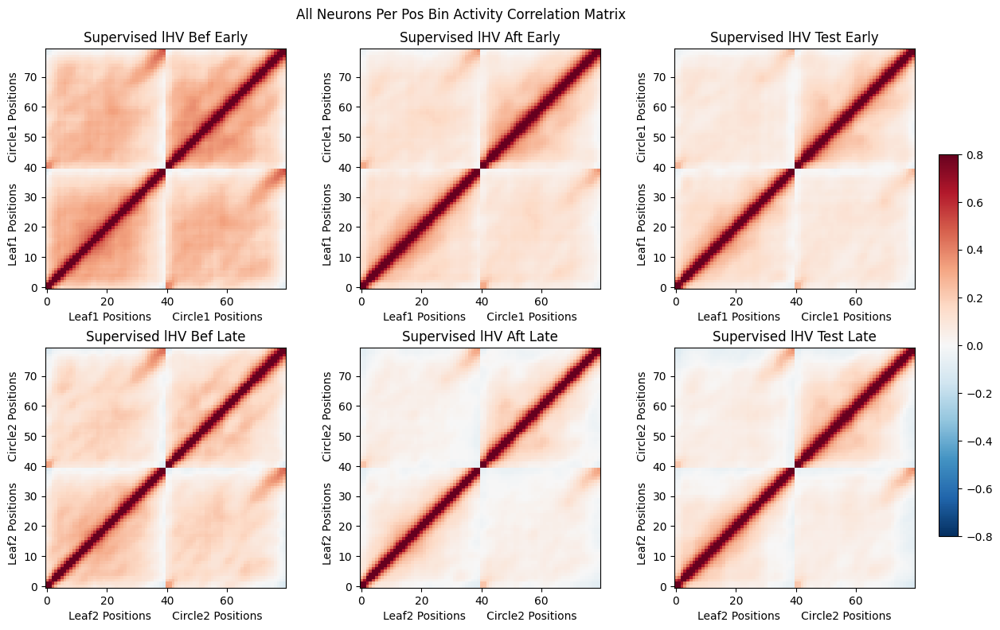

(80, 80) (80, 80)


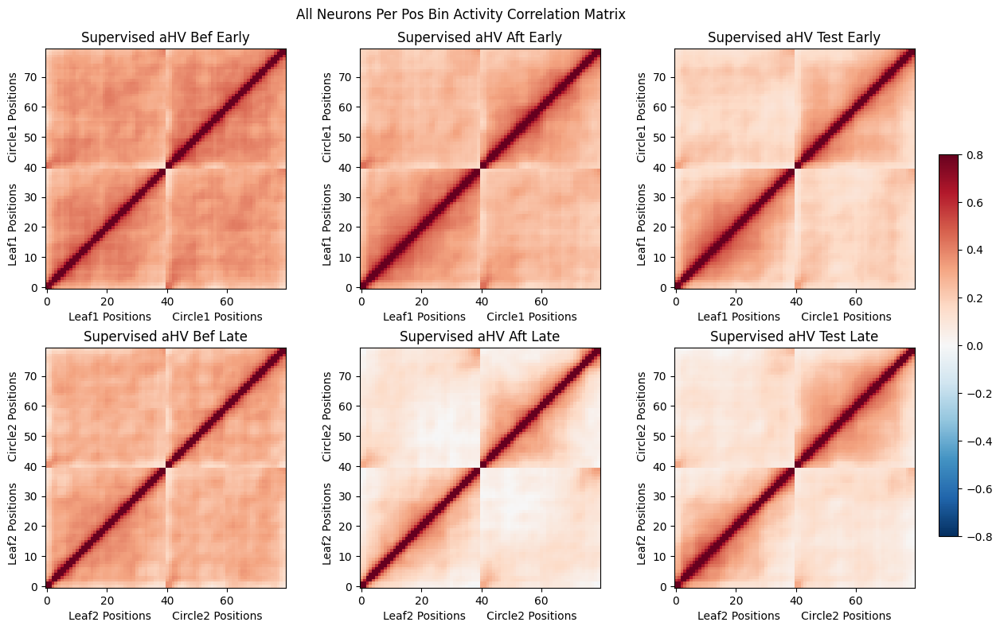

(80, 80) (80, 80)


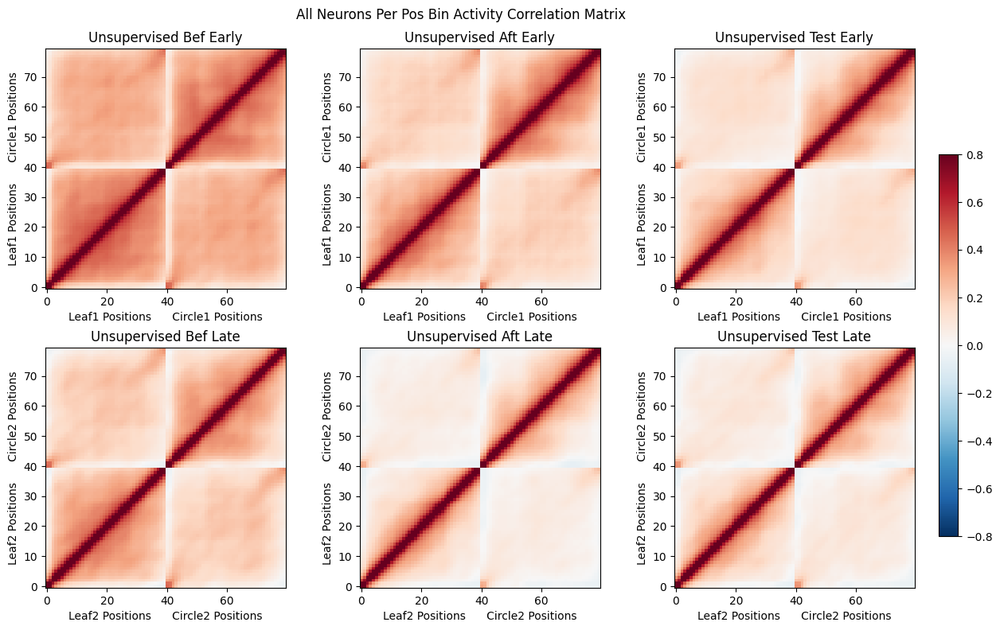

(80, 80) (80, 80)


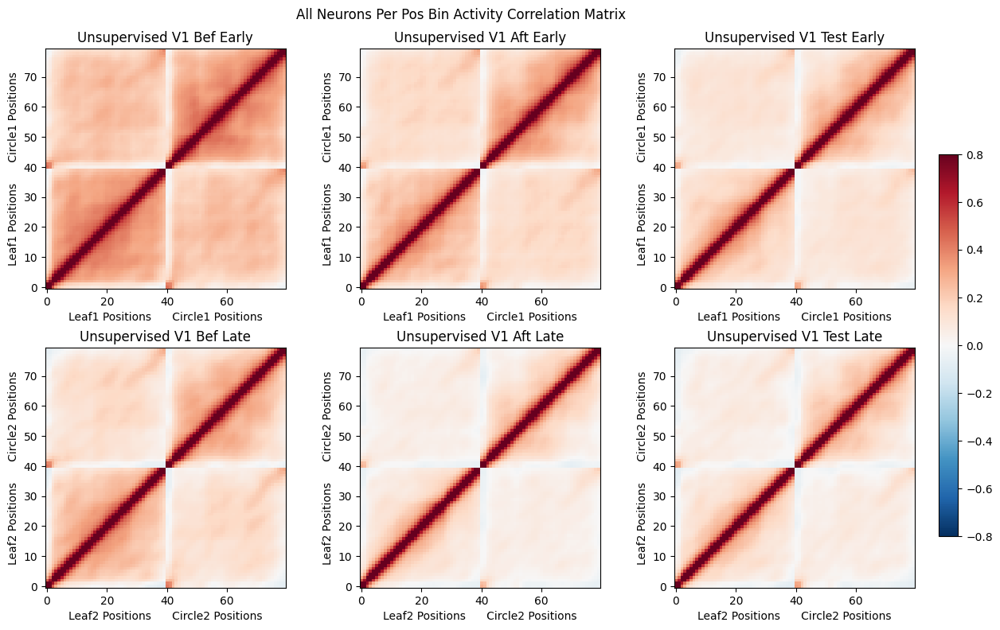

(80, 80) (80, 80)


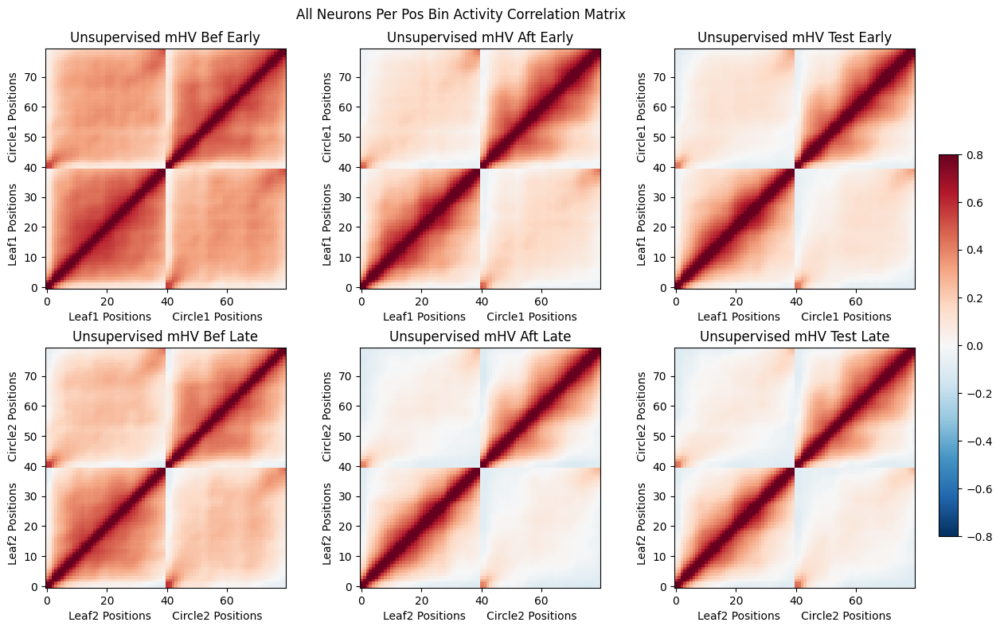

(80, 80) (80, 80)


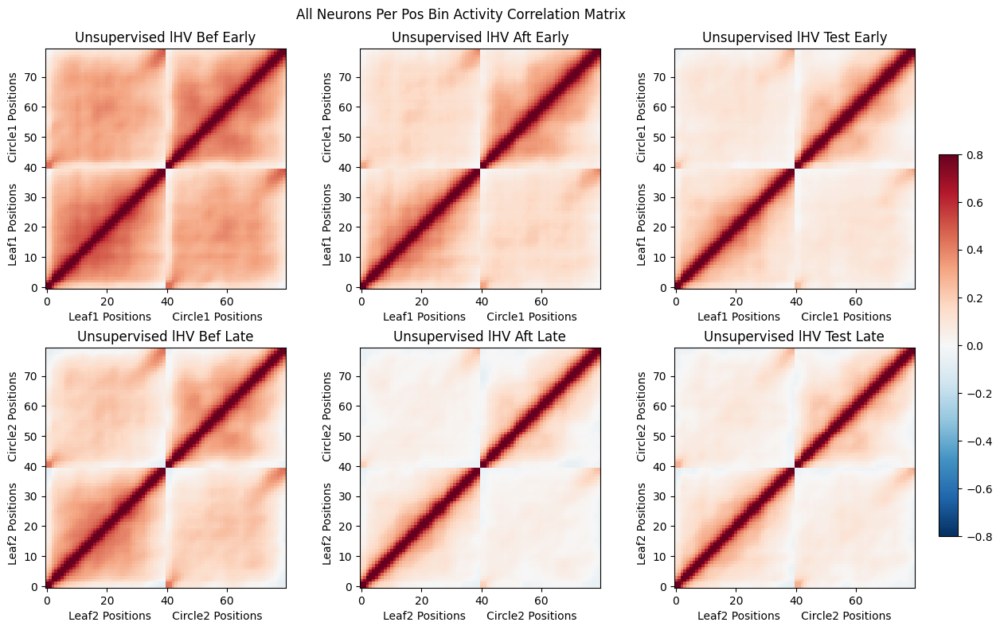

(80, 80) (80, 80)


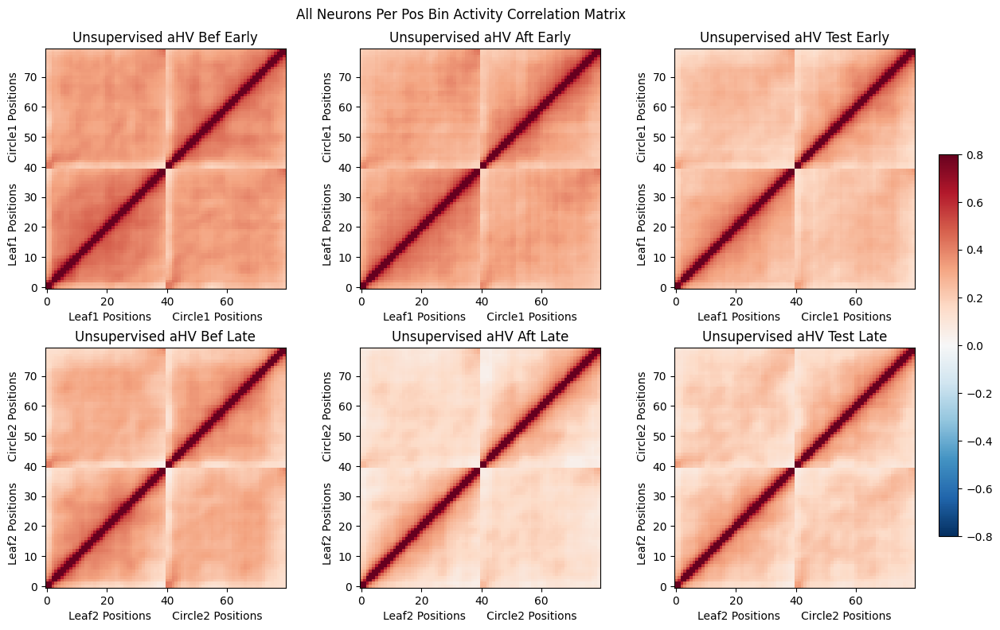

In [1064]:
sup_animal_list = ['TX109', 'TX108', 'TX60', 'VR2']
unsup_animal_list = ['TX83', 'TX119', 'TX88', 'TX105', 'TX123', 'DR15', 'DR10']
sup_aft1_neuron_pos_early = [sup_results['aft1'][0], sup1_results['aft1'][0], sup2_results['aft1'][0], sup3_results['aft1'][0]]
sup_aft1_neuron_pos_late = [sup_results['aft1'][1], sup1_results['aft1'][1], sup2_results['aft1'][1], sup3_results['aft1'][1]]
sup_bef1_neuron_pos_early = [sup_results['bef1'][0], sup1_results['bef1'][0], sup2_results['bef1'][0], sup3_results['bef1'][0]]
sup_bef1_neuron_pos_late = [sup_results['bef1'][1], sup1_results['bef1'][1], sup2_results['bef1'][1], sup3_results['bef1'][1]]
sup_test1_neuron_pos_early = [sup_results['test1'][0], sup1_results['test1'][0], sup2_results['test1'][0], sup3_results['test1'][0]]
sup_test1_neuron_pos_late = [sup_results['test1'][1], sup1_results['test1'][1], sup2_results['test1'][1], sup3_results['test1'][1]]

unsup_aft1_neuron_pos_early = [unsup_results['aft1'][0], unsup1_results['aft1'][0], unsup2_results['aft1'][0], unsup3_results['aft1'][0], unsup4_results['aft1'][0], unsup5_results['aft1'][0], unsup6_results['aft1'][0]]
unsup_aft1_neuron_pos_late = [unsup_results['aft1'][1], unsup1_results['aft1'][1], unsup2_results['aft1'][1], unsup3_results['aft1'][1], unsup4_results['aft1'][1], unsup5_results['aft1'][1], unsup6_results['aft1'][1]]
unsup_bef1_neuron_pos_early = [unsup_results['bef1'][0], unsup1_results['bef1'][0], unsup2_results['bef1'][0], unsup3_results['bef1'][0], unsup4_results['bef1'][0], unsup5_results['bef1'][0], unsup6_results['bef1'][0]]
unsup_bef1_neuron_pos_late = [unsup_results['bef1'][1], unsup1_results['bef1'][1], unsup2_results['bef1'][1], unsup3_results['bef1'][1], unsup4_results['bef1'][1], unsup5_results['bef1'][1], unsup6_results['bef1'][1]]
unsup_test1_neuron_pos_early = [unsup_results['test1'][0], unsup1_results['test1'][0], unsup2_results['test1'][0], unsup3_results['test1'][0], unsup4_results['test1'][0], unsup5_results['test1'][0], unsup6_results['test1'][0]]
unsup_test1_neuron_pos_late = [unsup_results['test1'][1], unsup1_results['test1'][1], unsup2_results['test1'][1], unsup3_results['test1'][1], unsup4_results['test1'][1], unsup5_results['test1'][1], unsup6_results['test1'][1]]


sup_aft_iarea_list = [sup_results['aft1'][2], sup1_results['aft1'][2], sup2_results['aft1'][2], sup3_results['aft1'][2]]
sup_bef_iarea_list = [sup_results['bef1'][2], sup1_results['bef1'][2], sup2_results['bef1'][2], sup3_results['bef1'][2]]
sup_test_iarea_list = [sup_results['test1'][2], sup1_results['test1'][2], sup2_results['test1'][2], sup3_results['test1'][2]]
unsup_aft_iarea_list = [unsup_results['aft1'][2], unsup1_results['aft1'][2], unsup2_results['aft1'][2], unsup3_results['aft1'][2], unsup4_results['aft1'][2], unsup5_results['aft1'][2], unsup6_results['aft1'][2]]
unsup_bef_iarea_list = [unsup_results['bef1'][2], unsup1_results['bef1'][2], unsup2_results['bef1'][2], unsup3_results['bef1'][2], unsup4_results['bef1'][2], unsup5_results['bef1'][2], unsup6_results['bef1'][2]]
unsup_test_iarea_list = [unsup_results['test1'][2], unsup1_results['test1'][2], unsup2_results['test1'][2], unsup3_results['test1'][2], unsup4_results['test1'][2], unsup5_results['test1'][2], unsup6_results['test1'][2]]

rdm_analysis_per_region_half_session(sup_aft1_neuron_pos_early, sup_bef1_neuron_pos_early, sup_test1_neuron_pos_early,
                                     sup_aft1_neuron_pos_late, sup_bef1_neuron_pos_late, sup_test1_neuron_pos_late,
                        sup_aft_iarea_list, sup_bef_iarea_list, sup_test_iarea_list, animal_list=sup_animal_list, animal_type='Supervised')
rdm_analysis_per_region_half_session(unsup_aft1_neuron_pos_early, unsup_bef1_neuron_pos_early, unsup_test1_neuron_pos_early,
                                     unsup_aft1_neuron_pos_late, unsup_bef1_neuron_pos_late, unsup_test1_neuron_pos_late,
                        unsup_aft_iarea_list, unsup_bef_iarea_list, unsup_test_iarea_list, animal_list=unsup_animal_list, animal_type='Unsupervised')


### Corr(sup, unsup) per Trial Block

In [8]:
def rdm_analysis_per_region_nblocks(aft_neuron_pos_list, bef_neuron_pos_list, test_neuron_pos_list,
                            aft_iarea_list, bef_iarea_list, test_iarea_list, animal_list, animal_type='Supervised', n_blocks=30):

    aft_mat = []
    bef_mat = []
    test_mat = []
    aft_mat_regions = {}
    bef_mat_regions = {}
    test_mat_regions = {}
    for i, animal in enumerate(animal_list):
        aft_neuron_pos = aft_neuron_pos_list[i]
        bef_neuron_pos = bef_neuron_pos_list[i]
        test_neuron_pos = test_neuron_pos_list[i]

        aft_area_idx = neu_area_ID(aft_iarea_list[i])
        bef_area_idx = neu_area_ID(bef_iarea_list[i])
        test_area_idx = neu_area_ID(test_iarea_list[i])

        #aft1_neuron_pos = zscore(aft1_neuron_pos)
        #bef1_neuron_pos = zscore(bef1_neuron_pos)
        #test1_neuron_pos = zscore(test1_neuron_pos)
        #print(aft1_neuron_pos[:,0].mean())
            
        #aft_matrix = np.corrcoef(aft1_neuron_pos)
        #bef_matrix = np.corrcoef(bef1_neuron_pos)
        #test_matrix = np.corrcoef(test1_neuron_pos)
        def row_corr_matrix(X):
            # X: (n_samples, n_features)
            Xc = X - X.mean(axis=1, keepdims=True)         # center rows
            Xn = Xc / np.linalg.norm(Xc, axis=1, keepdims=True)  # normalize rows
            return Xn @ Xn.T                               # Pearson r between rows
    
        aft_corr_blocks = np.zeros((n_blocks, aft_neuron_pos.shape[1], aft_neuron_pos.shape[1]), np.float32)
        bef_corr_blocks = np.zeros((n_blocks, bef_neuron_pos.shape[1], bef_neuron_pos.shape[1]), np.float32)
        test_corr_blocks = np.zeros((n_blocks, test_neuron_pos.shape[1], test_neuron_pos.shape[1]), np.float32)
        for b in range(n_blocks):
            aft_corr_blocks[b] = row_corr_matrix(aft_neuron_pos[b,:,:])
            bef_corr_blocks[b] = row_corr_matrix(bef_neuron_pos[b,:,:])
            test_corr_blocks[b] = row_corr_matrix(test_neuron_pos[b,:,:])

        aft_mat.append(aft_corr_blocks)
        bef_mat.append(bef_corr_blocks)
        test_mat.append(test_corr_blocks)
        for j, jar in enumerate(['V1', 'mHV', 'lHV', 'aHV']):
            aft_corr_regions_blocks = np.zeros((n_blocks, aft_neuron_pos.shape[1], aft_neuron_pos.shape[1]), np.float32)
            bef_corr_regions_blocks = np.zeros((n_blocks, bef_neuron_pos.shape[1], bef_neuron_pos.shape[1]), np.float32)
            test_corr_regions_blocks = np.zeros((n_blocks, test_neuron_pos.shape[1], test_neuron_pos.shape[1]), np.float32)
            for b in range(n_blocks):
                aft_corr_regions_blocks[b] = row_corr_matrix(aft_neuron_pos[b,:,aft_area_idx[jar]].T)
                bef_corr_regions_blocks[b] = row_corr_matrix(bef_neuron_pos[b,:,bef_area_idx[jar]].T)
                test_corr_regions_blocks[b] = row_corr_matrix(test_neuron_pos[b,:,test_area_idx[jar]].T)

            aft_mat_regions[jar] = aft_mat_regions.get(jar, []) + [aft_corr_regions_blocks]
            bef_mat_regions[jar] = bef_mat_regions.get(jar, []) + [bef_corr_regions_blocks]
            test_mat_regions[jar] = test_mat_regions.get(jar, []) + [test_corr_regions_blocks]

    aft_mat = np.nanmean(aft_mat, axis=0)
    bef_mat = np.nanmean(bef_mat, axis=0)
    test_mat = np.nanmean(test_mat, axis=0)
    print(aft_mat.shape)
    
    for jar in ['V1', 'mHV', 'lHV', 'aHV']:
        aft_mat_regions[jar] = np.nanmean(aft_mat_regions[jar], axis=0)
        bef_mat_regions[jar] = np.nanmean(bef_mat_regions[jar], axis=0)
        test_mat_regions[jar] = np.nanmean(test_mat_regions[jar], axis=0)

    return aft_mat, bef_mat, test_mat, aft_mat_regions, bef_mat_regions, test_mat_regions

In [10]:
sup_animal_list = ['TX109', 'TX108', 'TX60', 'VR2']
unsup_animal_list = ['TX83', 'TX119', 'TX88', 'TX105', 'TX123', 'DR15', 'DR10']

sup_aft1_neuron_pos = [sup_results['aft1'][0], sup1_results['aft1'][0], sup2_results['aft1'][0], sup3_results['aft1'][0]]
sup_bef1_neuron_pos = [sup_results['bef1'][0], sup1_results['bef1'][0], sup2_results['bef1'][0], sup3_results['bef1'][0]]
sup_test1_neuron_pos = [sup_results['test1'][0], sup1_results['test1'][0], sup2_results['test1'][0], sup3_results['test1'][0]]
sup_aft1_neuron_pos_cum = [sup_results['aft1'][1], sup1_results['aft1'][1], sup2_results['aft1'][1], sup3_results['aft1'][1]]
sup_bef1_neuron_pos_cum = [sup_results['bef1'][1], sup1_results['bef1'][1], sup2_results['bef1'][1], sup3_results['bef1'][1]]
sup_test1_neuron_pos_cum = [sup_results['test1'][1], sup1_results['test1'][1], sup2_results['test1'][1], sup3_results['test1'][1]]

unsup_aft1_neuron_pos = [unsup_results['aft1'][0], unsup1_results['aft1'][0], unsup2_results['aft1'][0], unsup3_results['aft1'][0], unsup4_results['aft1'][0], unsup5_results['aft1'][0], unsup6_results['aft1'][0]]
unsup_bef1_neuron_pos = [unsup_results['bef1'][0], unsup1_results['bef1'][0], unsup2_results['bef1'][0], unsup3_results['bef1'][0], unsup4_results['bef1'][0], unsup5_results['bef1'][0], unsup6_results['bef1'][0]]
unsup_test1_neuron_pos = [unsup_results['test1'][0], unsup1_results['test1'][0], unsup2_results['test1'][0], unsup3_results['test1'][0], unsup4_results['test1'][0], unsup5_results['test1'][0], unsup6_results['test1'][0]]
unsup_aft1_neuron_pos_cum = [unsup_results['aft1'][1], unsup1_results['aft1'][1], unsup2_results['aft1'][1], unsup3_results['aft1'][1], unsup4_results['aft1'][1], unsup5_results['aft1'][1], unsup6_results['aft1'][1]]
unsup_bef1_neuron_pos_cum = [unsup_results['bef1'][1], unsup1_results['bef1'][1], unsup2_results['bef1'][1], unsup3_results['bef1'][1], unsup4_results['bef1'][1], unsup5_results['bef1'][1], unsup6_results['bef1'][1]]
unsup_test1_neuron_pos_cum = [unsup_results['test1'][1], unsup1_results['test1'][1], unsup2_results['test1'][1], unsup3_results['test1'][1], unsup4_results['test1'][1], unsup5_results['test1'][1], unsup6_results['test1'][1]]


sup_aft_iarea_list = [sup_results['aft1'][2], sup1_results['aft1'][2], sup2_results['aft1'][2], sup3_results['aft1'][2]]
sup_bef_iarea_list = [sup_results['bef1'][2], sup1_results['bef1'][2], sup2_results['bef1'][2], sup3_results['bef1'][2]]
sup_test_iarea_list = [sup_results['test1'][2], sup1_results['test1'][2], sup2_results['test1'][2], sup3_results['test1'][2]]
unsup_aft_iarea_list = [unsup_results['aft1'][2], unsup1_results['aft1'][2], unsup2_results['aft1'][2], unsup3_results['aft1'][2], unsup4_results['aft1'][2], unsup5_results['aft1'][2], unsup6_results['aft1'][2]]
unsup_bef_iarea_list = [unsup_results['bef1'][2], unsup1_results['bef1'][2], unsup2_results['bef1'][2], unsup3_results['bef1'][2], unsup4_results['bef1'][2], unsup5_results['bef1'][2], unsup6_results['bef1'][2]]
unsup_test_iarea_list = [unsup_results['test1'][2], unsup1_results['test1'][2], unsup2_results['test1'][2], unsup3_results['test1'][2], unsup4_results['test1'][2], unsup5_results['test1'][2], unsup6_results['test1'][2]]

sup_aft1_mat, sup_bef1_mat, sup_test1_mat, sup_aft1_regions, sup_bef1_regions, sup_test1_regions = rdm_analysis_per_region_nblocks(sup_aft1_neuron_pos, sup_bef1_neuron_pos, sup_test1_neuron_pos,
                        sup_aft_iarea_list, sup_bef_iarea_list, sup_test_iarea_list, animal_list=sup_animal_list, animal_type='Supervised')
unsup_aft1_mat, unsup_bef1_mat, unsup_test1_mat, unsup_aft1_regions, unsup_bef1_regions, unsup_test1_regions = rdm_analysis_per_region_nblocks(unsup_aft1_neuron_pos, unsup_bef1_neuron_pos, unsup_test1_neuron_pos,
                        unsup_aft_iarea_list, unsup_bef_iarea_list, unsup_test_iarea_list, animal_list=unsup_animal_list, animal_type='Unsupervised')
sup_aft1_cum, sup_bef1_cum, sup_test1_cum, sup_aft1_regions_cum, sup_bef1_regions_cum, sup_test1_regions_cum = rdm_analysis_per_region_nblocks(sup_aft1_neuron_pos_cum, sup_bef1_neuron_pos_cum, sup_test1_neuron_pos_cum,
                            sup_aft_iarea_list, sup_bef_iarea_list, sup_test_iarea_list, animal_list=sup_animal_list, animal_type='Supervised')          
unsup_aft1_cum, unsup_bef1_cum, unsup_test1_cum, unsup_aft1_regions_cum, unsup_bef1_regions_cum, unsup_test1_regions_cum = rdm_analysis_per_region_nblocks(unsup_aft1_neuron_pos_cum, unsup_bef1_neuron_pos_cum, unsup_test1_neuron_pos_cum,    
                            unsup_aft_iarea_list, unsup_bef_iarea_list, unsup_test_iarea_list, animal_list=unsup_animal_list, animal_type='Unsupervised')                                                                                                       

(30, 80, 80)
(30, 80, 80)
(30, 80, 80)
(30, 80, 80)


In [119]:
def cos_similarity(mat1, mat2):
    mat1 = mat1.reshape(1, -1).T if mat1.ndim == 2 else mat1
    mat2 = mat2.reshape(1, -1).T if mat2.ndim == 2 else mat2
    cos_sim = mat1.T @ mat2 / (np.linalg.norm(mat1) * np.linalg.norm(mat2)) 
    cos_sim = cos_sim.squeeze()
    return cos_sim

def rv_coefficient(X, Y, center=True):
    X = np.asarray(X, float); Y = np.asarray(Y, float)
    if X.shape[0] != Y.shape[0]:
        raise ValueError("X and Y must have the same number of samples (rows).")
    if center:
        X = X - X.mean(axis=0, keepdims=True)
        Y = Y - Y.mean(axis=0, keepdims=True)

    Sxy = X.T @ Y
    Sxx = X.T @ X
    Syy = Y.T @ Y

    num = np.linalg.norm(Sxy, 'fro')**2
    den = np.linalg.norm(Sxx, 'fro') * np.linalg.norm(Syy, 'fro')
    return np.nan if den == 0 else num / den

def pearsonr(A, B):
    a = np.asarray(A, float).ravel()
    b = np.asarray(B, float).ravel()
    if a.size != b.size:
        raise ValueError("A and B must have the same number of elements.")
    a = a - a.mean()          # global mean (scalar)
    b = b - b.mean()
    denom = np.linalg.norm(a) * np.linalg.norm(b)
    return np.nan if denom == 0 else float(np.dot(a, b) / denom)


def visualize_nblocks(sup_mat, unsup_mat, sup_regions, unsup_regions, method='cossim', title='Supervised vs Unsupervised After Training', n_blocks=30):
    if method == 'cossim':
        sim_func = cos_similarity
    elif method == 'rv':
        sim_func = rv_coefficient
    elif method == 'pearson':
        sim_func = pearsonr
    else:
        raise ValueError("Unknown method: {}".format(method))

    sim = np.zeros(n_blocks)
    sim_regions = {jar: np.zeros(n_blocks) for jar in ['V1', 'mHV', 'lHV', 'aHV']}
    for i in range(n_blocks):
        #sim[i] = sim_func(np.triu(sup_mat[i,:,:],k=1), np.triu(unsup_mat[i,:,:],k=1))
        sim[i] = sim_func(sup_mat[i,:40,40:], unsup_mat[i,:40,40:])
        #sim[i] = sim_func(np.vstack([np.triu(sup_mat[i,:40,:40],k=1), np.triu(sup_mat[i,40:,40:],k=1)]), np.vstack([np.triu(unsup_mat[i,:40,:40],k=1), np.triu(unsup_mat[i,40:,40:],k=1)]))

        for jar in ['V1', 'mHV', 'lHV', 'aHV']:
            #sim_regions[jar][i] = sim_func(np.triu(sup_regions[jar][i,:,:],k=1), np.triu(unsup_regions[jar][i,:,:],k=1))
            sim_regions[jar][i] = sim_func(sup_regions[jar][i,:40,40:], unsup_regions[jar][i,:40,40:])
            #sim_regions[jar][i] = sim_func(np.vstack([np.triu(sup_regions[jar][i,:40,:40],k=1), np.triu(sup_regions[jar][i,40:,40:],k=1)]), np.vstack([np.triu(unsup_regions[jar][i,:40,:40],k=1), np.triu(unsup_regions[jar][i,40:,40:],k=1)]))

    plt.figure(figsize=(10, 5))
    plt.plot(np.arange(n_blocks), sim, label='All Neurons', color='k')
    for jar in ['V1', 'mHV', 'lHV', 'aHV']:
        plt.plot(np.arange(n_blocks), sim_regions[jar], label=jar, linestyle='--')
    plt.xlabel('Block (Contain ~10 trials)')
    plt.ylabel('Cosine Similarity')
    plt.title(title)
    plt.legend()
    plt.show()

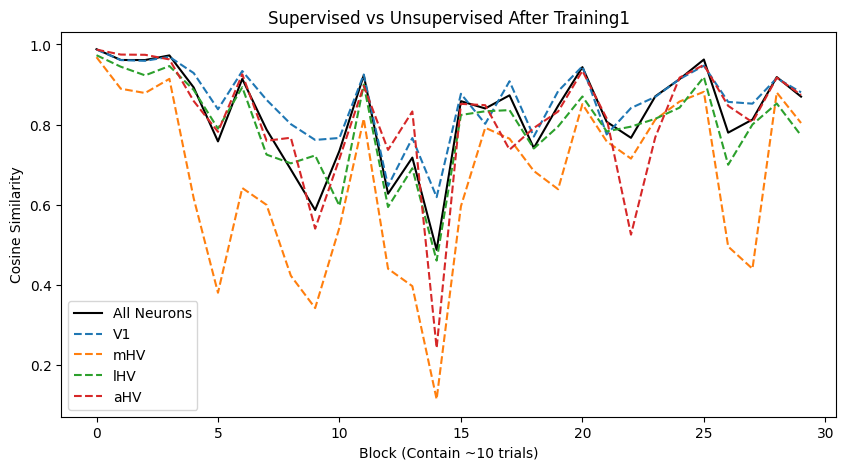

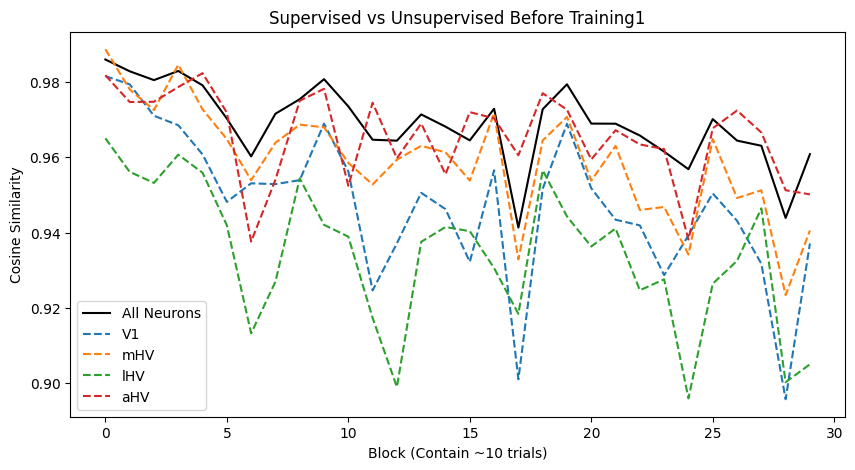

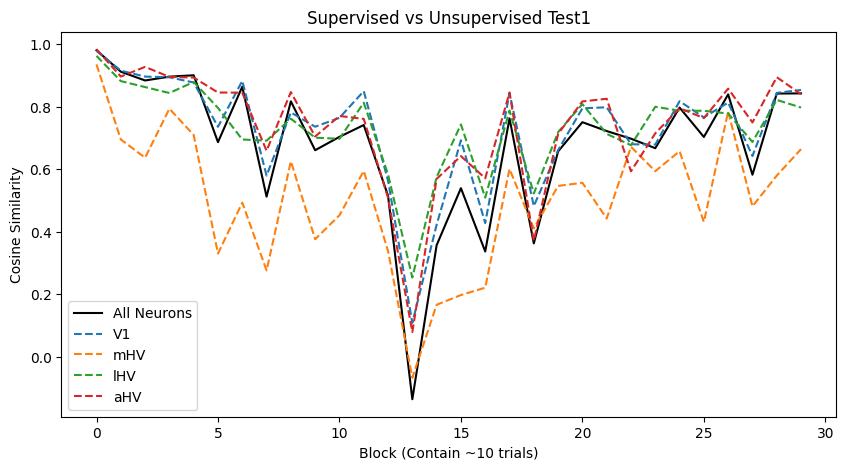

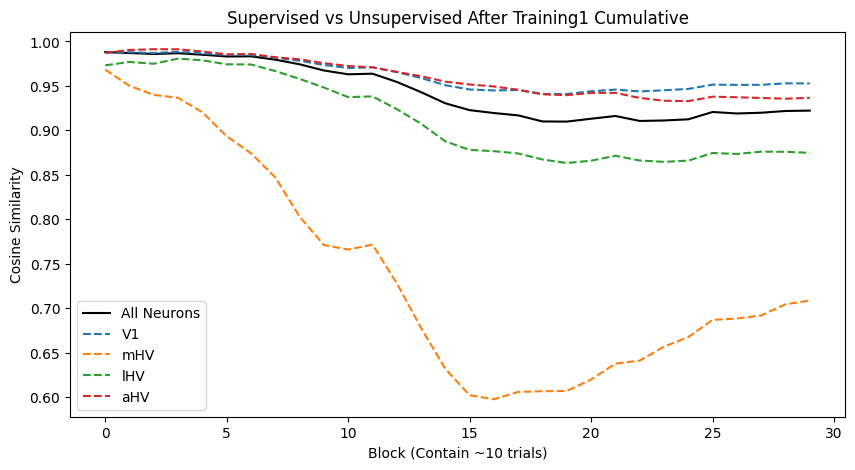

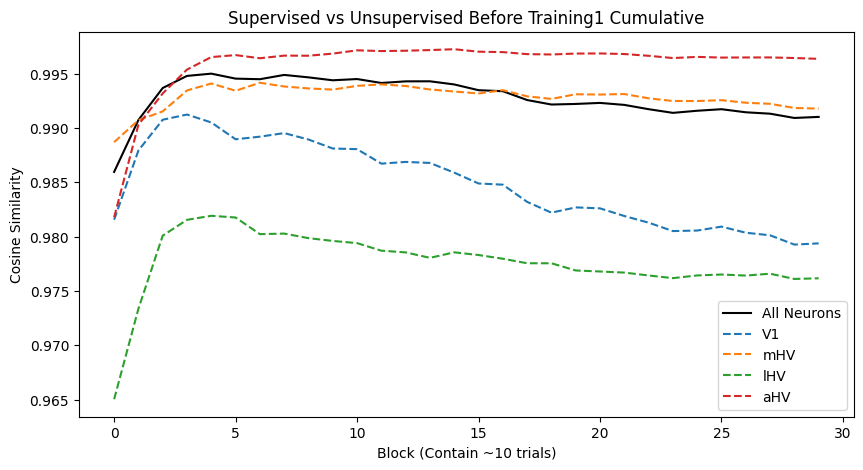

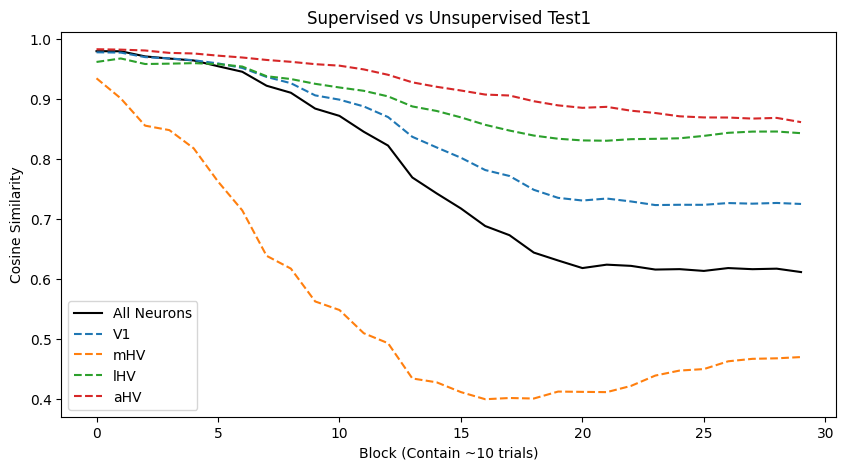

In [121]:
visualize_nblocks(sup_aft1_mat, unsup_aft1_mat, sup_aft1_regions, unsup_aft1_regions, method='cossim', title='Supervised vs Unsupervised After Training1', n_blocks=30)
visualize_nblocks(sup_bef1_mat, unsup_bef1_mat, sup_bef1_regions, unsup_bef1_regions, method='cossim', title='Supervised vs Unsupervised Before Training1', n_blocks=30)
visualize_nblocks(sup_test1_mat, unsup_test1_mat, sup_test1_regions, unsup_test1_regions, method='cossim', title='Supervised vs Unsupervised Test1', n_blocks=30)

visualize_nblocks(sup_aft1_cum, unsup_aft1_cum, sup_aft1_regions_cum, unsup_aft1_regions_cum, method='cossim', title='Supervised vs Unsupervised After Training1 Cumulative', n_blocks=30)
visualize_nblocks(sup_bef1_cum, unsup_bef1_cum, sup_bef1_regions_cum, unsup_bef1_regions_cum, method='cossim', title='Supervised vs Unsupervised Before Training1 Cumulative', n_blocks=30)
visualize_nblocks(sup_test1_cum, unsup_test1_cum, sup_test1_regions_cum, unsup_test1_regions_cum, method='cossim', title='Supervised vs Unsupervised Test1', n_blocks=30)

## Multi Animals Data

### Whole Session Data Version

In [ ]:
def multi_animals_pipeline(aft1, bef1, test1, root, animal_type='sup', 
                           corr_matrix=False, CCA_neuron_80pos=False
                           ):
    """
    Process multiple animals' data through the pipeline.
    """
    # Beh
    aft1_beh = np.load(os.path.join(root, 'beh', f'Beh_{animal_type}_train1_after_learning.npy'), allow_pickle=1).item()[aft1]
    bef1_beh = np.load(os.path.join(root, 'beh', f'Beh_{animal_type}_train1_before_learning.npy'), allow_pickle=1).item()[bef1]
    test1_beh = np.load(os.path.join(root, 'beh', f'Beh_{animal_type}_test1.npy'), allow_pickle=1).item()[test1]

    # Spks
    aft1_spks, aft1_xpos, aft1_ypos, _, _, aft1_iarea = prepare_data(aft1)
    bef1_spks, bef1_xpos, bef1_ypos, _, _, bef1_iarea = prepare_data(bef1)
    test1_spks, test1_xpos, test1_ypos, _, _, test1_iarea = prepare_data(test1)
    print(f'Animal {aft1}: {animal_type} after training 1: {aft1_spks.shape}')
    print(f'Animal {bef1}: {animal_type} before training 1: {bef1_spks.shape}')
    print(f'Animal {test1}: {animal_type} test 1: {test1_spks.shape}')
    print(f'Animal {aft1}: {animal_type} after training 1 iarea: {aft1_iarea.shape} {np.unique(aft1_iarea)}')

    # Tuning Neurons
    aft1_corridor_tuning = tuning_curves_VR(aft1_spks, aft1_beh['ft_Pos'] / 60, aft1_beh['StartFr'], aft1_beh['EndFr'], aft1_beh)
    bef1_corridor_tuning = tuning_curves_VR(bef1_spks, bef1_beh['ft_Pos'] / 60, bef1_beh['StartFr'], bef1_beh['EndFr'], bef1_beh)
    test1_corridor_tuning = tuning_curves_VR(test1_spks, test1_beh['ft_Pos'] / 60, test1_beh['StartFr'], test1_beh['EndFr'], test1_beh, num_stimuli=4)
    print(f'Animal {aft1}: {animal_type} after training 1 corr tuning shape: {aft1_corridor_tuning.shape}')

    del aft1_spks, bef1_spks, test1_spks

    aft1_corr_sets = get_tuning_neurons_idx(aft1_corridor_tuning)
    bef1_corr_sets = get_tuning_neurons_idx(bef1_corridor_tuning)
    test1_corr_sets = get_tuning_neurons_idx(test1_corridor_tuning)

    aft1_neuron_pos = all_neuron_pos_bin_matrix(aft1_corridor_tuning)
    bef1_neuron_pos = all_neuron_pos_bin_matrix(bef1_corridor_tuning)
    test1_neuron_pos = all_neuron_pos_bin_matrix(test1_corridor_tuning)

    del aft1_corridor_tuning, bef1_corridor_tuning, test1_corridor_tuning

    if corr_matrix:
        visualize_corr_matrix(np.corrcoef(aft1_neuron_pos), 
                              np.corrcoef(bef1_neuron_pos), 
                              f'{aft1} Aft1', f'{bef1} Bef1'
                              #, vmin=0.0, vmax=0.95
                              )
        visualize_corr_matrix(np.corrcoef(test1_neuron_pos), 
                              np.corrcoef(aft1_neuron_pos), 
                              f'{test1} Test1', f'{aft1} Bef1'
                              #, vmin=0.0, vmax=0.95
                              )

        cos_sim = cos_similarity(np.triu(np.corrcoef(aft1_neuron_pos)),
                                        np.triu(np.corrcoef(bef1_neuron_pos)))
        cos_sim_leaf_circle = cos_similarity(np.corrcoef(aft1_neuron_pos)[:40, 40:],
                                        np.corrcoef(bef1_neuron_pos)[:40, 40:])
        print(f'{aft1} before and after training cosine similarity: {cos_sim}')
        print(f'{aft1} leaf circle before and after training cosine similarity: {cos_sim_leaf_circle}')

        cos_sim = cos_similarity(np.triu(np.corrcoef(test1_neuron_pos)),
                                       np.triu(np.corrcoef(aft1_neuron_pos)))
        cos_sim_leaf_circle = cos_similarity(np.corrcoef(test1_neuron_pos)[:40, 40:],
                                       np.corrcoef(aft1_neuron_pos)[:40, 40:])
        print(f'{aft1} test and after training cosine similarity: {cos_sim}')
        print(f'{aft1} leaf circle test and after training cosine similarity: {cos_sim_leaf_circle}')

    if CCA_neuron_80pos:
        n_runs = 1000
        corr = np.zeros(n_runs)
        U_mat = np.zeros((n_runs, min(aft1_neuron_pos.shape[1], bef1_neuron_pos.shape[1])))
        V_mat = np.zeros((n_runs, min(bef1_neuron_pos.shape[1], aft1_neuron_pos.shape[1])))
        for n in range(n_runs):
            print(f'Run {n+1}/{n_runs}')
            XT, YT = matrix_align(aft1_neuron_pos.T, bef1_neuron_pos.T, random_state=n)

            XT = zscore(XT)
            YT = zscore(YT)

            cca_a, cca_b = _ridge_cca_first_weights(XT, YT)

            U = XT @ cca_a
            V = YT @ cca_b

            U_mat[n] = U.reshape(1, -1)
            V_mat[n] = V.reshape(1, -1)

            corr[n] = np.corrcoef(U.ravel(), V.ravel())[0, 1]


    return aft1_neuron_pos, bef1_neuron_pos, test1_neuron_pos, aft1_corr_sets, bef1_corr_sets, test1_corr_sets

Loaded TX109_2023_04_07_1 spks with shape (89577, 20021)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Loaded TX109_2023_03_27_1 spks with shape (63625, 14586)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Loaded TX109_2023_04_18_1 spks with shape (83309, 17371)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX109_2023_04_07_1: sup after training 1: (89577, 20021)
Animal TX109_2023_03_27_1: sup before training 1: (63625, 14586)
Animal TX109_2023_04_18_1: sup test 1: (83309, 17371)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Animal TX109_2023_04_07_1: sup after training 1 corr tuning shape: (2, 89577, 60)
Neuron 251 is tuned at position 30 in corridor leaf1 with corr: a=0.9488622205394386, b=0.7661215400575455, ab=0.9492981791598164
Neuron 254 is tuned at position 30 in corridor circle1 with corr: a=0.384211716380979, b=0.9072222585383268, ab=-0.9533098064031895
Neuron 704 is tuned at position 30 in corridor leaf1 with corr: a=0.9137319764191042, b=0.41909943691790497, ab=0.9635601993911329
Neuron 1227 is tuned at position 30 in corridor circle1 with corr: a=-0.15308400171670994, b=0.9263089679076435, ab=-0.9203589986946736
Neuron 3383 is tuned at position 30 in corridor leaf1 with corr: a=0.9691910114829635, b=0.6305838033737563, ab=0.969034984836143
Neuron 3529 is tuned at position 30 in corridor leaf1 with corr: a=0.968547812028362, b=0.4276763956556358, ab=0.965116410513445
Neuron 3946 is tuned at position 30 in corridor leaf1 with corr: a=0.9273707325801912, b=0.6031409712076894, ab=0.9682876625685722

/tmp/ipykernel_1030/1108165686.py:31: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


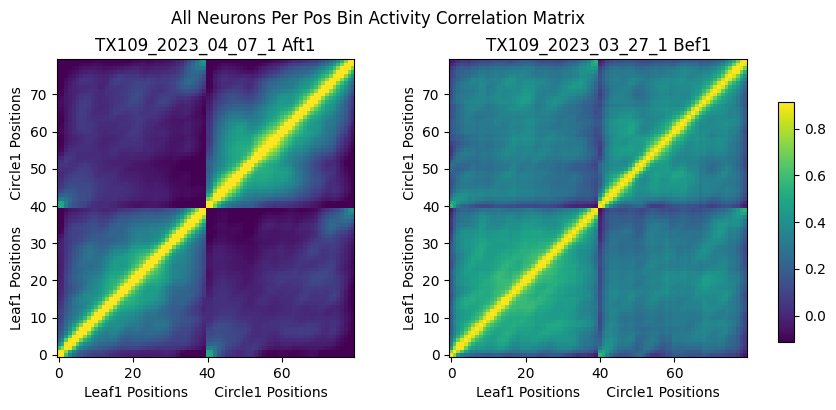

(80, 80) (80, 80)


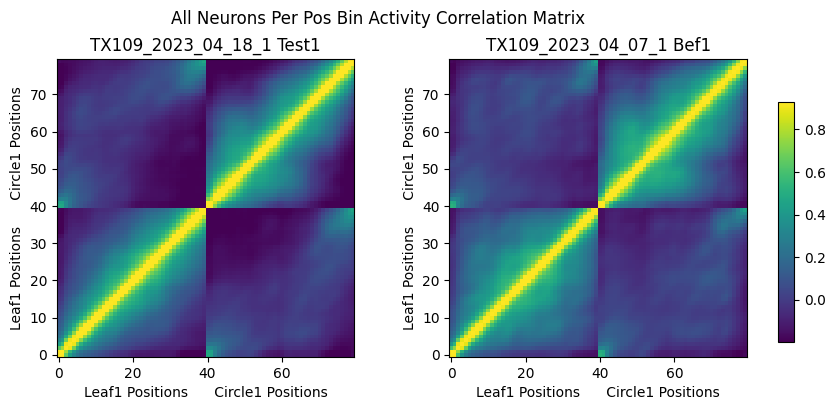

TX109_2023_04_07_1 before and after training cosine similarity: 0.8131610707747225
TX109_2023_04_07_1 leaf circle before and after training cosine similarity: 0.23591569025599415
TX109_2023_04_07_1 test and after training cosine similarity: 0.9725346593546118
TX109_2023_04_07_1 leaf circle test and after training cosine similarity: 0.8454318157630625
Loaded TX83_2022_08_29_1 spks with shape (52954, 24407)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Loaded TX83_2022_08_17_1 spks with shape (44059, 20428)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Loaded TX83_2022_08_31_1 spks with shape (50689, 33597)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX83_2022_08_29_1: unsup after training 1: (52954, 24407)
Animal TX83_2022_08_17_1: unsup before training 1: (44059, 20428)
Animal TX83_2022_08_31_1: unsup test 1: (50689, 33597)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Animal TX83_2022_08_29_1: unsup after training 1 corr tuning shape: (2, 52954, 60)
Neuron 952 is tuned at position 30 in corridor leaf1 with corr: a=0.9310699276130694, b=0.2890553132990476, ab=0.9640400109254622
Neuron 5515 is tuned at position 30 in corridor leaf1 with corr: a=0.939785713126829, b=-0.32933733949216476, ab=0.9470362504635608
Neuron 23597 is tuned at position 30 in corridor leaf1 with corr: a=0.9248089258259538, b=0.14033033065971165, ab=0.9330973053836065
Neuron 24026 is tuned at position 30 in corridor leaf1 with corr: a=0.9382630523270847, b=0.5494983337921168, ab=0.9716667422239976
Neuron 25678 is tuned at position 30 in corridor leaf1 with corr: a=0.9299154356793757, b=-0.8460969115764914, ab=0.9466461260442843
Neuron 26023 is tuned at position 30 in corridor leaf1 with corr: a=0.945489672475193, b=-0.16622734252517912, ab=0.9554424959661391
Neuron 27476 is tuned at position 30 in corridor circle1 with corr: a=0.11929017642692386, b=0.9534606393048488, ab=-0.93764

/tmp/ipykernel_1030/1108165686.py:31: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


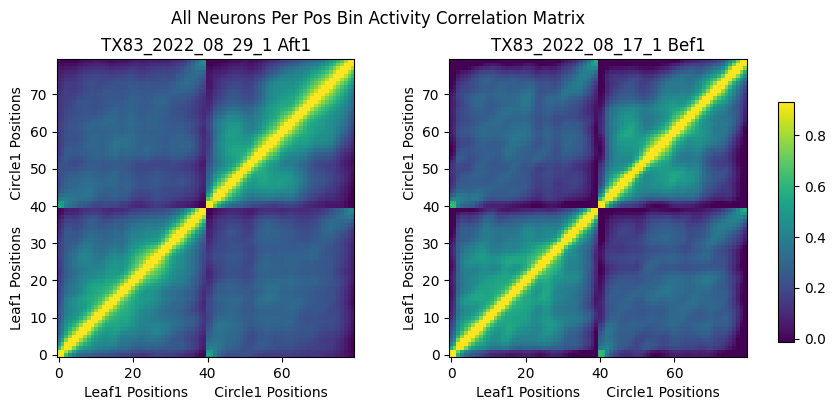

(80, 80) (80, 80)


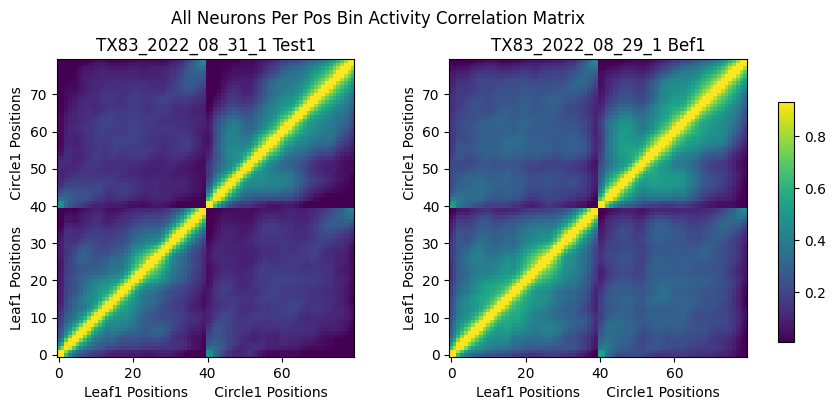

TX83_2022_08_29_1 before and after training cosine similarity: 0.9885252619867316
TX83_2022_08_29_1 leaf circle before and after training cosine similarity: 0.9769262928281207
TX83_2022_08_29_1 test and after training cosine similarity: 0.9791627508495165
TX83_2022_08_29_1 leaf circle test and after training cosine similarity: 0.9727545218805747
Loaded TX108_2023_03_22_1 spks with shape (75480, 19566)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Loaded TX108_2023_03_13_1 spks with shape (85481, 22992)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Loaded TX108_2023_03_25_1 spks with shape (79417, 26600)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX108_2023_03_22_1: sup after training 1: (75480, 19566)
Animal TX108_2023_03_13_1: sup before training 1: (85481, 22992)
Animal TX108_2023_03_25_1: sup test 1: (79417, 26600)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Animal TX108_2023_03_22_1: sup after training 1 corr tuning shape: (2, 75480, 60)
Neuron 168 is tuned at position 30 in corridor leaf1 with corr: a=0.9408110313032706, b=0.5932566115397673, ab=0.9648144138797573
Neuron 723 is tuned at position 30 in corridor leaf1 with corr: a=0.9252146943183863, b=-0.38215920827643973, ab=0.9186161450058722
Neuron 1624 is tuned at position 30 in corridor leaf1 with corr: a=0.9055656106523442, b=0.7032684143586208, ab=0.9502289356768516
Neuron 2669 is tuned at position 30 in corridor circle1 with corr: a=0.7130316751842556, b=0.96061512578494, ab=-0.9629347950306554
Neuron 2672 is tuned at position 30 in corridor leaf1 with corr: a=0.9722541361338035, b=0.5841049541128873, ab=0.9784131915231923
Neuron 2678 is tuned at position 30 in corridor leaf1 with corr: a=0.9571740980681613, b=-0.472385429956882, ab=0.9478989454193459
Neuron 2781 is tuned at position 30 in corridor circle1 with corr: a=0.7393413798662731, b=0.914435434236238, ab=-0.965656770207836

/tmp/ipykernel_1030/1108165686.py:31: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


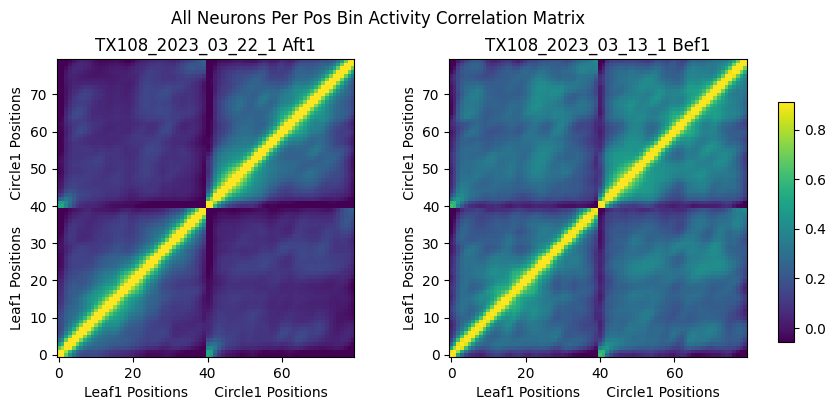

(80, 80) (80, 80)


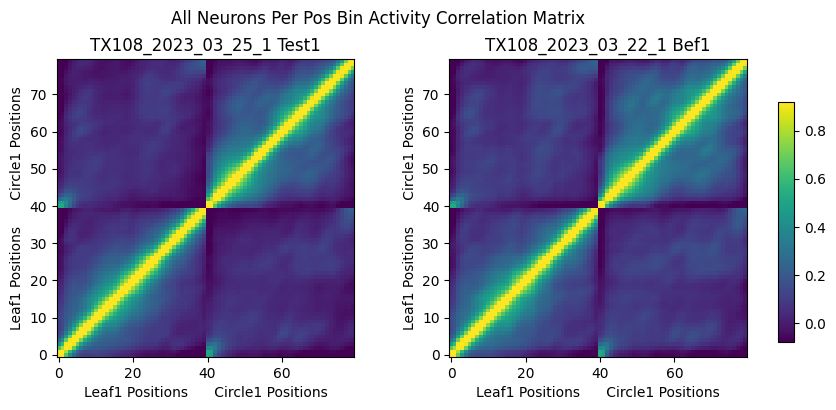

TX108_2023_03_22_1 before and after training cosine similarity: 0.9228947544687152
TX108_2023_03_22_1 leaf circle before and after training cosine similarity: 0.9037885176607484
TX108_2023_03_22_1 test and after training cosine similarity: 0.9921572256818544
TX108_2023_03_22_1 leaf circle test and after training cosine similarity: 0.9359893096241928
Loaded TX119_2023_12_23_1 spks with shape (36935, 15608)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Loaded TX119_2023_12_14_1 spks with shape (31672, 15432)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Loaded TX119_2023_12_24_1 spks with shape (27281, 14570)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX119_2023_12_23_1: unsup after training 1: (36935, 15608)
Animal TX119_2023_12_14_1: unsup before training 1: (31672, 15432)
Animal TX119_2023_12_24_1: unsup test 1: (27281, 14570)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Animal TX119_2023_12_23_1: unsup after training 1 corr tuning shape: (2, 36935, 60)
Neuron 102 is tuned at position 30 in corridor circle1 with corr: a=-0.6184388814186417, b=0.9501637405014483, ab=-0.9581755376849236
Neuron 243 is tuned at position 30 in corridor leaf1 with corr: a=0.9360534601282274, b=0.6717208777174374, ab=0.9629842200516853
Neuron 327 is tuned at position 30 in corridor circle1 with corr: a=0.7534974566669816, b=0.9206254784454692, ab=-0.9372592621511434
Neuron 476 is tuned at position 30 in corridor leaf1 with corr: a=0.9113569949293582, b=-0.2767844183930694, ab=0.9318554628232188
Neuron 1103 is tuned at position 30 in corridor leaf1 with corr: a=0.9575677563233511, b=0.41638508190859774, ab=0.946053755493677
Neuron 1156 is tuned at position 30 in corridor circle1 with corr: a=0.6993506089475393, b=0.9749167265366585, ab=-0.9782620947966058
Neuron 1344 is tuned at position 30 in corridor circle1 with corr: a=-0.0885484526340878, b=0.9349945416454156, ab=-0.90261

/tmp/ipykernel_1030/1108165686.py:31: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


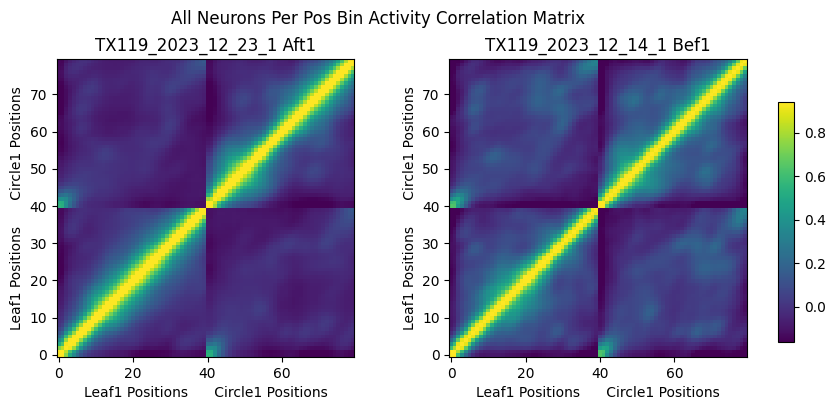

(80, 80) (80, 80)


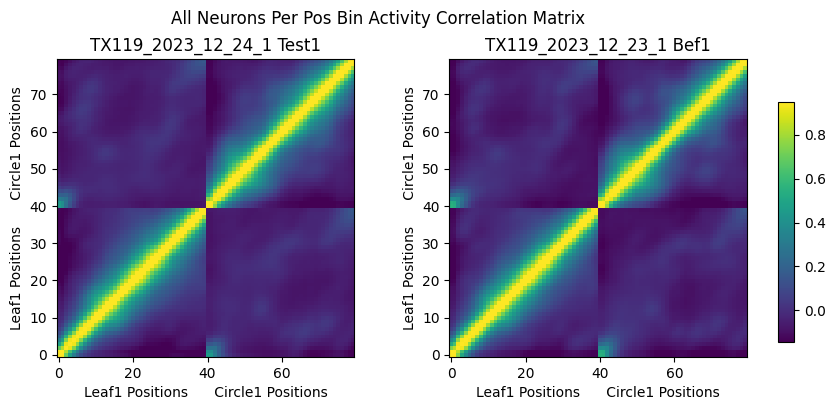

TX119_2023_12_23_1 before and after training cosine similarity: 0.9637882735155897
TX119_2023_12_23_1 leaf circle before and after training cosine similarity: 0.578299615164581
TX119_2023_12_23_1 test and after training cosine similarity: 0.9953502228939209
TX119_2023_12_23_1 leaf circle test and after training cosine similarity: 0.9389897317896913
Loaded TX60_2021_05_04_1 spks with shape (57368, 17576)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Loaded TX60_2021_04_10_1 spks with shape (48732, 23469)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Loaded TX60_2021_06_07_1 spks with shape (47785, 22475)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX60_2021_05_04_1: sup after training 1: (57368, 17576)
Animal TX60_2021_04_10_1: sup before training 1: (48732, 23469)
Animal TX60_2021_06_07_1: sup test 1: (47785, 22475)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Animal TX60_2021_05_04_1: sup after training 1 corr tuning shape: (2, 57368, 60)
Neuron 978 is tuned at position 30 in corridor leaf1 with corr: a=0.901410709083508, b=-0.09472319092733227, ab=0.9219204206793296
Neuron 3050 is tuned at position 30 in corridor circle1 with corr: a=0.2615083935400445, b=0.939578237934839, ab=-0.9585941445920062
Neuron 3204 is tuned at position 30 in corridor circle1 with corr: a=-0.006028337511756882, b=0.9663411224966175, ab=-0.97042627199009
Neuron 3225 is tuned at position 30 in corridor circle1 with corr: a=-0.18392439622461035, b=0.9525372363471919, ab=-0.9704574486762866
Neuron 5531 is tuned at position 30 in corridor leaf1 with corr: a=0.9289927395951816, b=-0.0015665386648741916, ab=0.9334083847951774
Neuron 5668 is tuned at position 30 in corridor leaf1 with corr: a=0.9468609271432478, b=-0.022942315487828324, ab=0.9178023325712917
Neuron 5830 is tuned at position 30 in corridor circle1 with corr: a=0.0458992139643194, b=0.9348868883316859, ab=-

/tmp/ipykernel_1030/1108165686.py:31: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


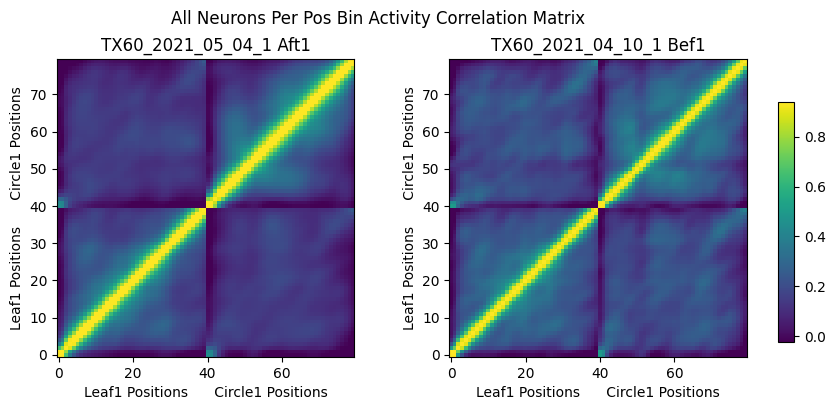

(80, 80) (80, 80)


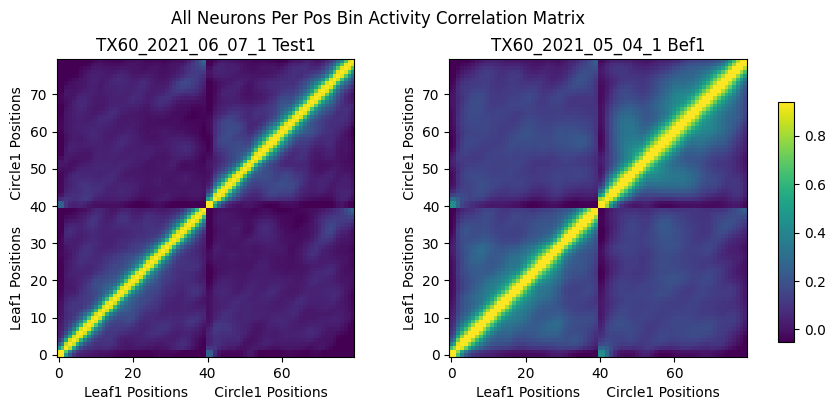

TX60_2021_05_04_1 before and after training cosine similarity: 0.9771280658165042
TX60_2021_05_04_1 leaf circle before and after training cosine similarity: 0.9685749721512711
TX60_2021_05_04_1 test and after training cosine similarity: 0.9320727208329631
TX60_2021_05_04_1 leaf circle test and after training cosine similarity: 0.6833195806659409
Loaded TX88_2022_06_17_2 spks with shape (48824, 27969)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Loaded TX88_2022_06_13_2 spks with shape (62606, 20539)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Loaded TX88_2022_06_20_1 spks with shape (58099, 29422)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX88_2022_06_17_2: unsup after training 1: (48824, 27969)
Animal TX88_2022_06_13_2: unsup before training 1: (62606, 20539)
Animal TX88_2022_06_20_1: unsup test 1: (58099, 29422)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Animal TX88_2022_06_17_2: unsup after training 1 corr tuning shape: (2, 48824, 60)
Neuron 2819 is tuned at position 30 in corridor circle1 with corr: a=0.23451211596602836, b=0.9301020502455101, ab=-0.9641410863115181
Neuron 2990 is tuned at position 30 in corridor leaf1 with corr: a=0.9648591322100873, b=0.5939842335480892, ab=0.9624541288152928
Neuron 3062 is tuned at position 30 in corridor leaf1 with corr: a=0.9108595433748807, b=0.6963279697296292, ab=0.9155139554180469
Neuron 3269 is tuned at position 30 in corridor leaf1 with corr: a=0.9341938383070935, b=0.268871188433774, ab=0.9584350273824391
Neuron 3376 is tuned at position 30 in corridor leaf1 with corr: a=0.9742772663537722, b=-0.0528398275004209, ab=0.9744072280995639
Neuron 3784 is tuned at position 30 in corridor leaf1 with corr: a=0.917095399521658, b=0.11517333038621723, ab=0.9368134499346853
Neuron 4198 is tuned at position 30 in corridor circle1 with corr: a=0.100428198843394, b=0.9468253623273007, ab=-0.94087890967

/tmp/ipykernel_1030/1108165686.py:31: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


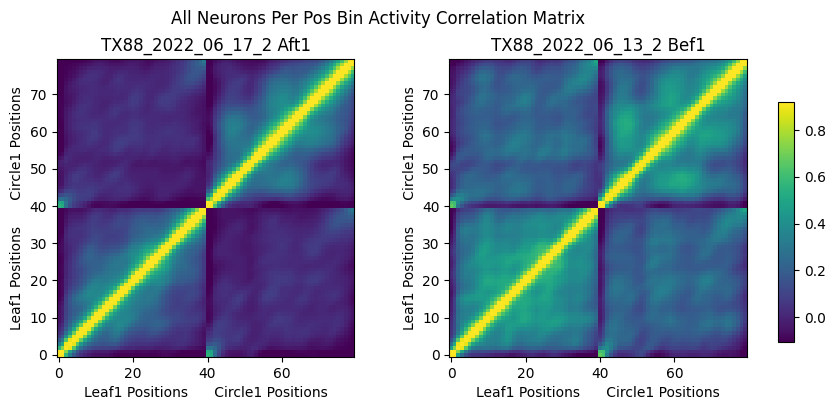

(80, 80) (80, 80)


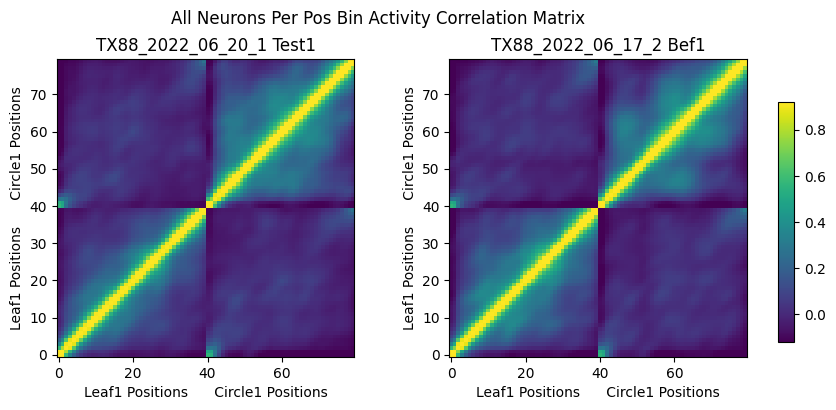

TX88_2022_06_17_2 before and after training cosine similarity: 0.8935864870248613
TX88_2022_06_17_2 leaf circle before and after training cosine similarity: 0.4734269506843708
TX88_2022_06_17_2 test and after training cosine similarity: 0.9910855775499194
TX88_2022_06_17_2 leaf circle test and after training cosine similarity: 0.9098442839138846
Loaded VR2_2021_04_06_1 spks with shape (71069, 17760)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Loaded VR2_2021_03_20_1 spks with shape (81473, 24298)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Loaded VR2_2021_04_11_1 spks with shape (76108, 29244)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal VR2_2021_04_06_1: sup after training 1: (71069, 17760)
Animal VR2_2021_03_20_1: sup before training 1: (81473, 24298)
Animal VR2_2021_04_11_1: sup test 1: (76108, 29244)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Animal VR2_2021_04_06_1: sup after training 1 corr tuning shape: (2, 71069, 60)
Neuron 753 is tuned at position 30 in corridor leaf1 with corr: a=0.9114574880553328, b=0.5615221402191409, ab=0.9617391213969934
Neuron 2975 is tuned at position 30 in corridor circle1 with corr: a=0.70770248707465, b=0.9629341524864096, ab=-0.949352748319085
Neuron 3101 is tuned at position 30 in corridor leaf1 with corr: a=0.9500046941029525, b=0.00876047715183081, ab=0.9456213068913669
Neuron 3518 is tuned at position 30 in corridor leaf1 with corr: a=0.9136114555095729, b=-0.09233608117306719, ab=0.9143246535378879
Neuron 3726 is tuned at position 30 in corridor circle1 with corr: a=0.6404723232268229, b=0.903509124130065, ab=-0.937039652974202
Neuron 5988 is tuned at position 30 in corridor circle1 with corr: a=0.35101626775442124, b=0.9647760889164254, ab=-0.964441792519782
Neuron 7570 is tuned at position 30 in corridor circle1 with corr: a=0.45267216735928734, b=0.968817759886348, ab=-0.96530386035

/tmp/ipykernel_1030/1108165686.py:31: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


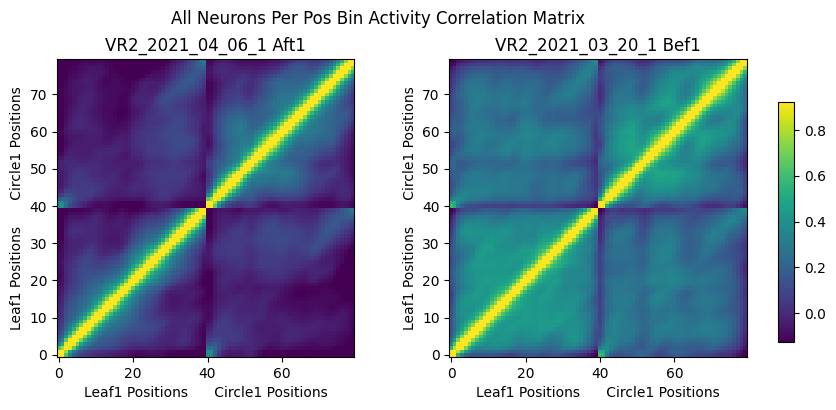

(80, 80) (80, 80)


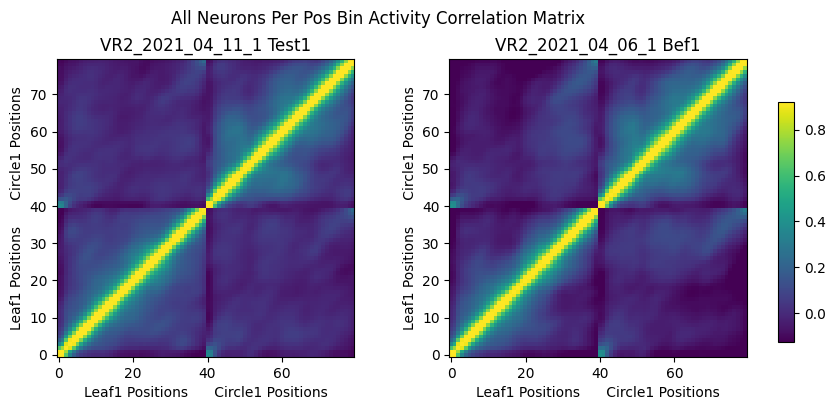

VR2_2021_04_06_1 before and after training cosine similarity: 0.7847981812548874
VR2_2021_04_06_1 leaf circle before and after training cosine similarity: -0.024266488122256326
VR2_2021_04_06_1 test and after training cosine similarity: 0.9846931577166891
VR2_2021_04_06_1 leaf circle test and after training cosine similarity: 0.7840153339660926
Loaded TX105_2022_10_19_2 spks with shape (55653, 15553)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Loaded TX105_2022_10_08_2 spks with shape (58941, 27740)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Loaded TX105_2022_10_21_1 spks with shape (61115, 24809)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX105_2022_10_19_2: unsup after training 1: (55653, 15553)
Animal TX105_2022_10_08_2: unsup before training 1: (58941, 27740)
Animal TX105_2022_10_21_1: unsup test 1: (61115, 24809)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Animal TX105_2022_10_19_2: unsup after training 1 corr tuning shape: (2, 55653, 60)
Neuron 204 is tuned at position 30 in corridor leaf1 with corr: a=0.9231074937582878, b=-0.05038891872836249, ab=0.9429133550058835
Neuron 334 is tuned at position 30 in corridor leaf1 with corr: a=0.9325627277277068, b=0.4916196694420359, ab=0.9044667221390835
Neuron 1030 is tuned at position 30 in corridor leaf1 with corr: a=0.9260694745754572, b=0.45291326588772385, ab=0.930312993276128
Neuron 1309 is tuned at position 30 in corridor leaf1 with corr: a=0.9051884891007402, b=-0.28406423028924316, ab=0.925369244950432
Neuron 2505 is tuned at position 30 in corridor circle1 with corr: a=0.4868188008713451, b=0.9511398726815751, ab=-0.9218856925765843
Neuron 2823 is tuned at position 30 in corridor leaf1 with corr: a=0.9316734352917, b=0.2769857818628118, ab=0.9311693733971126
Neuron 3424 is tuned at position 30 in corridor leaf1 with corr: a=0.9673153107259297, b=0.678768222592535, ab=0.9658646831838459

/tmp/ipykernel_1030/1108165686.py:31: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


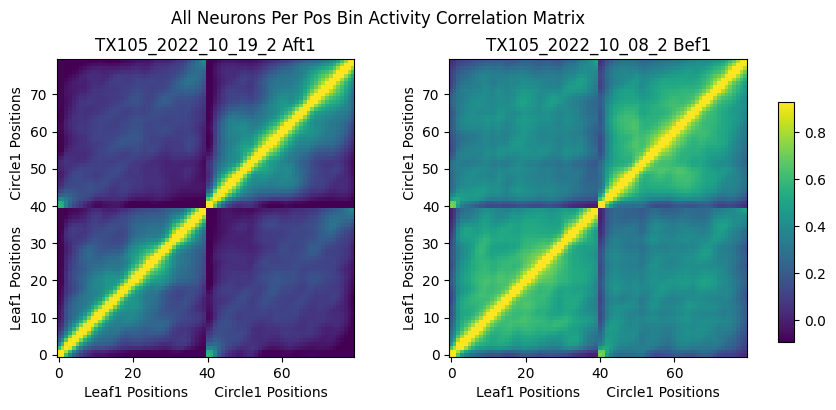

(80, 80) (80, 80)


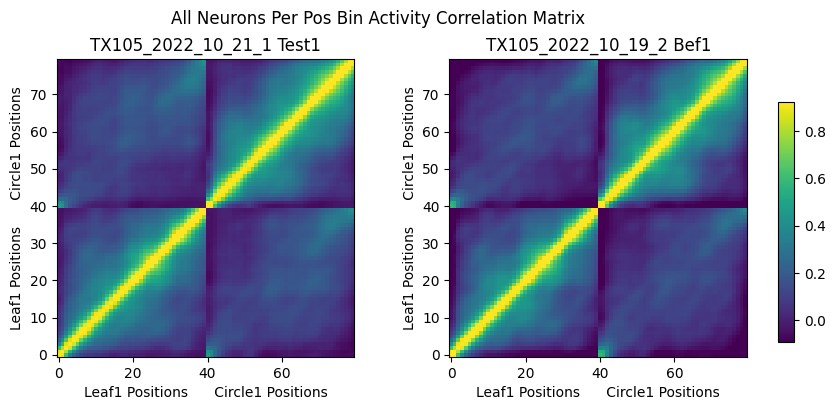

TX105_2022_10_19_2 before and after training cosine similarity: 0.8571341298113164
TX105_2022_10_19_2 leaf circle before and after training cosine similarity: 0.7601642675727401
TX105_2022_10_19_2 test and after training cosine similarity: 0.993399474560502
TX105_2022_10_19_2 leaf circle test and after training cosine similarity: 0.9530018208901117
Loaded TX123_2024_01_02_1 spks with shape (43103, 29251)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Loaded TX123_2023_12_21_1 spks with shape (28696, 15946)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Loaded TX123_2024_01_03_1 spks with shape (30931, 19057)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX123_2024_01_02_1: unsup after training 1: (43103, 29251)
Animal TX123_2023_12_21_1: unsup before training 1: (28696, 15946)
Animal TX123_2024_01_03_1: unsup test 1: (30931, 19057)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Animal TX123_2024_01_02_1: unsup after training 1 corr tuning shape: (2, 43103, 60)
Neuron 32 is tuned at position 30 in corridor circle1 with corr: a=0.11403095798876486, b=0.9011359926413873, ab=-0.9557457019333953
Neuron 49 is tuned at position 30 in corridor leaf1 with corr: a=0.9423285992374646, b=0.17873801372899353, ab=0.9405897860520324
Neuron 132 is tuned at position 30 in corridor circle1 with corr: a=0.3863440336888643, b=0.939123922655292, ab=-0.9427966977236344
Neuron 146 is tuned at position 30 in corridor leaf1 with corr: a=0.9374574788606599, b=-0.21572652156635763, ab=0.9418552191382417
Neuron 320 is tuned at position 30 in corridor circle1 with corr: a=-0.08072934186482536, b=0.9185995258935933, ab=-0.9557840608941649
Neuron 364 is tuned at position 30 in corridor leaf1 with corr: a=0.9570839945849077, b=-0.06495087745128446, ab=0.9506908400339626
Neuron 475 is tuned at position 30 in corridor circle1 with corr: a=0.5553356074558919, b=0.9567718558158012, ab=-0.966355

/tmp/ipykernel_1030/1108165686.py:31: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


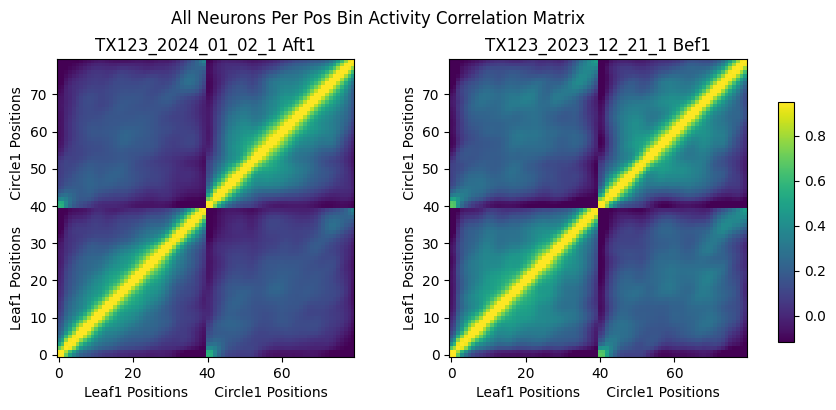

(80, 80) (80, 80)


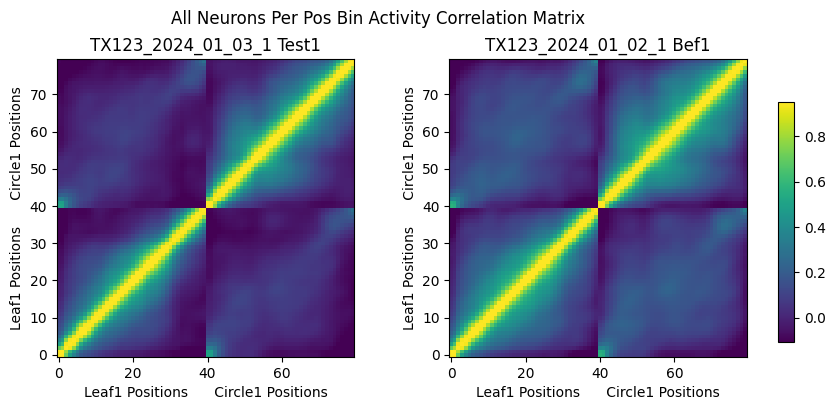

TX123_2024_01_02_1 before and after training cosine similarity: 0.9796065714453417
TX123_2024_01_02_1 leaf circle before and after training cosine similarity: 0.9669982598204038
TX123_2024_01_02_1 test and after training cosine similarity: 0.9712154516017777
TX123_2024_01_02_1 leaf circle test and after training cosine similarity: 0.7266971809901122
Loaded DR15_2022_10_19_1 spks with shape (58930, 28848)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Loaded DR15_2022_10_09_1 spks with shape (55746, 29375)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Loaded DR15_2022_10_20_1 spks with shape (64130, 26837)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal DR15_2022_10_19_1: unsup after training 1: (58930, 28848)
Animal DR15_2022_10_09_1: unsup before training 1: (55746, 29375)
Animal DR15_2022_10_20_1: unsup test 1: (64130, 26837)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Animal DR15_2022_10_19_1: unsup after training 1 corr tuning shape: (2, 58930, 60)
Neuron 3936 is tuned at position 30 in corridor circle1 with corr: a=0.40671482646346174, b=0.9499235521032561, ab=-0.9508447936431371
Neuron 4297 is tuned at position 30 in corridor leaf1 with corr: a=0.9708914869419176, b=0.24047733906156227, ab=0.9599160938405539
Neuron 6688 is tuned at position 30 in corridor leaf1 with corr: a=0.9396836772947023, b=-0.12891509462795872, ab=0.9531405814705468
Neuron 8505 is tuned at position 30 in corridor leaf1 with corr: a=0.9588503967758146, b=0.24117739511846484, ab=0.9629954710216919
Neuron 11776 is tuned at position 30 in corridor leaf1 with corr: a=0.9353110456722757, b=0.6959647637628569, ab=0.9028742448965394
Neuron 32587 is tuned at position 30 in corridor leaf1 with corr: a=0.9602580672888289, b=-0.34030803691514655, ab=0.9700285903205942
Neuron 32920 is tuned at position 30 in corridor leaf1 with corr: a=0.9454051651309123, b=0.0891147964768139, ab=0.9397

/tmp/ipykernel_1030/1108165686.py:31: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


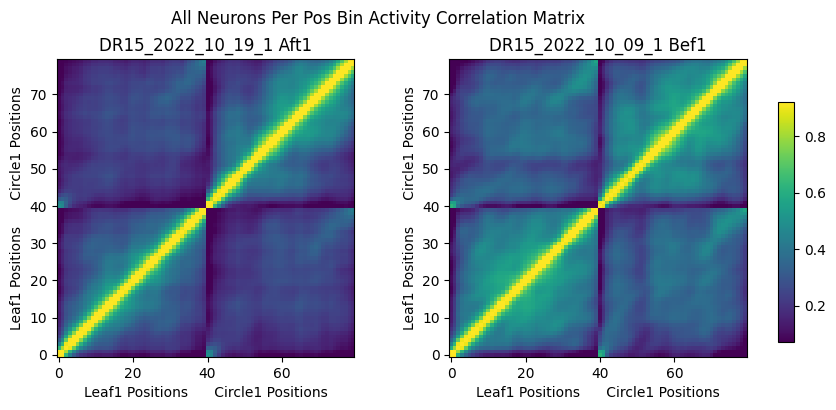

(80, 80) (80, 80)


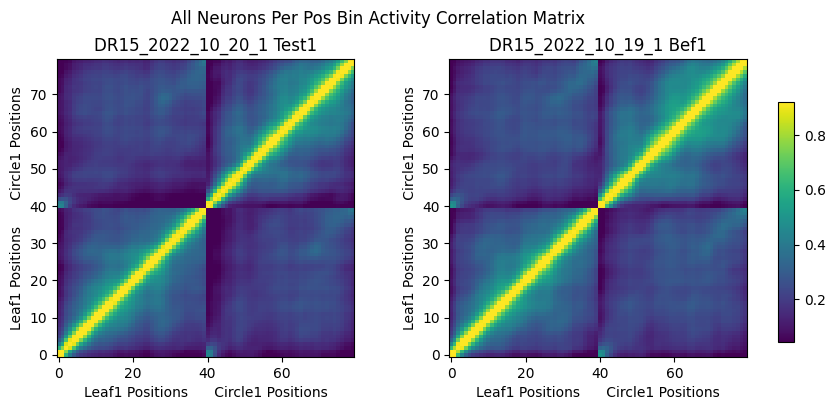

DR15_2022_10_19_1 before and after training cosine similarity: 0.9853276111563386
DR15_2022_10_19_1 leaf circle before and after training cosine similarity: 0.992623499961564
DR15_2022_10_19_1 test and after training cosine similarity: 0.9955519063072518
DR15_2022_10_19_1 leaf circle test and after training cosine similarity: 0.9901242745814426
Loaded DR10_2022_07_19_1 spks with shape (54741, 22328)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Loaded DR10_2022_07_12_1 spks with shape (58224, 31707)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Loaded DR10_2022_07_21_1 spks with shape (50347, 24068)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal DR10_2022_07_19_1: unsup after training 1: (54741, 22328)
Animal DR10_2022_07_12_1: unsup before training 1: (58224, 31707)
Animal DR10_2022_07_21_1: unsup test 1: (50347, 24068)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Animal DR10_2022_07_19_1: unsup after training 1 corr tuning shape: (2, 54741, 60)
Neuron 43 is tuned at position 30 in corridor circle1 with corr: a=0.7582540905560696, b=0.9199180107968278, ab=-0.9231703861942905
Neuron 1020 is tuned at position 30 in corridor leaf1 with corr: a=0.9261578062220677, b=0.268659890918568, ab=0.9390470295511034
Neuron 1489 is tuned at position 30 in corridor circle1 with corr: a=0.007277110973517948, b=0.9344229370527251, ab=-0.9183411714939222
Neuron 1777 is tuned at position 30 in corridor circle1 with corr: a=0.011359965111016583, b=0.9109518625764023, ab=-0.9138670023804977
Neuron 2931 is tuned at position 30 in corridor circle1 with corr: a=-0.31512021104164734, b=0.9350957397990015, ab=-0.9078358649316456
Neuron 4852 is tuned at position 30 in corridor leaf1 with corr: a=0.9152045624414644, b=0.1749558457560641, ab=0.9565766514957424
Neuron 5177 is tuned at position 30 in corridor circle1 with corr: a=-0.15556789713139077, b=0.935267946331561, ab=-

/tmp/ipykernel_1030/1108165686.py:31: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


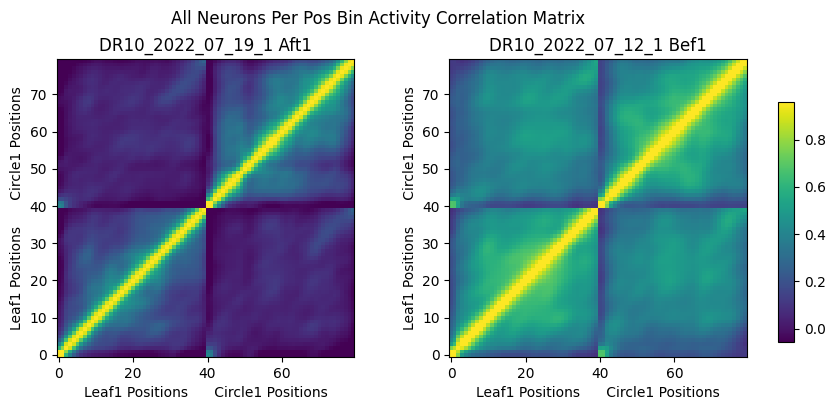

(80, 80) (80, 80)


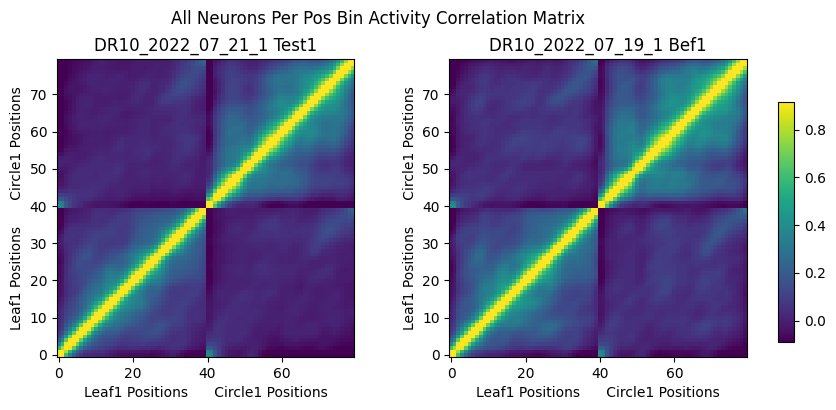

DR10_2022_07_19_1 before and after training cosine similarity: 0.8335942897600257
DR10_2022_07_19_1 leaf circle before and after training cosine similarity: 0.7390997453087964
DR10_2022_07_19_1 test and after training cosine similarity: 0.9915714750057284
DR10_2022_07_19_1 leaf circle test and after training cosine similarity: 0.8234641972130419


In [17]:
sup_aft1_neuron_pos, sup_bef1_neuron_pos, sup_test1_neuron_pos, sup_aft1_corr_sets, sup_bef1_corr_sets, sup_test1_corr_sets = multi_animals_pipeline(
    aft1='TX109_2023_04_07_1', bef1='TX109_2023_03_27_1', test1='TX109_2023_04_18_1',
    root=root,
    animal_type='sup',
    CCA_neuron_80pos=False
)

unsup_aft1_neuron_pos, unsup_bef1_neuron_pos, unsup_test1_neuron_pos, unsup_aft1_corr_sets, unsup_bef1_corr_sets, unsup_test1_corr_sets = multi_animals_pipeline(
    aft1='TX83_2022_08_29_1', bef1='TX83_2022_08_17_1', test1='TX83_2022_08_31_1',
    root=root,
    animal_type='unsup',
    CCA_neuron_80pos=False
)

sup1_aft1_neuron_pos, sup1_bef1_neuron_pos, sup1_test1_neuron_pos, sup1_aft1_corr_sets, sup1_bef1_corr_sets, sup1_test1_corr_sets = multi_animals_pipeline(
    aft1='TX108_2023_03_22_1', bef1='TX108_2023_03_13_1', test1='TX108_2023_03_25_1',
    root=root,
    animal_type='sup',
    CCA_neuron_80pos=False
)

unsup1_aft1_neuron_pos, unsup1_bef1_neuron_pos, unsup1_test1_neuron_pos, unsup1_aft1_corr_sets, unsup1_bef1_corr_sets, unsup1_test1_corr_sets = multi_animals_pipeline(
    aft1='TX119_2023_12_23_1', bef1='TX119_2023_12_14_1', test1='TX119_2023_12_24_1',
    root=root,
    animal_type='unsup',
    CCA_neuron_80pos=False
)

sup2_aft1_neuron_pos, sup2_bef1_neuron_pos, sup2_test1_neuron_pos, sup2_aft1_corr_sets, sup2_bef1_corr_sets, sup2_test1_corr_sets = multi_animals_pipeline(
    aft1='TX60_2021_05_04_1', bef1='TX60_2021_04_10_1', test1='TX60_2021_06_07_1',
    root=root,
    animal_type='sup',
    CCA_neuron_80pos=False
)

unsup2_aft1_neuron_pos, unsup2_bef1_neuron_pos, unsup2_test1_neuron_pos, unsup2_aft1_corr_sets, unsup2_bef1_corr_sets, unsup2_test1_corr_sets = multi_animals_pipeline(
    aft1='TX88_2022_06_17_2', bef1='TX88_2022_06_13_2', test1='TX88_2022_06_20_1',
    root=root,
    animal_type='unsup',
    CCA_neuron_80pos=False
)

sup3_aft1_neuron_pos, sup3_bef1_neuron_pos, sup3_test1_neuron_pos, sup3_aft1_corr_sets, sup3_bef1_corr_sets, sup3_test1_corr_sets = multi_animals_pipeline(
    aft1='VR2_2021_04_06_1', bef1='VR2_2021_03_20_1', test1='VR2_2021_04_11_1',
    root=root,
    animal_type='sup',
    CCA_neuron_80pos=False
)

unsup3_aft1_neuron_pos, unsup3_bef1_neuron_pos, unsup3_test1_neuron_pos, unsup3_aft1_corr_sets, unsup3_bef1_corr_sets, unsup3_test1_corr_sets = multi_animals_pipeline(
    aft1='TX105_2022_10_19_2', bef1='TX105_2022_10_08_2', test1='TX105_2022_10_21_1',
    root=root,
    animal_type='unsup',
    CCA_neuron_80pos=False
)

unsup4_aft1_neuron_pos, unsup4_bef1_neuron_pos, unsup4_test1_neuron_pos, unsup4_aft1_corr_sets, unsup4_bef1_corr_sets, unsup4_test1_corr_sets = multi_animals_pipeline(
    aft1='TX123_2024_01_02_1', bef1='TX123_2023_12_21_1', test1='TX123_2024_01_03_1',
    root=root,
    animal_type='unsup',
    CCA_neuron_80pos=False
)

unsup5_aft1_neuron_pos, unsup5_bef1_neuron_pos, unsup5_test1_neuron_pos, unsup5_aft1_corr_sets, unsup5_bef1_corr_sets, unsup5_test1_corr_sets = multi_animals_pipeline(
    aft1='DR15_2022_10_19_1', bef1='DR15_2022_10_09_1', test1='DR15_2022_10_20_1',
    root=root,
    animal_type='unsup',
    CCA_neuron_80pos=False
)

unsup6_aft1_neuron_pos, unsup6_bef1_neuron_pos, unsup6_test1_neuron_pos, unsup6_aft1_corr_sets, unsup6_bef1_corr_sets, unsup6_test1_corr_sets = multi_animals_pipeline(
    aft1='DR10_2022_07_19_1', bef1='DR10_2022_07_12_1', test1='DR10_2022_07_21_1',
    root=root,
    animal_type='unsup',
    CCA_neuron_80pos=False
)


### Separating Session Data Version

In [5]:
def blocks_pos_bin_matrix(corridor_tuning, n_stimuli=2):
    """
    80*n_neuron matrix
    """
    names = list(corridor_tuning.keys())
    n_bins = 40
    n_blocks, n_neurons, _ = corridor_tuning[names[0]].shape
    pos_bin_matrix = np.zeros((n_blocks, n_stimuli*n_bins, n_neurons))
    for i in range(n_stimuli):
        tuning = corridor_tuning[names[i]]
        pos_bin_matrix[:, i*n_bins:(i+1)*n_bins, :] = tuning[:, :, :40].transpose(0, 2, 1)
    return pos_bin_matrix

def multi_animals_pipeline_half_session(root, animal_type='sup', aft1=None, bef1=None, test1=None):

    results = {"aft1": None, "bef1": None, "test1": None}

    if aft1:
        aft1_beh = np.load(os.path.join(root, 'beh', f'Beh_{animal_type}_train1_after_learning.npy'), allow_pickle=1).item()[aft1]
        aft1_spks, aft1_xpos, aft1_ypos, aft1_iarea, _, _ = prepare_data(aft1)
        print(f'Animal {aft1}: {animal_type} after training 1: {aft1_spks.shape}')
        print(f'Animal {aft1}: {animal_type} after training 1 iarea: {aft1_iarea.shape} {np.unique(aft1_iarea)}')

        aft1_tuning, aft1_cum_tuning = tuning_curves_nblocks(
            aft1_spks, aft1_beh['ft_Pos'] / 60, aft1_beh['StartFr'], aft1_beh['EndFr'], aft1_beh)
        del aft1_spks

        #aft1_corr_sets_early = get_tuning_neurons_idx(aft1_tuning_early)
        #aft1_corr_sets_late = get_tuning_neurons_idx(aft1_tuning_late)
        #aft1_neuron_pos_early = all_neuron_pos_bin_matrix(aft1_tuning_early)
        #aft1_neuron_pos_late = all_neuron_pos_bin_matrix(aft1_tuning_late)
        #del aft1_tuning_early, aft1_tuning_late
        aft1_neuron_pos = blocks_pos_bin_matrix(aft1_tuning)
        aft1_cum_neuron_pos = blocks_pos_bin_matrix(aft1_cum_tuning)
        print(aft1_neuron_pos.shape)
        del aft1_tuning, aft1_cum_tuning

        #results["aft1"] = (aft1_neuron_pos_early, aft1_neuron_pos_late,
        #                   aft1_corr_sets_early, aft1_corr_sets_late, aft1_iarea, aft1_xpos, aft1_ypos)
        results["aft1"] = (aft1_neuron_pos, aft1_cum_neuron_pos, aft1_iarea, aft1_xpos, aft1_ypos)

    if bef1:
        bef1_beh = np.load(os.path.join(root, 'beh', f'Beh_{animal_type}_train1_before_learning.npy'), allow_pickle=1).item()[bef1]
        bef1_spks, bef1_xpos, bef1_ypos, bef1_iarea, _, _ = prepare_data(bef1)
        print(f'Animal {bef1}: {animal_type} before training 1: {bef1_spks.shape}')
        print(f'Animal {bef1}: {animal_type} before training 1 iarea: {bef1_iarea.shape} {np.unique(bef1_iarea)}')

        bef1_tuning, bef1_cum_tuning = tuning_curves_nblocks(
            bef1_spks, bef1_beh['ft_Pos'] / 60, bef1_beh['StartFr'], bef1_beh['EndFr'], bef1_beh)
        del bef1_spks

        #bef1_corr_sets_early = get_tuning_neurons_idx(bef1_tuning_early)
        #bef1_corr_sets_late = get_tuning_neurons_idx(bef1_tuning_late)
        #bef1_neuron_pos_early = all_neuron_pos_bin_matrix(bef1_tuning_early)
        #bef1_neuron_pos_late = all_neuron_pos_bin_matrix(bef1_tuning_late)
        #del bef1_tuning_early, bef1_tuning_late
        bef1_neuron_pos = blocks_pos_bin_matrix(bef1_tuning)
        bef1_cum_neuron_pos = blocks_pos_bin_matrix(bef1_cum_tuning)
        del bef1_tuning, bef1_cum_tuning
        #results["bef1"] = (bef1_neuron_pos_early, bef1_neuron_pos_late,
        #                  bef1_corr_sets_early, bef1_corr_sets_late, bef1_iarea, bef1_xpos, bef1_ypos)
        results["bef1"] = (bef1_neuron_pos, bef1_cum_neuron_pos, bef1_iarea, bef1_xpos, bef1_ypos)

    if test1:
        test1_beh = np.load(os.path.join(root, 'beh', f'Beh_{animal_type}_test1.npy'), allow_pickle=1).item()[test1]
        test1_spks, test1_xpos, test1_ypos, test1_iarea, _, _ = prepare_data(test1)
        print(f'Animal {test1}: {animal_type} test 1: {test1_spks.shape}')
        print(f'Animal {test1}: {animal_type} test 1 iarea: {test1_iarea.shape} {np.unique(test1_iarea)}')

        test1_tuning, test1_cum_tuning = tuning_curves_nblocks(
            test1_spks, test1_beh['ft_Pos'] / 60, test1_beh['StartFr'], test1_beh['EndFr'], test1_beh)
        del test1_spks

        #test1_corr_sets_early = get_tuning_neurons_idx(test1_tuning_early)
        #test1_corr_sets_late = get_tuning_neurons_idx(test1_tuning_late)
        #test1_neuron_pos_early = all_neuron_pos_bin_matrix(test1_tuning_early)
        #test1_neuron_pos_late = all_neuron_pos_bin_matrix(test1_tuning_late)
        #del test1_tuning_early, test1_tuning_late
        test1_neuron_pos = blocks_pos_bin_matrix(test1_tuning)
        test1_cum_neuron_pos = blocks_pos_bin_matrix(test1_cum_tuning)
        del test1_tuning, test1_cum_tuning
        #results["test1"] = (test1_neuron_pos_early, test1_neuron_pos_late,
        #                   test1_corr_sets_early, test1_corr_sets_late, test1_iarea, test1_xpos, test1_ypos)
        results["test1"] = (test1_neuron_pos, test1_cum_neuron_pos, test1_iarea, test1_xpos, test1_ypos)

    return results


In [6]:
sup_results = multi_animals_pipeline_half_session(root, animal_type='sup',
    aft1='TX109_2023_04_07_1', bef1='TX109_2023_03_27_1', test1='TX109_2023_04_18_1')

unsup_results = multi_animals_pipeline_half_session(root, animal_type='unsup',
    aft1='TX83_2022_08_29_1', bef1='TX83_2022_08_17_1', test1='TX83_2022_08_31_1')

sup1_results = multi_animals_pipeline_half_session(root, animal_type='sup',
    aft1='TX108_2023_03_22_1', bef1='TX108_2023_03_13_1', test1='TX108_2023_03_25_1')

unsup1_results = multi_animals_pipeline_half_session(root, animal_type='unsup',
    aft1='TX119_2023_12_23_1', bef1='TX119_2023_12_14_1', test1='TX119_2023_12_24_1')

sup2_results = multi_animals_pipeline_half_session(root, animal_type='sup',
    aft1='TX60_2021_05_04_1', bef1='TX60_2021_04_10_1', test1='TX60_2021_06_07_1')

unsup2_results = multi_animals_pipeline_half_session(root, animal_type='unsup',
    aft1='TX88_2022_06_17_2', bef1='TX88_2022_06_13_2', test1='TX88_2022_06_20_1')

sup3_results = multi_animals_pipeline_half_session(root, animal_type='sup',
    aft1='VR2_2021_04_06_1', bef1='VR2_2021_03_20_1', test1='VR2_2021_04_11_1')

unsup3_results = multi_animals_pipeline_half_session(root, animal_type='unsup',
    aft1='TX105_2022_10_19_2', bef1='TX105_2022_10_08_2', test1='TX105_2022_10_21_1')

unsup4_results = multi_animals_pipeline_half_session(root, animal_type='unsup',
    aft1='TX123_2024_01_02_1', bef1='TX123_2023_12_21_1', test1='TX123_2024_01_03_1')

unsup5_results = multi_animals_pipeline_half_session(root, animal_type='unsup',
    aft1='DR15_2022_10_19_1', bef1='DR15_2022_10_09_1', test1='DR15_2022_10_20_1')

unsup6_results = multi_animals_pipeline_half_session(root, animal_type='unsup',
    aft1='DR10_2022_07_19_1', bef1='DR10_2022_07_12_1', test1='DR10_2022_07_21_1')

Loaded TX109_2023_04_07_1 spks with shape (89577, 20021)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX109_2023_04_07_1: sup after training 1: (89577, 20021)
Animal TX109_2023_04_07_1: sup after training 1 iarea: (89577,) [-1  0  1  2  3  4  5  6  7  8  9]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


(30, 80, 89577)
Loaded TX109_2023_03_27_1 spks with shape (63625, 14586)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX109_2023_03_27_1: sup before training 1: (63625, 14586)
Animal TX109_2023_03_27_1: sup before training 1 iarea: (63625,) [-1  0  1  2  3  4  5  6  7  8  9]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Loaded TX109_2023_04_18_1 spks with shape (83309, 17371)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX109_2023_04_18_1: sup test 1: (83309, 17371)
Animal TX109_2023_04_18_1: sup test 1 iarea: (83309,) [-1  0  1  2  3  4  5  6  7  8  9]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Loaded TX83_2022_08_29_1 spks with shape (52954, 24407)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX83_2022_08_29_1: unsup after training 1: (52954, 24407)
Animal TX83_2022_08_29_1: unsup after training 1 iarea: (52954,) [-1.  0.  1.  2.  3.  4.  5.  6.  7.  8.  9.]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


(30, 80, 52954)
Loaded TX83_2022_08_17_1 spks with shape (44059, 20428)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX83_2022_08_17_1: unsup before training 1: (44059, 20428)
Animal TX83_2022_08_17_1: unsup before training 1 iarea: (44059,) [-1.  0.  1.  2.  3.  4.  5.  6.  7.  8.  9.]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Loaded TX83_2022_08_31_1 spks with shape (50689, 33597)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX83_2022_08_31_1: unsup test 1: (50689, 33597)
Animal TX83_2022_08_31_1: unsup test 1 iarea: (50689,) [-1.  0.  1.  2.  3.  4.  5.  6.  7.  8.  9.]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Loaded TX108_2023_03_22_1 spks with shape (75480, 19566)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX108_2023_03_22_1: sup after training 1: (75480, 19566)
Animal TX108_2023_03_22_1: sup after training 1 iarea: (75480,) [-1  0  1  2  3  4  5  6  7  8  9]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


(30, 80, 75480)
Loaded TX108_2023_03_13_1 spks with shape (85481, 22992)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX108_2023_03_13_1: sup before training 1: (85481, 22992)
Animal TX108_2023_03_13_1: sup before training 1 iarea: (85481,) [-1  0  1  2  3  4  5  6  7  8  9]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Loaded TX108_2023_03_25_1 spks with shape (79417, 26600)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX108_2023_03_25_1: sup test 1: (79417, 26600)
Animal TX108_2023_03_25_1: sup test 1 iarea: (79417,) [-1  0  1  2  3  4  5  6  7  8  9]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Loaded TX119_2023_12_23_1 spks with shape (36935, 15608)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX119_2023_12_23_1: unsup after training 1: (36935, 15608)
Animal TX119_2023_12_23_1: unsup after training 1 iarea: (36935,) [-1  0  1  2  3  4  5  6  7  8  9]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


(30, 80, 36935)
Loaded TX119_2023_12_14_1 spks with shape (31672, 15432)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX119_2023_12_14_1: unsup before training 1: (31672, 15432)
Animal TX119_2023_12_14_1: unsup before training 1 iarea: (31672,) [-1  0  1  2  3  4  5  6  7  8  9]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Loaded TX119_2023_12_24_1 spks with shape (27281, 14570)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX119_2023_12_24_1: unsup test 1: (27281, 14570)
Animal TX119_2023_12_24_1: unsup test 1 iarea: (27281,) [-1  0  1  2  3  4  5  6  7  8  9]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Loaded TX60_2021_05_04_1 spks with shape (57368, 17576)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX60_2021_05_04_1: sup after training 1: (57368, 17576)
Animal TX60_2021_05_04_1: sup after training 1 iarea: (57368,) [-1  0  1  2  3  4  5  6  7  8  9]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


(30, 80, 57368)
Loaded TX60_2021_04_10_1 spks with shape (48732, 23469)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX60_2021_04_10_1: sup before training 1: (48732, 23469)
Animal TX60_2021_04_10_1: sup before training 1 iarea: (48732,) [-1  0  1  2  3  4  5  6  7  8  9]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Loaded TX60_2021_06_07_1 spks with shape (47785, 22475)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX60_2021_06_07_1: sup test 1: (47785, 22475)
Animal TX60_2021_06_07_1: sup test 1 iarea: (47785,) [-1.  0.  1.  2.  3.  4.  5.  6.  7.  8.  9.]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Loaded TX88_2022_06_17_2 spks with shape (48824, 27969)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX88_2022_06_17_2: unsup after training 1: (48824, 27969)
Animal TX88_2022_06_17_2: unsup after training 1 iarea: (48824,) [-1.  0.  1.  2.  3.  4.  5.  6.  7.  8.  9.]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


(30, 80, 48824)
Loaded TX88_2022_06_13_2 spks with shape (62606, 20539)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX88_2022_06_13_2: unsup before training 1: (62606, 20539)
Animal TX88_2022_06_13_2: unsup before training 1 iarea: (62606,) [-1.  0.  1.  2.  3.  4.  5.  6.  7.  8.  9.]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Loaded TX88_2022_06_20_1 spks with shape (58099, 29422)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX88_2022_06_20_1: unsup test 1: (58099, 29422)
Animal TX88_2022_06_20_1: unsup test 1 iarea: (58099,) [-1.  0.  1.  2.  3.  4.  5.  6.  7.  8.  9.]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Loaded VR2_2021_04_06_1 spks with shape (71069, 17760)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal VR2_2021_04_06_1: sup after training 1: (71069, 17760)
Animal VR2_2021_04_06_1: sup after training 1 iarea: (71069,) [-1  0  1  2  3  4  5  6  7  8  9]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


(30, 80, 71069)
Loaded VR2_2021_03_20_1 spks with shape (81473, 24298)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal VR2_2021_03_20_1: sup before training 1: (81473, 24298)
Animal VR2_2021_03_20_1: sup before training 1 iarea: (81473,) [-1  0  1  2  3  4  5  6  7  8  9]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Loaded VR2_2021_04_11_1 spks with shape (76108, 29244)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal VR2_2021_04_11_1: sup test 1: (76108, 29244)
Animal VR2_2021_04_11_1: sup test 1 iarea: (76108,) [-1.  0.  1.  2.  3.  4.  5.  6.  7.  8.  9.]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Loaded TX105_2022_10_19_2 spks with shape (55653, 15553)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX105_2022_10_19_2: unsup after training 1: (55653, 15553)
Animal TX105_2022_10_19_2: unsup after training 1 iarea: (55653,) [-1.  0.  1.  2.  3.  4.  5.  6.  7.  8.  9.]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


(30, 80, 55653)
Loaded TX105_2022_10_08_2 spks with shape (58941, 27740)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX105_2022_10_08_2: unsup before training 1: (58941, 27740)
Animal TX105_2022_10_08_2: unsup before training 1 iarea: (58941,) [-1.  0.  1.  2.  3.  4.  5.  6.  7.  8.  9.]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Loaded TX105_2022_10_21_1 spks with shape (61115, 24809)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX105_2022_10_21_1: unsup test 1: (61115, 24809)
Animal TX105_2022_10_21_1: unsup test 1 iarea: (61115,) [-1.  0.  1.  2.  3.  4.  5.  6.  7.  8.  9.]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Loaded TX123_2024_01_02_1 spks with shape (43103, 29251)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX123_2024_01_02_1: unsup after training 1: (43103, 29251)
Animal TX123_2024_01_02_1: unsup after training 1 iarea: (43103,) [-1  0  1  2  3  4  5  6  7  8  9]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


(30, 80, 43103)
Loaded TX123_2023_12_21_1 spks with shape (28696, 15946)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX123_2023_12_21_1: unsup before training 1: (28696, 15946)
Animal TX123_2023_12_21_1: unsup before training 1 iarea: (28696,) [-1  0  1  2  3  4  5  6  7  8  9]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Loaded TX123_2024_01_03_1 spks with shape (30931, 19057)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal TX123_2024_01_03_1: unsup test 1: (30931, 19057)
Animal TX123_2024_01_03_1: unsup test 1 iarea: (30931,) [-1  0  1  2  3  4  5  6  7  8  9]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Loaded DR15_2022_10_19_1 spks with shape (58930, 28848)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal DR15_2022_10_19_1: unsup after training 1: (58930, 28848)
Animal DR15_2022_10_19_1: unsup after training 1 iarea: (58930,) [-1.  0.  1.  2.  3.  4.  5.  6.  7.  8.  9.]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


(30, 80, 58930)
Loaded DR15_2022_10_09_1 spks with shape (55746, 29375)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal DR15_2022_10_09_1: unsup before training 1: (55746, 29375)
Animal DR15_2022_10_09_1: unsup before training 1 iarea: (55746,) [-1.  0.  1.  2.  3.  4.  5.  6.  7.  8.  9.]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Loaded DR15_2022_10_20_1 spks with shape (64130, 26837)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal DR15_2022_10_20_1: unsup test 1: (64130, 26837)
Animal DR15_2022_10_20_1: unsup test 1 iarea: (64130,) [-1.  0.  1.  2.  3.  4.  5.  6.  7.  8.  9.]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Loaded DR10_2022_07_19_1 spks with shape (54741, 22328)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal DR10_2022_07_19_1: unsup after training 1: (54741, 22328)
Animal DR10_2022_07_19_1: unsup after training 1 iarea: (54741,) [-1.  0.  1.  2.  3.  4.  5.  6.  7.  8.  9.]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


(30, 80, 54741)
Loaded DR10_2022_07_12_1 spks with shape (58224, 31707)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal DR10_2022_07_12_1: unsup before training 1: (58224, 31707)
Animal DR10_2022_07_12_1: unsup before training 1 iarea: (58224,) [-1.  0.  1.  2.  3.  4.  5.  6.  7.  8.  9.]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


Loaded DR10_2022_07_21_1 spks with shape (50347, 24068)


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/sklearn/base.py:442: InconsistentVersionWarning: Trying to unpickle estimator TruncatedSVD from version 1.6.0 when using version 1.7.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Animal DR10_2022_07_21_1: unsup test 1: (50347, 24068)
Animal DR10_2022_07_21_1: unsup test 1 iarea: (50347,) [-1.  0.  1.  2.  3.  4.  5.  6.  7.  8.  9.]


/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
/home/sunr/miniconda3/envs/mclab/lib/python3.13/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
